The purpose of this code is to quantify the nuclei, the size and number of synuclein inclusions for each image.

Import Libraries

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from skimage.filters import gaussian, threshold_otsu, threshold_multiotsu
from skimage.measure import label, regionprops
from skimage.morphology import remove_small_objects, binary_dilation, disk
import czifile
import skimage.io as io
from skimage import exposure
from cellpose import models
model = models.Cellpose(model_type='cyto')

c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\cellpose\resnet_torch.py:275: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(filename, 

Define Sub Functions

In [2]:
MIN_INCLUSION_SIZE = 10
MAX_INCLUSION_SIZE = 10000

In [3]:
def show_image(image):
    io.imshow(image, cmap='gray')
    plt.show()

def preprocess_green_channel(green_channel):
    """Preprocess the green channel for cell segmentation and inclusion quantification."""
    confocal_img = gaussian(green_channel, sigma=2)
    confocal_img = exposure.adjust_sigmoid(green_channel, cutoff=0.25)
    confocal_img = (confocal_img - confocal_img.min()) / (confocal_img.max() - confocal_img.min())
    
    return confocal_img

def preprocess_dapi_channel(dapi_channel):
    """Preprocess the DAPI channel for nuclei quantification."""
    blurred_dapi = gaussian(dapi_channel, sigma=2)
    threshold_value = threshold_otsu(blurred_dapi)
    binary_image = blurred_dapi > threshold_value
    # show_image(binary_image)
    cleaned_image = remove_small_objects(binary_image, min_size=400)
    merged_image = binary_dilation(cleaned_image, footprint=disk(5))
    labeled_image = label(merged_image)
    return labeled_image

def count_nuclei(labeled_image):
    """Count the number of nuclei in the labeled image."""
    return len(np.unique(labeled_image)) - 1


def segment_cells(green_channel):
    """Segment cells in the green channel."""
    # normalize the green channel
    green_channel = (green_channel - np.min(green_channel)) / (np.max(green_channel) - np.min(green_channel))
    median_intensity = np.median(green_channel)
    percentile_99 = np.percentile(green_channel, 99)
    # print("Mean Intensity: ", mean_intensity)
    green_channel_remove_inclusions = np.where(green_channel < percentile_99, green_channel, percentile_99) # dim down inclusions
    green_channel_remove_inclusions = gaussian(green_channel_remove_inclusions, sigma=5) # blur
    show_image(green_channel_remove_inclusions)

    
    # normalize
    green_channel_remove_inclusions = (green_channel_remove_inclusions - np.min(green_channel_remove_inclusions)) / ((np.max(green_channel_remove_inclusions) - np.min(green_channel_remove_inclusions)))
    # show_image(green_channel_remove_inclusions)

    # Detect cells in the green channel
    # keep increasing diameter until cells are detected
    diameter = 150

    while diameter < 500:

        masks, flows, styles, diams = model.eval(green_channel_remove_inclusions, diameter=diameter, channels=[0, 0])
        labeled_cells = label(masks)
        # if there are more than 0 cells
        if np.max(labeled_cells) > 0:
            return labeled_cells
        diameter += 25
    # no cells found, throw an error
    return None

def extract_inclusions(green_channel,mask,display_graph=False):
    applied_mask_blurred = gaussian(green_channel, sigma=1) * mask
    applied_mask_eliminate_background = applied_mask_blurred[applied_mask_blurred > 0] # filter out 0
    
    # normalize 
    applied_mask_eliminate_background = (applied_mask_eliminate_background - np.min(applied_mask_eliminate_background)) / ((np.max(applied_mask_eliminate_background) - np.min(applied_mask_eliminate_background)))

    # calculate statistics
    mean_intensity = np.mean(applied_mask_eliminate_background)
    median_intensity = np.median(applied_mask_eliminate_background)
    q1 = np.percentile(applied_mask_eliminate_background, 25)
    q3 = np.percentile(applied_mask_eliminate_background, 75)
    
    hist, bin_edges = np.histogram(applied_mask_eliminate_background, bins='fd')
    
    applied_mask = green_channel * mask
    # 0.4 is an empirical value that seems to work well
    if q3 < 0.4 and len(bin_edges) > 20:
        # the population is skewed to the left, indicating that there are inclusions
        threshold = max(threshold_otsu(applied_mask),0.5) # use otsu thresholding to find the threshold
    elif q3 >= 0.9:
        # definitely no inclusions
        threshold = 1
    else:
        # probably no inclusions, but not sure, so we set a very high threshold in case there are inclusions
        threshold = 0.999
    
    inclusions = applied_mask > threshold # apply the threshold

    inclusions = remove_small_objects(inclusions, min_size=MIN_INCLUSION_SIZE) # remove small objects
    inclusions = inclusions ^ remove_small_objects(inclusions, min_size=MAX_INCLUSION_SIZE) # remove large objects
    
    if display_graph:
        
        print("Threshold: ", threshold)
        print("Bin count", len(bin_edges))

        plt.hist(applied_mask_eliminate_background, bins='fd')  
        plt.axvline(mean_intensity, color='red', linestyle='dashed', linewidth=2, label=f'Mean: {mean_intensity:.2f}')
        plt.axvline(median_intensity, color='green', linestyle='dashed', linewidth=2, label=f'Median: {median_intensity:.2f}')
        plt.axvline(q1, color='blue', linestyle='dashed', linewidth=2, label=f'Q1: {q1:.2f}')
        plt.axvline(q3, color='purple', linestyle='dashed', linewidth=2, label=f'Q3: {q3:.2f}')
        plt.legend()
        plt.title("Intensity histogram")
        plt.show()

    return inclusions

def generate_inclusion_image(green_channel, labeled_cells):
    inclusion_image = np.zeros_like(green_channel)

    for i, cell in enumerate(regionprops(labeled_cells)):
        if cell.area < 100:
            continue
        
        mask = labeled_cells == cell.label
        
        inclusions = extract_inclusions(green_channel, mask)

        inclusion_image += inclusions
    # show_image(inclusion_image)
    return inclusion_image




In [4]:
def analyze_image(image_path, basename):
    """
    Analyze an image by its individual cells
    Args:
        image_path: Path to the .czi image file.
        basename: Base name for the file, used in the output DataFrame.

    Returns:
        A DataFrame containing details about each image 
        A second DataFrame containing details about each detected cell
    """
    
    # Load the image and squeeze dimensions
    image = czifile.imread(image_path)
    image_squeezed = np.squeeze(image)

    # Separate the channels
    green_channel = image_squeezed[0, :, :]
    dapi_channel = image_squeezed[1, :, :]

    green_channel = preprocess_green_channel(green_channel)
    print("Green Channel")
    show_image(green_channel)

    # Process DAPI channel for nuclei counting
    labeled_image_dapi = preprocess_dapi_channel(dapi_channel)
    num_nuclei = count_nuclei(labeled_image_dapi)

    labeled_cells = segment_cells(green_channel)
    
    print("Segmented Cells")
    show_image(labeled_cells)


    # Initialize lists to store results
    cell_counter = []
    cell_size = []
    num_inclusions = []
    total_inclusion_areas = []
    average_inclusion_areas = []

    inclusion_areas_list = []
    inclusion_counter = []
    inclusion_counter_cells = []

    # Analyze each detected cell
    for i, cell in enumerate(regionprops(labeled_cells)):
        if cell.area < 100:
            continue
        
        cell_counter.append(i)
        cell_size.append(cell.area)
        
        mask = labeled_cells == cell.label
        
        inclusions = extract_inclusions(green_channel, mask, display_graph=False) # extract inclusions from the green channel
        
        inclusions_labeled = label(inclusions)
        
        inclusion_areas = [inclusion.area for inclusion in regionprops(inclusions_labeled)] 
        if len(inclusion_areas) > 0:
            show_image(inclusions)
            print(f"Cell {i}: Number of inclusions: {len(inclusion_areas)}")
            print(f"Cell {i}: Inclusion areas: {inclusion_areas}")
        inclusion_areas = np.array(inclusion_areas)
        total_inclusion_area = np.sum(inclusion_areas)
        average_inclusion_area = np.mean(inclusion_areas)
        
        
        # store results
        total_inclusion_areas.append(total_inclusion_area)
        num_inclusions.append(len(inclusion_areas))
        inclusion_areas_list.append(inclusion_areas)
        inclusion_counter.append(range(len(inclusion_areas)))
        inclusion_counter_cells.append([i] * len(inclusion_areas))
        average_inclusion_areas.append(average_inclusion_area)

    
    # analysis by image
    df1 = pd.DataFrame({
        "File_Name:": [basename],
        "Number_of_Inclusions": [np.sum(num_inclusions)],
        "Number_of_Nuclei": [num_nuclei],
        "Number_of_Inclusions_per_Nucleus": [np.sum(num_inclusions) / num_nuclei],
    })
    
    # analysis by cell
    df2 = pd.DataFrame({
        "File_Name": [basename] * len(cell_counter),
        "Cell": cell_counter,
        "Num_Inclusions": num_inclusions
    })
    
    # analysis by inclusion
    if len(inclusion_counter) == 0:
        df3 = pd.DataFrame()
    else:
        df3 = pd.DataFrame({
            "File_Name": [basename] * len(np.concatenate(inclusion_counter)),
            "Inclusion": np.concatenate(inclusion_counter),
            "Cell": np.concatenate(inclusion_counter_cells),
            "Inclusion_Area": np.concatenate(inclusion_areas_list)
        })

    
    return df1, df2, df3


In [5]:
def analyze_all_images(image_folder):
    all_data_1 = []
    all_data_2 = []
    all_data_3 = []
    for well_image in os.listdir(image_folder):
        
        if well_image.lower().endswith(".czi"):  # Filter for CZI files
            
            print(well_image)

            well_image_path = os.path.join(image_folder, well_image)
            well_image_base_name = os.path.basename(well_image)[:-4]
            
            df1, df2, df3 = analyze_image(well_image_path, well_image_base_name)
            all_data_1.append(df1)
            all_data_2.append(df2)
            all_data_3.append(df3)
            
            print("-" * 200)

    combined_df_1 = pd.concat(all_data_1, ignore_index=True)
    combined_df_1.to_excel(f"{image_folder[:6]}_analysis_by_image_NEW.xlsx", index=False)

    combined_df_2 = pd.concat(all_data_2, ignore_index=True)
    combined_df_2.to_excel(f"{image_folder[:6]}_analysis_by_cell_NEW.xlsx", index=False)

    combined_df_3 = pd.concat(all_data_3, ignore_index=True)
    combined_df_3.to_excel(f"{image_folder[:6]}_analysis_by_inclusion_NEW.xlsx", index=False)

Define Main Function

In [6]:
folders = ['011124_PFF_SCR_TAX_ADAM/new settings', '251024_PFF_SCR_TAX_ADAM', '281024_PFF_SCR_TAX_ADAM_800/new new settings','291024_PFF_SCR_TAX_ADAM_780', '120524_PFF_SCR_TAX_ADAM_800']

1K_ADAMTS19_01.czi
Green Channel


c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:158: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


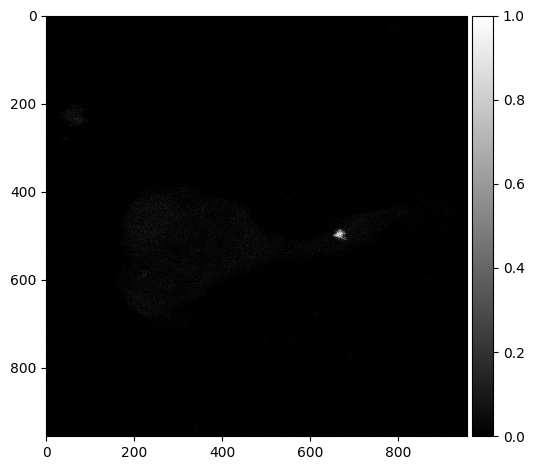

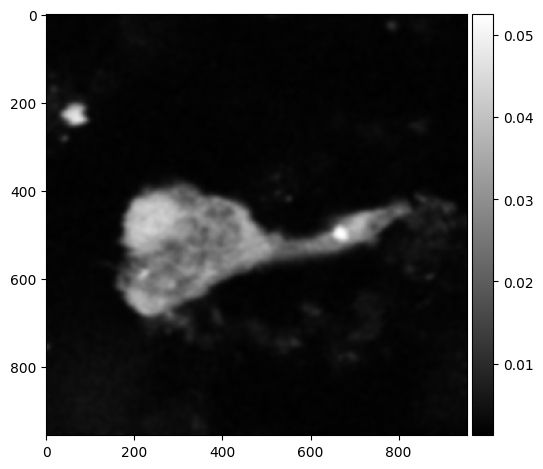

Segmented Cells


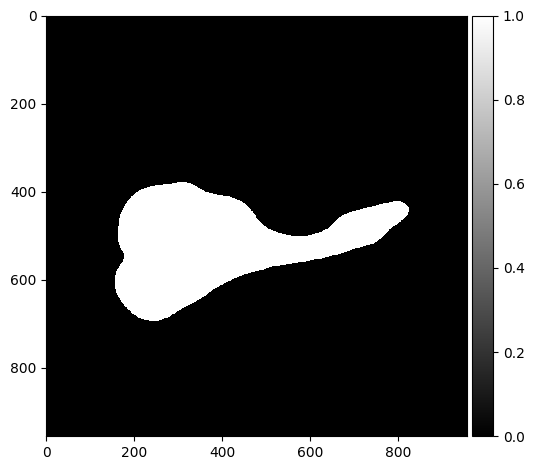

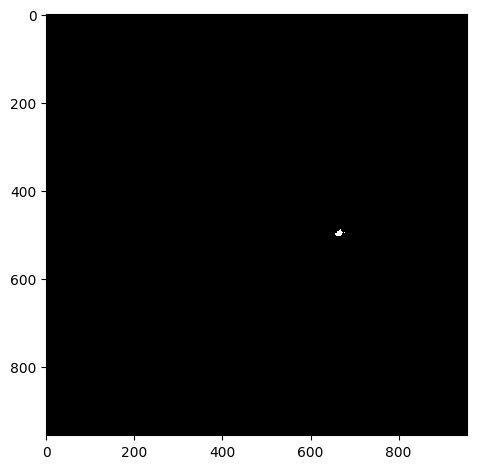

Cell 0: Number of inclusions: 1
Cell 0: Inclusion areas: [np.float64(194.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_02.czi
Green Channel


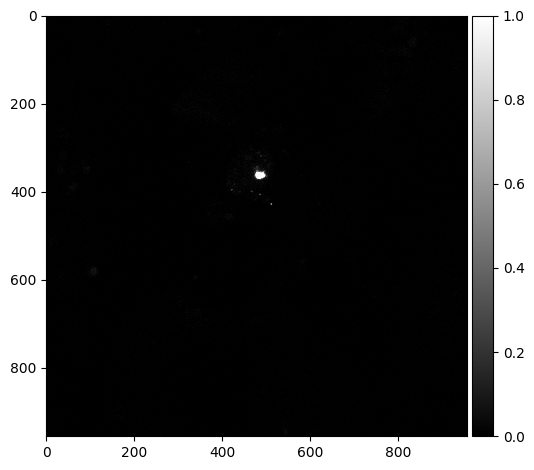

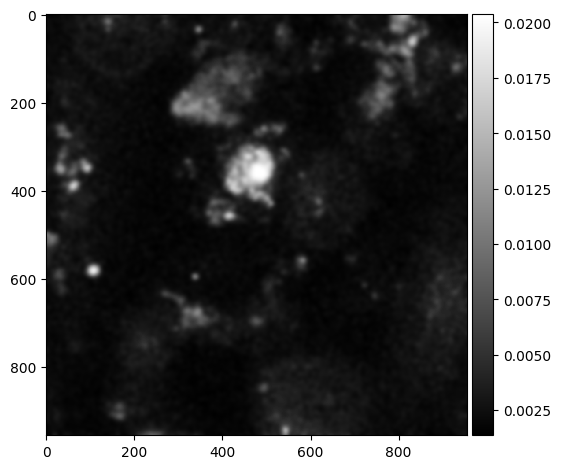

Segmented Cells


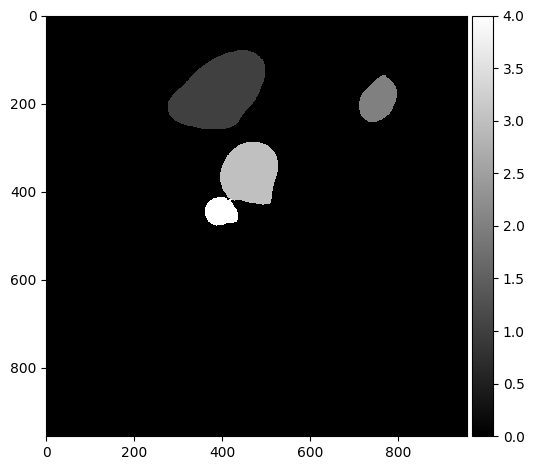

c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\numpy\_core\fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\numpy\_core\_methods.py:138: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


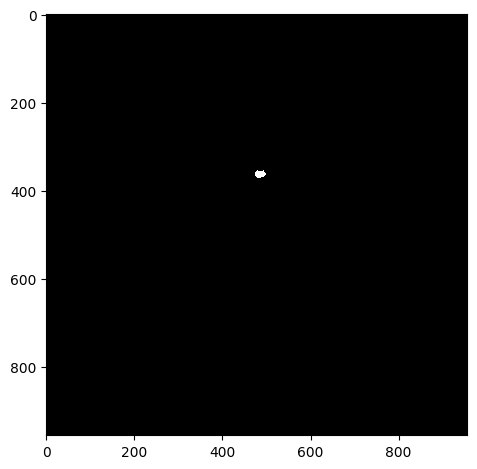

Cell 2: Number of inclusions: 1
Cell 2: Inclusion areas: [np.float64(334.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_03.czi
Green Channel


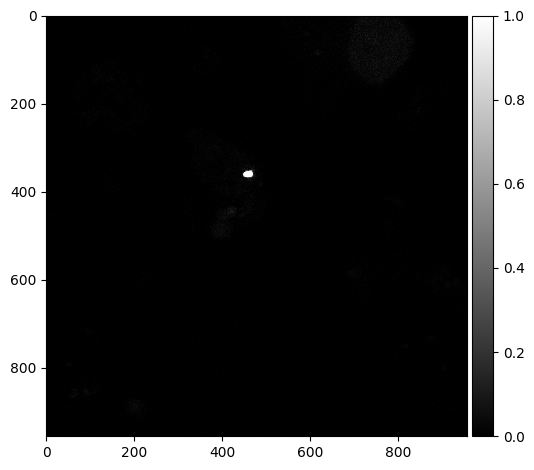

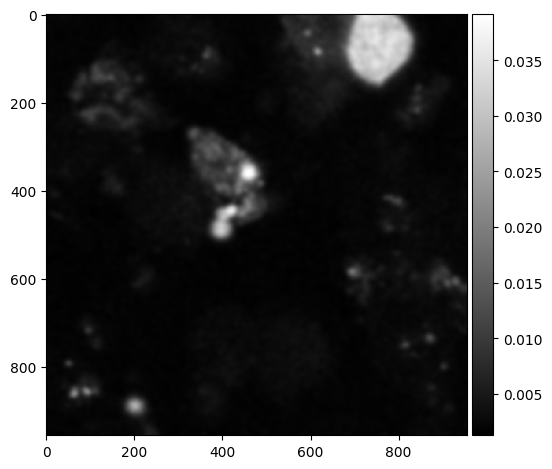

Segmented Cells


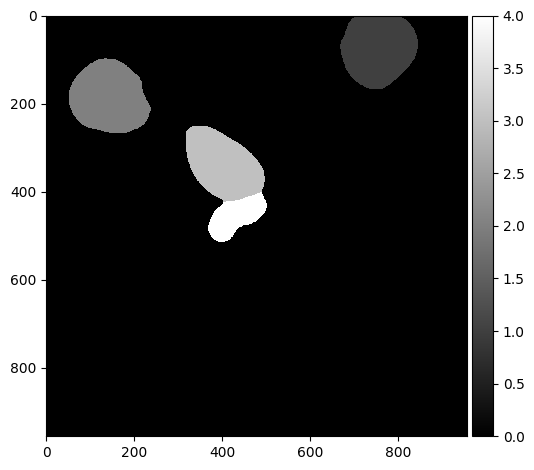

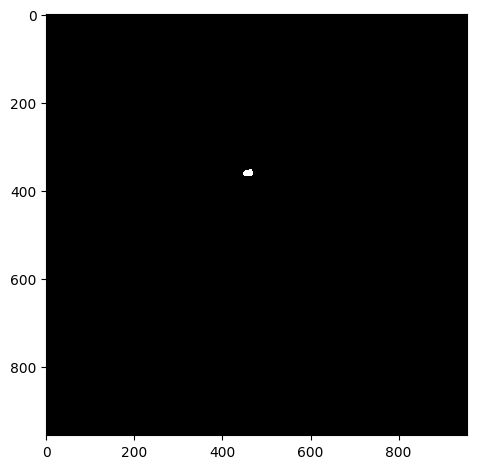

Cell 2: Number of inclusions: 1
Cell 2: Inclusion areas: [np.float64(286.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_04.czi
Green Channel


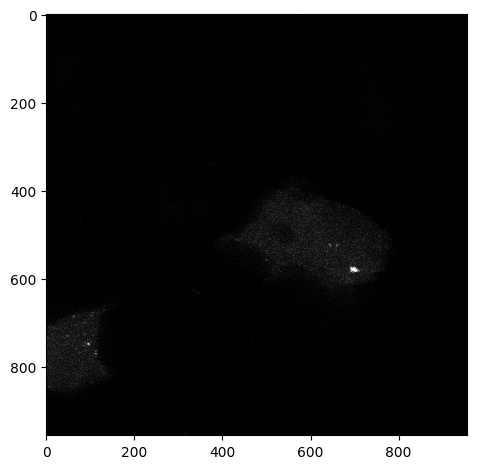

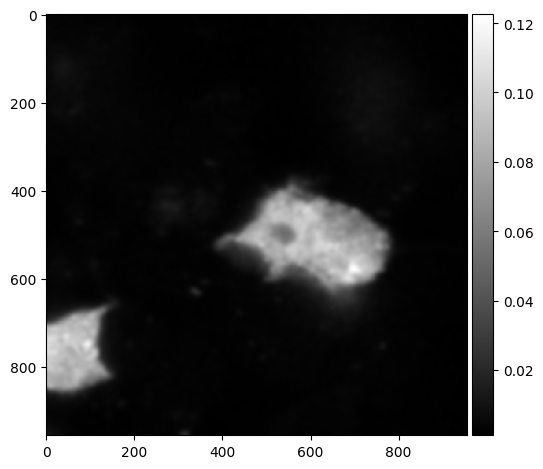

Segmented Cells


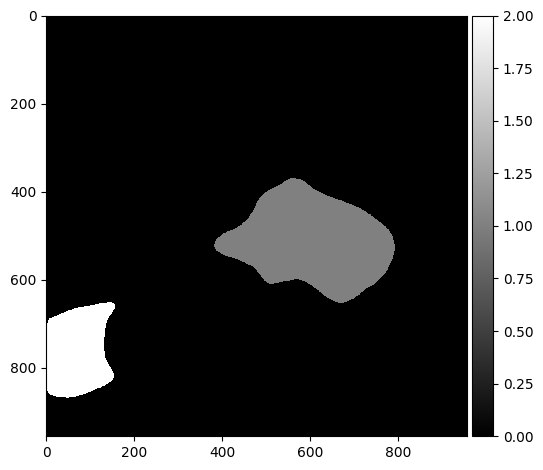

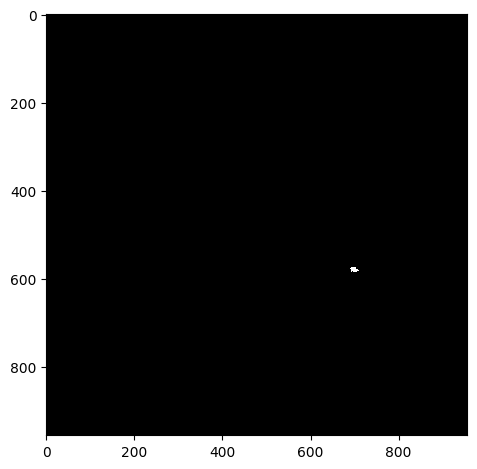

Cell 0: Number of inclusions: 1
Cell 0: Inclusion areas: [np.float64(153.0)]


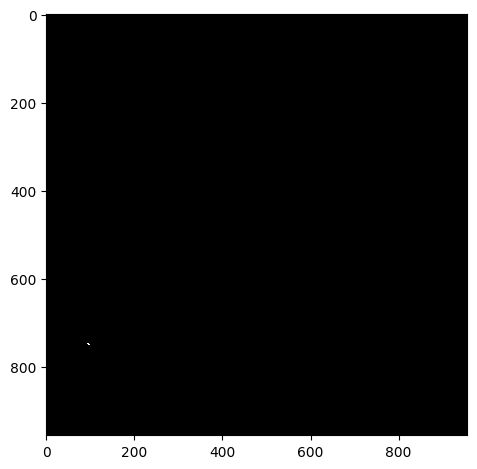

Cell 1: Number of inclusions: 1
Cell 1: Inclusion areas: [np.float64(16.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_05.czi
Green Channel


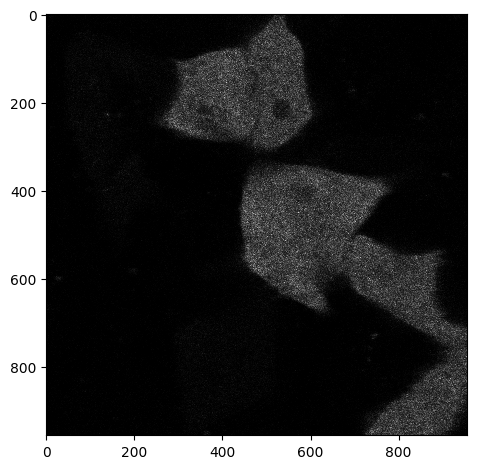

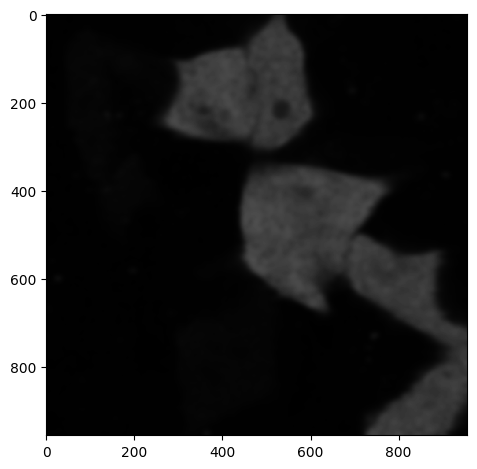

Segmented Cells


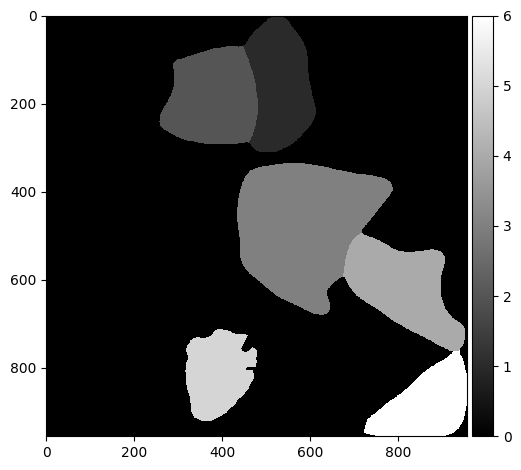

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_06.czi
Green Channel


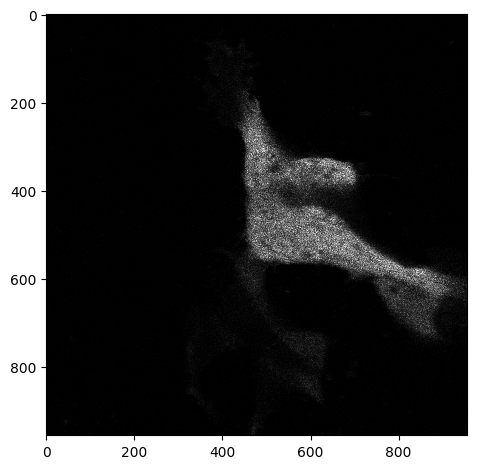

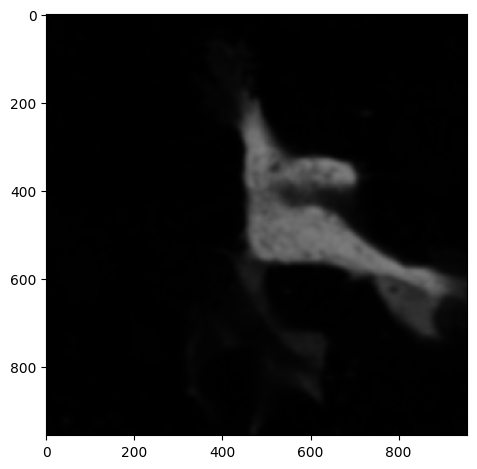

Segmented Cells


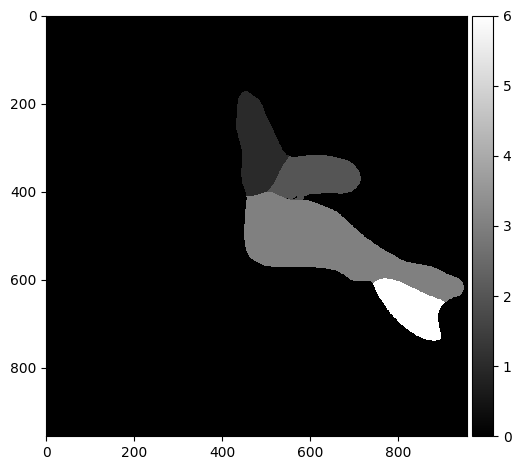

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_07.czi
Green Channel


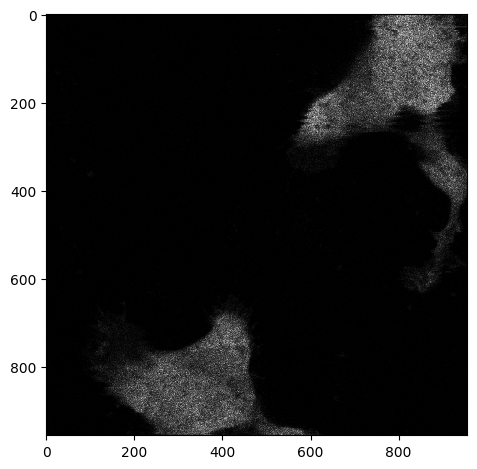

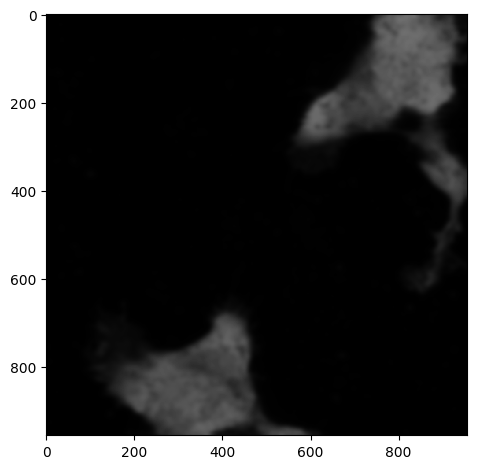

Segmented Cells


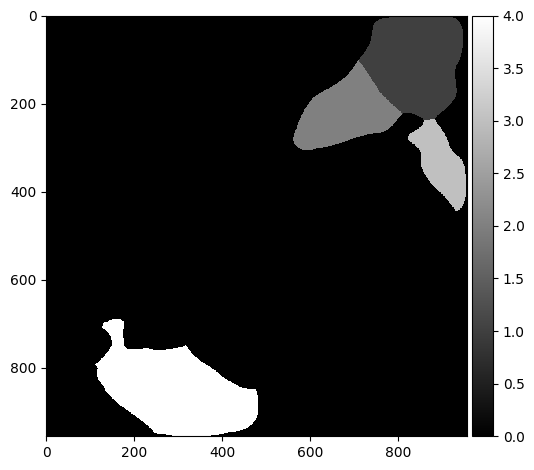

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_08.czi
Green Channel


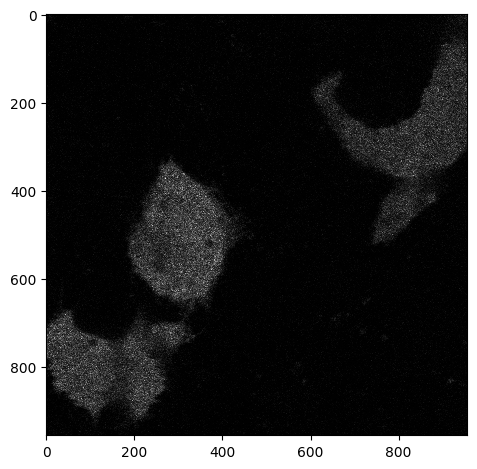

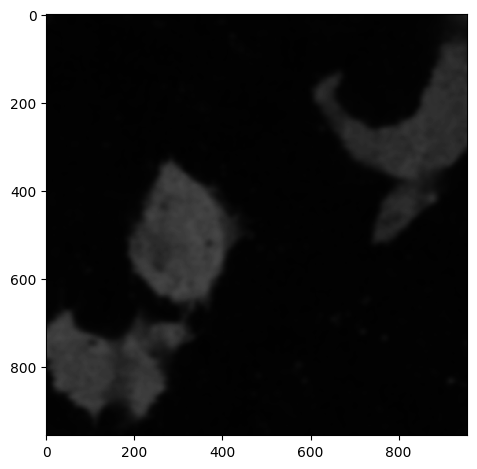

Segmented Cells


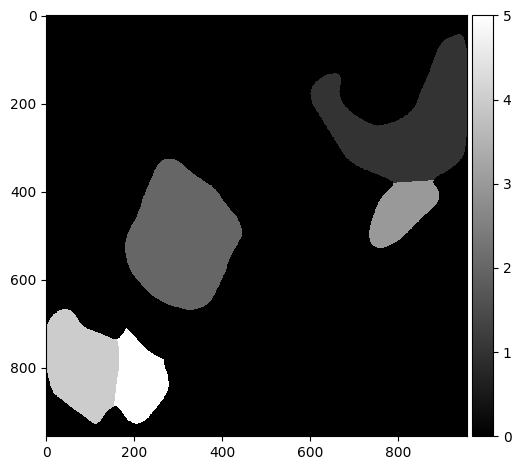

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_09.czi
Green Channel


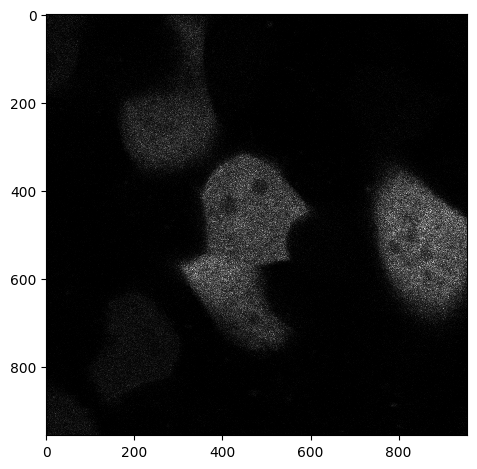

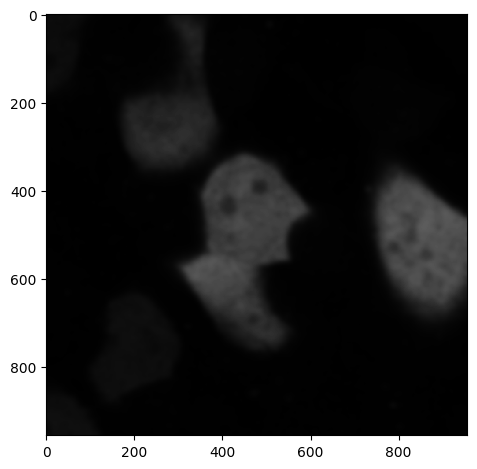

Segmented Cells


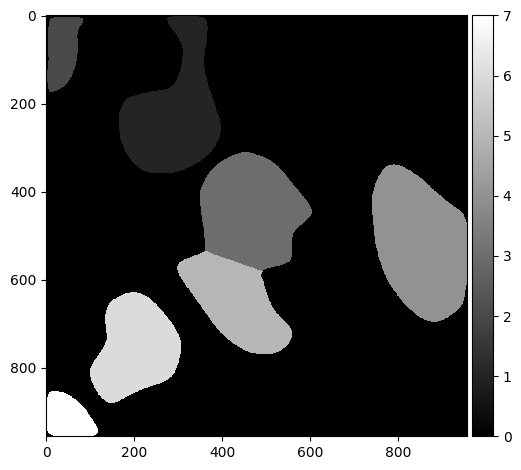

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_10.czi
Green Channel


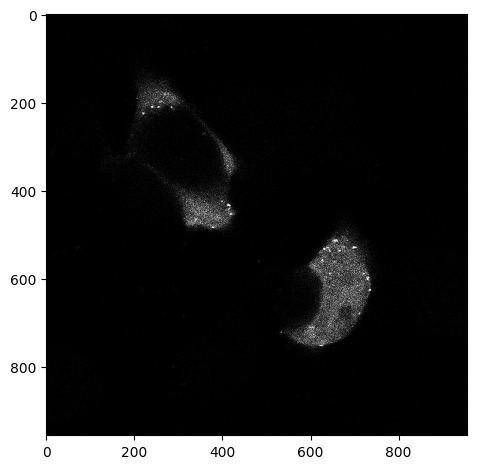

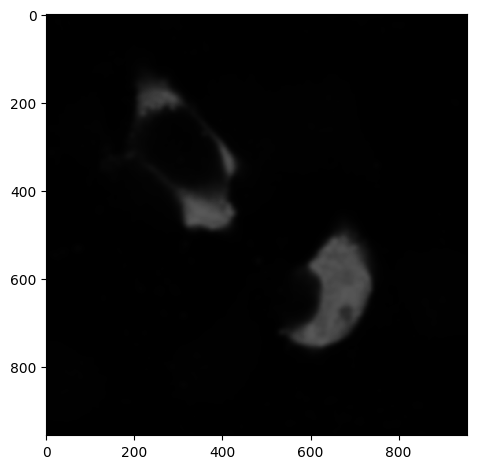

Segmented Cells


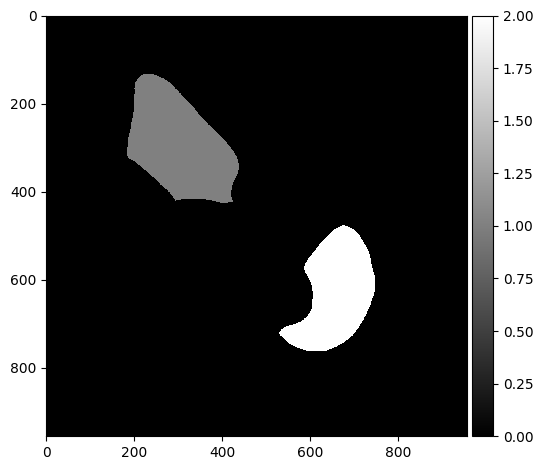

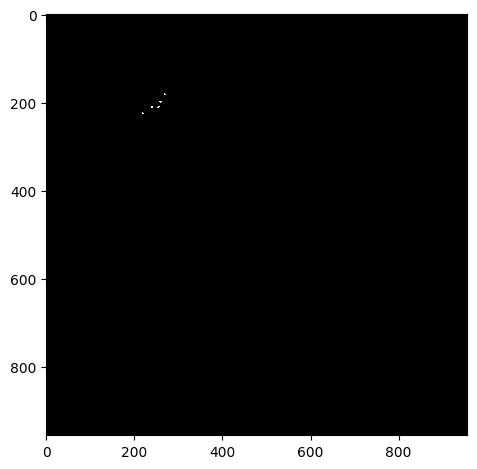

Cell 0: Number of inclusions: 5
Cell 0: Inclusion areas: [np.float64(18.0), np.float64(16.0), np.float64(22.0), np.float64(17.0), np.float64(21.0)]


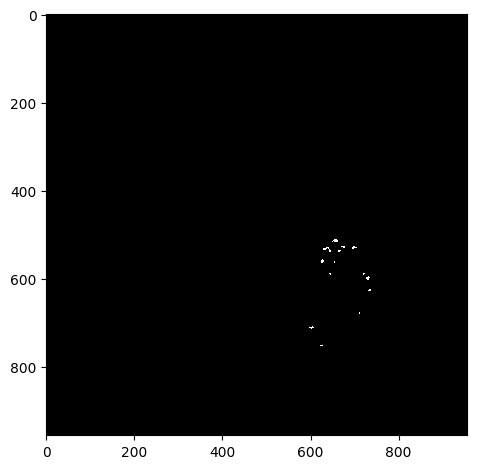

Cell 1: Number of inclusions: 15
Cell 1: Inclusion areas: [np.float64(47.0), np.float64(26.0), np.float64(54.0), np.float64(53.0), np.float64(25.0), np.float64(27.0), np.float64(39.0), np.float64(11.0), np.float64(26.0), np.float64(23.0), np.float64(49.0), np.float64(19.0), np.float64(20.0), np.float64(46.0), np.float64(17.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_01.czi
Green Channel


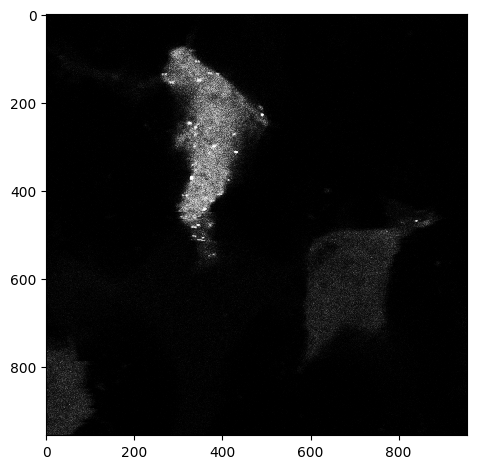

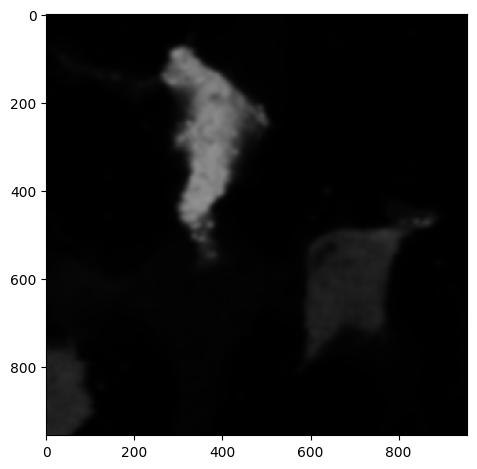

Segmented Cells


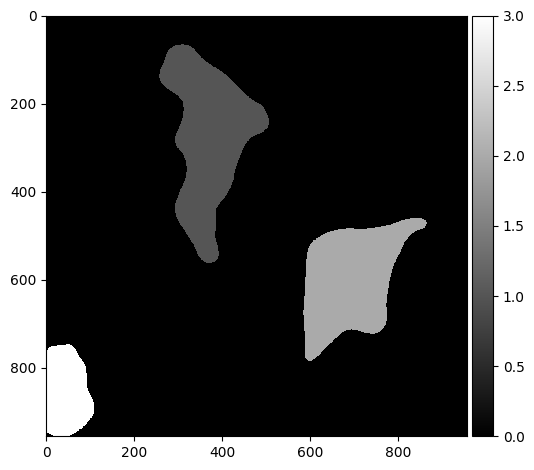

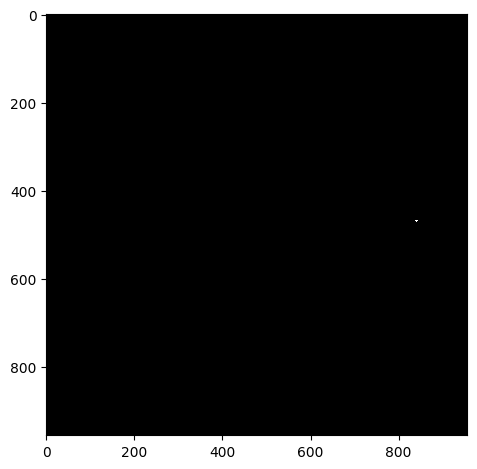

Cell 1: Number of inclusions: 1
Cell 1: Inclusion areas: [np.float64(20.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_02.czi
Green Channel


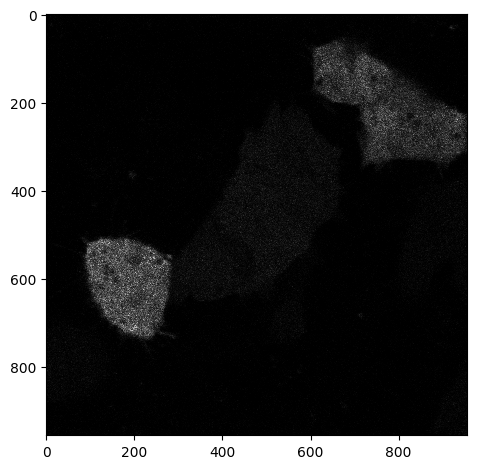

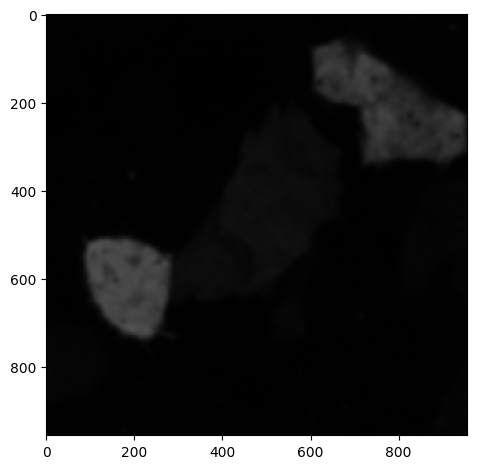

Segmented Cells


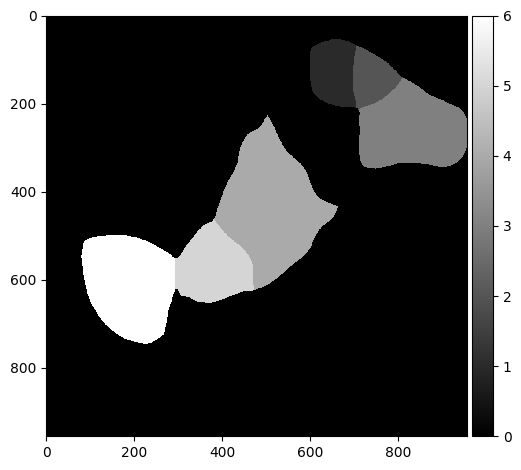

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_03.czi
Green Channel


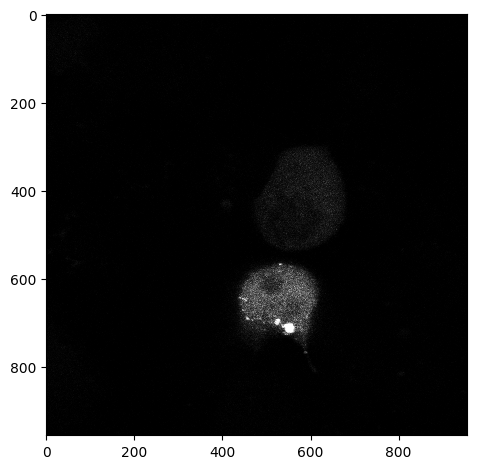

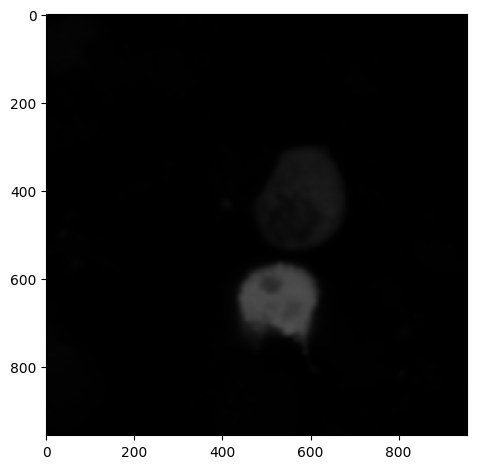

Segmented Cells


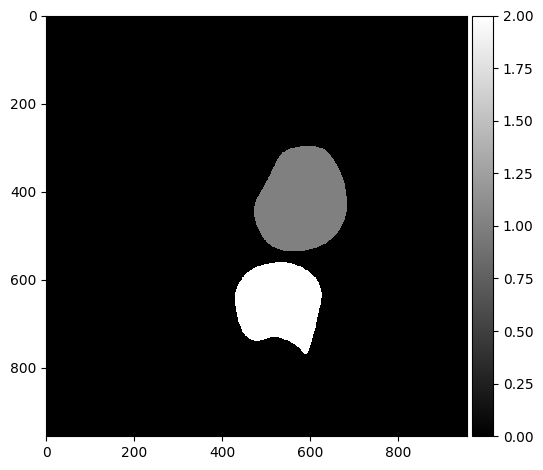

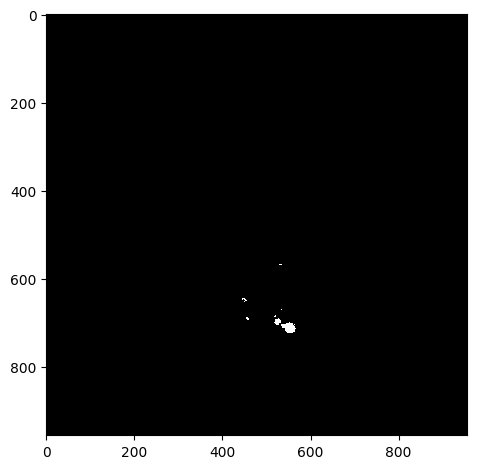

Cell 1: Number of inclusions: 7
Cell 1: Inclusion areas: [np.float64(15.0), np.float64(49.0), np.float64(11.0), np.float64(12.0), np.float64(28.0), np.float64(173.0), np.float64(549.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_04.czi
Green Channel


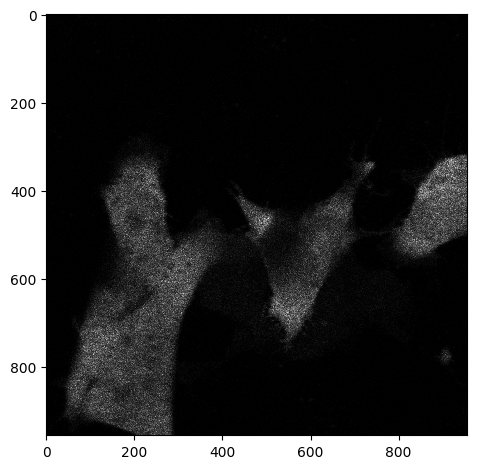

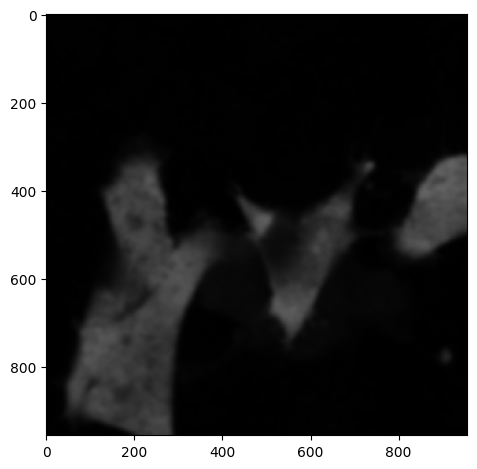

Segmented Cells


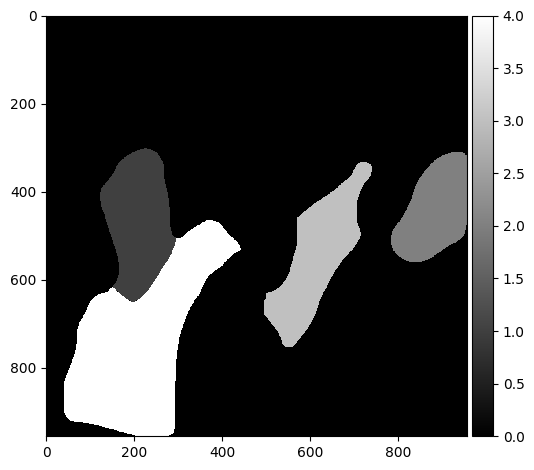

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_05.czi
Green Channel


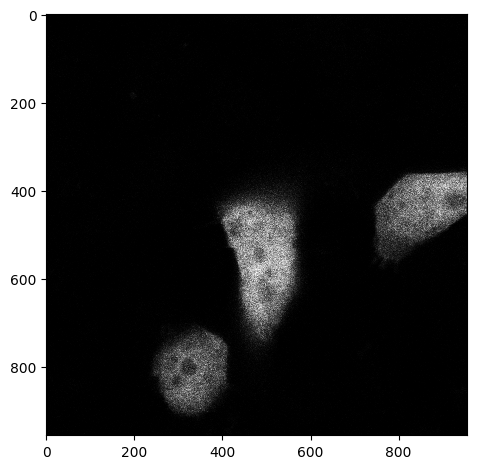

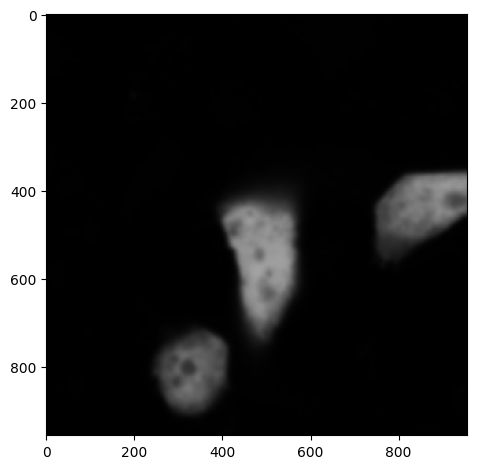

Segmented Cells


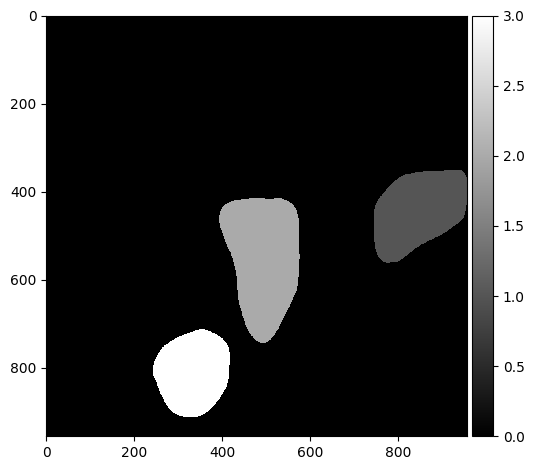

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_06.czi
Green Channel


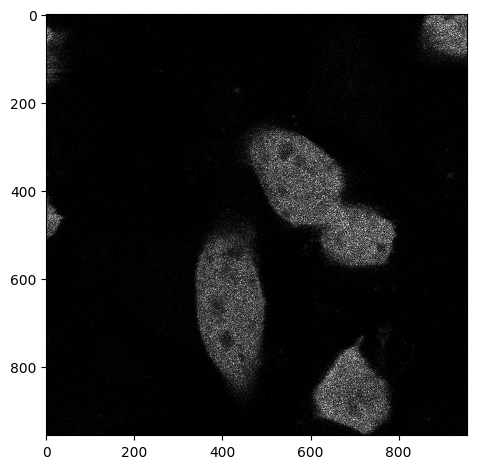

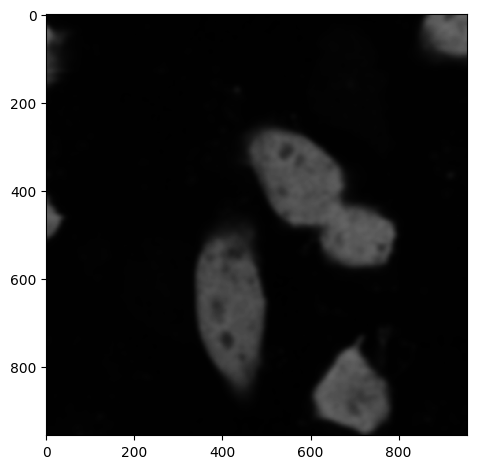

Segmented Cells


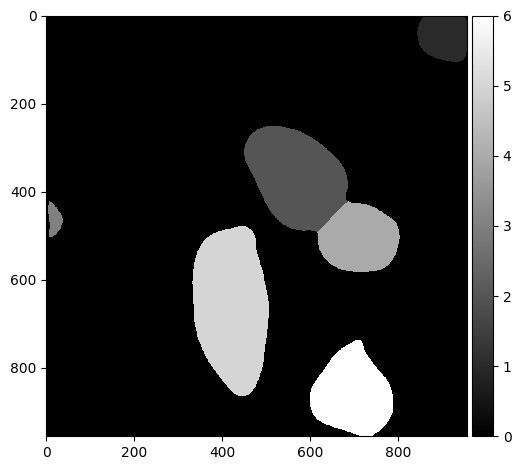

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_07.czi
Green Channel


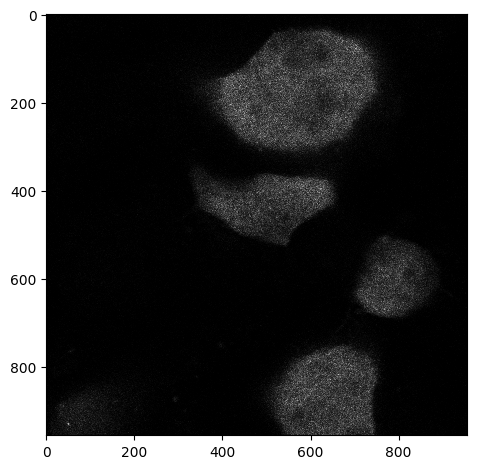

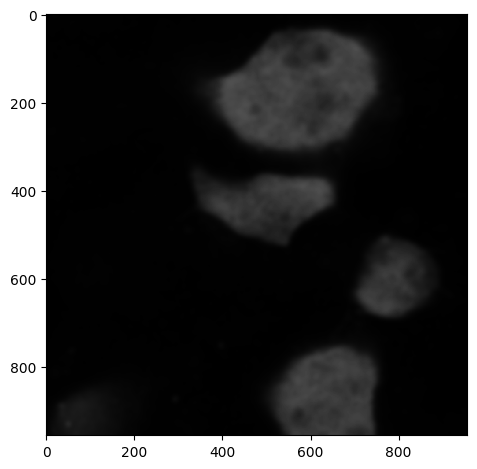

Segmented Cells


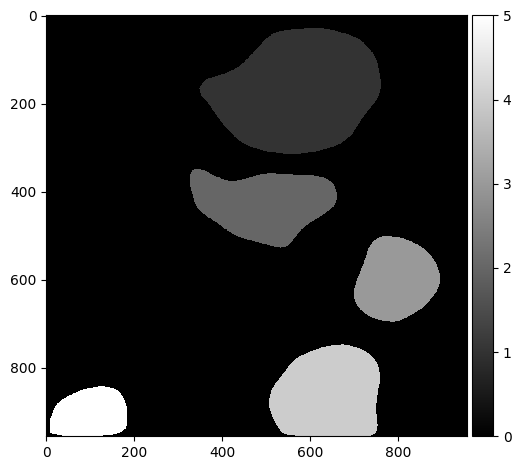

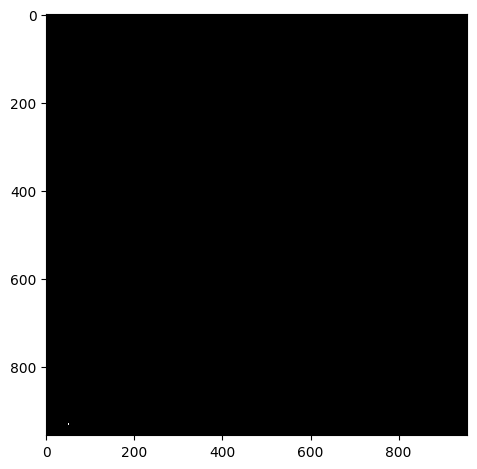

Cell 4: Number of inclusions: 1
Cell 4: Inclusion areas: [np.float64(15.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_08.czi
Green Channel


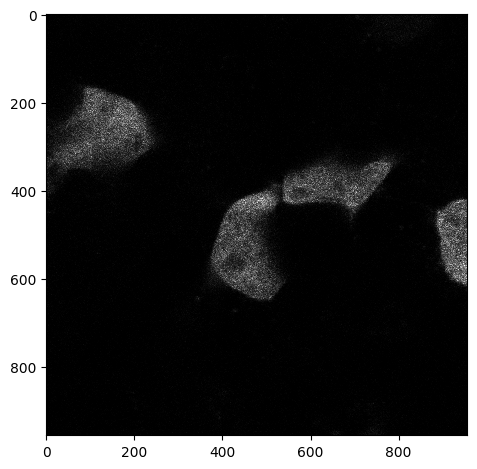

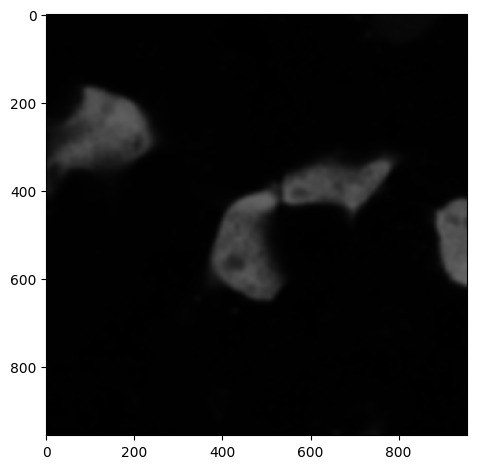

Segmented Cells


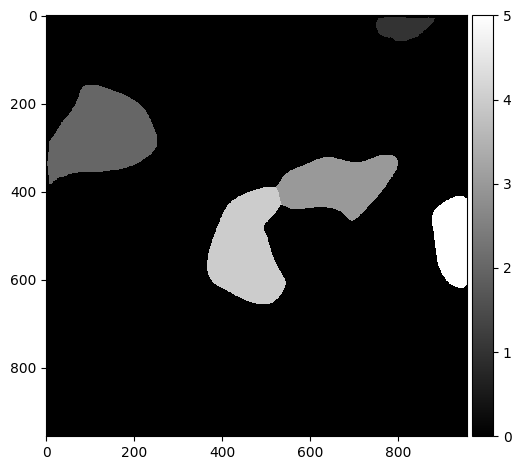

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_09.czi
Green Channel


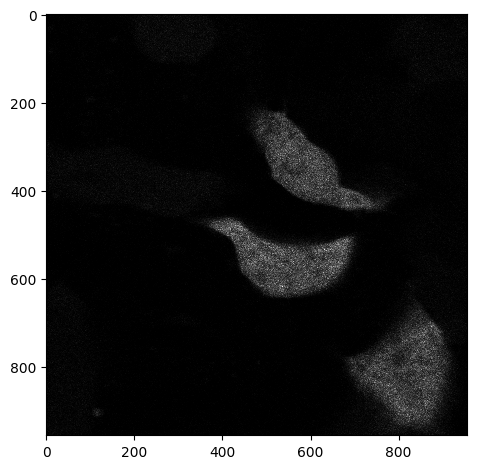

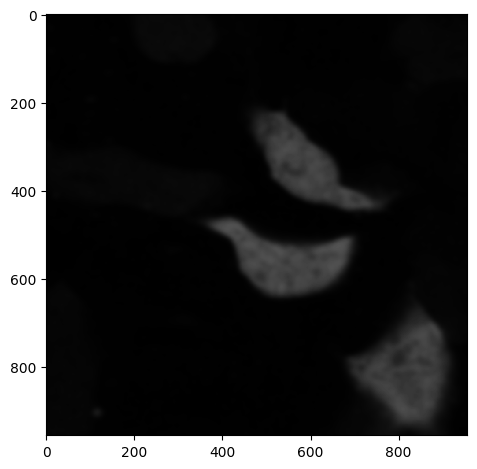

Segmented Cells


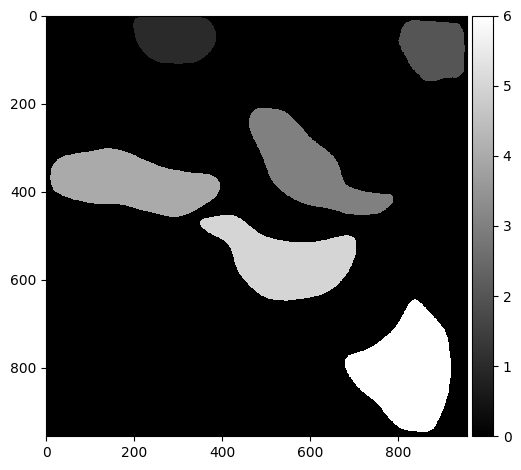

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_10.czi
Green Channel


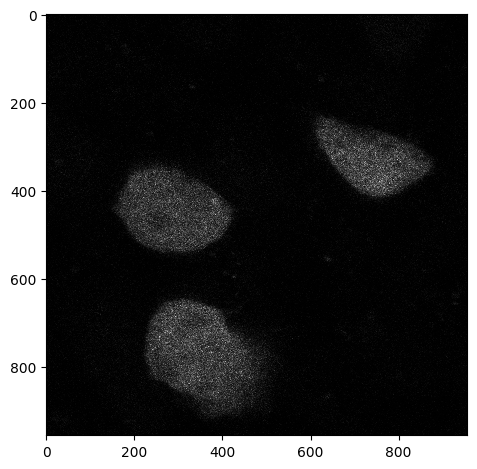

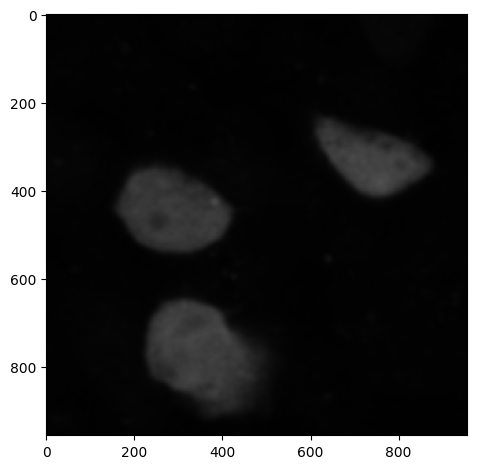

Segmented Cells


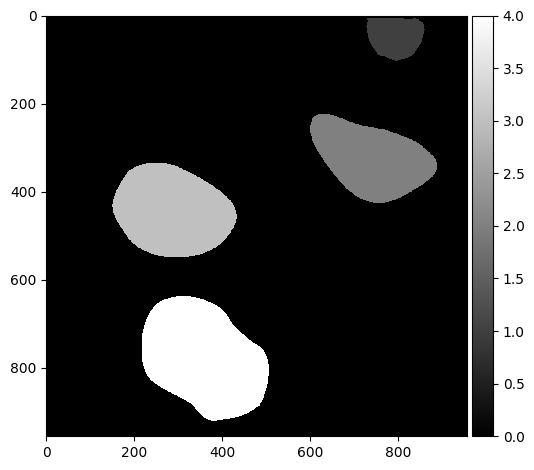

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_01.czi
Green Channel


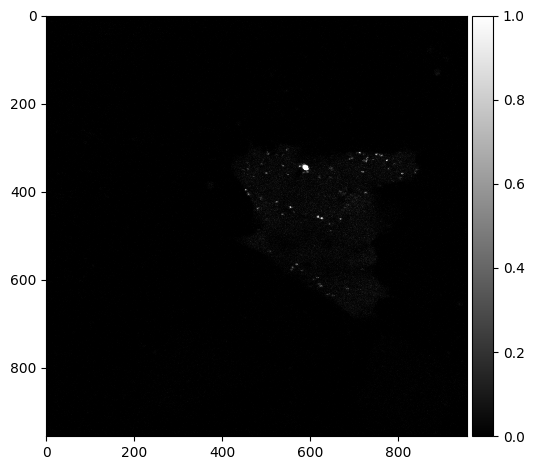

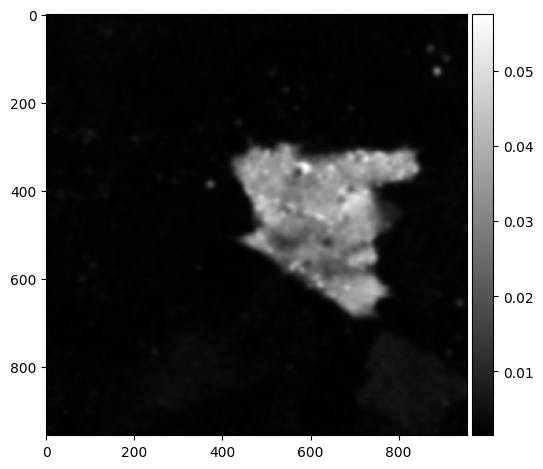

Segmented Cells


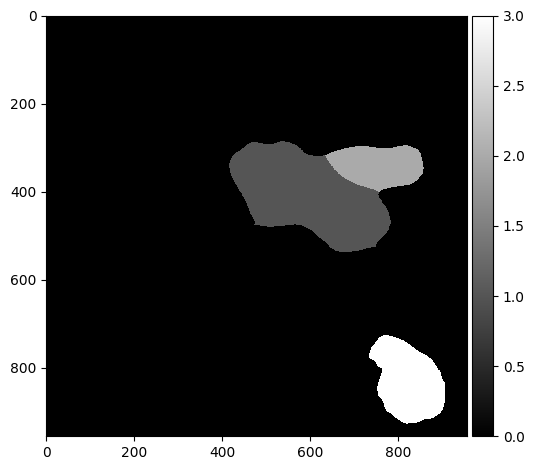

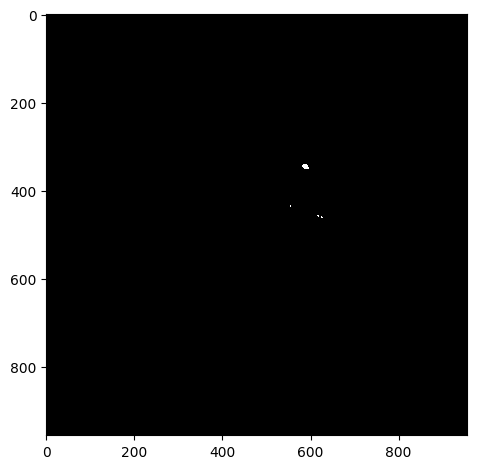

Cell 0: Number of inclusions: 4
Cell 0: Inclusion areas: [np.float64(151.0), np.float64(16.0), np.float64(14.0), np.float64(18.0)]


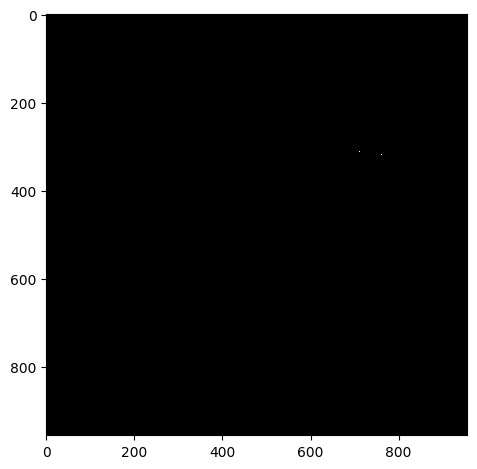

Cell 1: Number of inclusions: 2
Cell 1: Inclusion areas: [np.float64(10.0), np.float64(10.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_02.czi
Green Channel


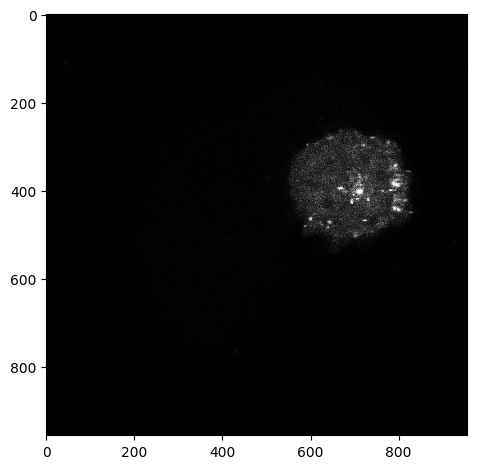

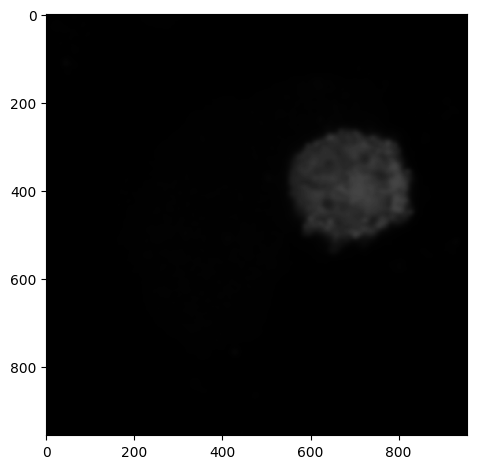

In [ ]:

analyze_all_images(folders[0])
# for folder in folders:
#     analyze_all_images(folder)


1K_ADAMTS19_01.czi
Green Channel


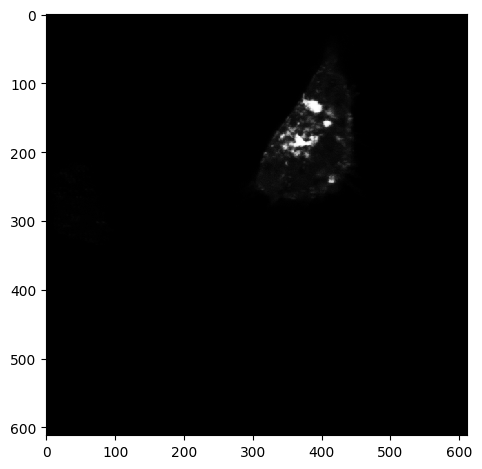

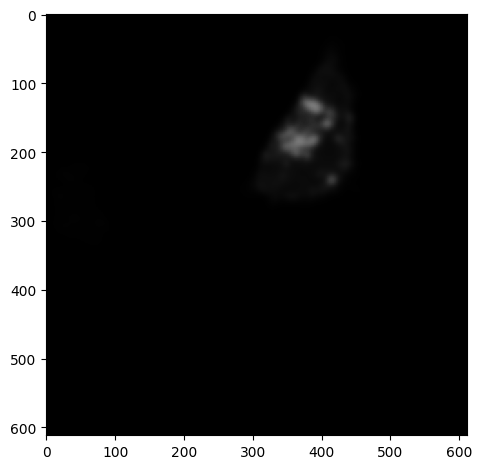

Segmented Cells


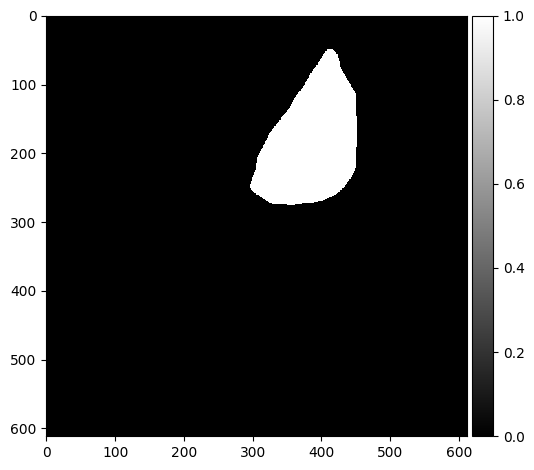

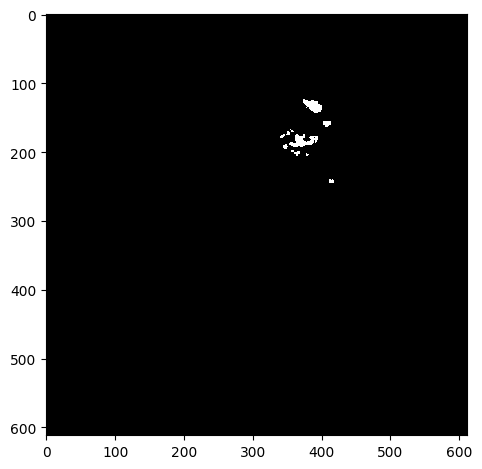

Cell 0: Number of inclusions: 10
Cell 0: Inclusion areas: [np.float64(349.0), np.float64(89.0), np.float64(11.0), np.float64(26.0), np.float64(422.0), np.float64(25.0), np.float64(43.0), np.float64(56.0), np.float64(15.0), np.float64(30.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_02.czi
Green Channel


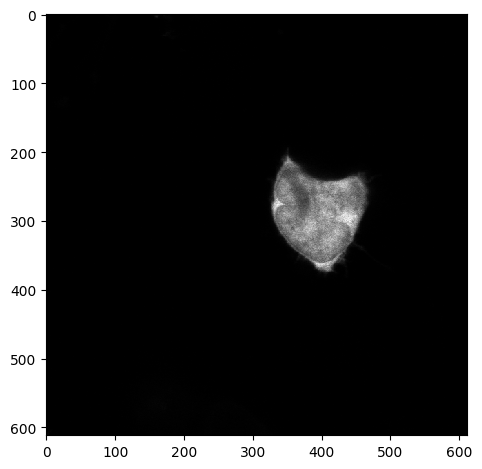

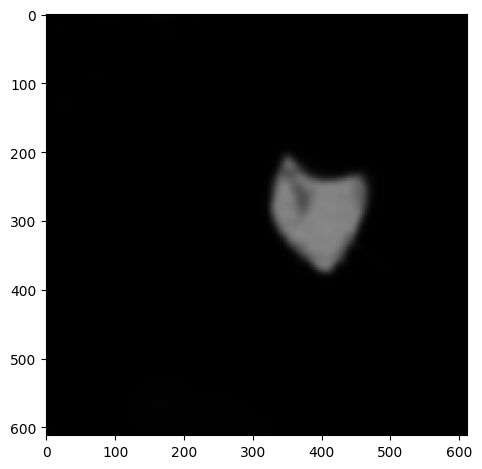

Segmented Cells


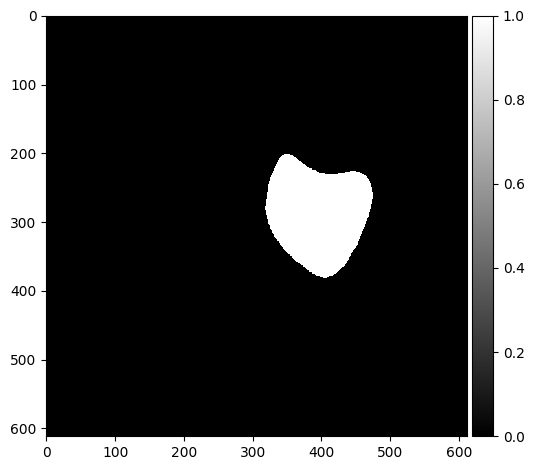

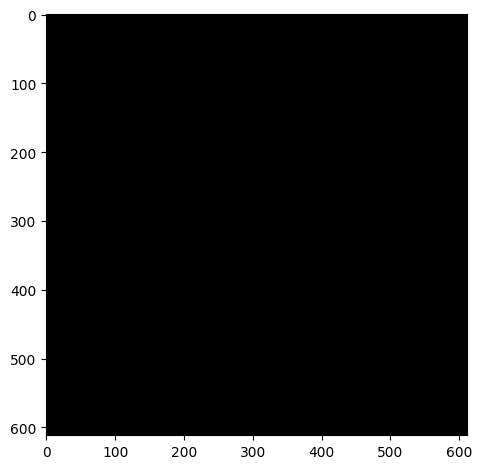

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_03.czi
Green Channel


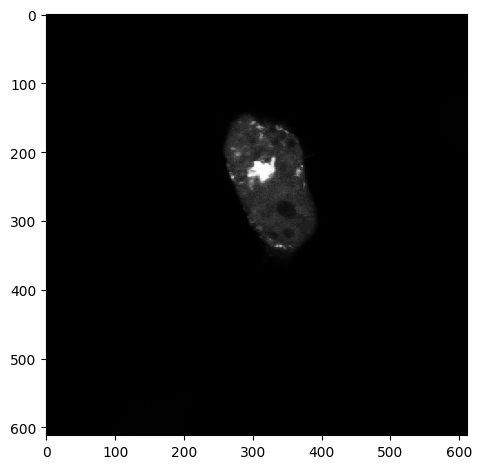

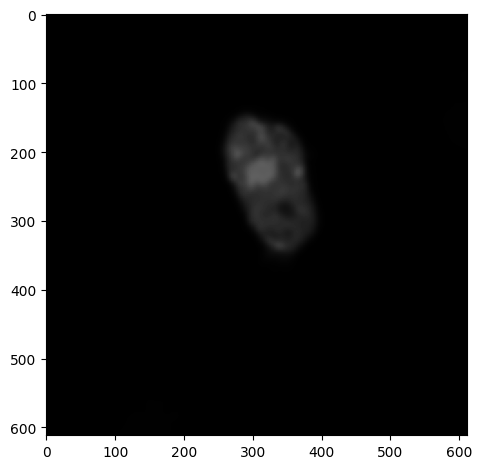

Segmented Cells


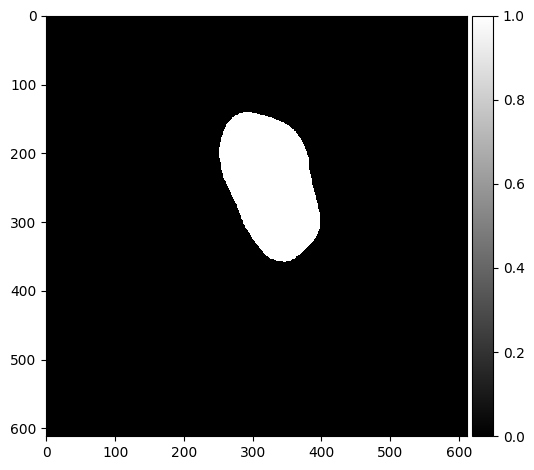

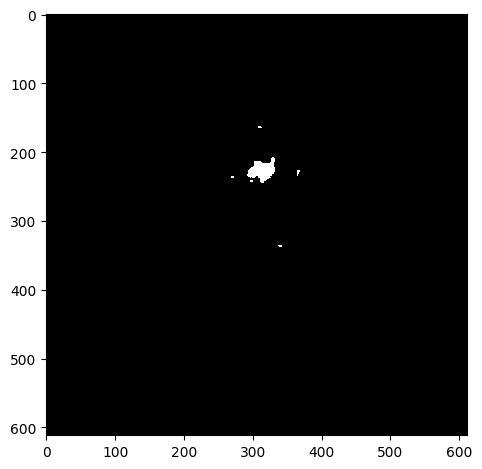

Cell 0: Number of inclusions: 6
Cell 0: Inclusion areas: [np.float64(19.0), np.float64(868.0), np.float64(33.0), np.float64(12.0), np.float64(13.0), np.float64(11.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_04.czi
Green Channel


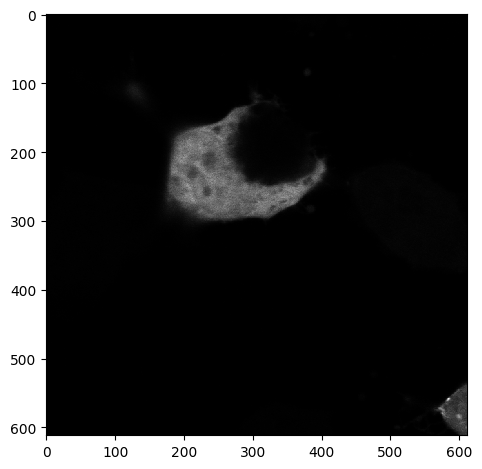

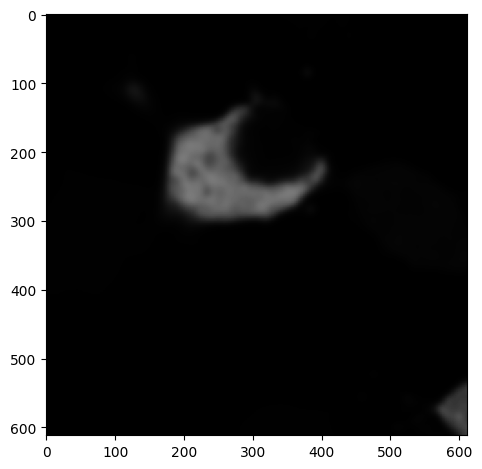

Segmented Cells


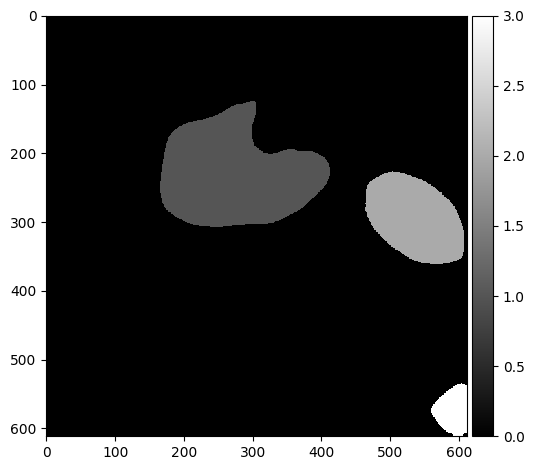

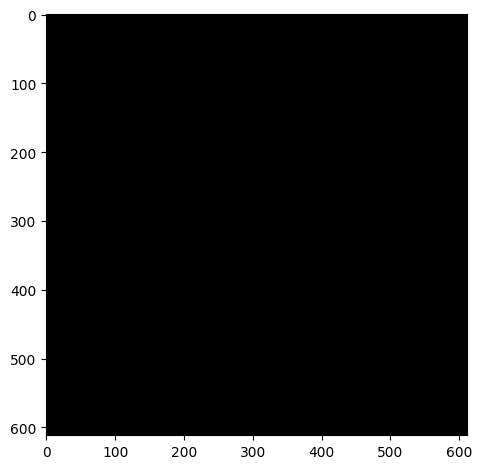

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


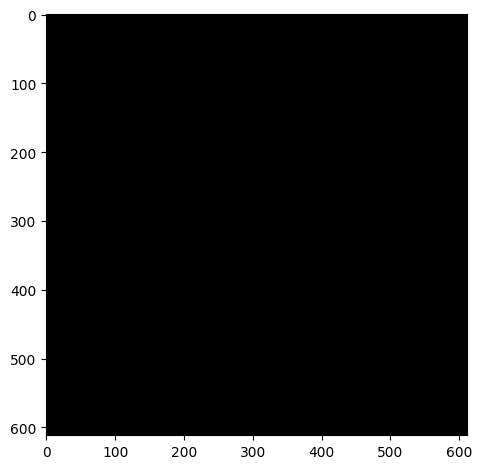

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


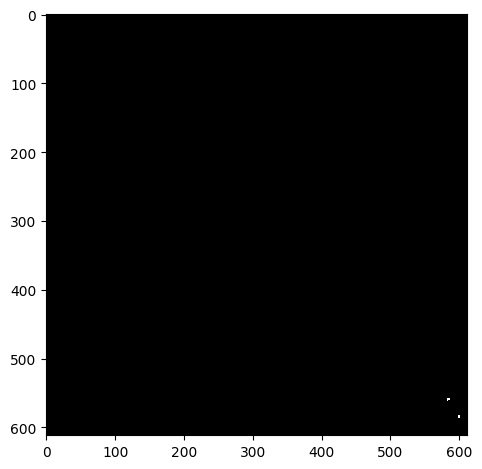

Cell 2: Number of inclusions: 2
Cell 2: Inclusion areas: [np.float64(14.0), np.float64(13.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_05.czi
Green Channel


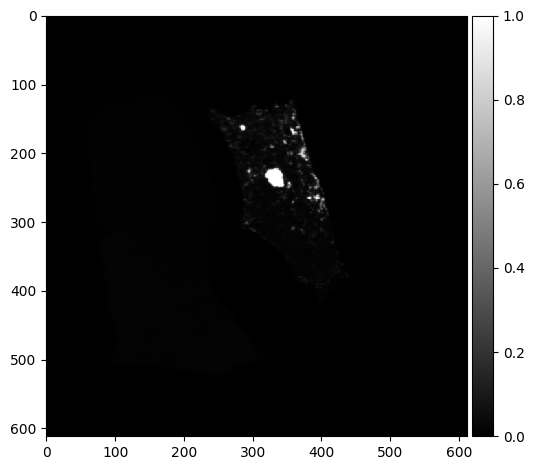

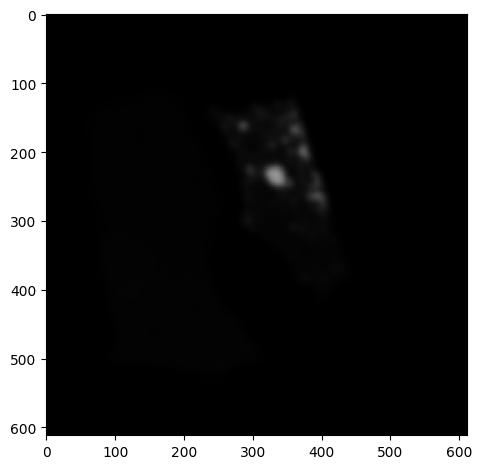

Segmented Cells


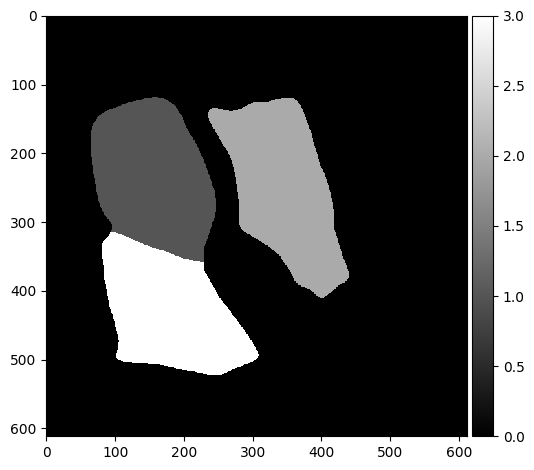

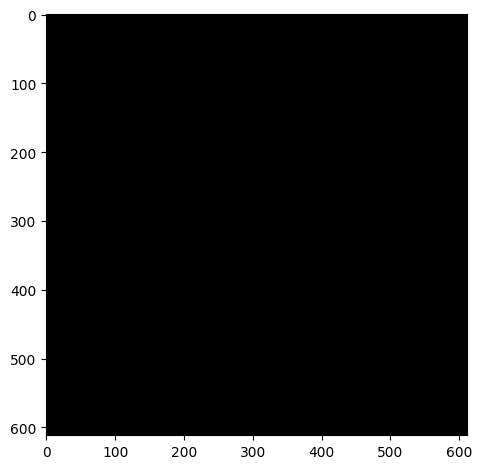

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


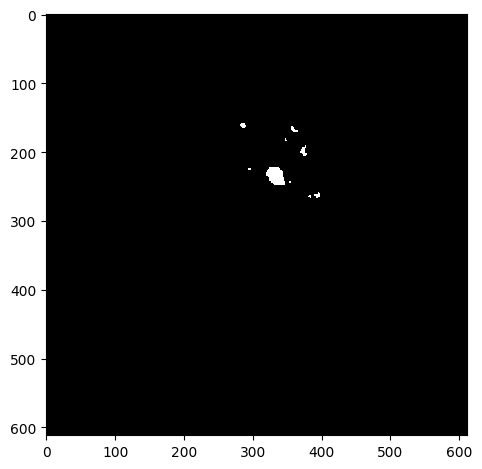

Cell 1: Number of inclusions: 9
Cell 1: Inclusion areas: [np.float64(46.0), np.float64(50.0), np.float64(10.0), np.float64(78.0), np.float64(547.0), np.float64(12.0), np.float64(11.0), np.float64(42.0), np.float64(14.0)]


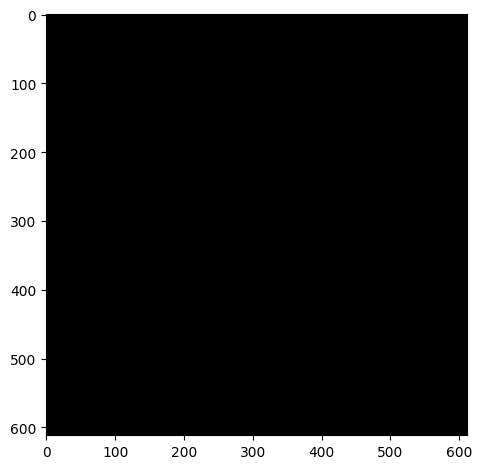

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_06.czi
Green Channel


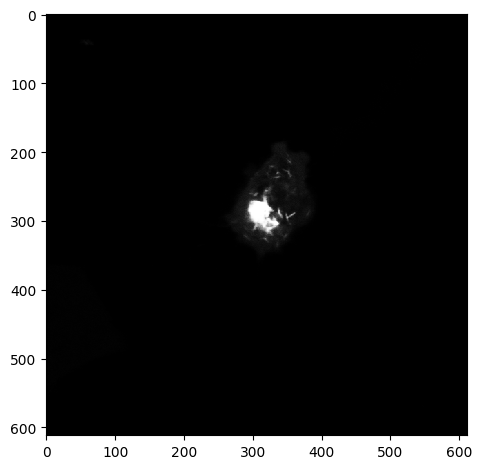

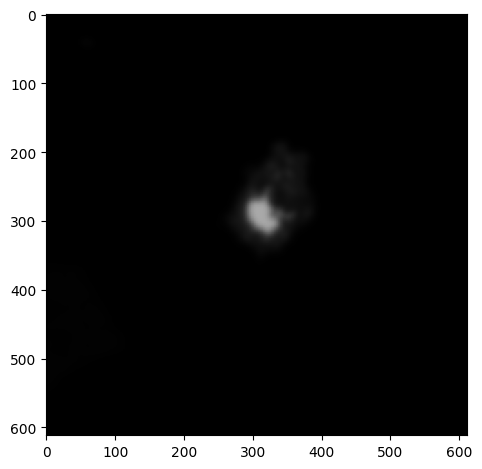

Segmented Cells


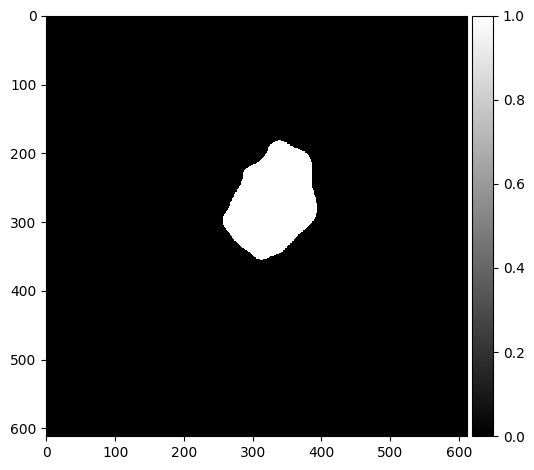

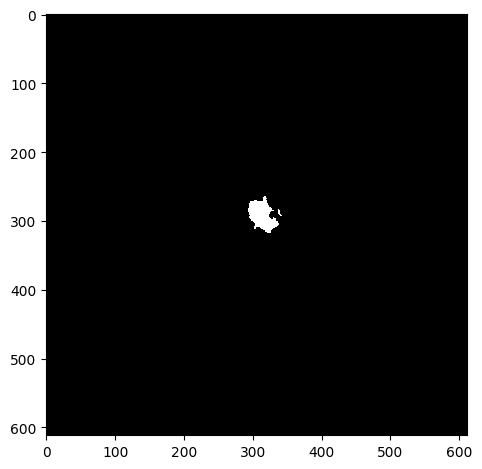

Cell 0: Number of inclusions: 2
Cell 0: Inclusion areas: [np.float64(1360.0), np.float64(28.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_07.czi
Green Channel


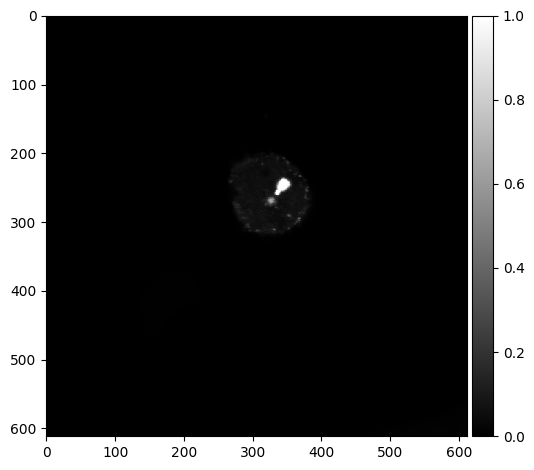

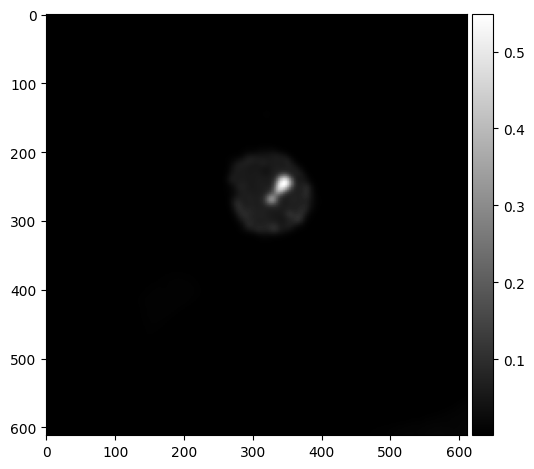

Segmented Cells


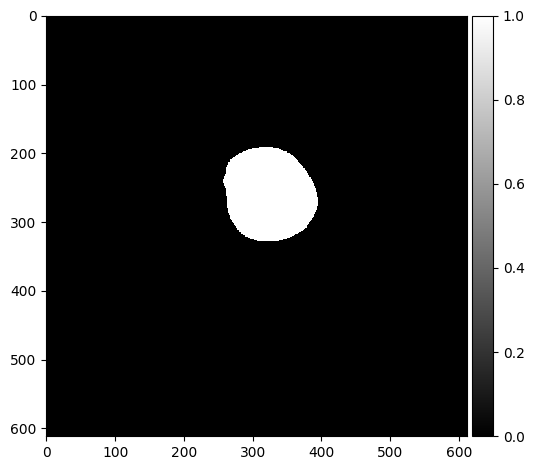

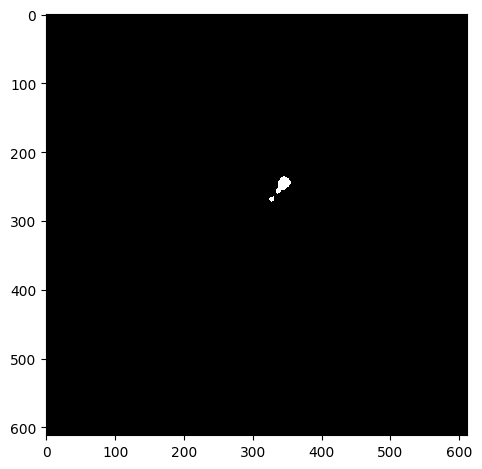

Cell 0: Number of inclusions: 2
Cell 0: Inclusion areas: [np.float64(317.0), np.float64(35.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_08.czi
Green Channel


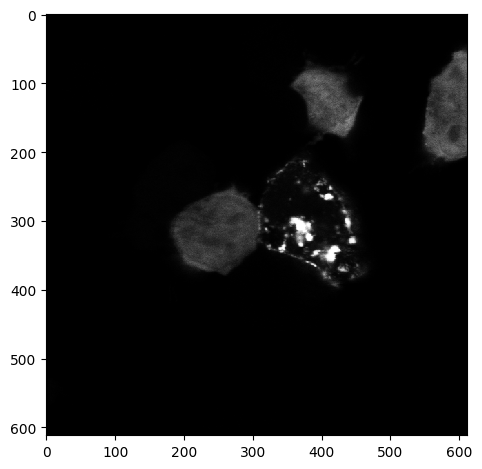

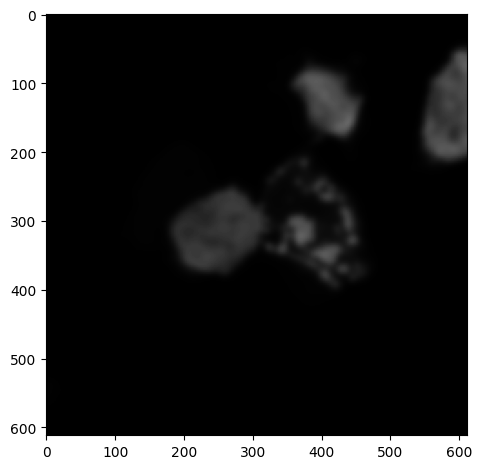

Segmented Cells


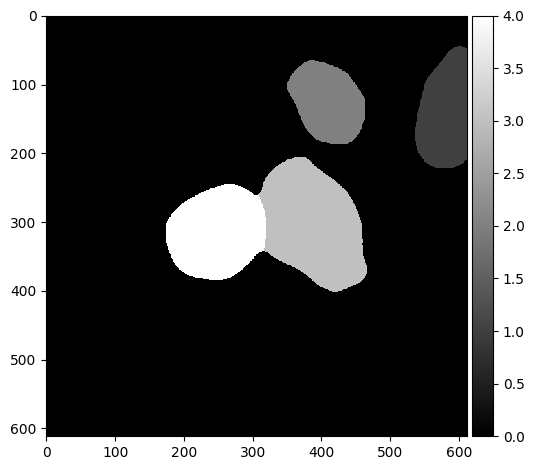

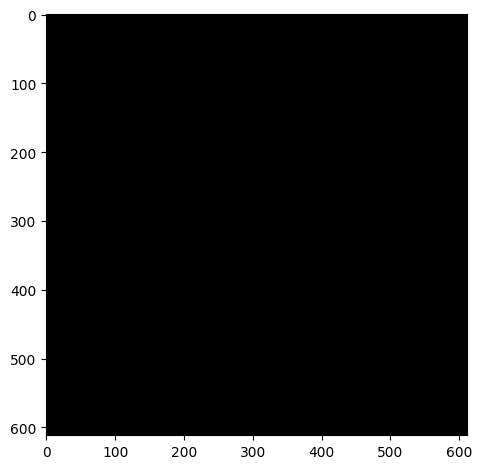

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


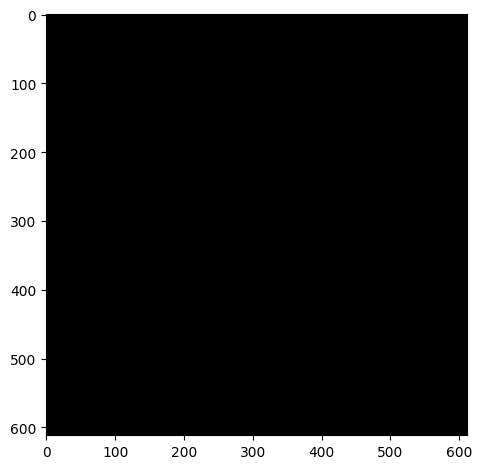

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


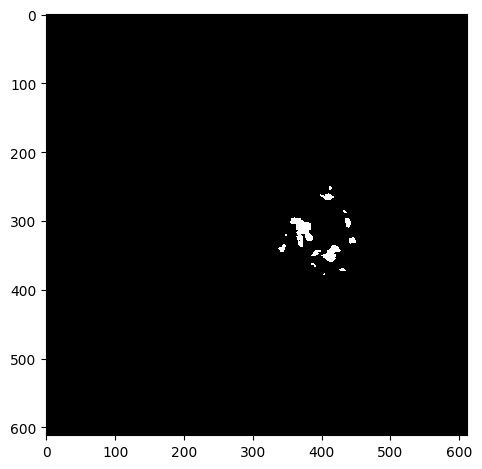

Cell 2: Number of inclusions: 13
Cell 2: Inclusion areas: [np.float64(16.0), np.float64(121.0), np.float64(19.0), np.float64(707.0), np.float64(96.0), np.float64(10.0), np.float64(70.0), np.float64(77.0), np.float64(349.0), np.float64(75.0), np.float64(24.0), np.float64(31.0), np.float64(12.0)]


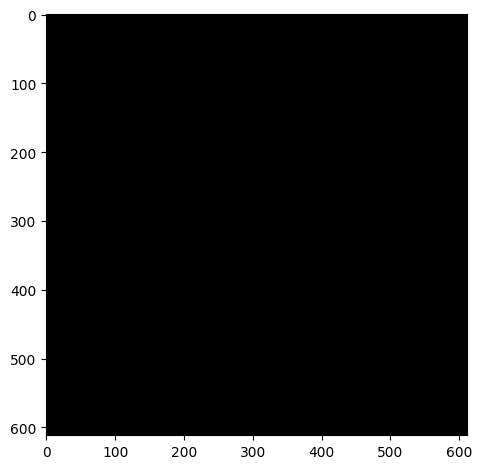

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_09.czi
Green Channel


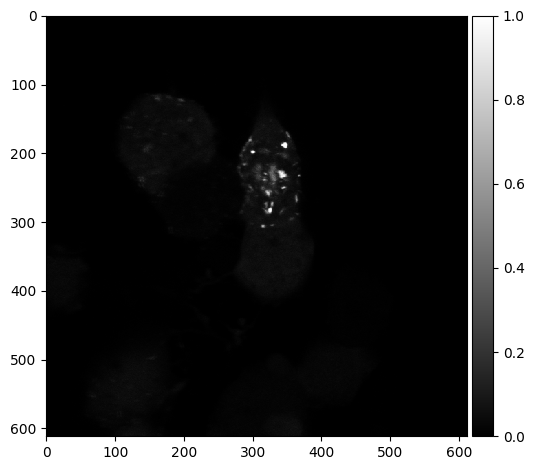

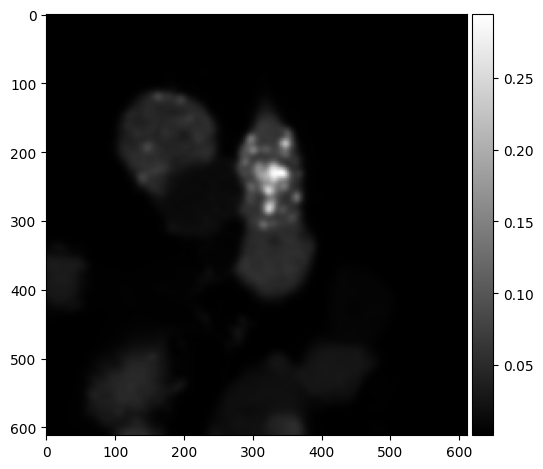

Segmented Cells


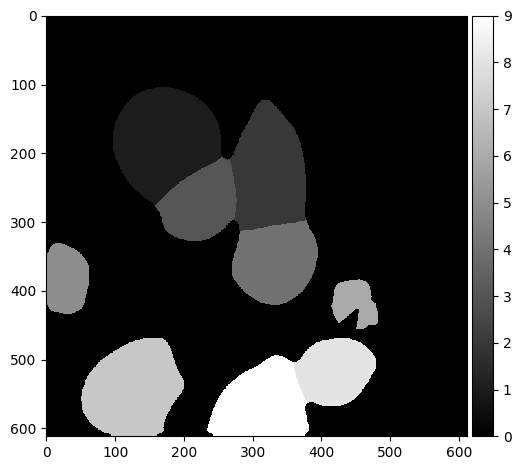

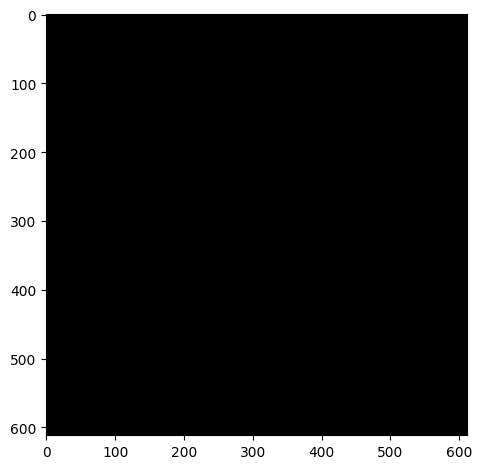

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


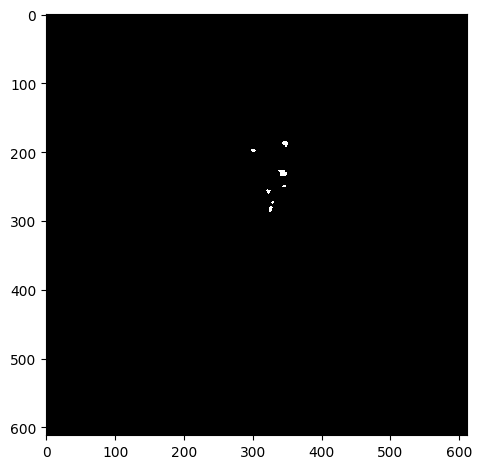

Cell 1: Number of inclusions: 7
Cell 1: Inclusion areas: [np.float64(56.0), np.float64(21.0), np.float64(85.0), np.float64(13.0), np.float64(29.0), np.float64(11.0), np.float64(37.0)]


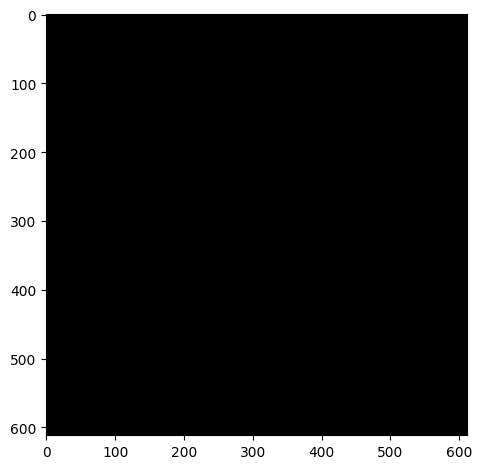

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


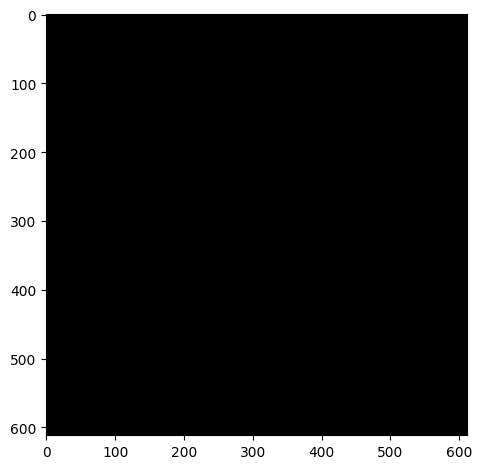

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []


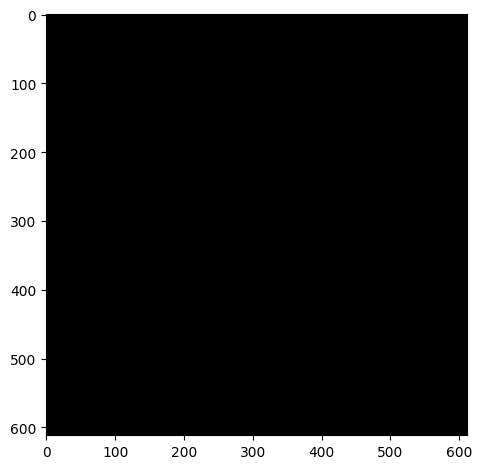

Cell 4: Number of inclusions: 0
Cell 4: Inclusion areas: []


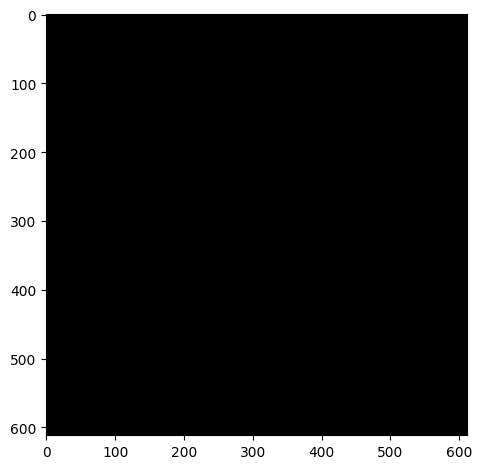

Cell 5: Number of inclusions: 0
Cell 5: Inclusion areas: []


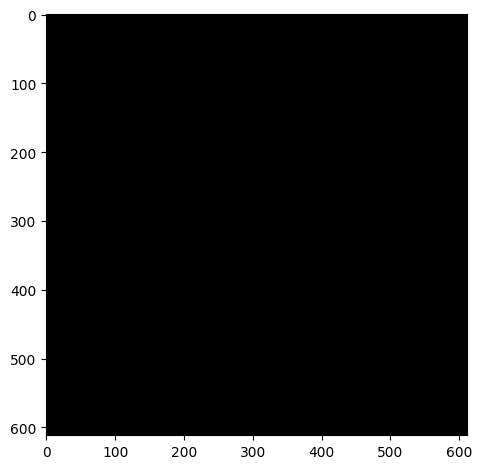

Cell 6: Number of inclusions: 0
Cell 6: Inclusion areas: []


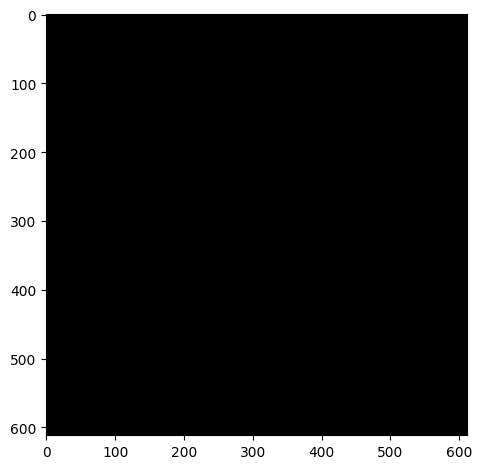

Cell 7: Number of inclusions: 0
Cell 7: Inclusion areas: []


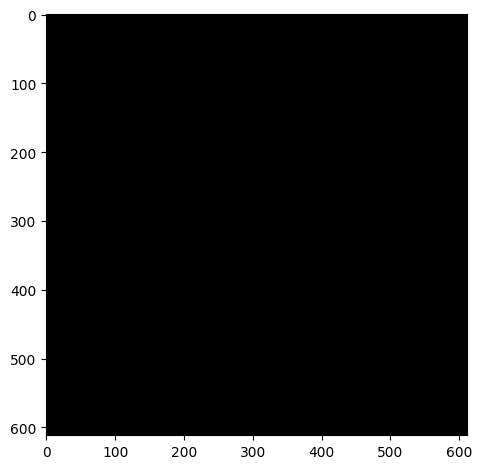

Cell 8: Number of inclusions: 0
Cell 8: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_10.czi
Green Channel


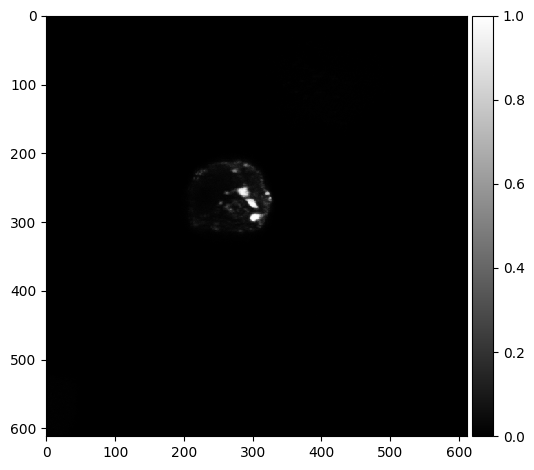

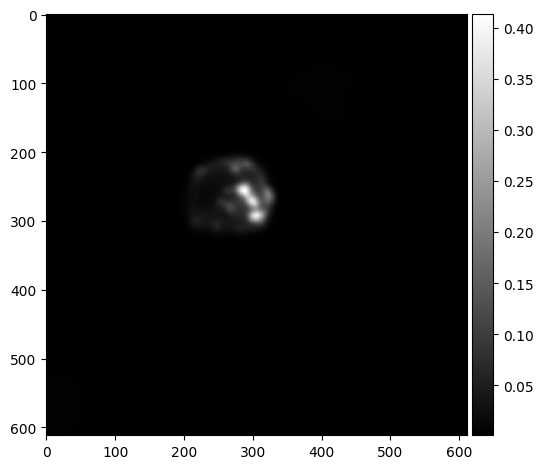

Segmented Cells


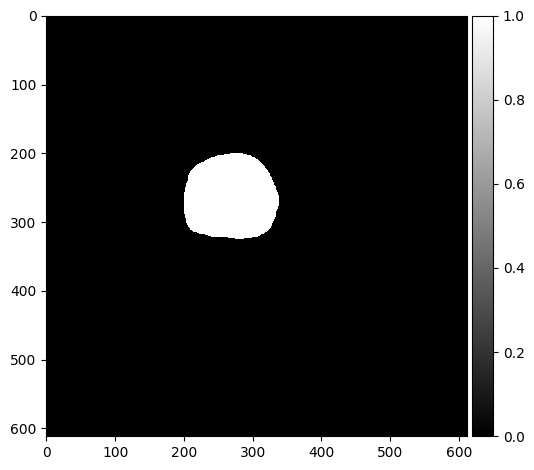

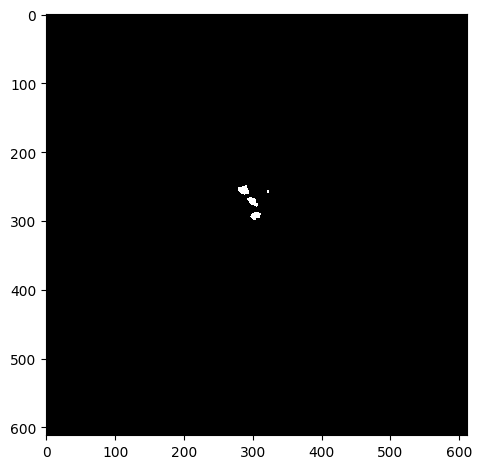

Cell 0: Number of inclusions: 4
Cell 0: Inclusion areas: [np.float64(156.0), np.float64(16.0), np.float64(132.0), np.float64(128.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_01.czi
Green Channel


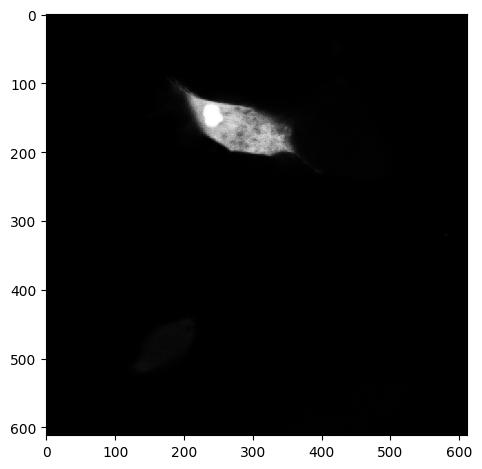

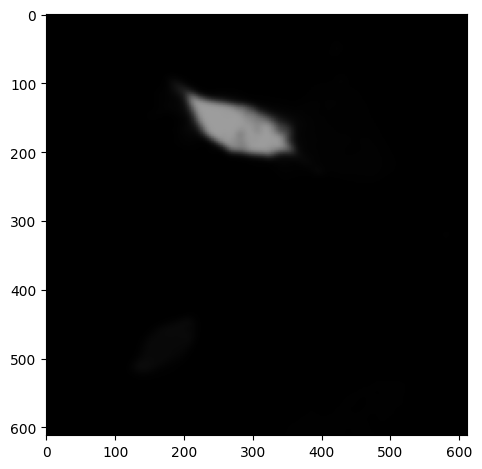

Segmented Cells


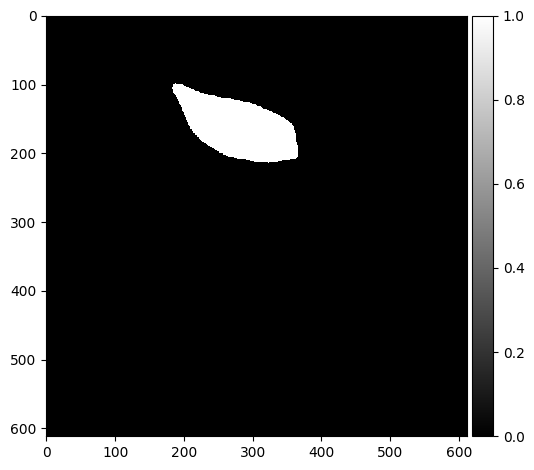

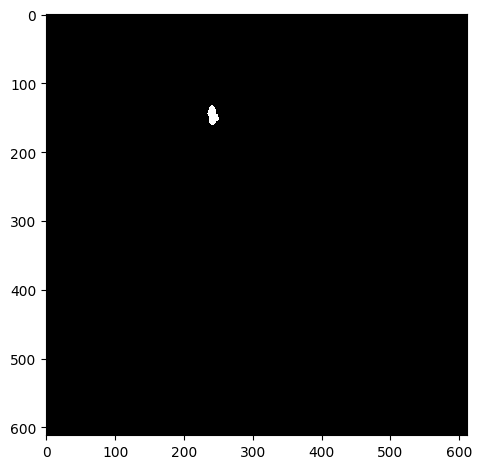

Cell 0: Number of inclusions: 1
Cell 0: Inclusion areas: [np.float64(305.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_02.czi
Green Channel


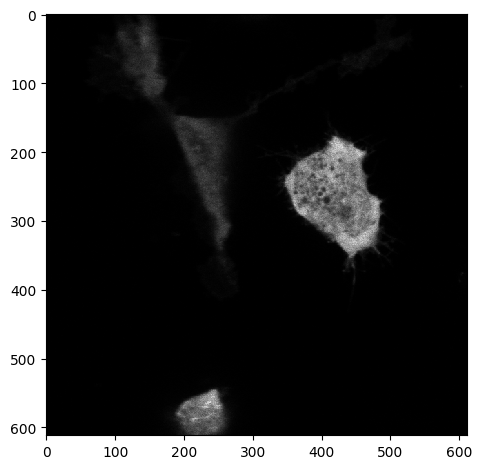

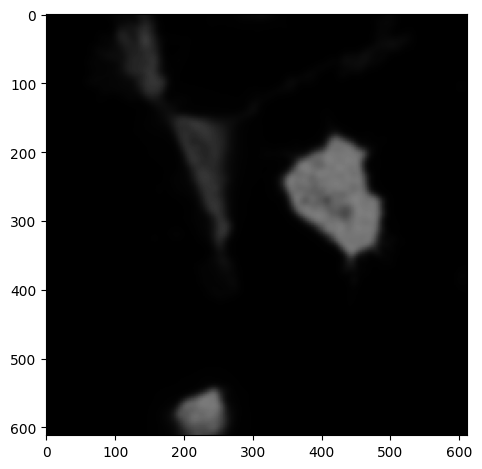

Segmented Cells


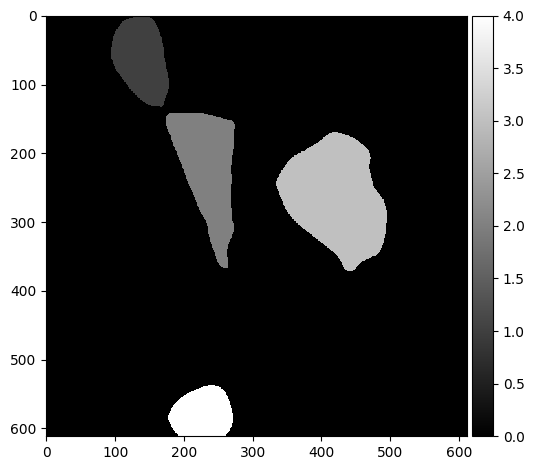

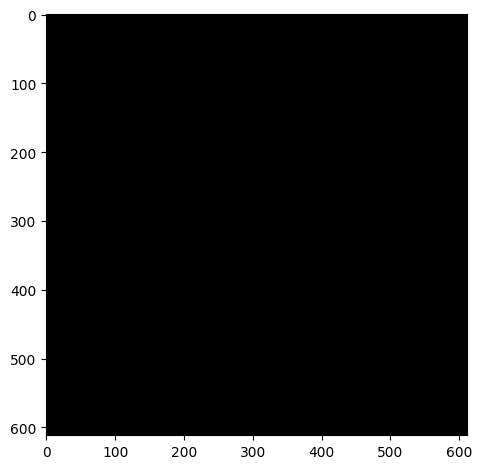

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


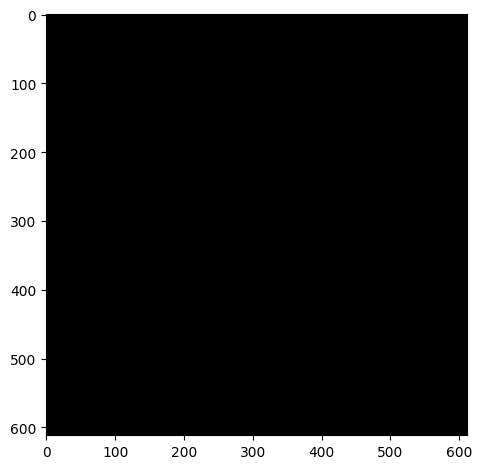

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


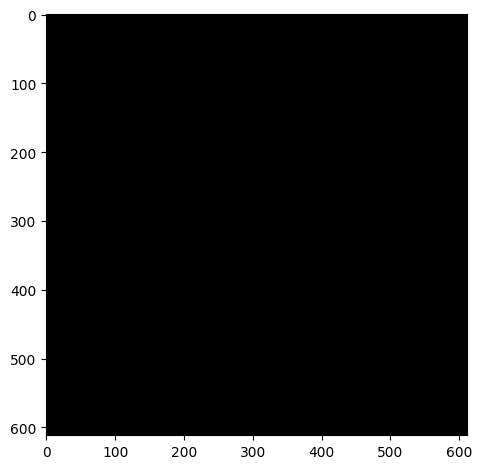

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


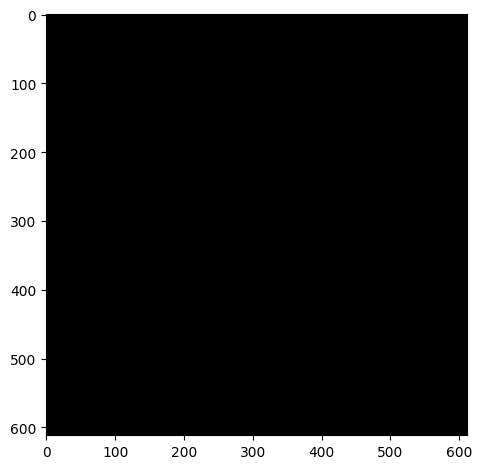

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_03.czi
Green Channel


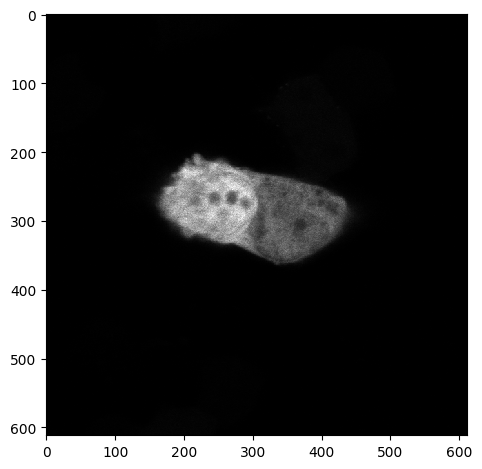

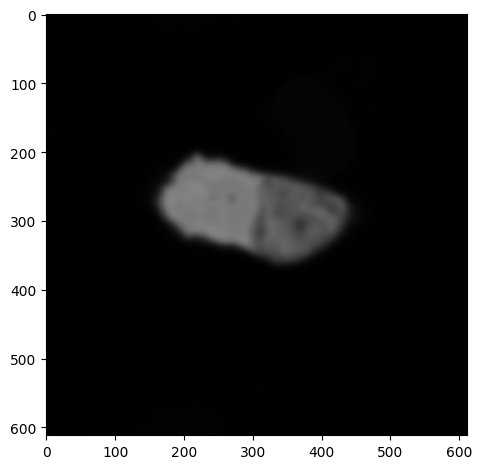

Segmented Cells


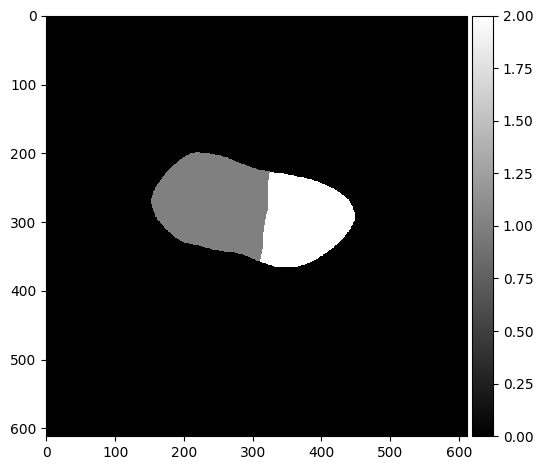

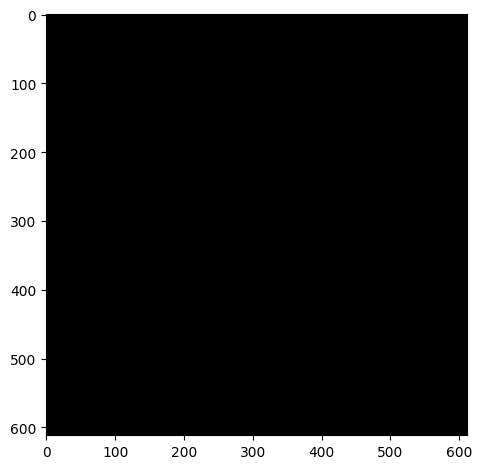

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


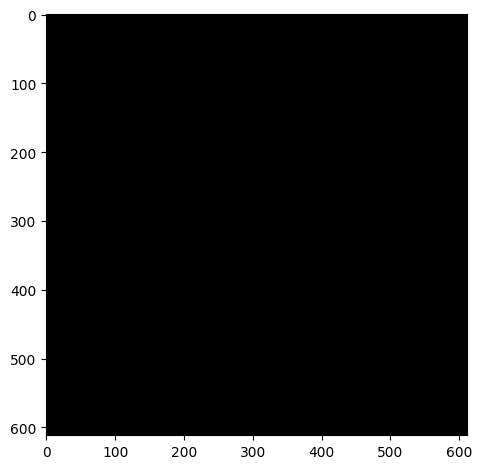

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_04.czi
Green Channel


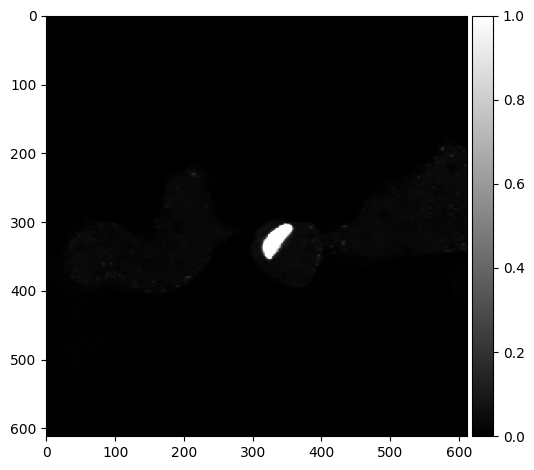

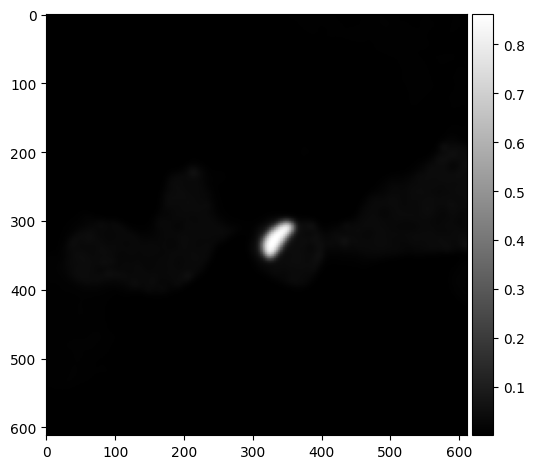

Segmented Cells


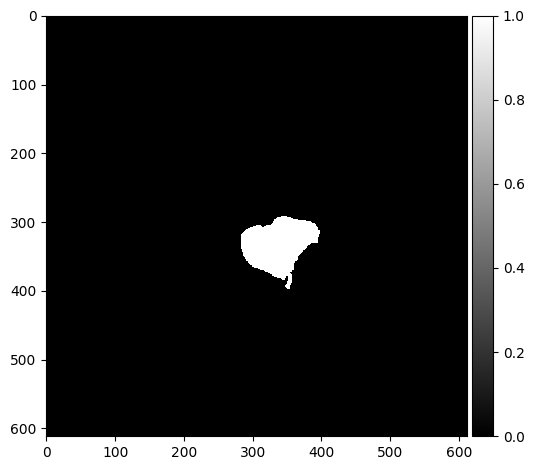

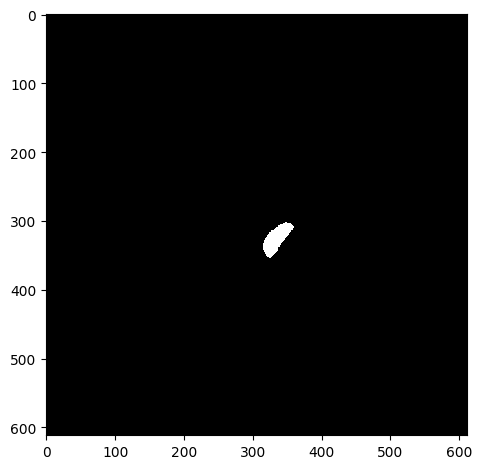

Cell 0: Number of inclusions: 1
Cell 0: Inclusion areas: [np.float64(1170.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_05.czi
Green Channel


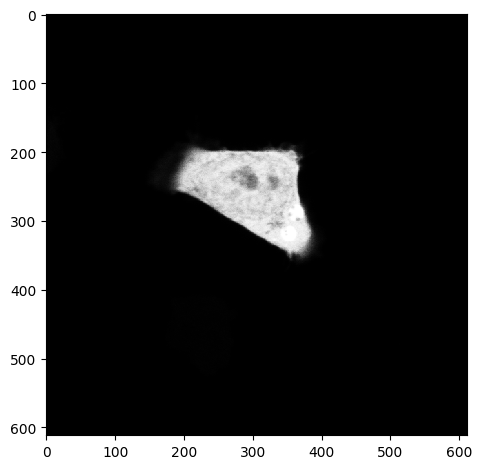

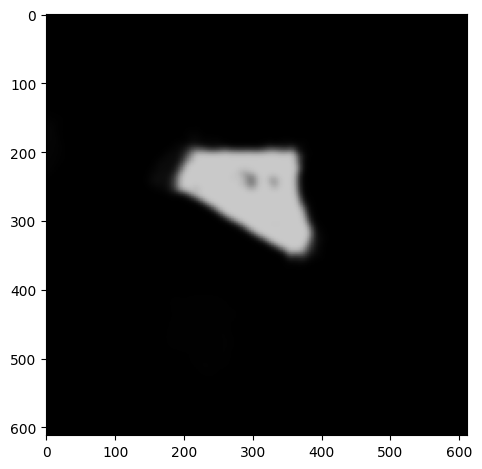

Segmented Cells


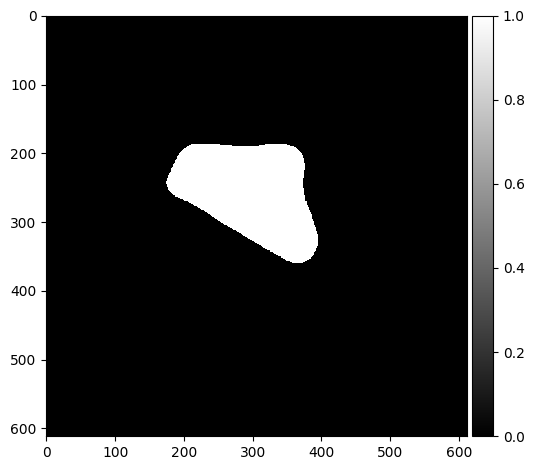

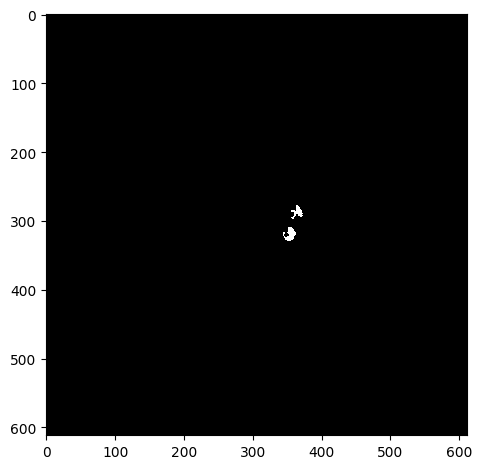

Cell 0: Number of inclusions: 2
Cell 0: Inclusion areas: [np.float64(160.0), np.float64(215.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_06.czi
Green Channel


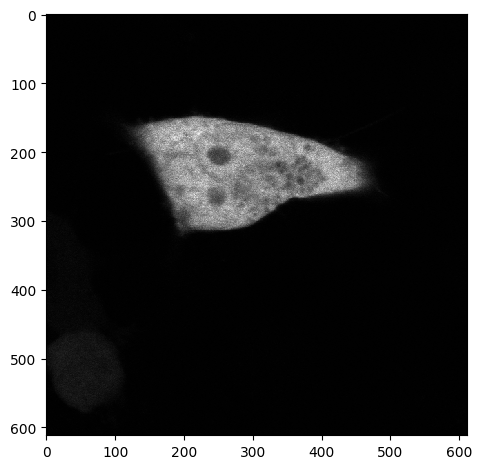

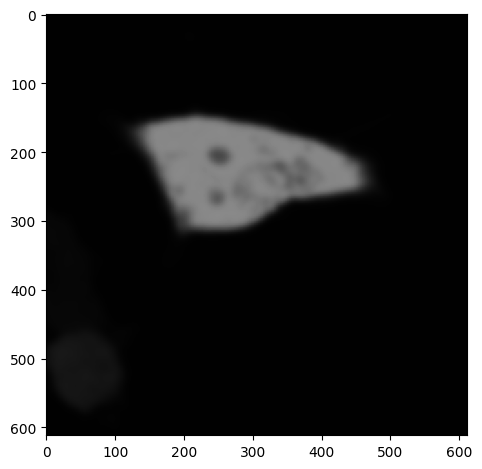

Segmented Cells


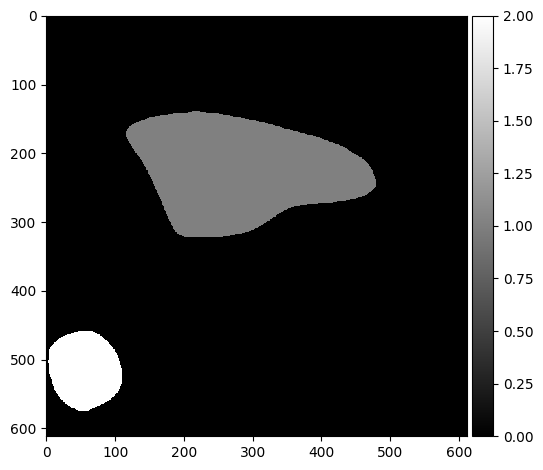

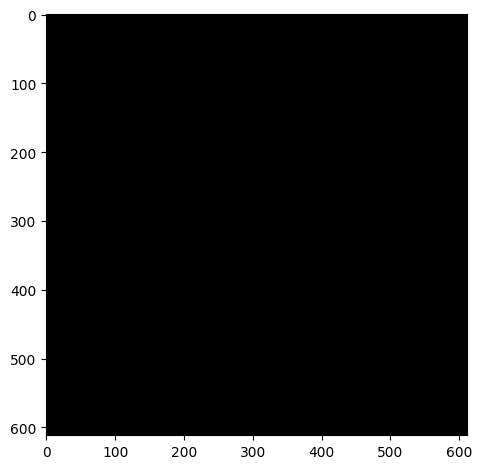

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


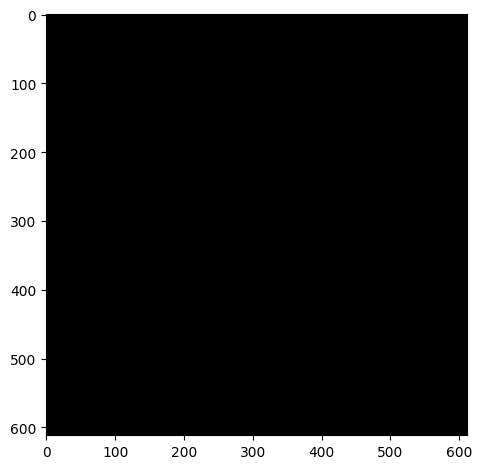

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_07.czi
Green Channel


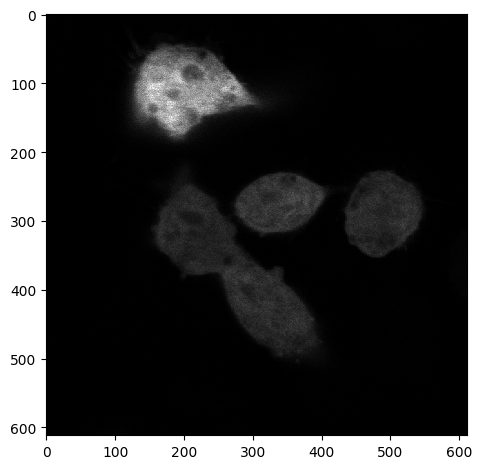

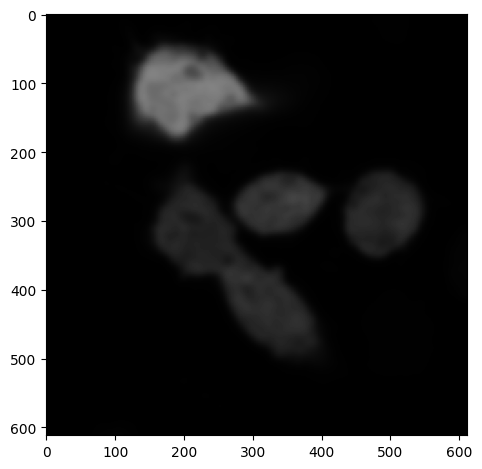

Segmented Cells


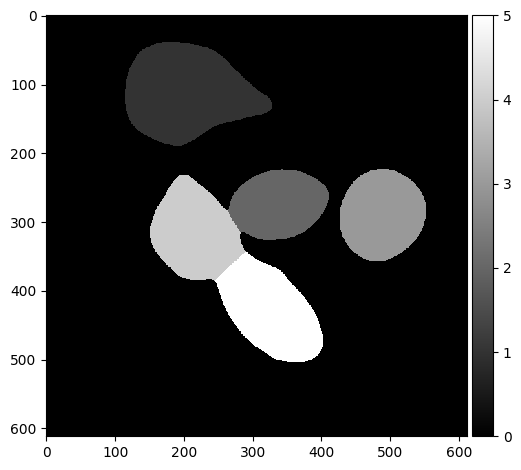

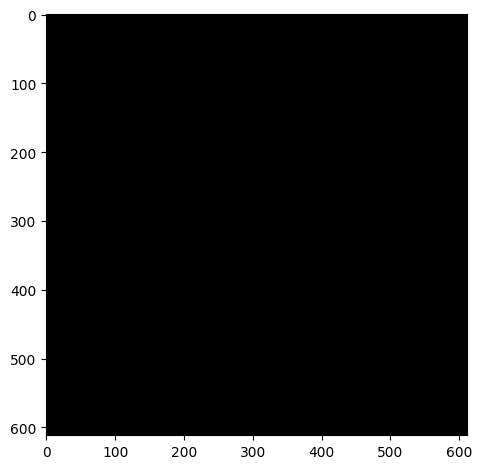

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


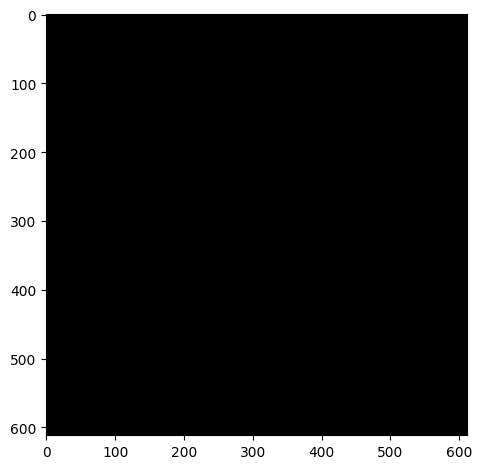

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


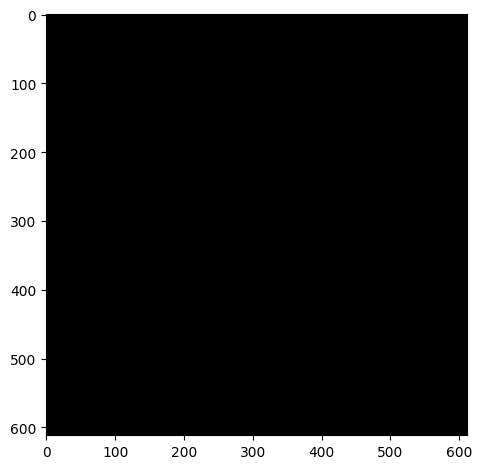

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


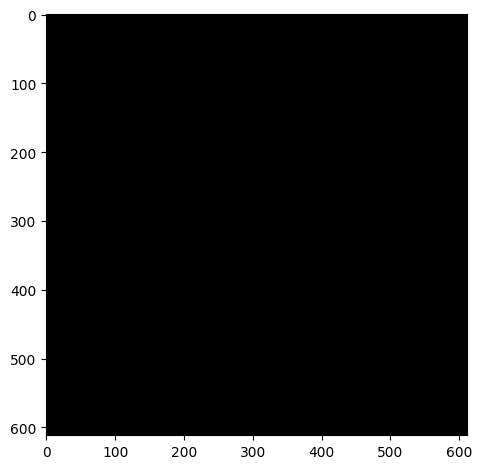

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []


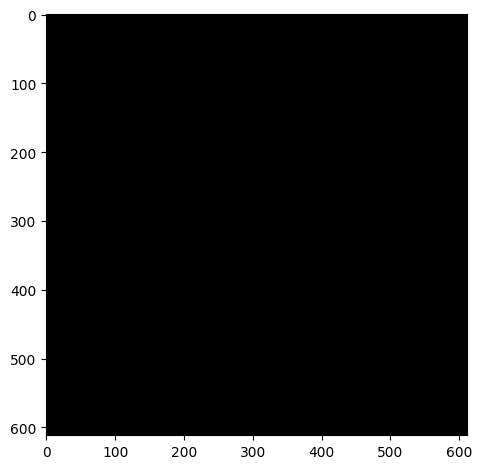

Cell 4: Number of inclusions: 0
Cell 4: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_08.czi
Green Channel


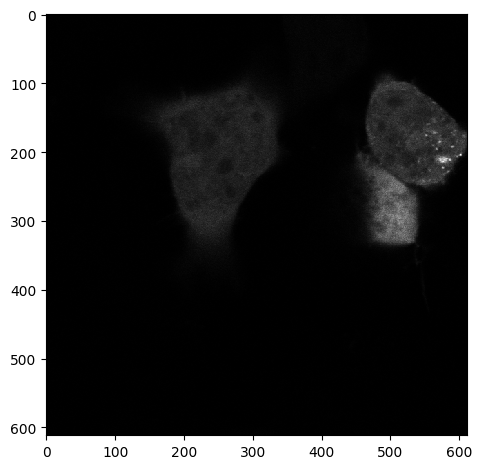

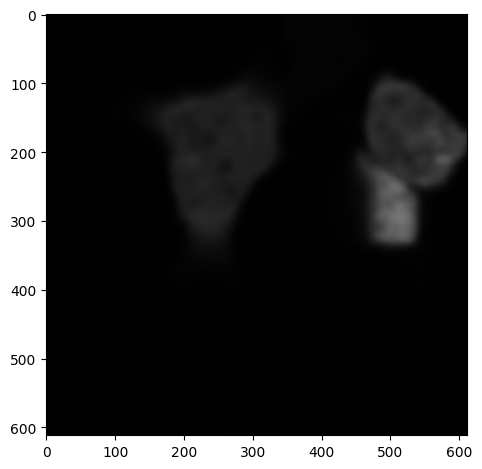

Segmented Cells


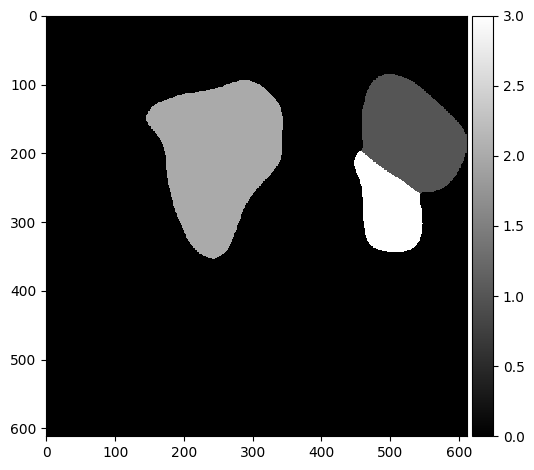

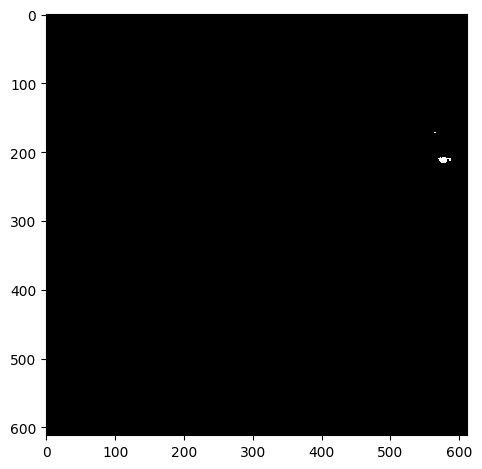

Cell 0: Number of inclusions: 2
Cell 0: Inclusion areas: [np.float64(10.0), np.float64(92.0)]


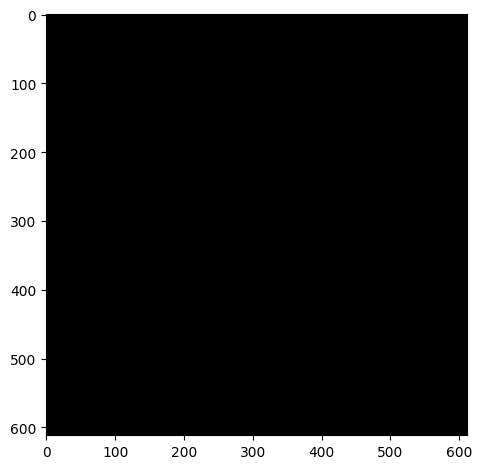

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


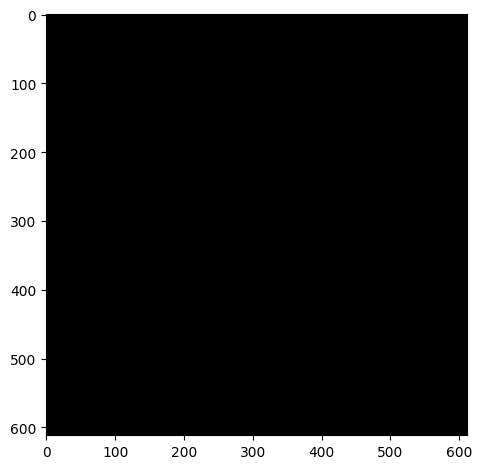

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_09.czi
Green Channel


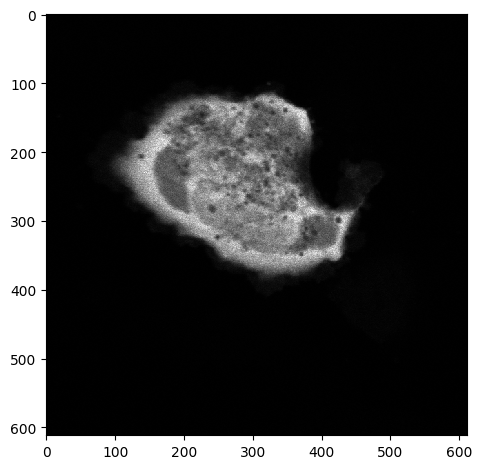

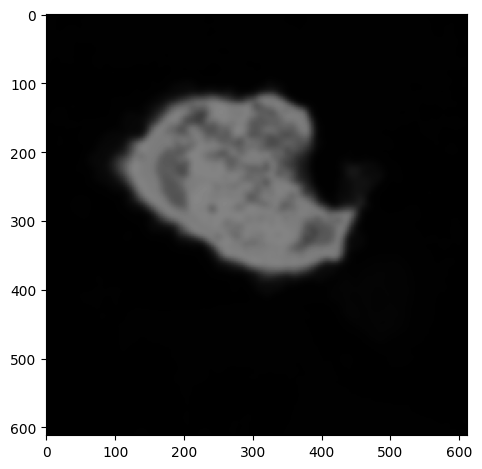

Segmented Cells


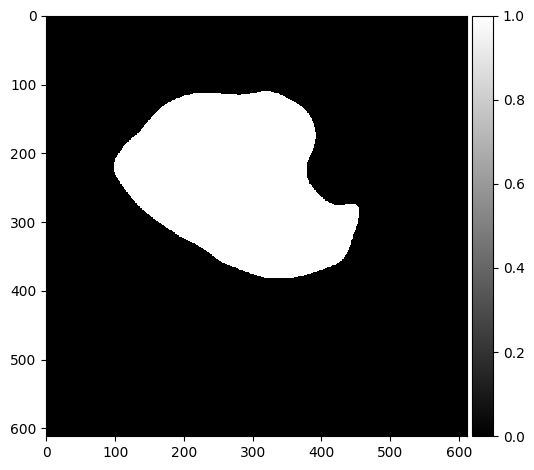

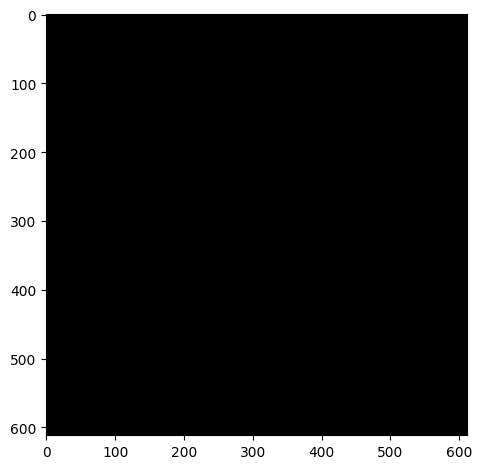

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_10.czi
Green Channel


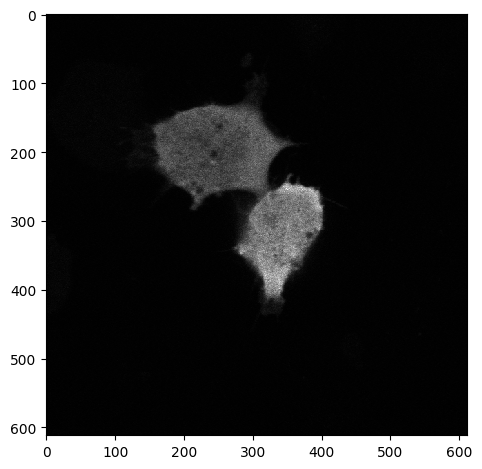

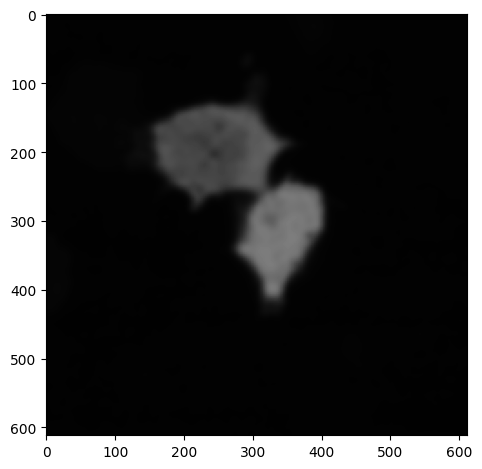

Segmented Cells


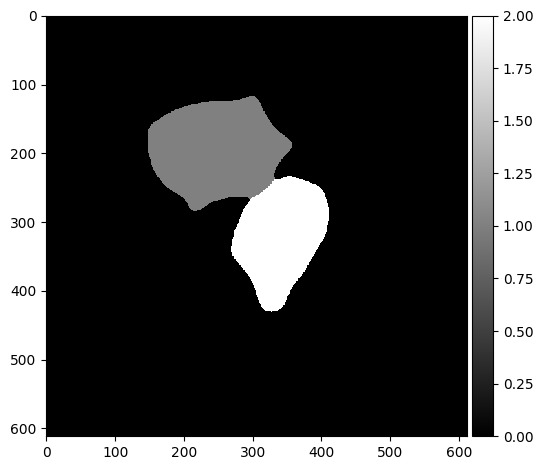

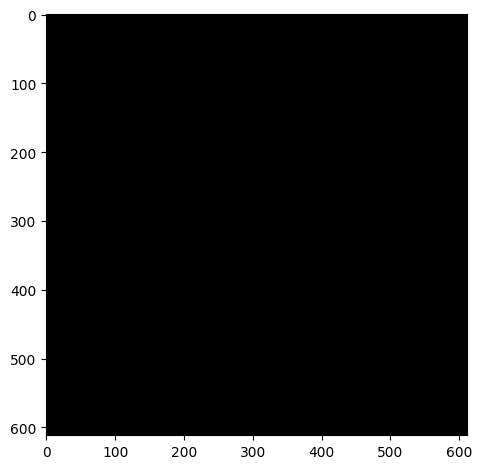

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


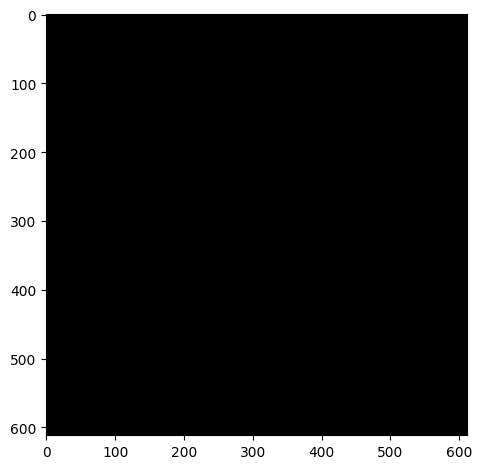

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_01.czi
Green Channel


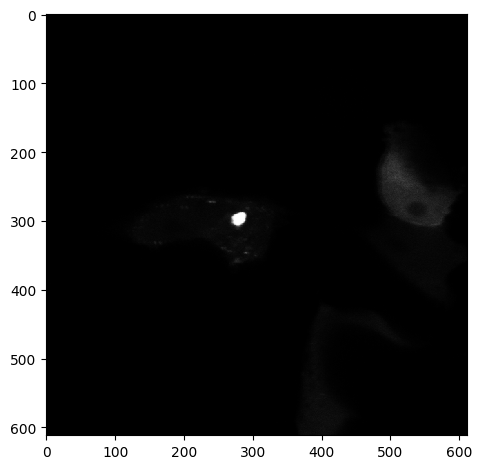

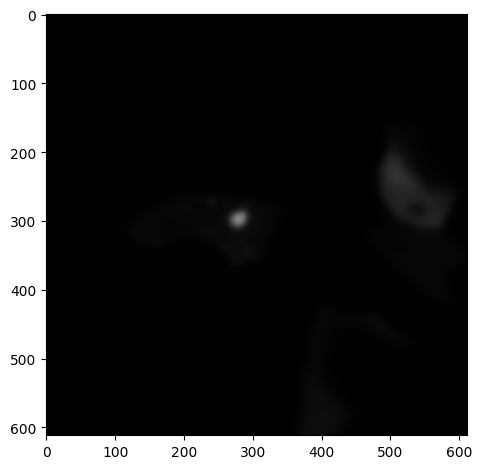

Segmented Cells


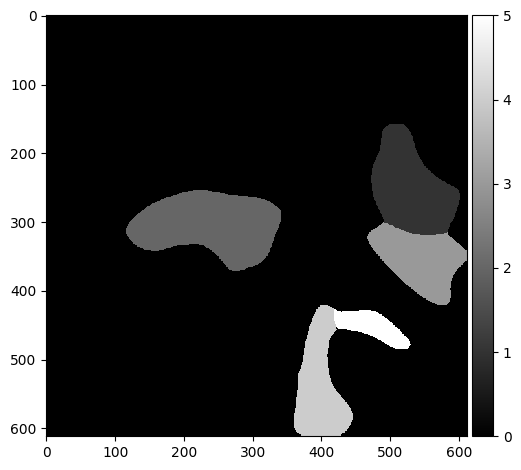

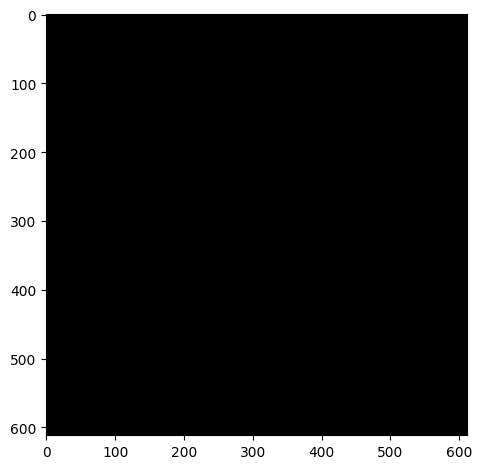

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


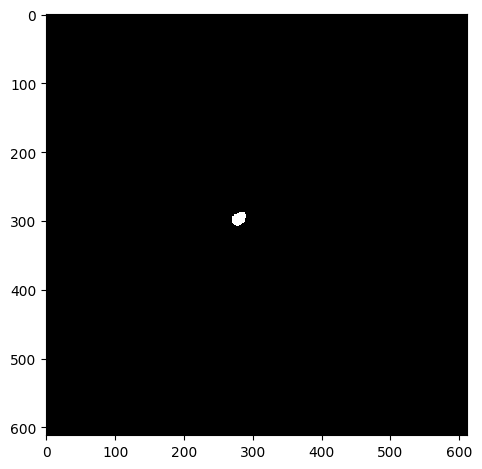

Cell 1: Number of inclusions: 1
Cell 1: Inclusion areas: [np.float64(311.0)]


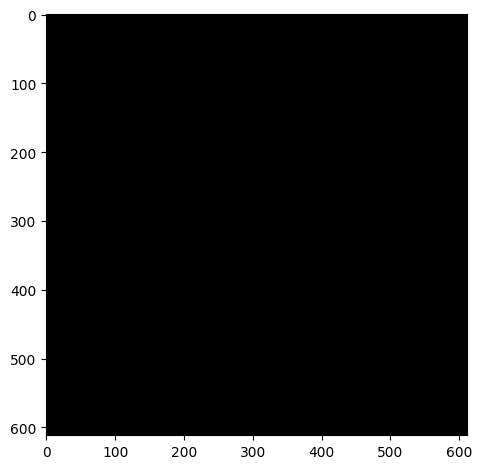

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


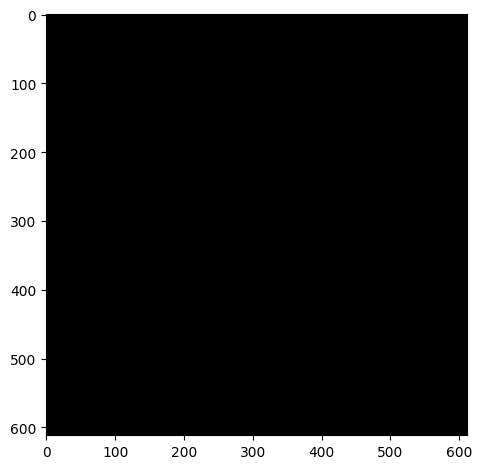

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []


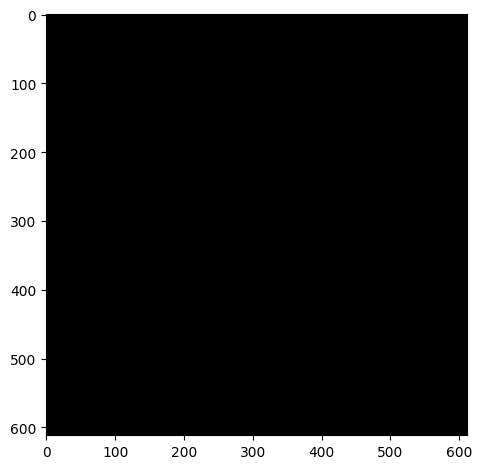

Cell 4: Number of inclusions: 0
Cell 4: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_02.czi
Green Channel


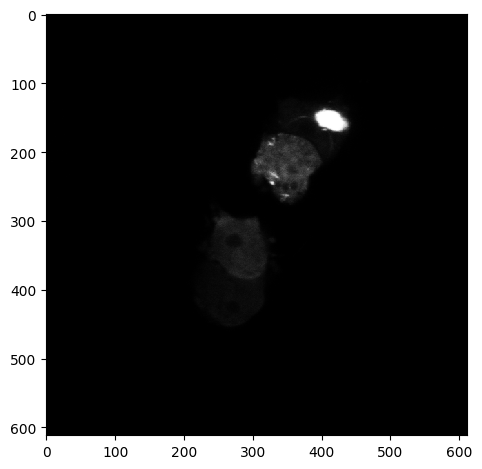

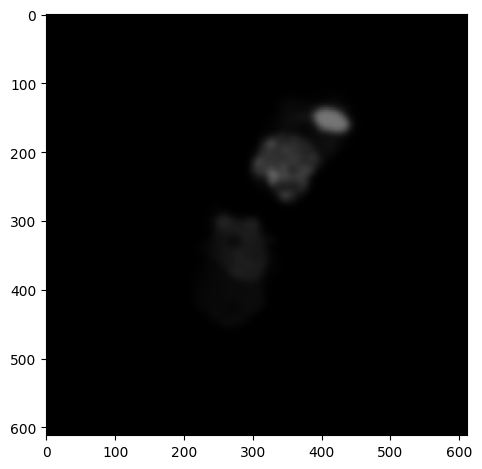

Segmented Cells


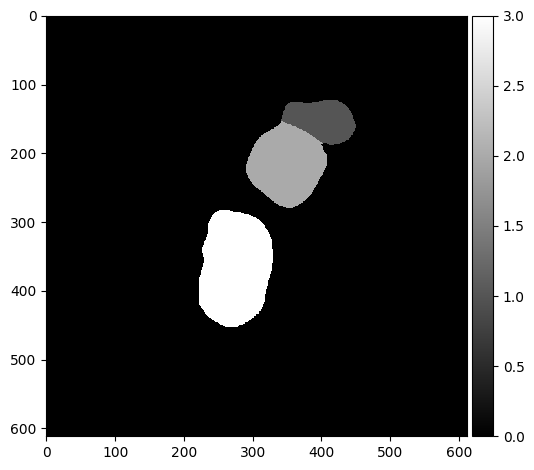

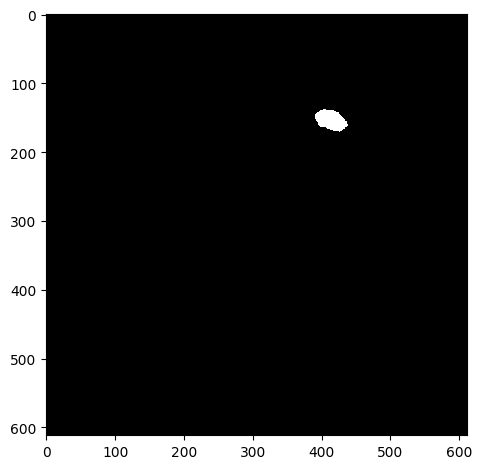

Cell 0: Number of inclusions: 1
Cell 0: Inclusion areas: [np.float64(1066.0)]


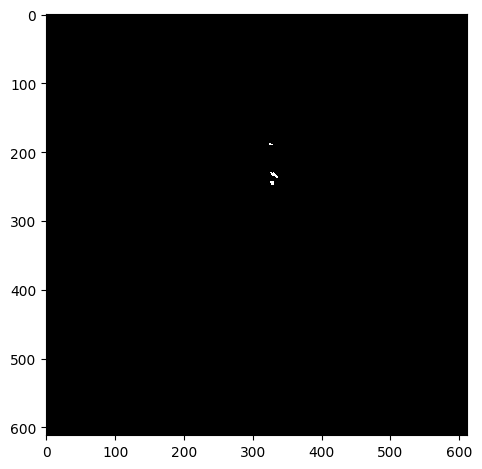

Cell 1: Number of inclusions: 3
Cell 1: Inclusion areas: [np.float64(13.0), np.float64(48.0), np.float64(25.0)]


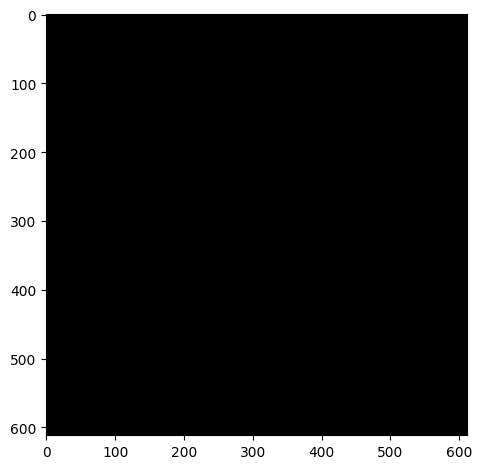

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_03.czi
Green Channel


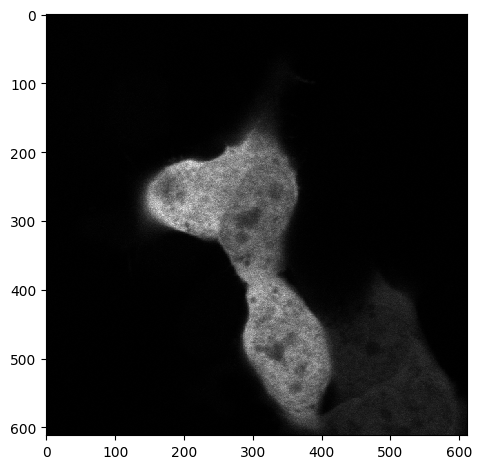

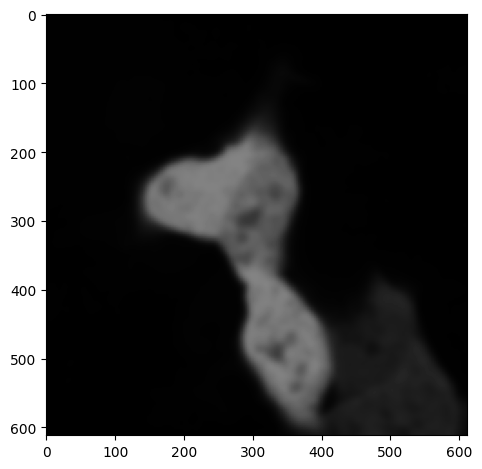

Segmented Cells


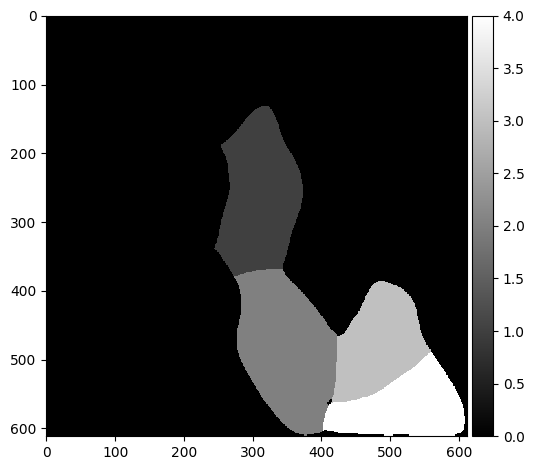

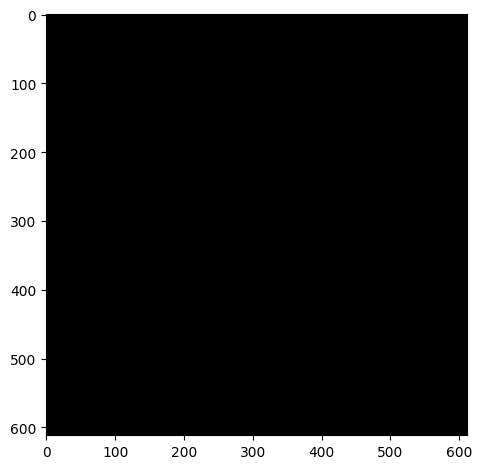

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


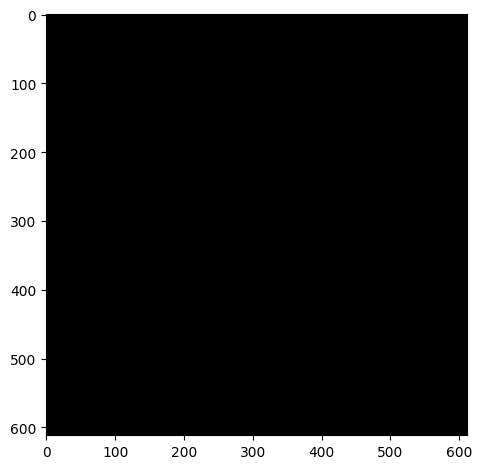

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


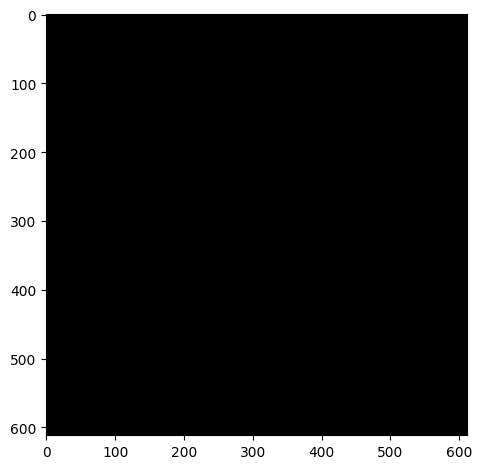

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


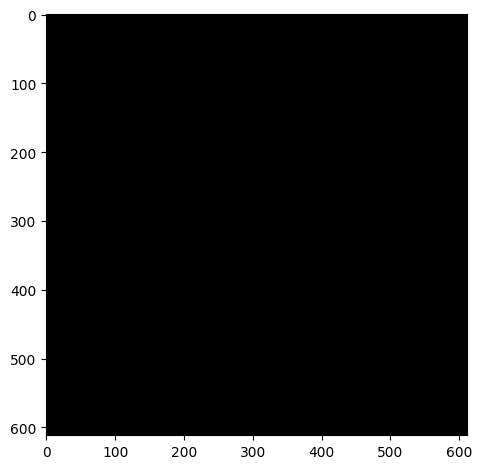

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_04.czi
Green Channel


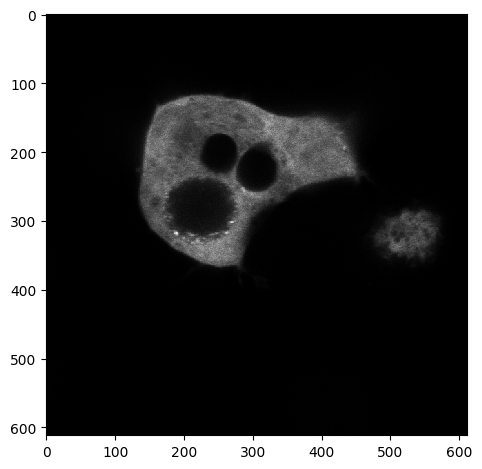

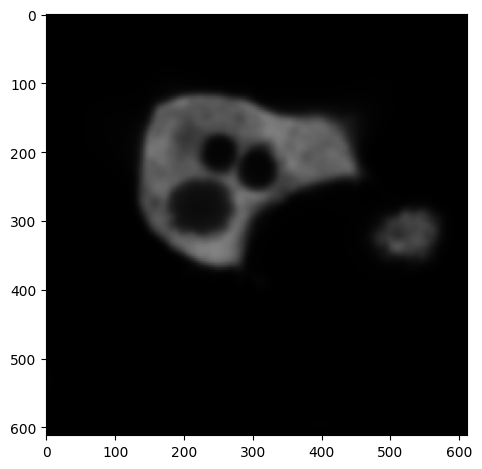

Segmented Cells


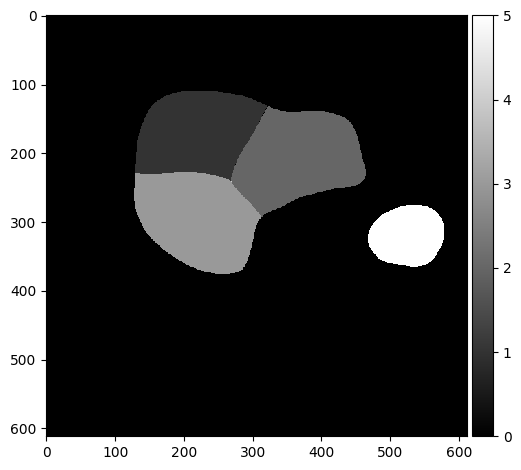

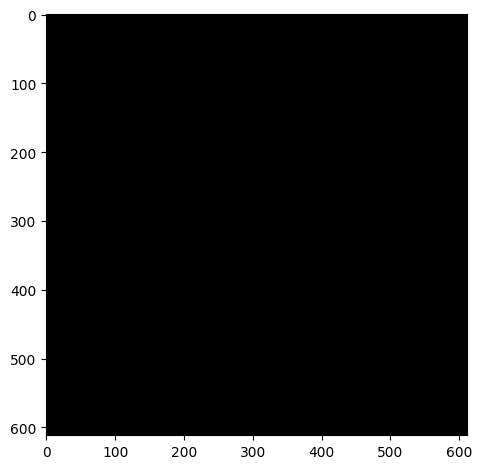

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


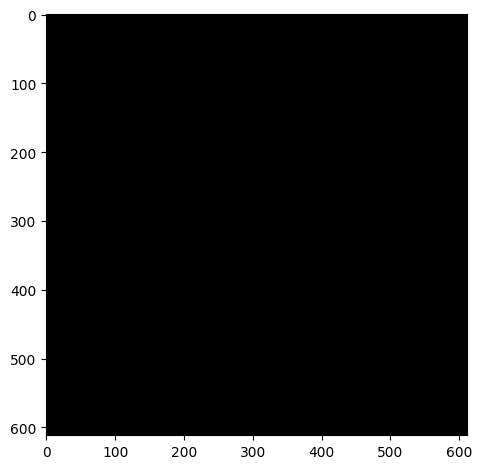

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


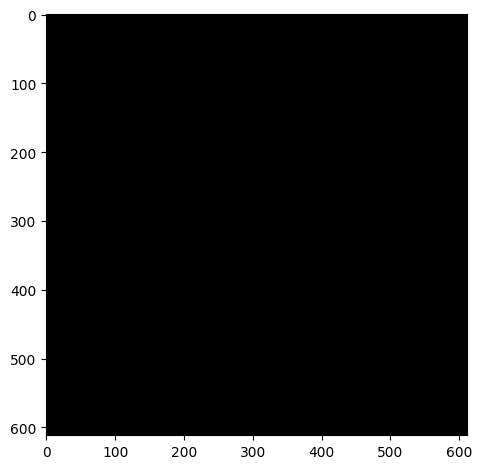

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


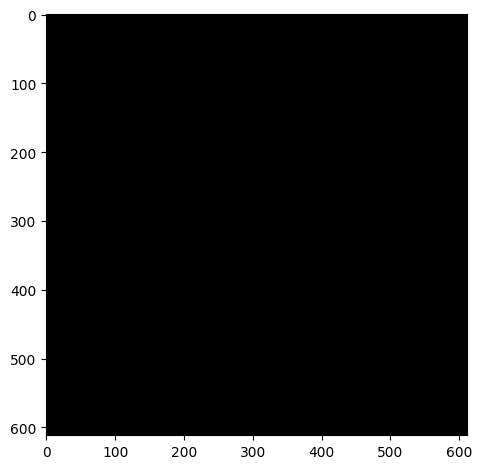

Cell 4: Number of inclusions: 0
Cell 4: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_05.czi
Green Channel


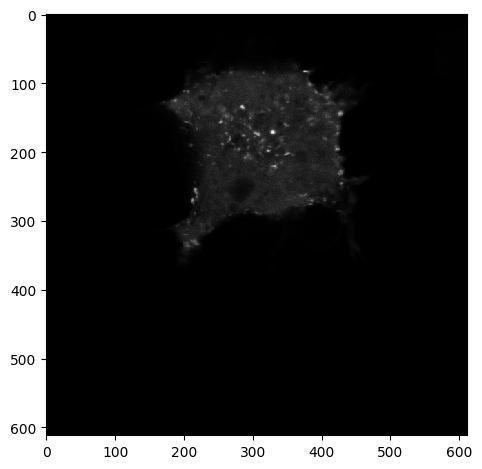

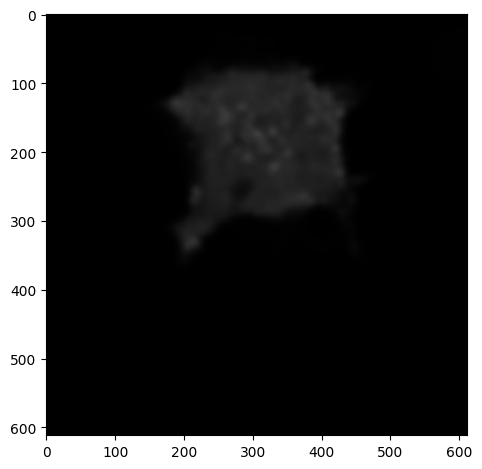

Segmented Cells


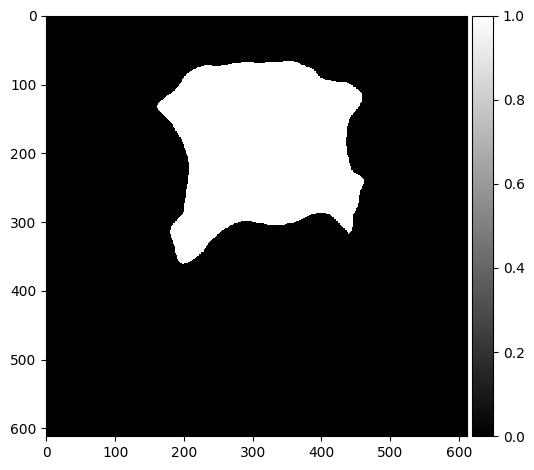

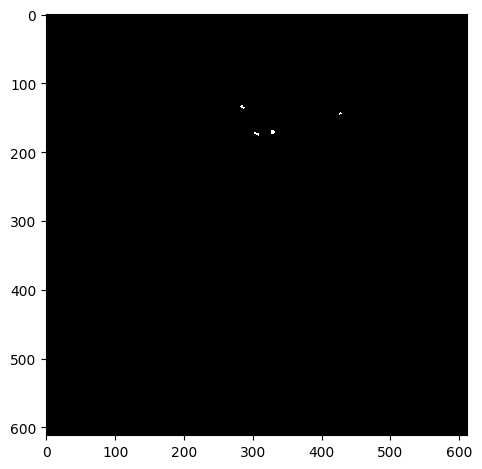

Cell 0: Number of inclusions: 4
Cell 0: Inclusion areas: [np.float64(19.0), np.float64(11.0), np.float64(28.0), np.float64(21.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_06.czi
Green Channel


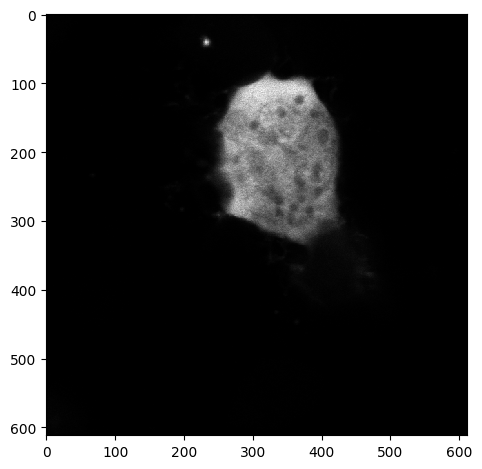

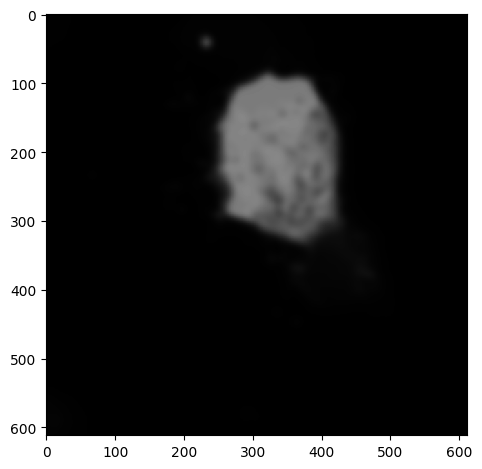

Segmented Cells


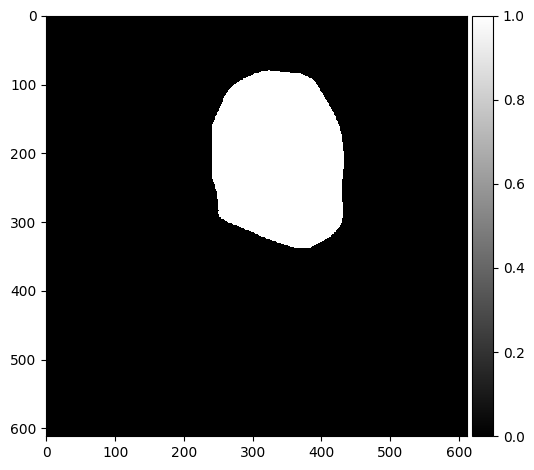

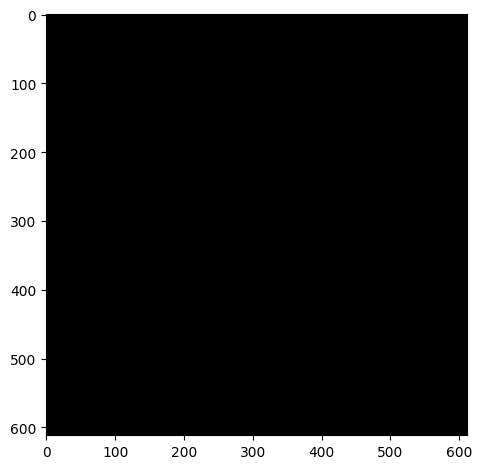

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_07.czi
Green Channel


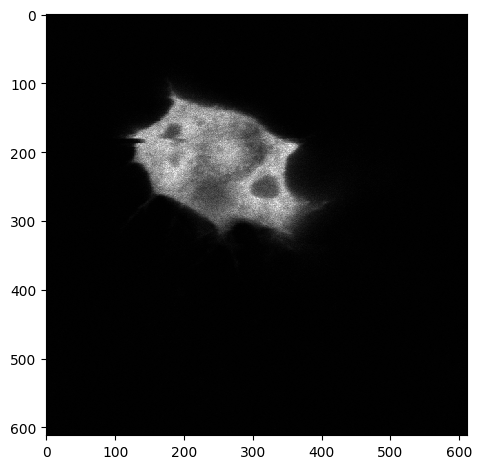

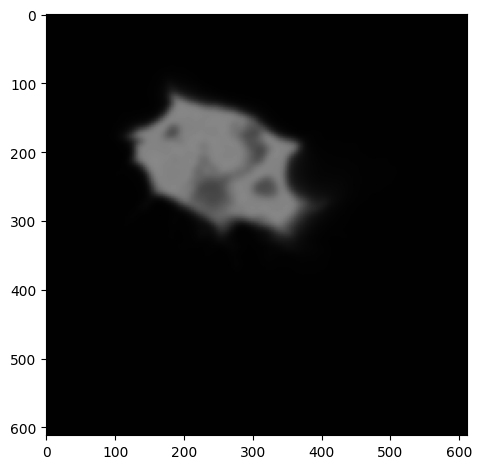

Segmented Cells


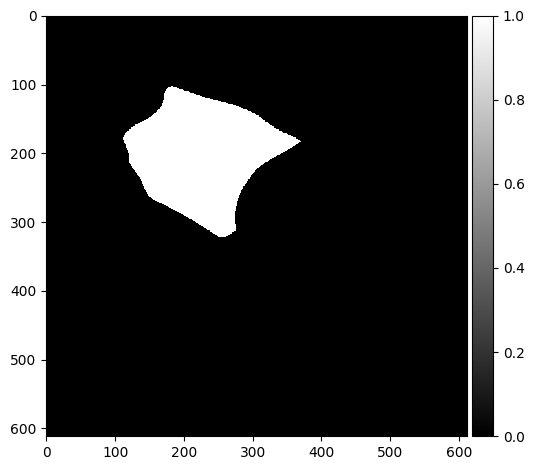

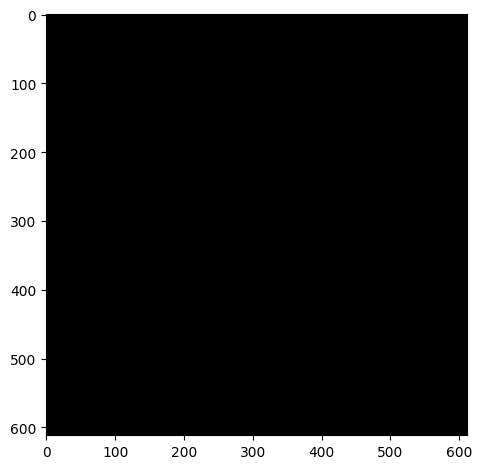

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_08.czi
Green Channel


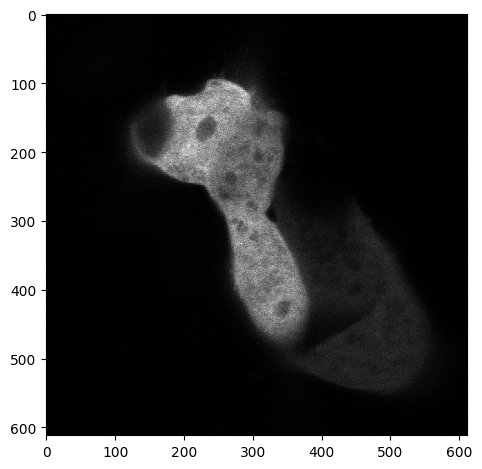

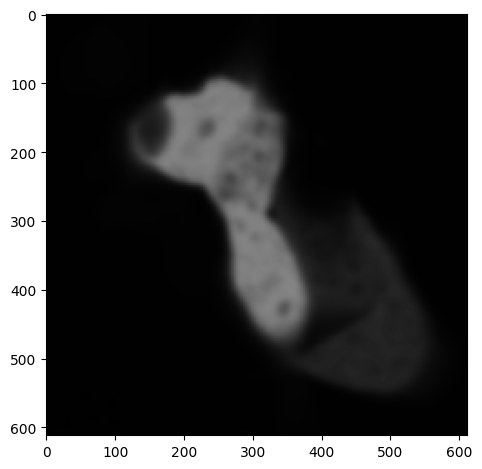

Segmented Cells


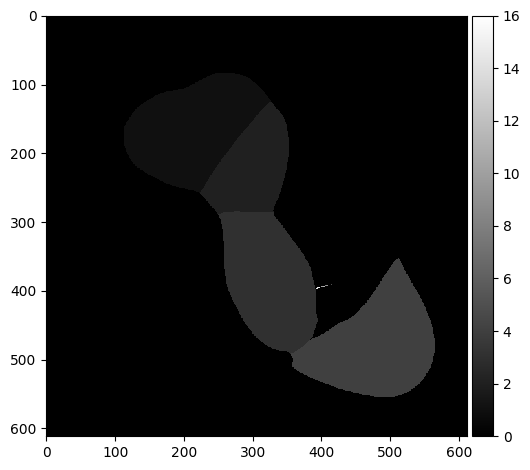

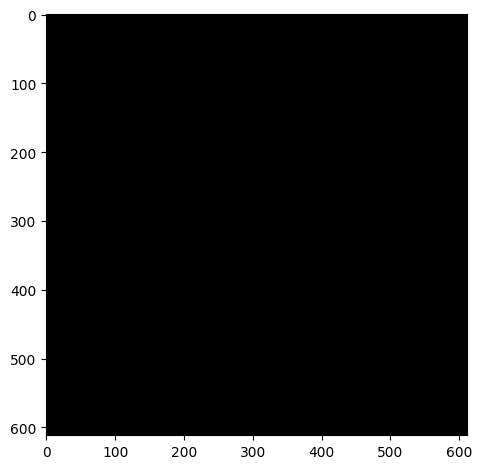

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


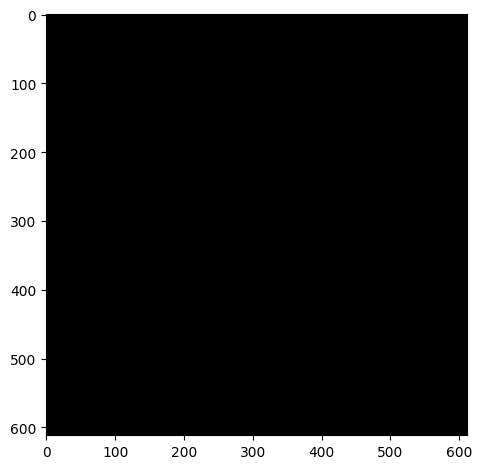

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


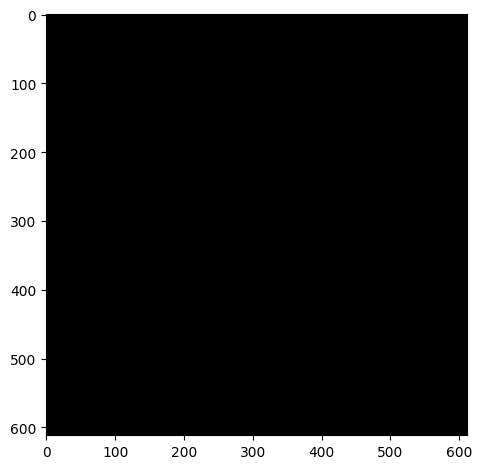

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


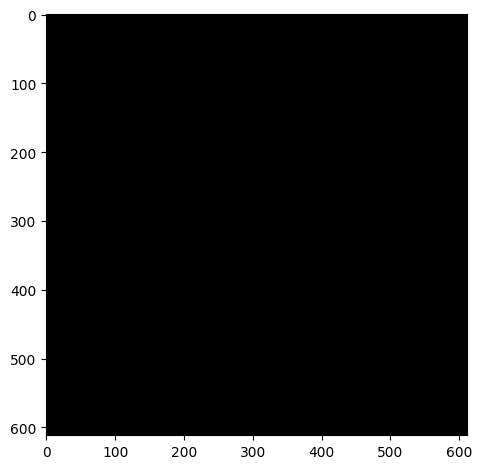

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_09.czi
Green Channel


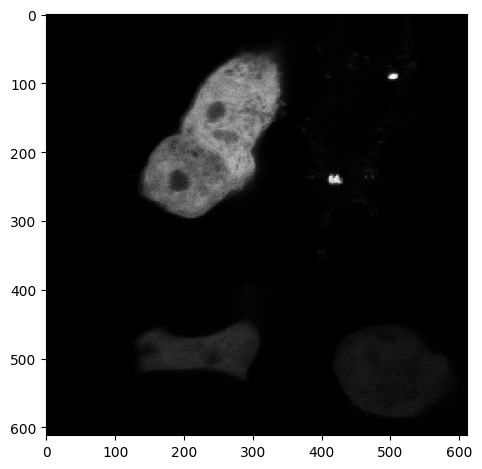

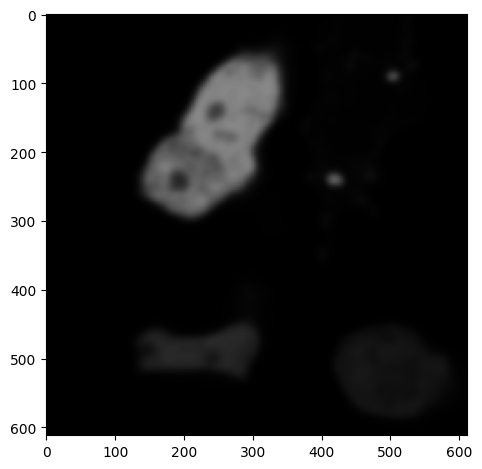

Segmented Cells


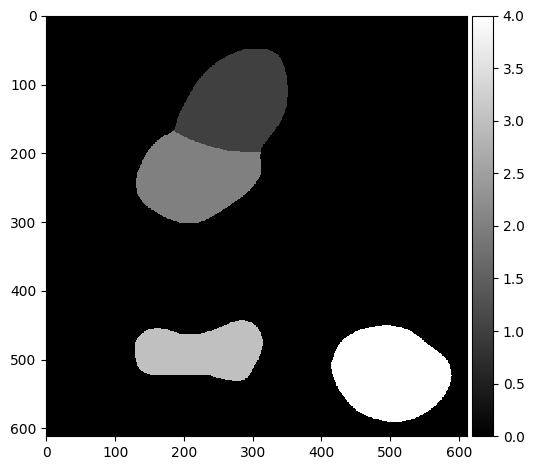

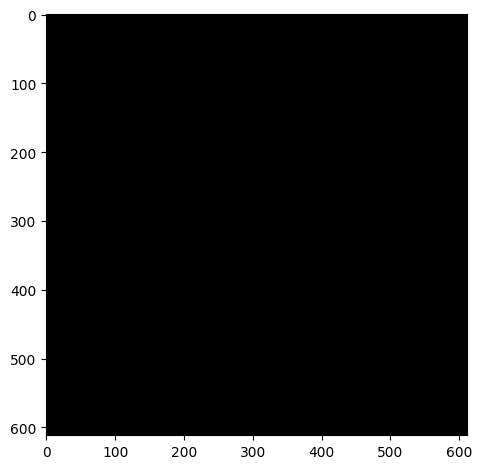

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


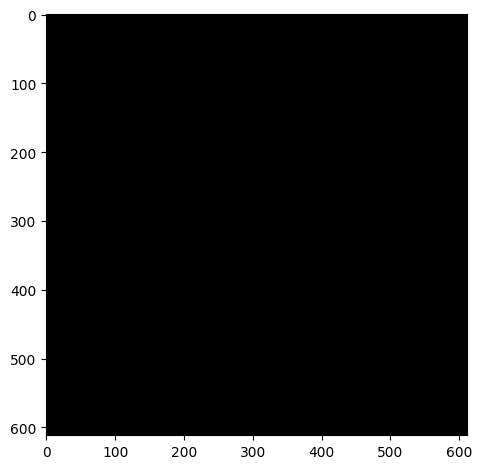

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


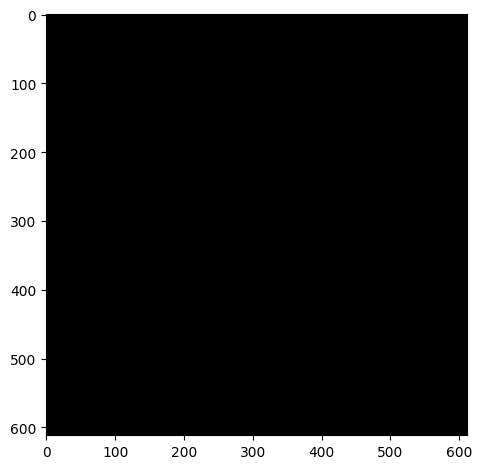

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


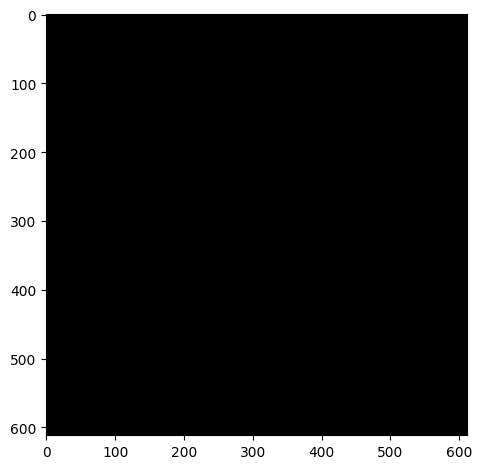

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_TAX1BP1_10.czi
Green Channel


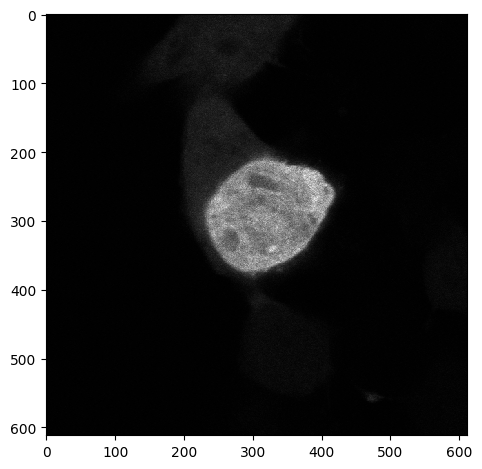

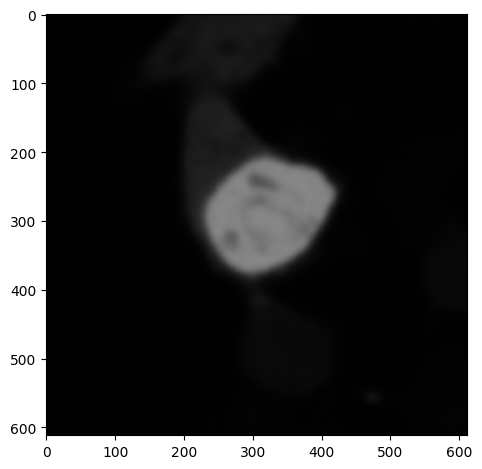

Segmented Cells


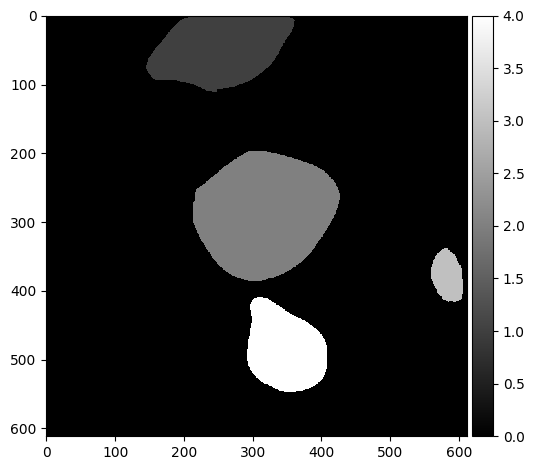

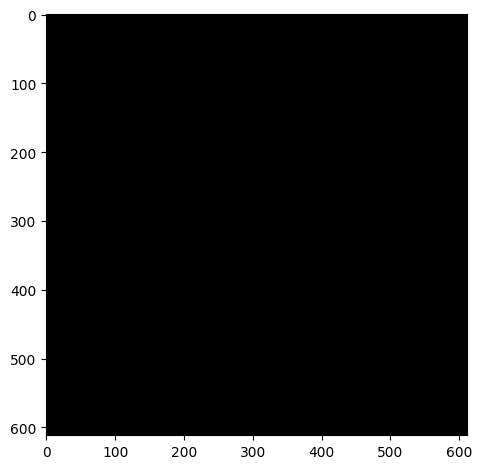

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


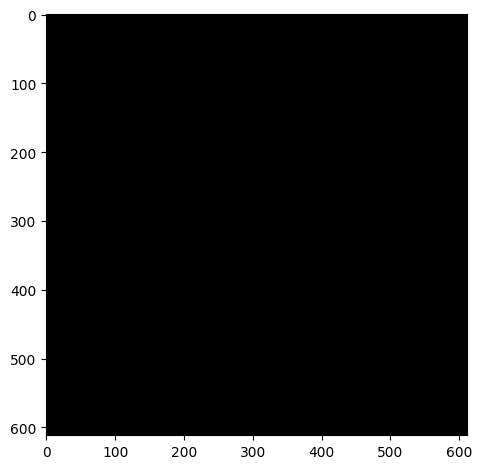

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


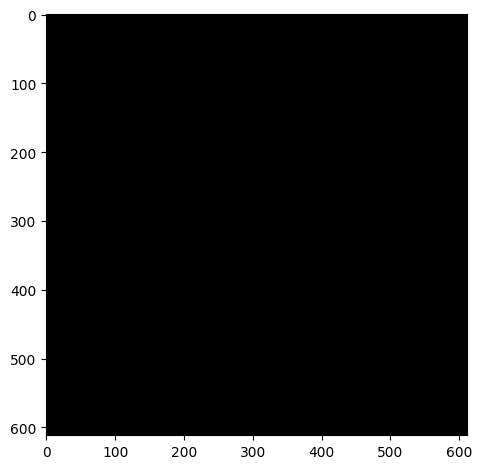

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


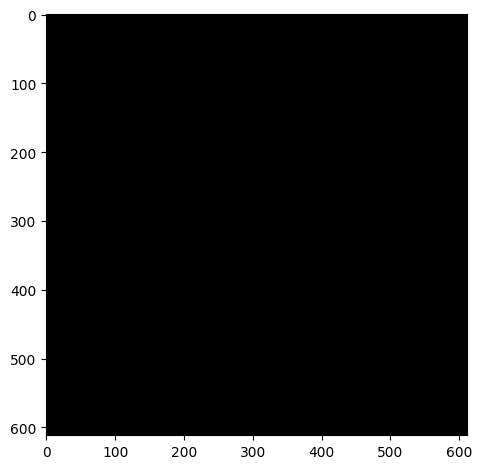

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_ADAMTS19_01.czi
Green Channel


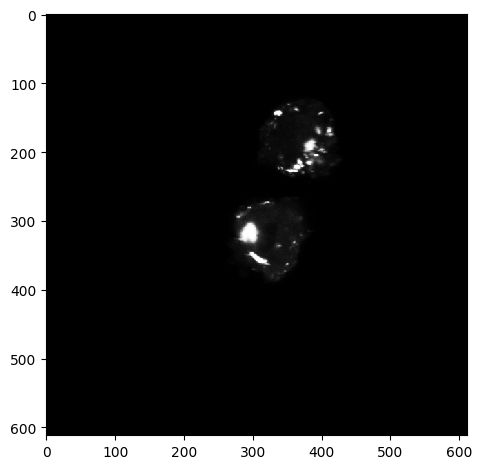

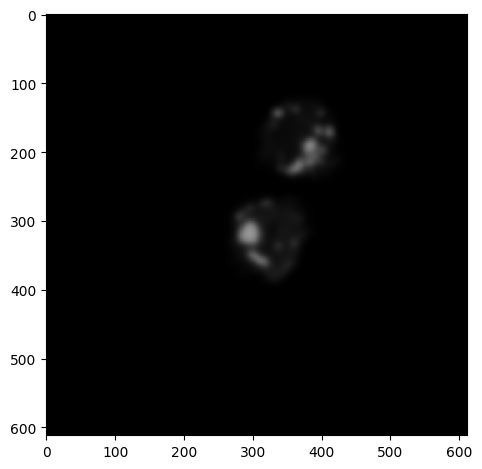

Segmented Cells


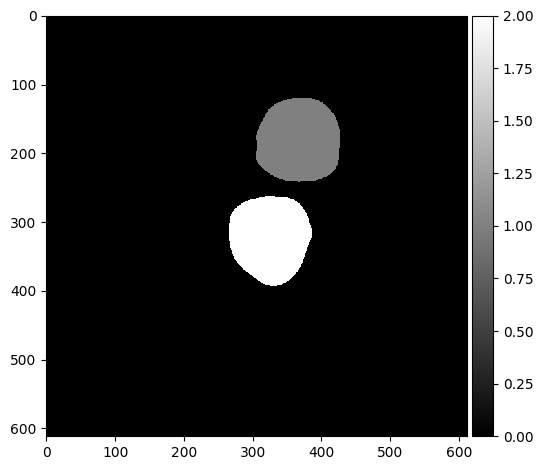

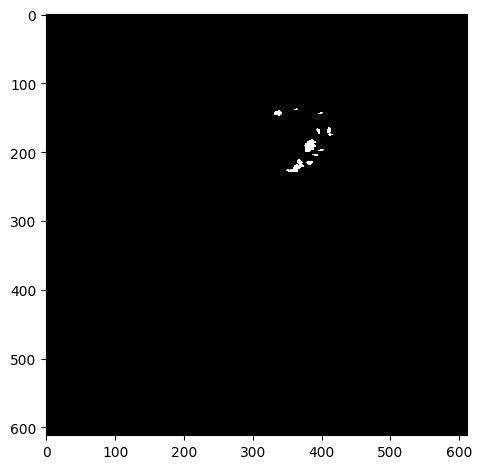

Cell 0: Number of inclusions: 10
Cell 0: Inclusion areas: [np.float64(12.0), np.float64(73.0), np.float64(15.0), np.float64(64.0), np.float64(36.0), np.float64(212.0), np.float64(18.0), np.float64(30.0), np.float64(200.0), np.float64(51.0)]


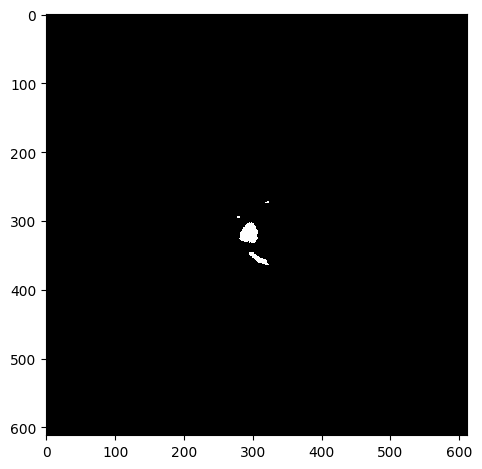

Cell 1: Number of inclusions: 4
Cell 1: Inclusion areas: [np.float64(15.0), np.float64(12.0), np.float64(587.0), np.float64(208.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_ADAMTS19_02.czi
Green Channel


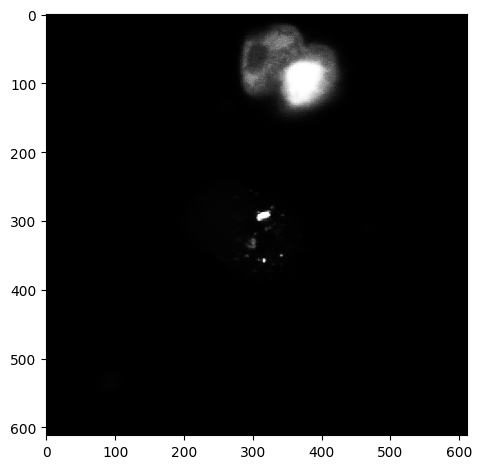

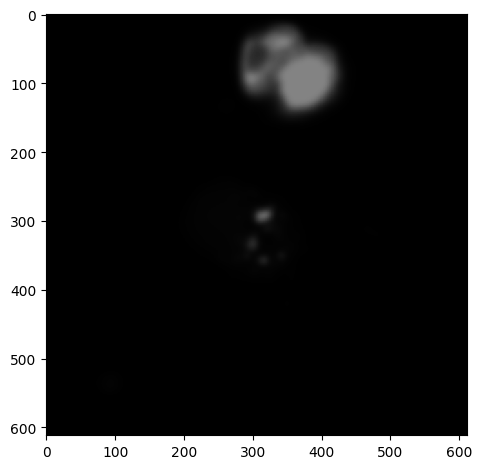

Segmented Cells


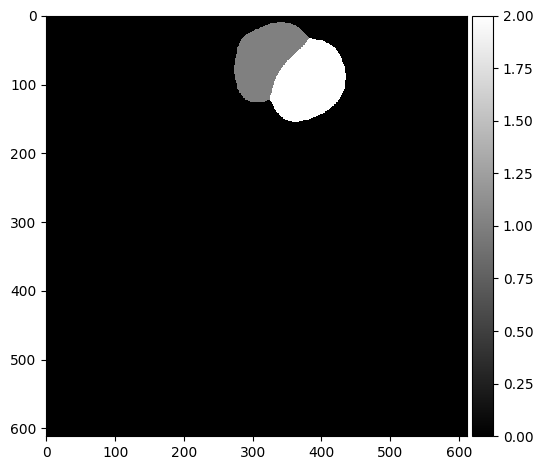

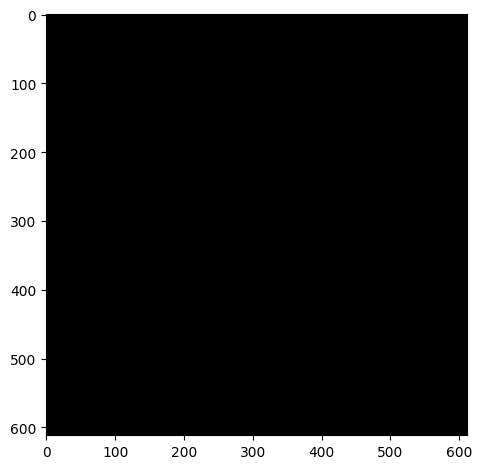

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


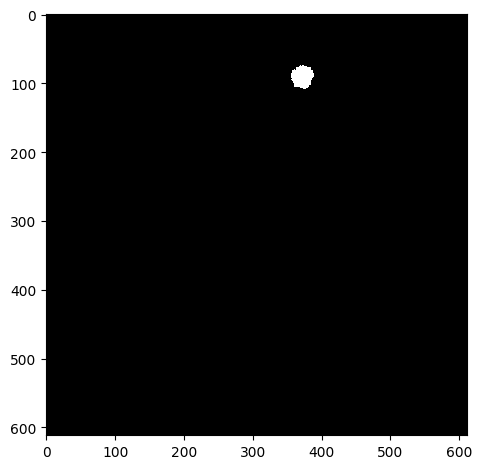

Cell 1: Number of inclusions: 1
Cell 1: Inclusion areas: [np.float64(851.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_ADAMTS19_03.czi
Green Channel


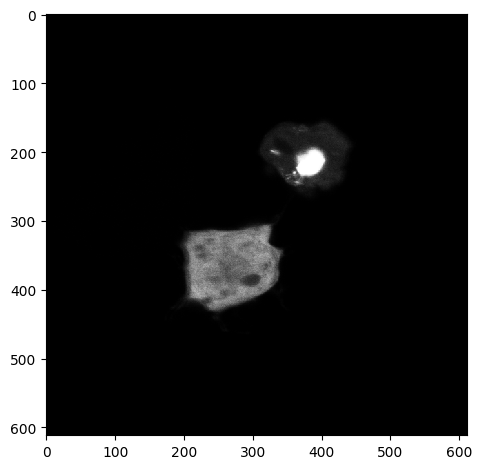

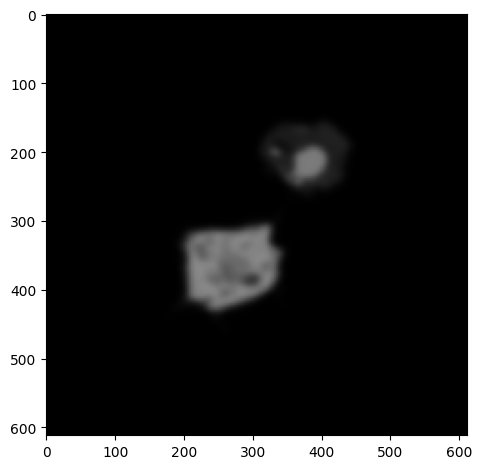

Segmented Cells


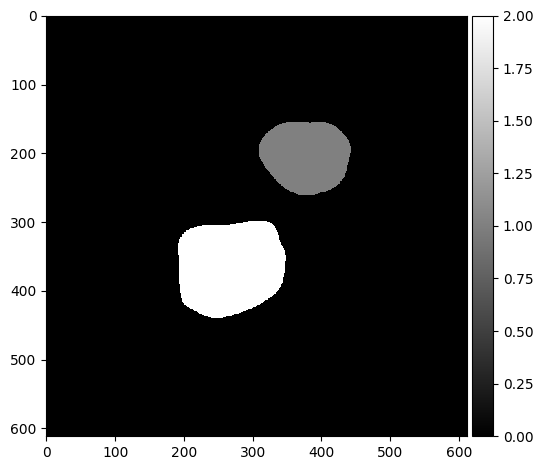

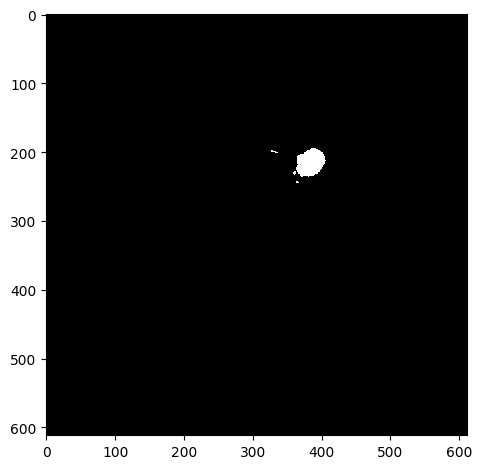

Cell 0: Number of inclusions: 4
Cell 0: Inclusion areas: [np.float64(1324.0), np.float64(20.0), np.float64(22.0), np.float64(11.0)]


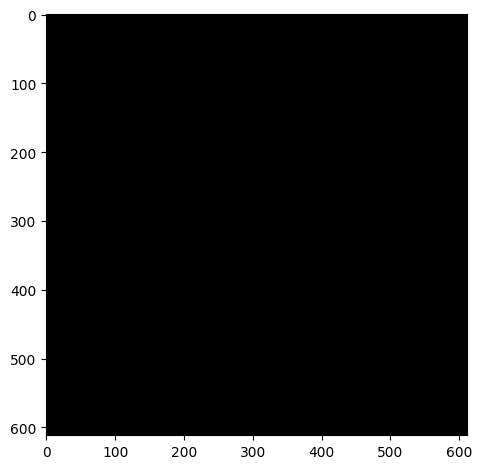

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_ADAMTS19_04.czi
Green Channel


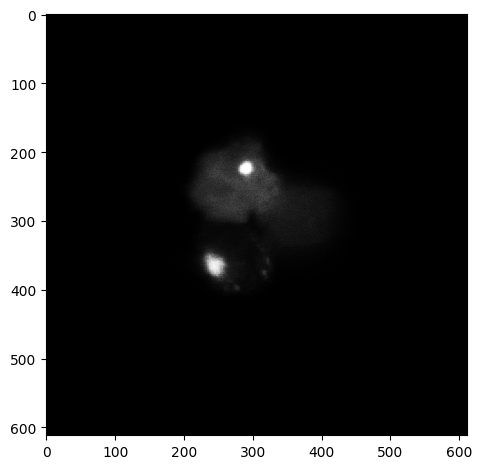

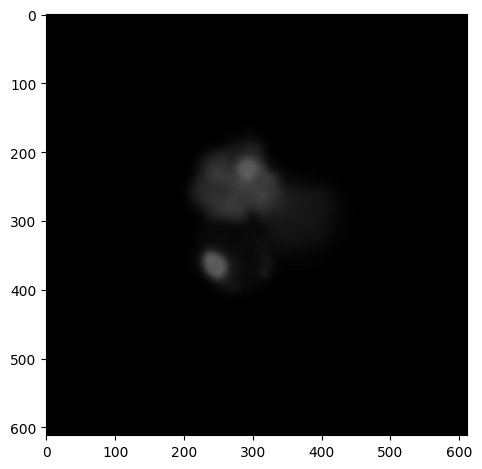

Segmented Cells


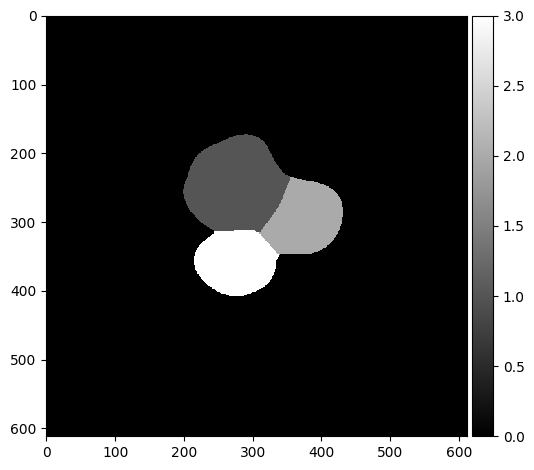

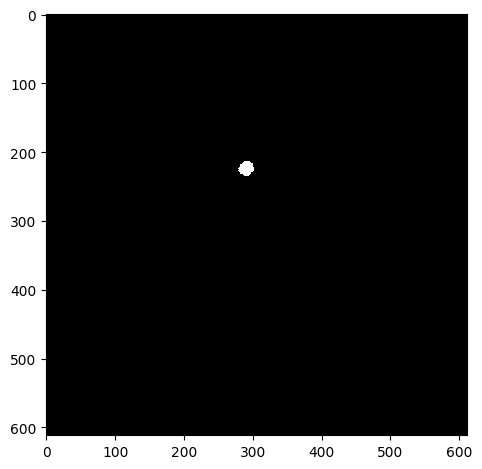

Cell 0: Number of inclusions: 1
Cell 0: Inclusion areas: [np.float64(367.0)]


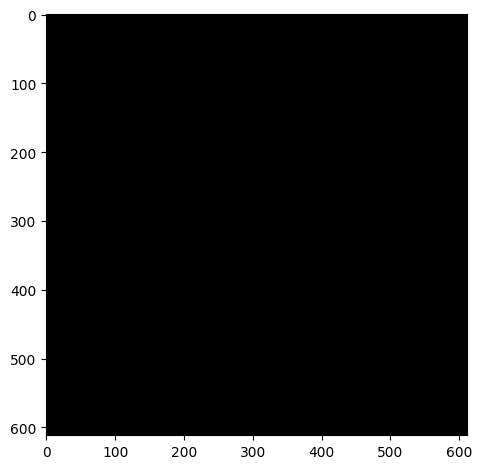

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


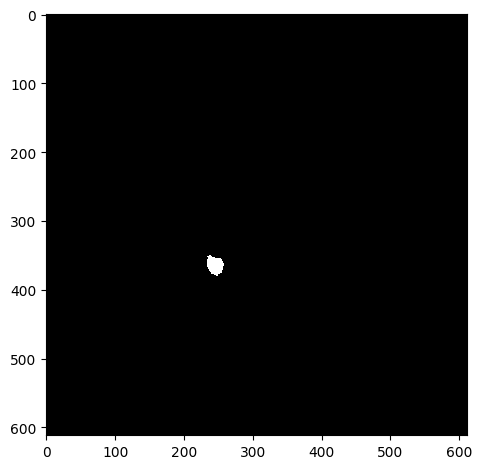

Cell 2: Number of inclusions: 1
Cell 2: Inclusion areas: [np.float64(522.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_ADAMTS19_05.czi
Green Channel


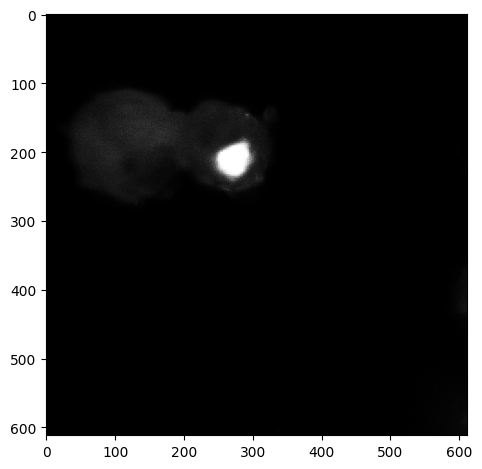

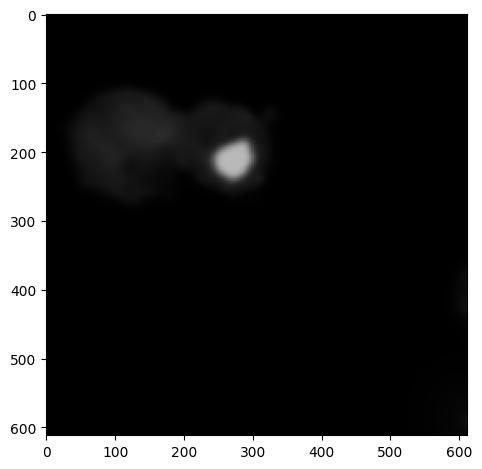

Segmented Cells


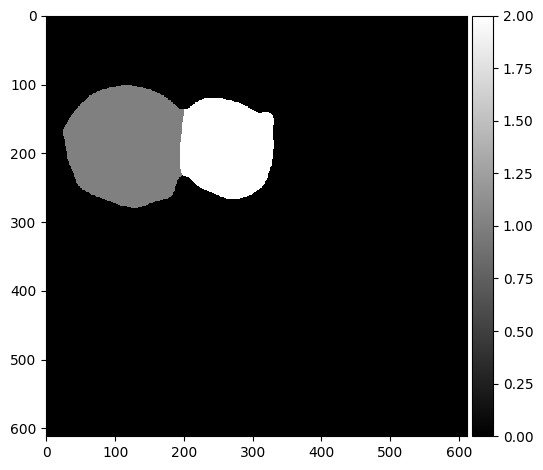

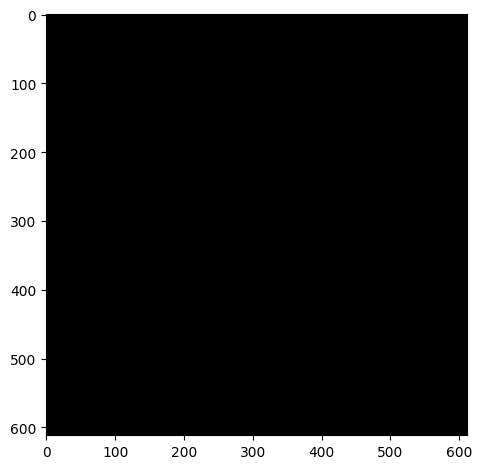

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


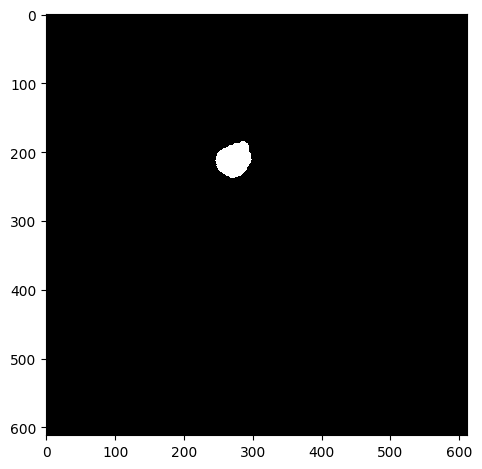

Cell 1: Number of inclusions: 1
Cell 1: Inclusion areas: [np.float64(2010.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_ADAMTS19_067.czi
Green Channel


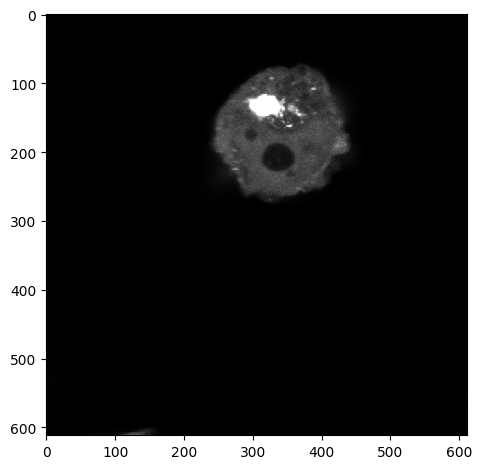

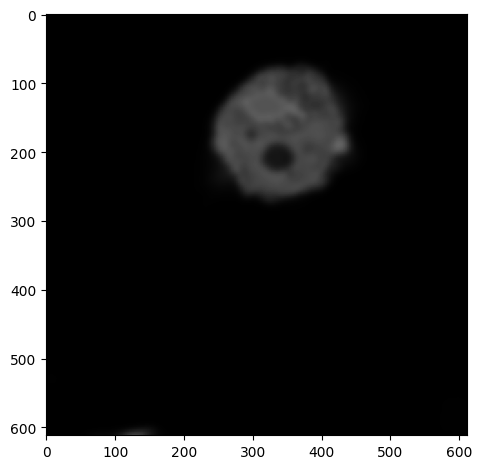

Segmented Cells


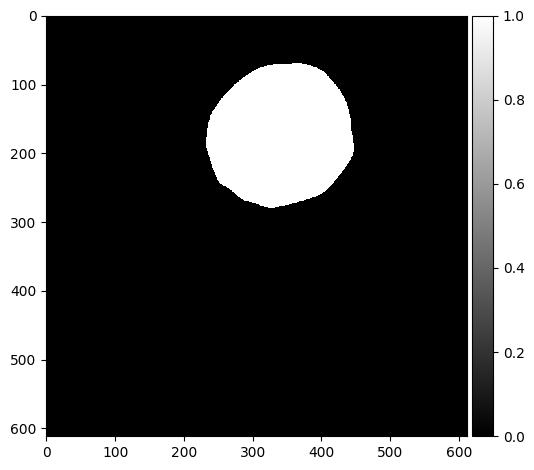

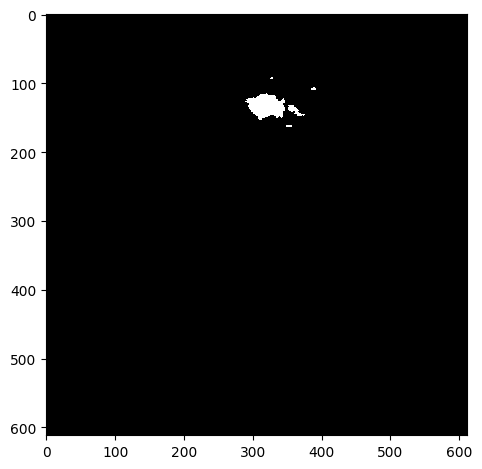

Cell 0: Number of inclusions: 5
Cell 0: Inclusion areas: [np.float64(10.0), np.float64(17.0), np.float64(1473.0), np.float64(166.0), np.float64(30.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_ADAMTS19_07.czi
Green Channel


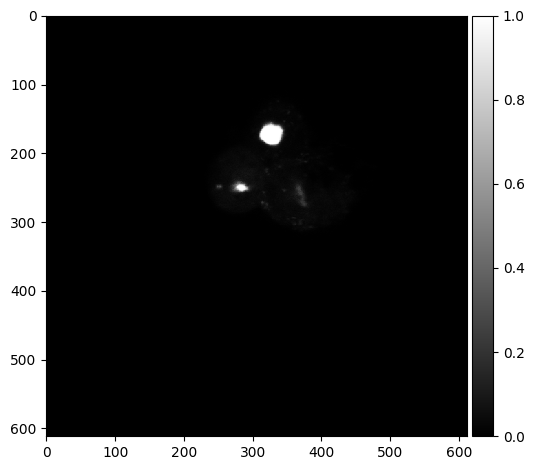

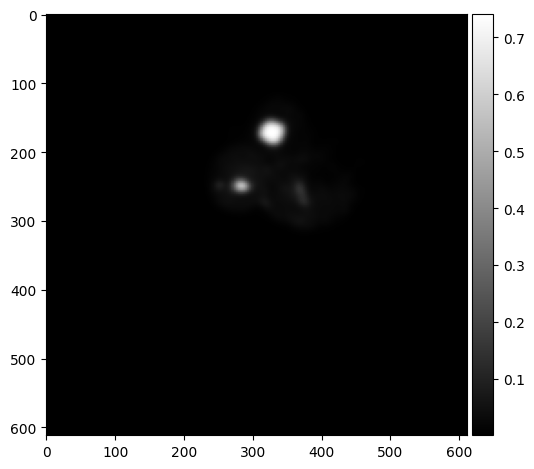

Segmented Cells


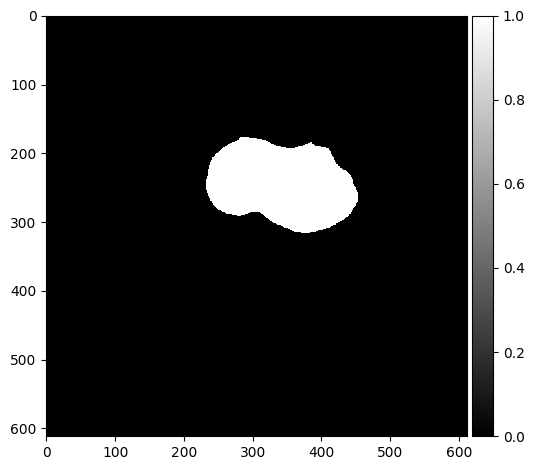

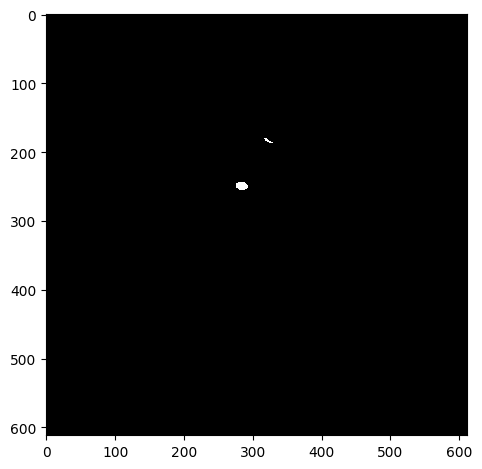

Cell 0: Number of inclusions: 2
Cell 0: Inclusion areas: [np.float64(43.0), np.float64(161.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_ADAMTS19_08.czi
Green Channel


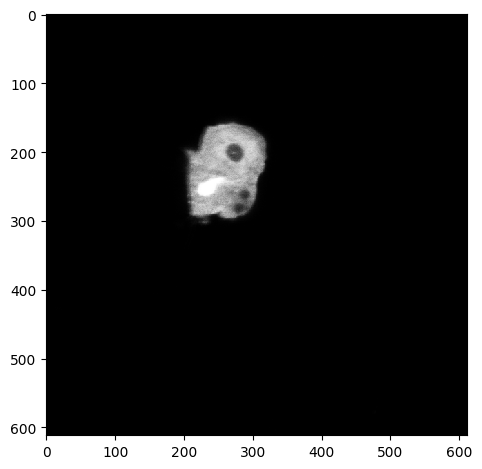

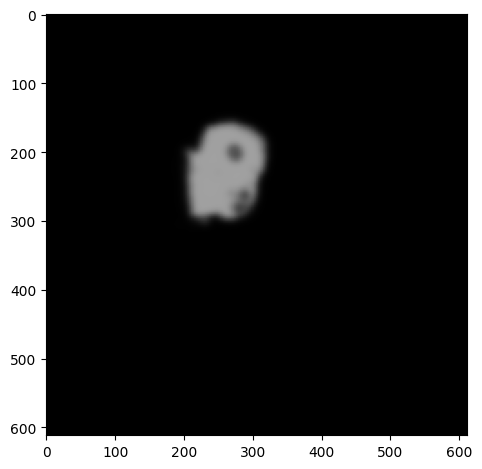

Segmented Cells


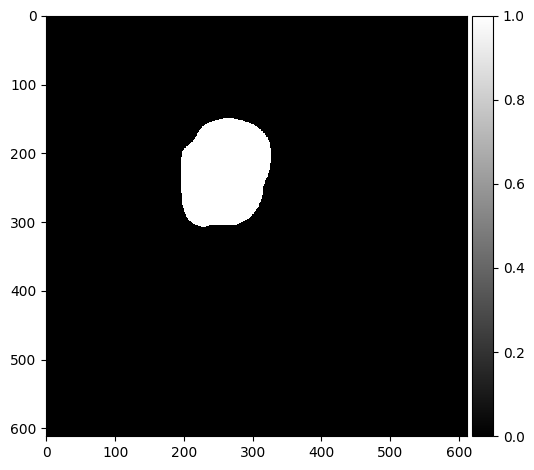

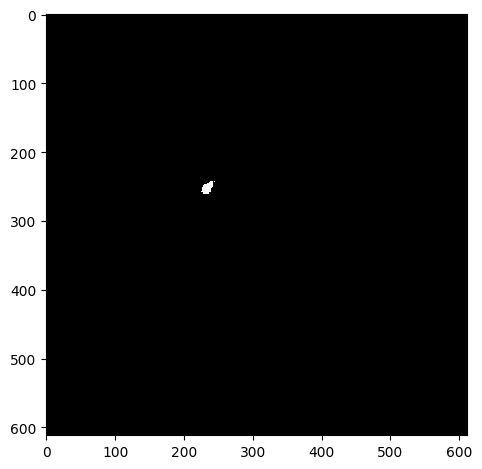

Cell 0: Number of inclusions: 1
Cell 0: Inclusion areas: [np.float64(221.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_ADAMTS19_09.czi
Green Channel


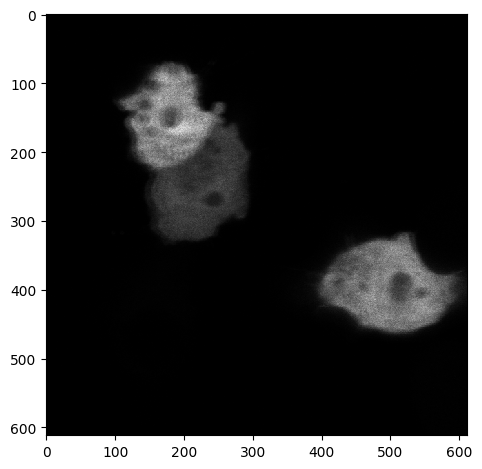

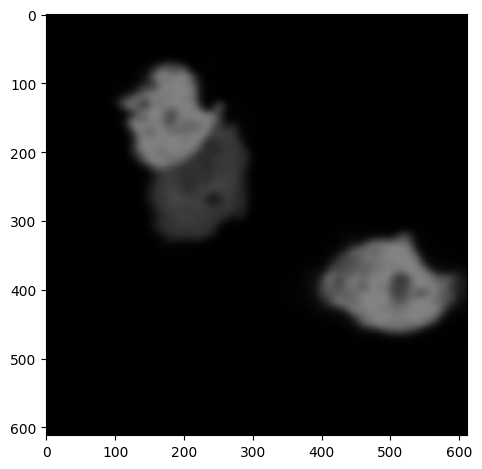

Segmented Cells


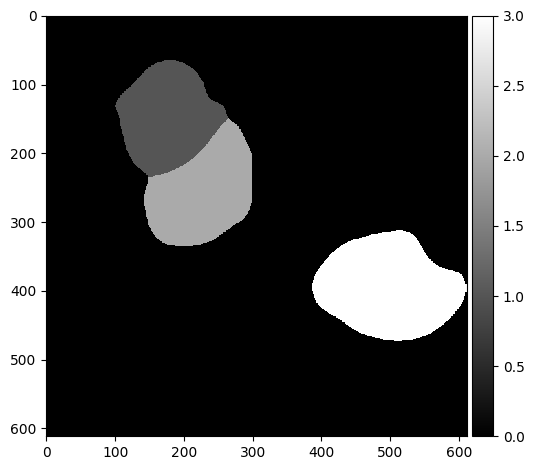

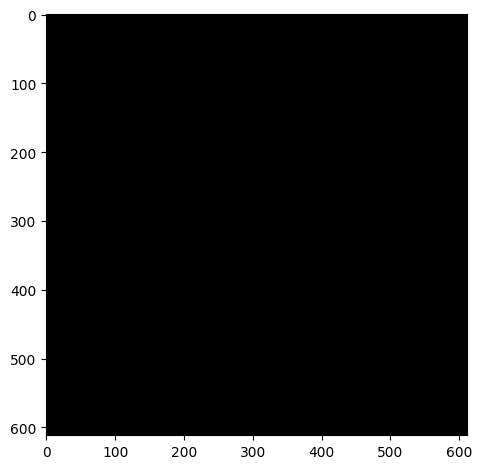

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


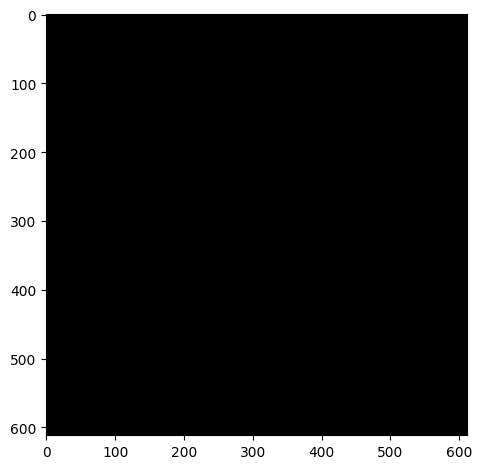

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


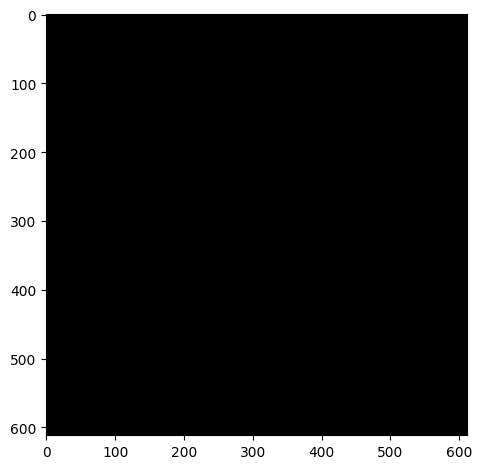

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_ADAMTS19_10.czi
Green Channel


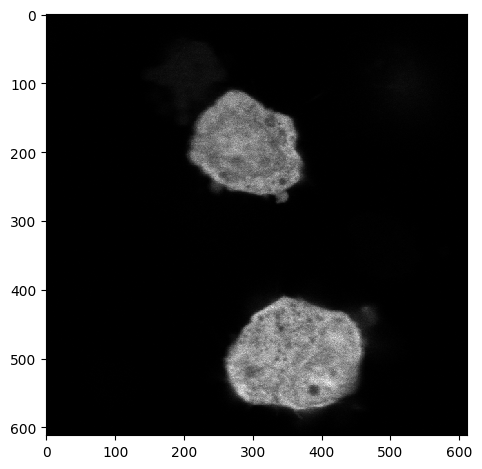

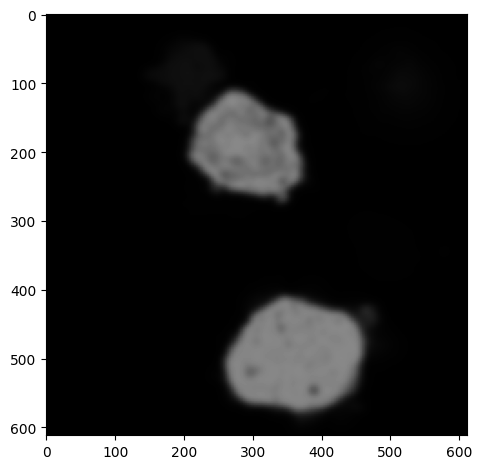

Segmented Cells


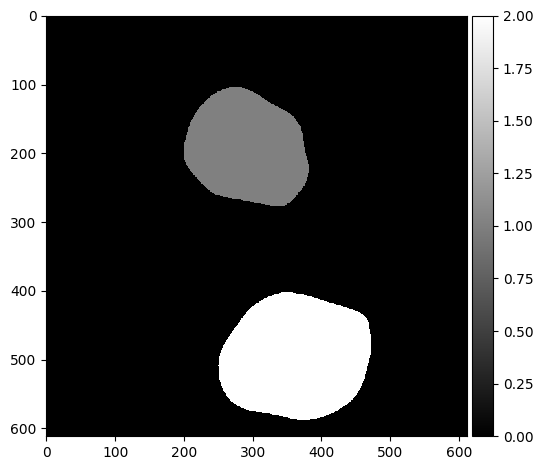

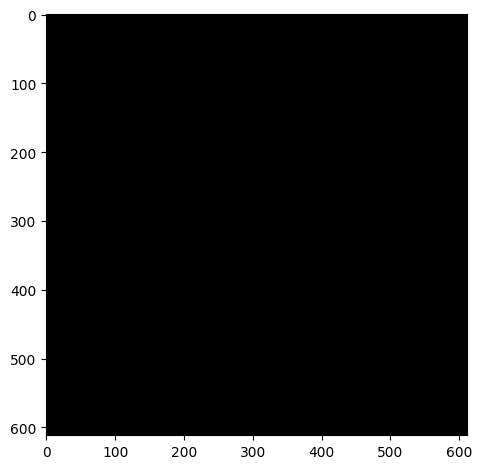

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


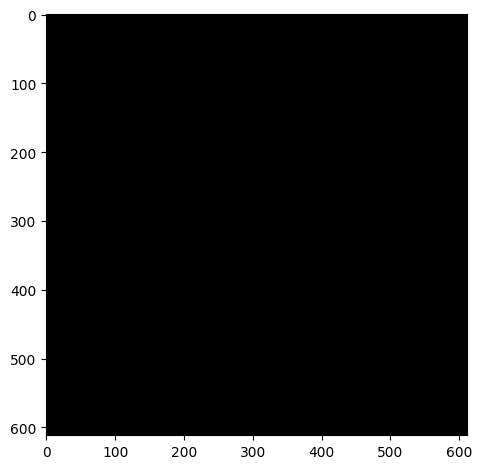

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_SCR_01.czi
Green Channel


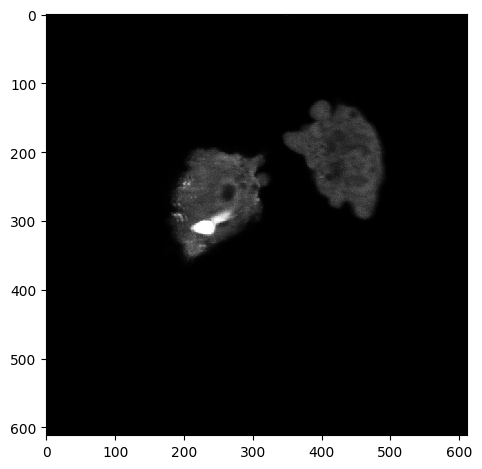

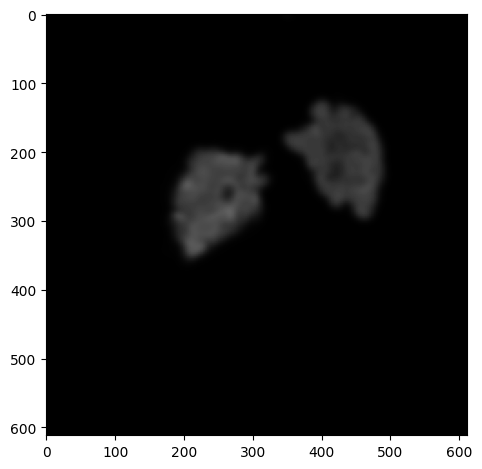

Segmented Cells


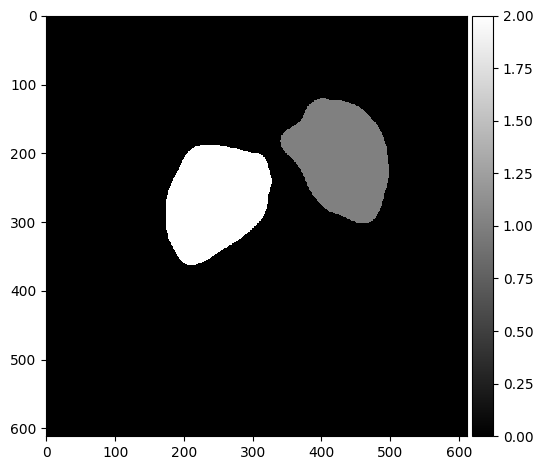

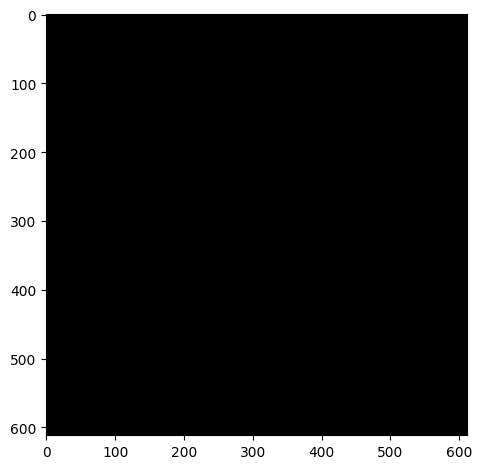

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


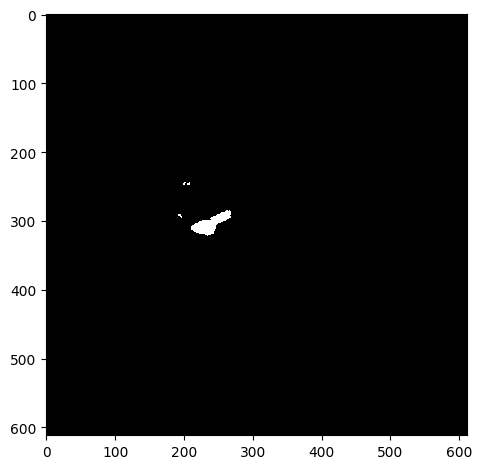

Cell 1: Number of inclusions: 4
Cell 1: Inclusion areas: [np.float64(13.0), np.float64(15.0), np.float64(946.0), np.float64(16.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_SCR_02.czi
Green Channel


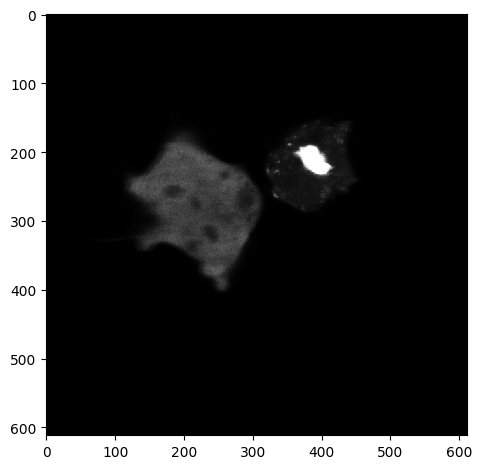

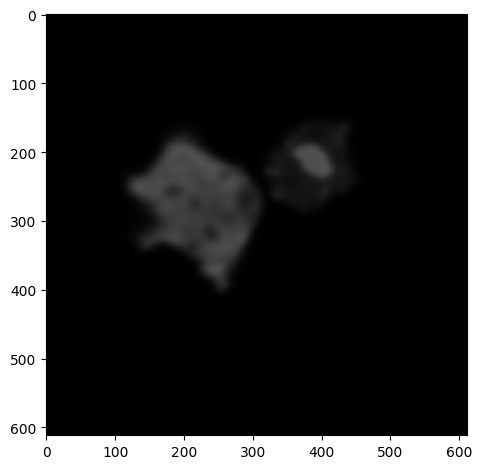

Segmented Cells


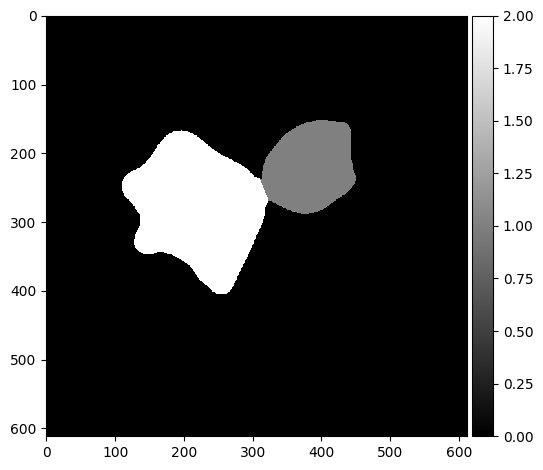

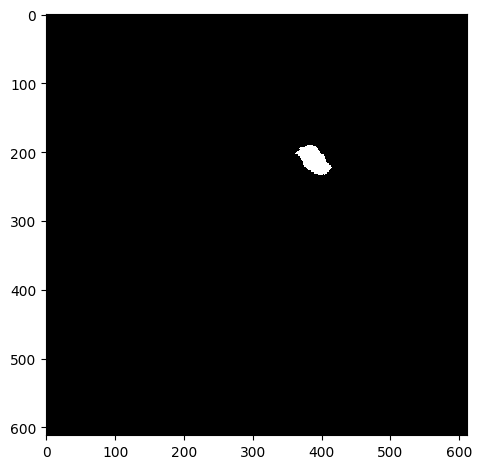

Cell 0: Number of inclusions: 1
Cell 0: Inclusion areas: [np.float64(1337.0)]


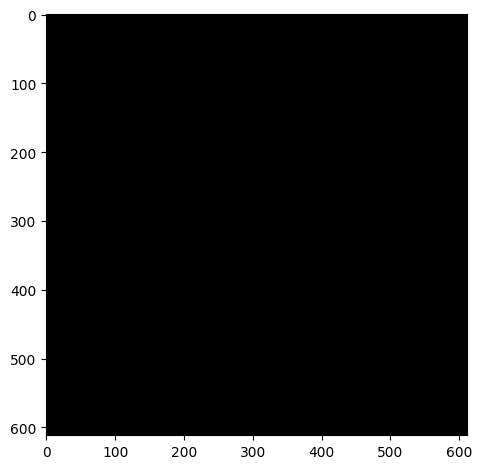

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_SCR_03.czi
Green Channel


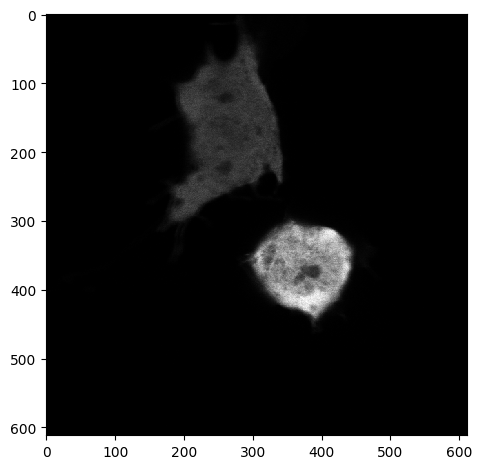

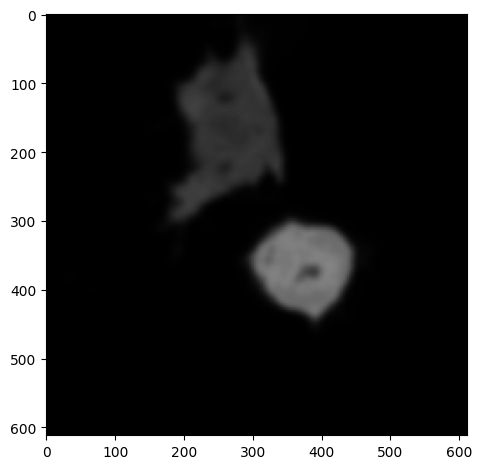

Segmented Cells


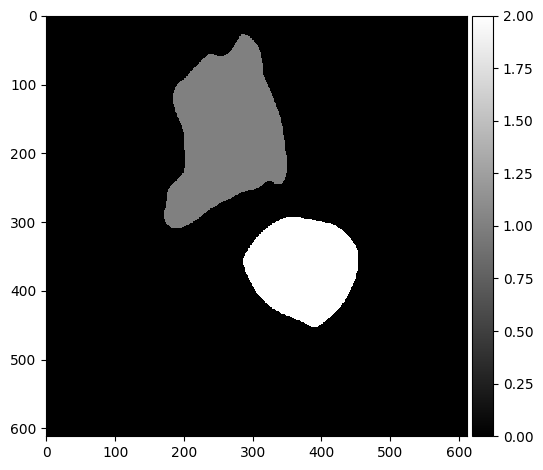

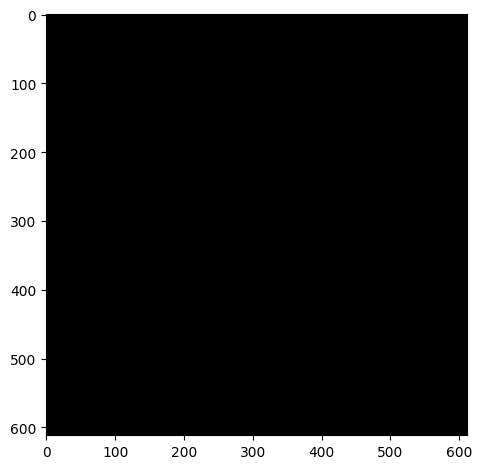

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


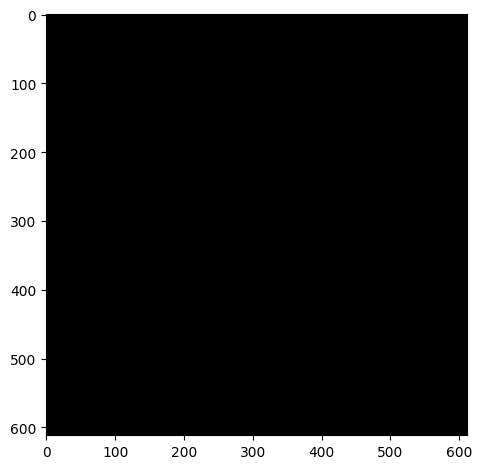

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_SCR_04.czi
Green Channel


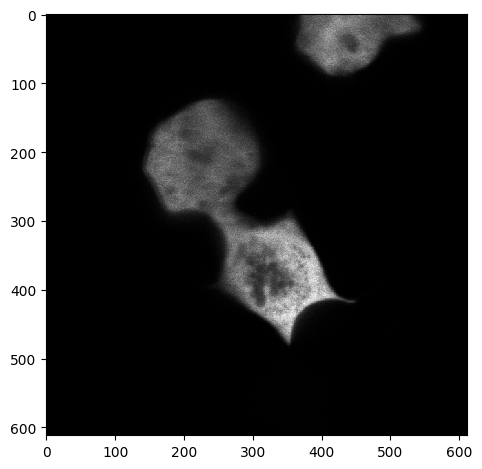

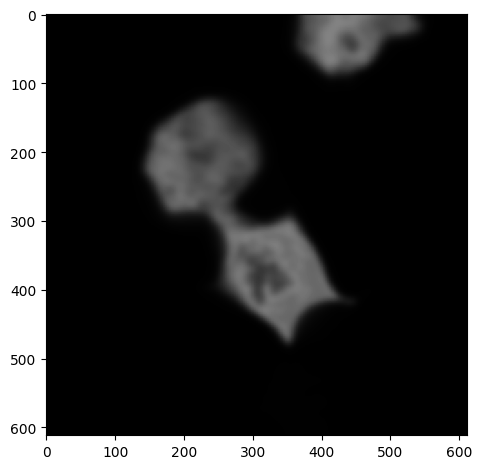

Segmented Cells


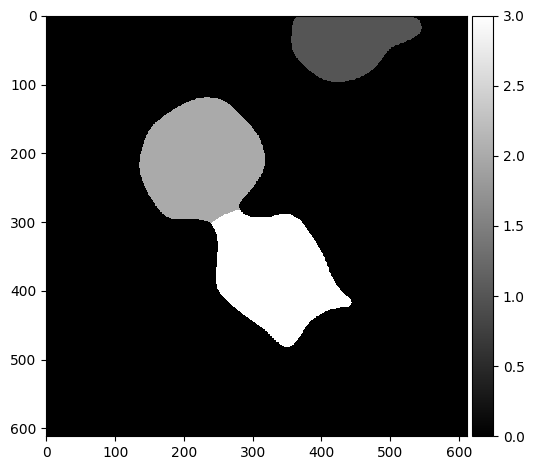

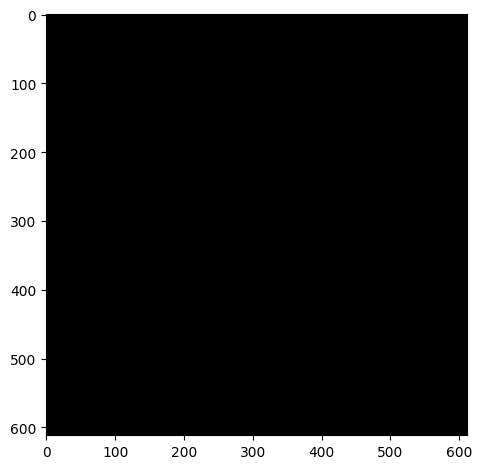

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


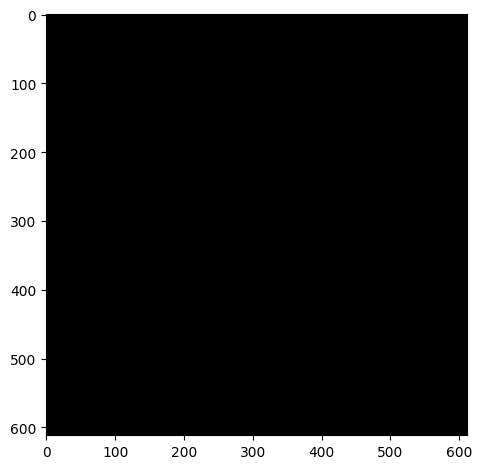

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


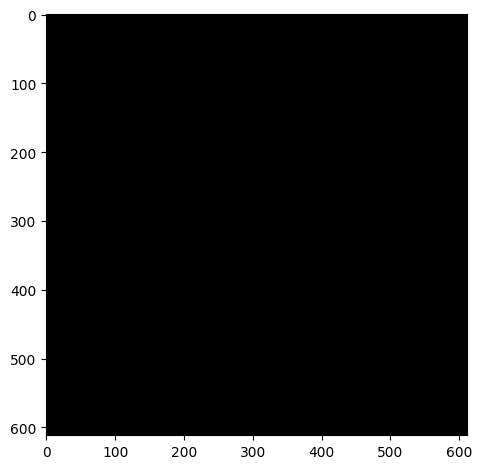

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_SCR_05.czi
Green Channel


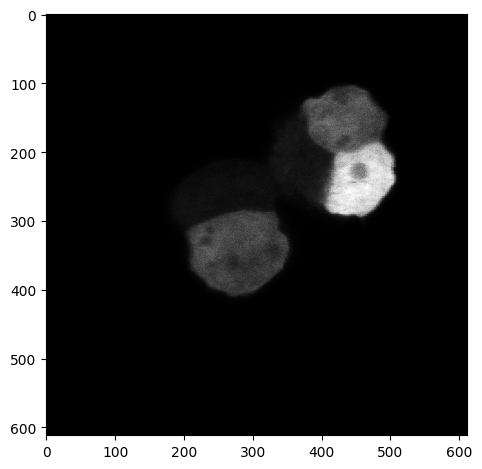

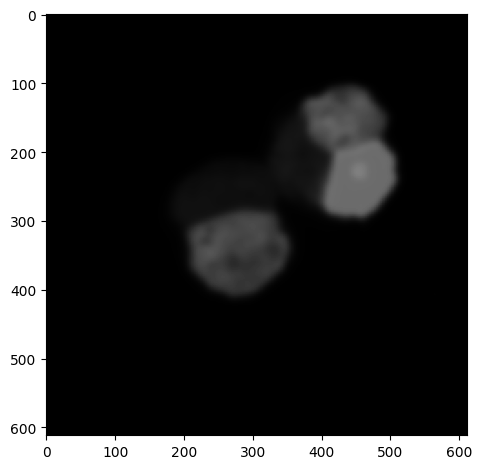

Segmented Cells


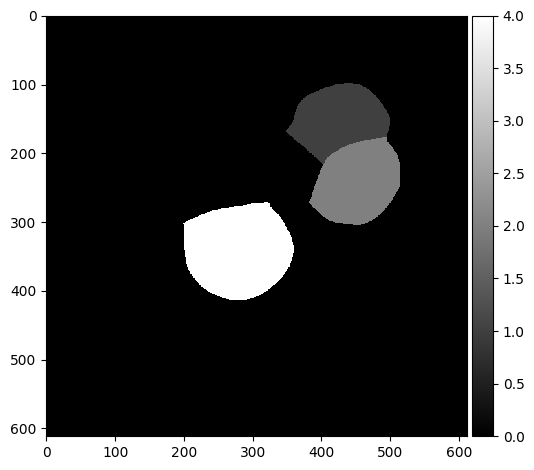

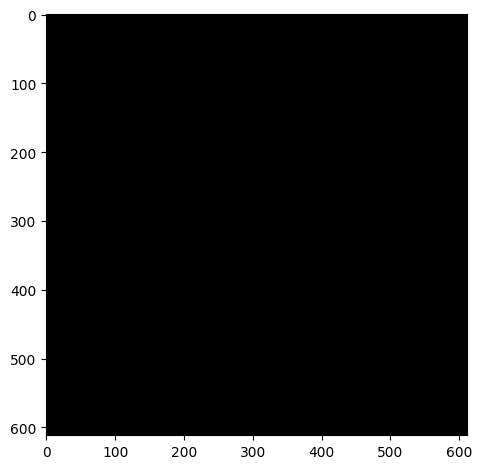

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


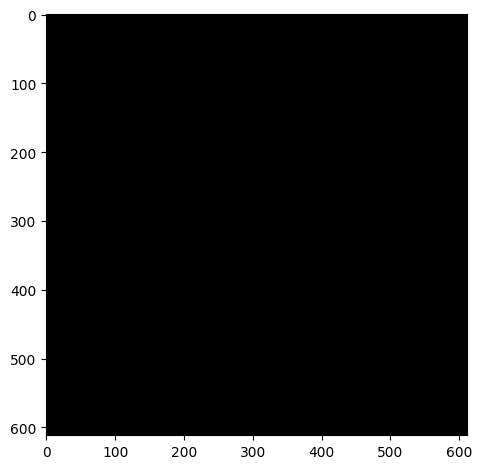

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


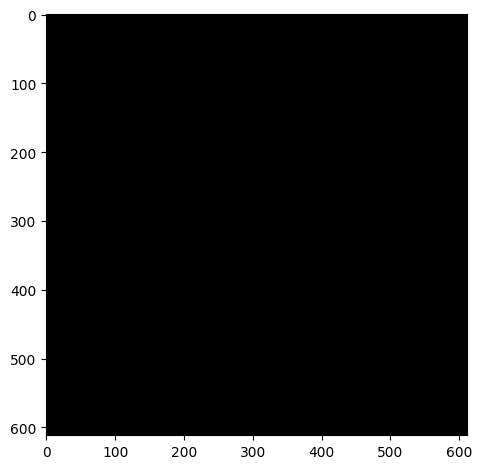

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_SCR_06.czi
Green Channel


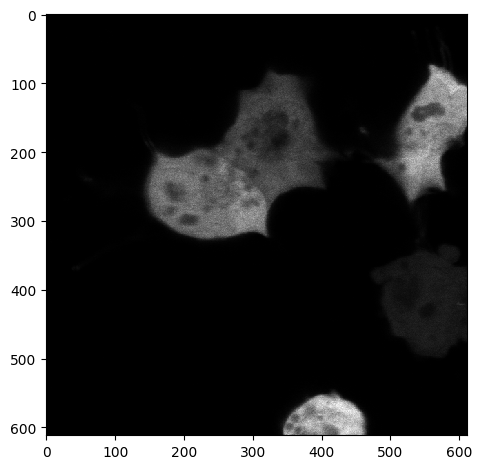

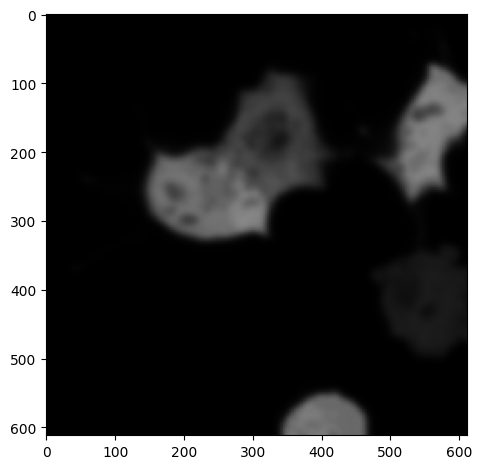

Segmented Cells


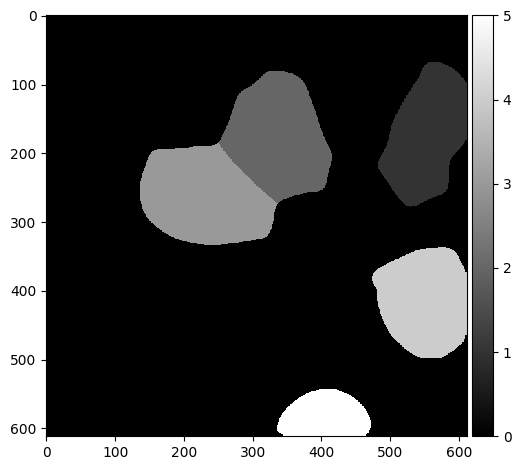

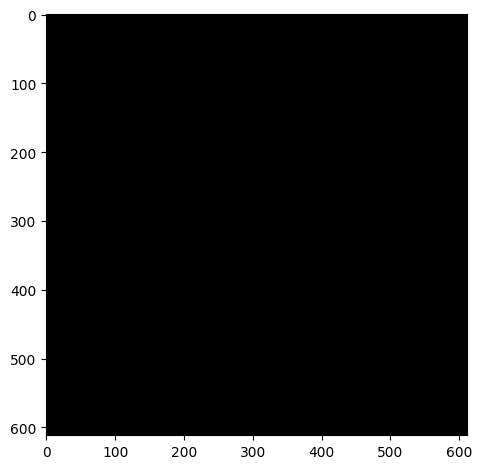

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


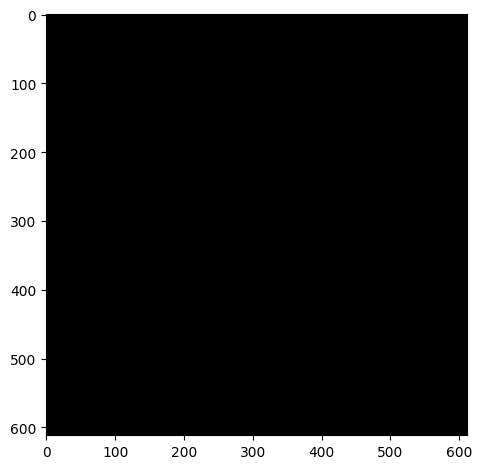

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


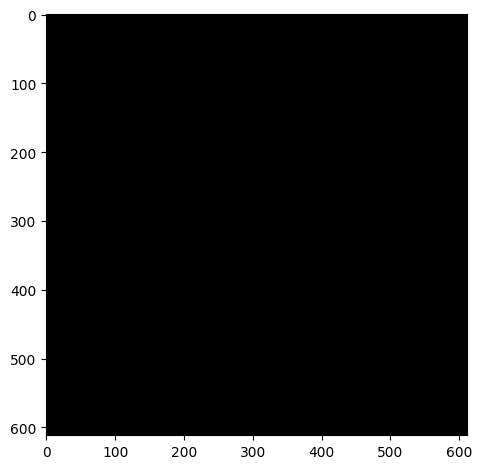

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


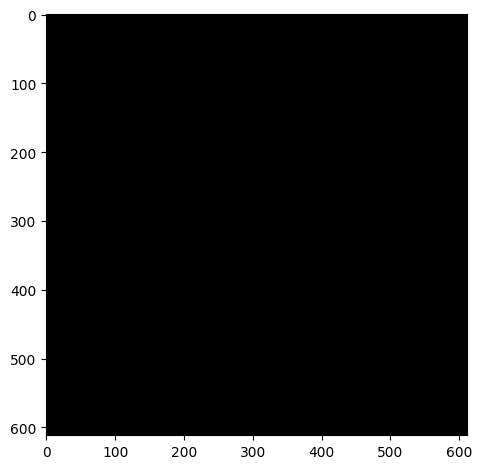

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []


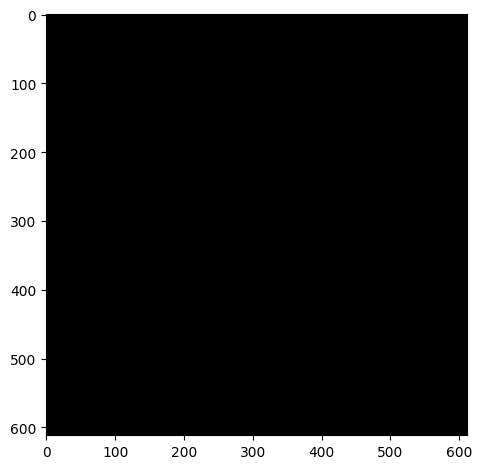

Cell 4: Number of inclusions: 0
Cell 4: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_SCR_07.czi
Green Channel


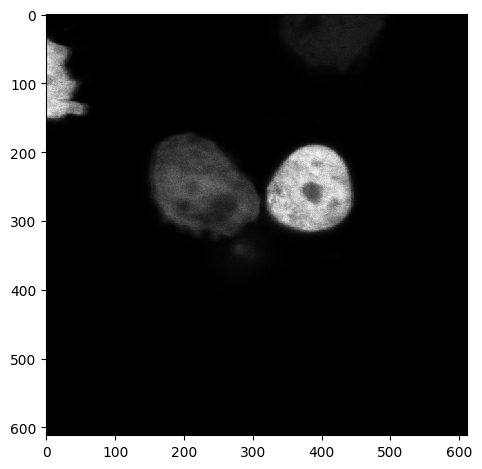

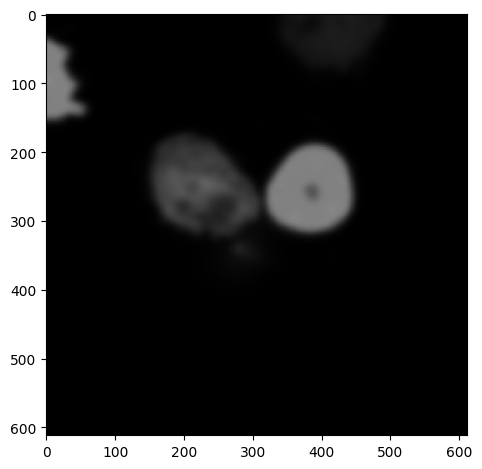

Segmented Cells


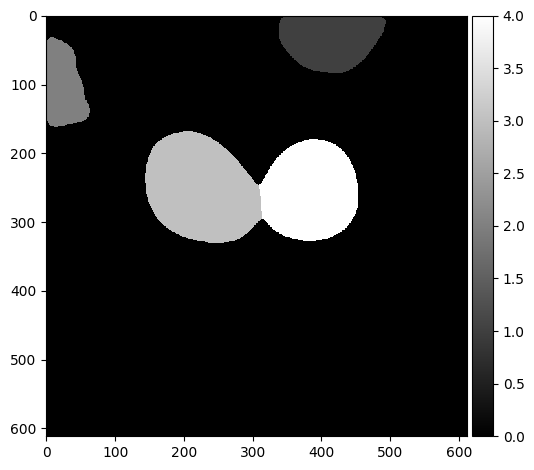

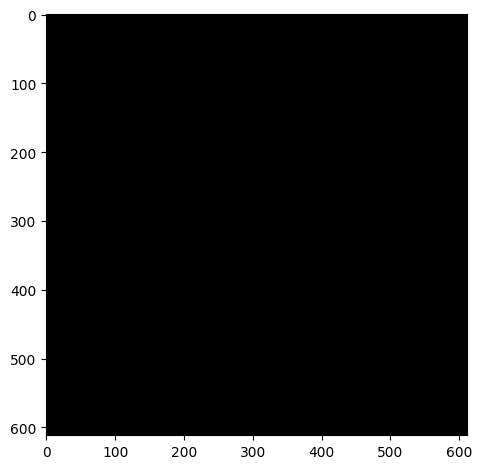

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


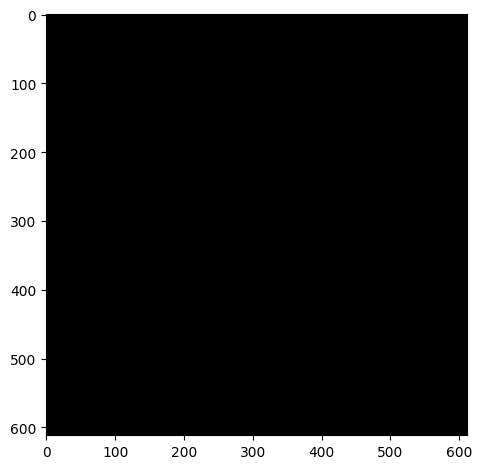

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


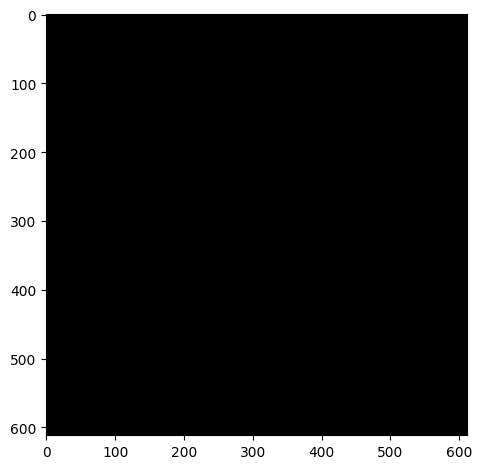

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


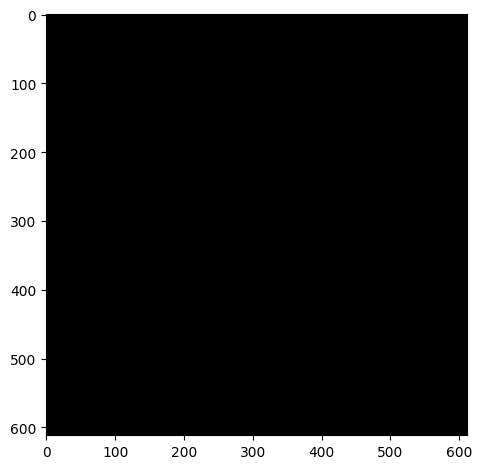

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_SCR_08.czi
Green Channel


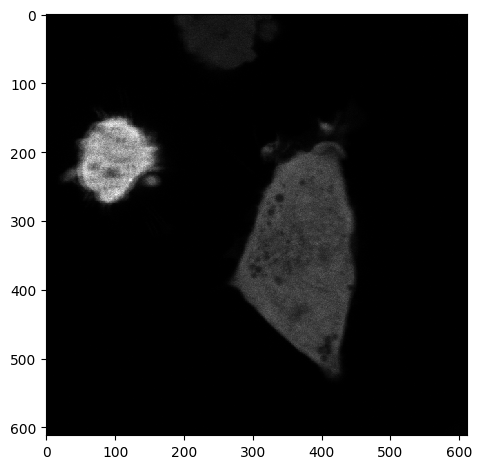

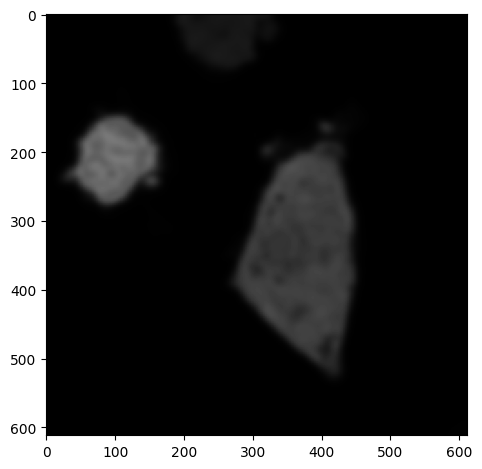

Segmented Cells


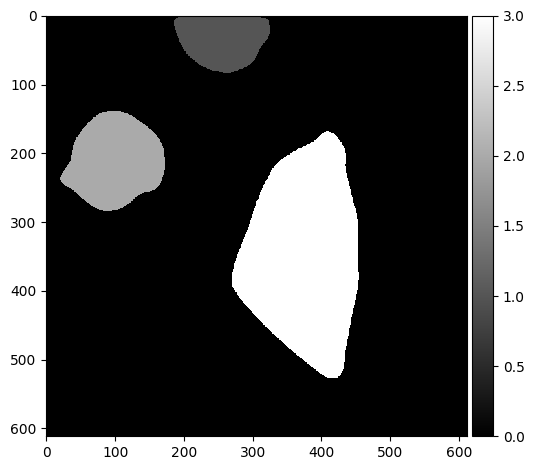

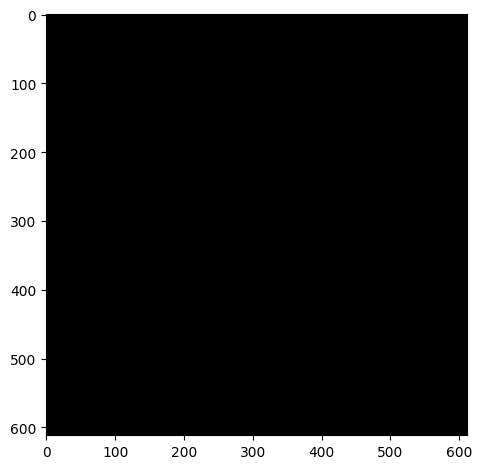

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


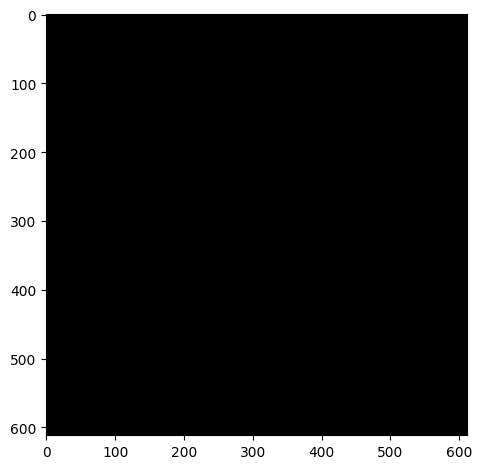

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


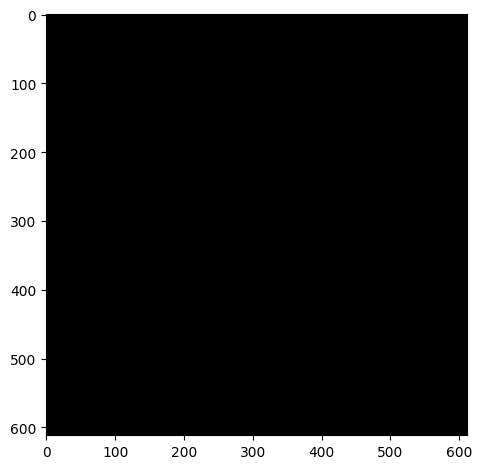

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_SCR_09.czi
Green Channel


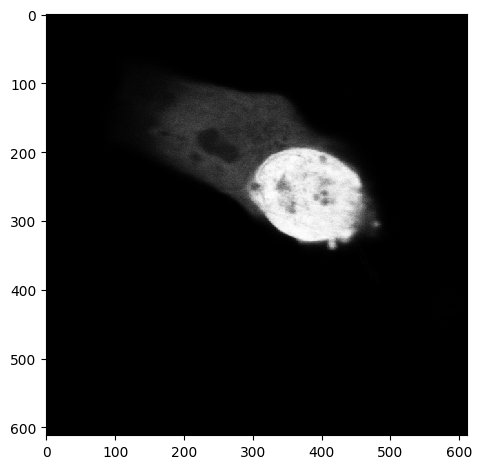

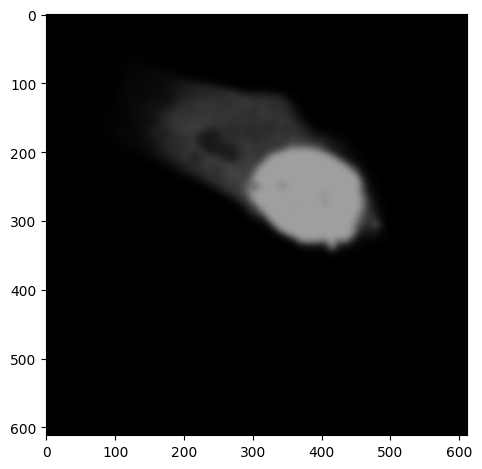

Segmented Cells


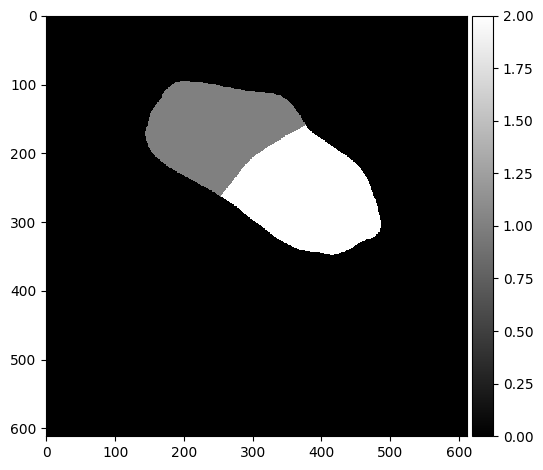

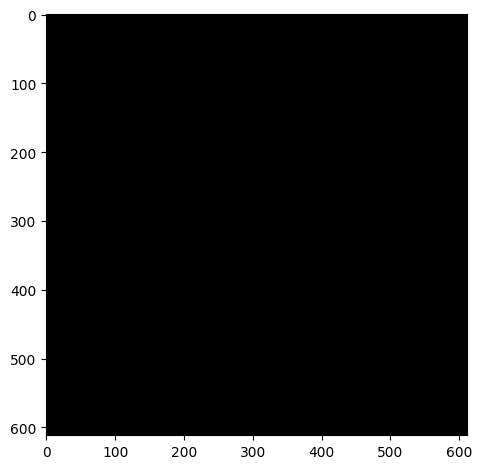

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


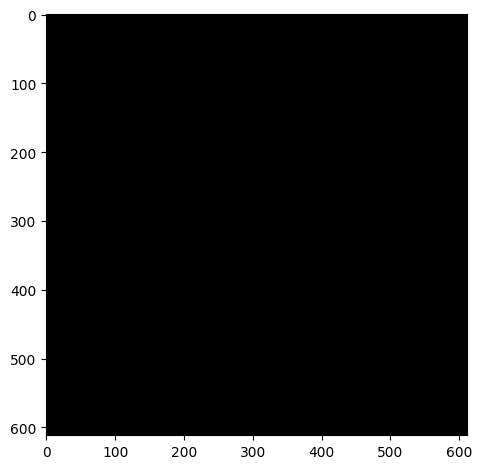

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_SCR_10.czi
Green Channel


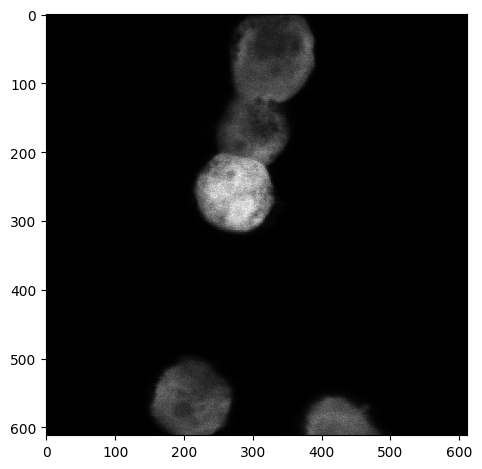

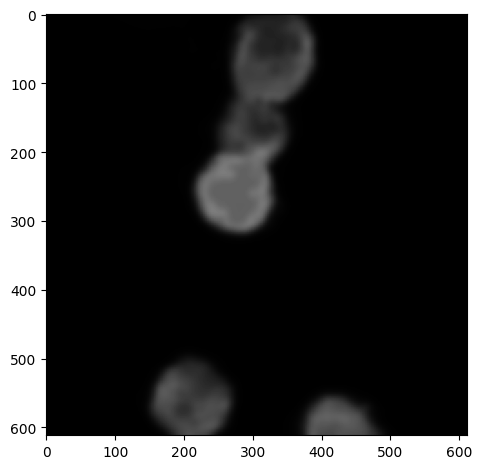

Segmented Cells


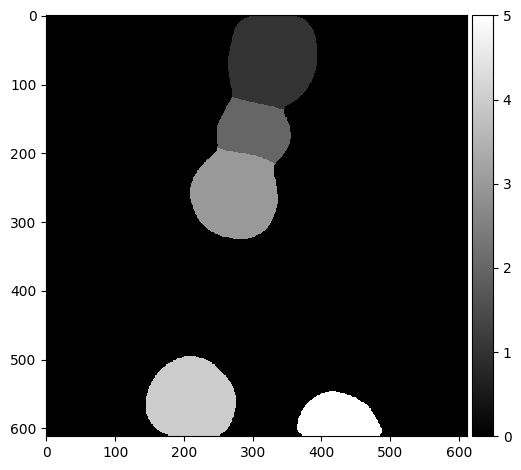

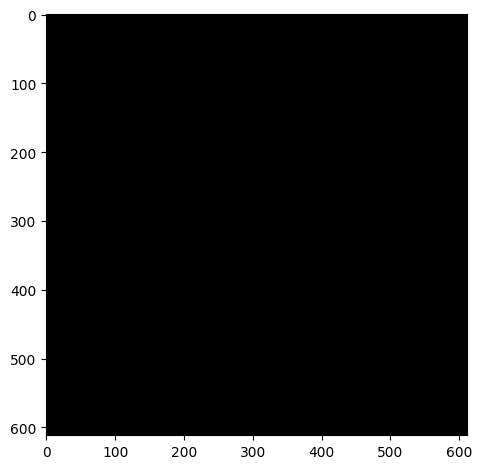

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


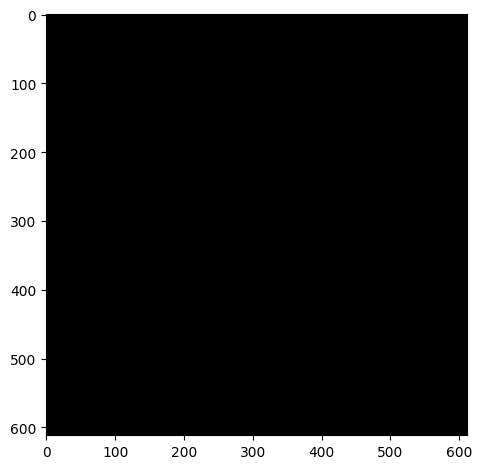

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


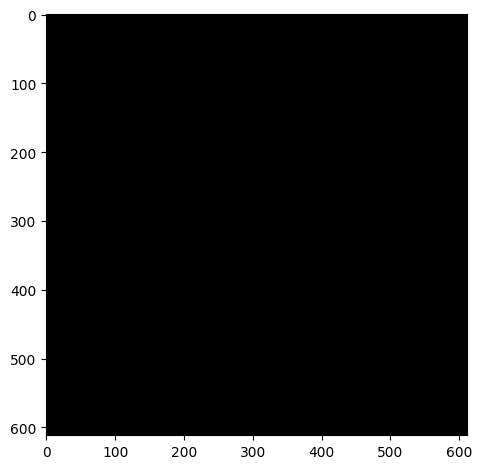

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


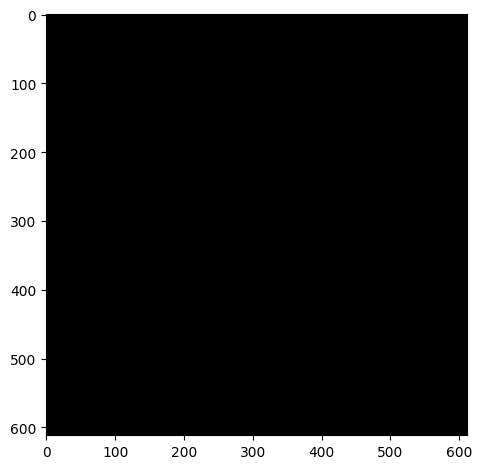

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []


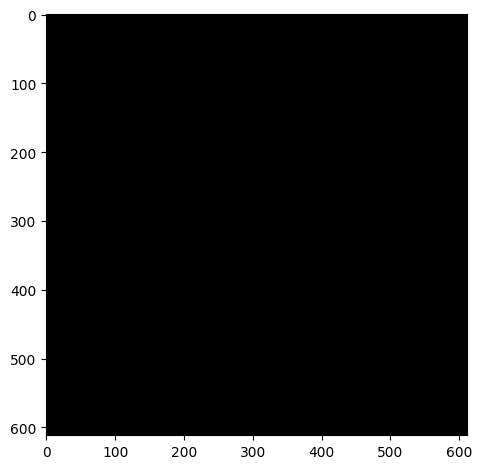

Cell 4: Number of inclusions: 0
Cell 4: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_TAX1BP1_01.czi
Green Channel


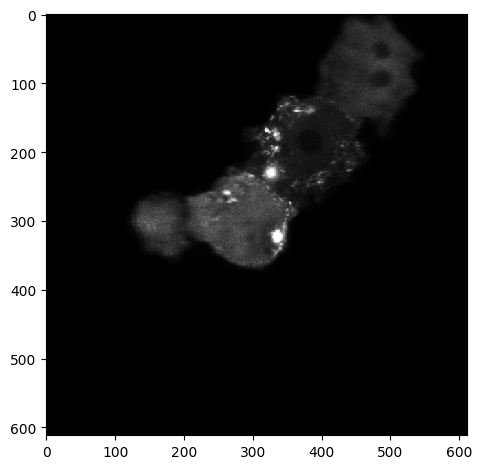

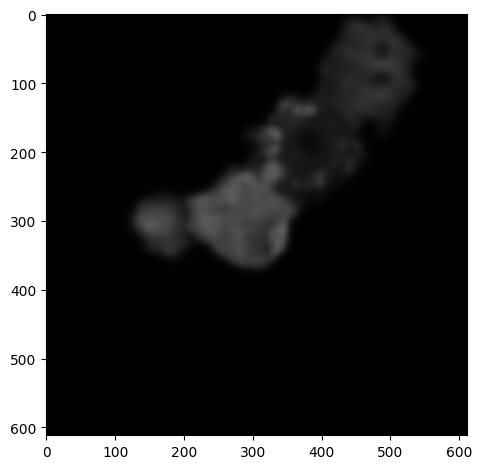

Segmented Cells


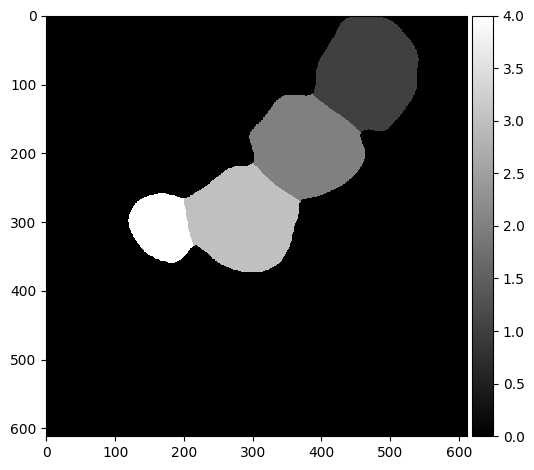

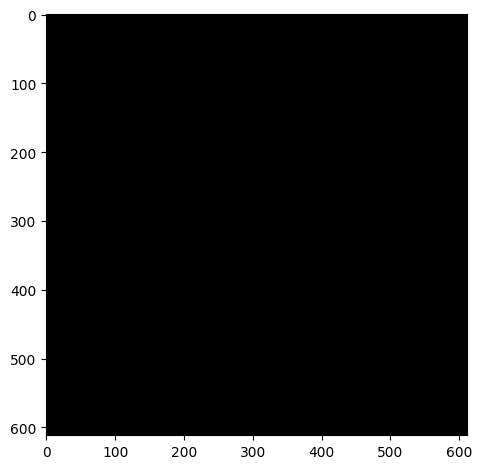

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


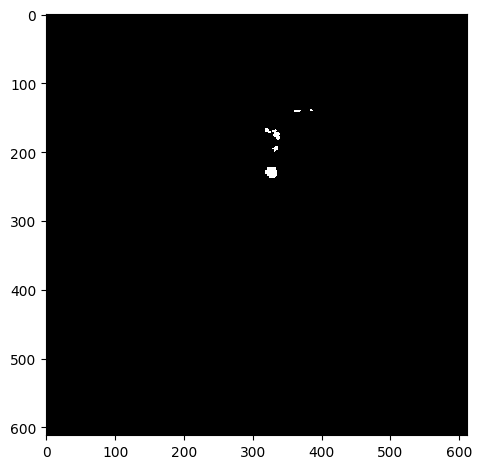

Cell 1: Number of inclusions: 6
Cell 1: Inclusion areas: [np.float64(30.0), np.float64(12.0), np.float64(45.0), np.float64(103.0), np.float64(38.0), np.float64(234.0)]


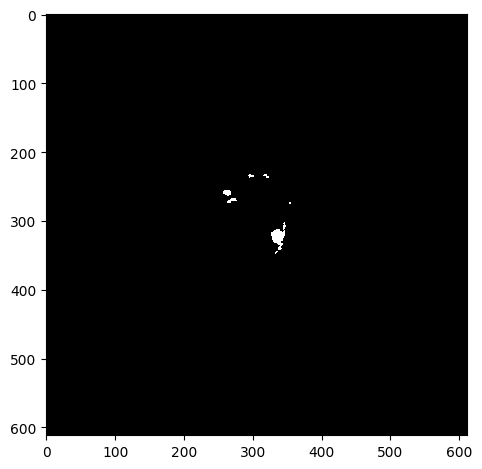

Cell 2: Number of inclusions: 8
Cell 2: Inclusion areas: [np.float64(36.0), np.float64(25.0), np.float64(82.0), np.float64(58.0), np.float64(10.0), np.float64(32.0), np.float64(357.0), np.float64(13.0)]


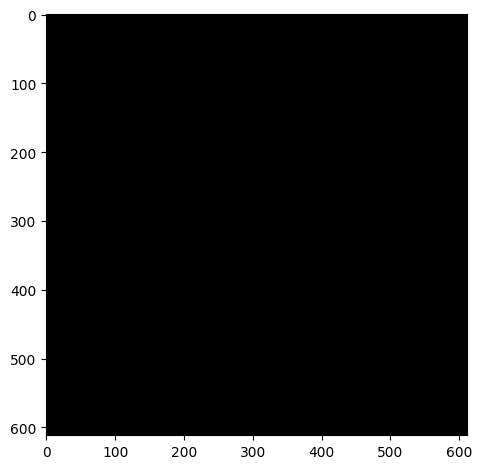

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_TAX1BP1_02.czi
Green Channel


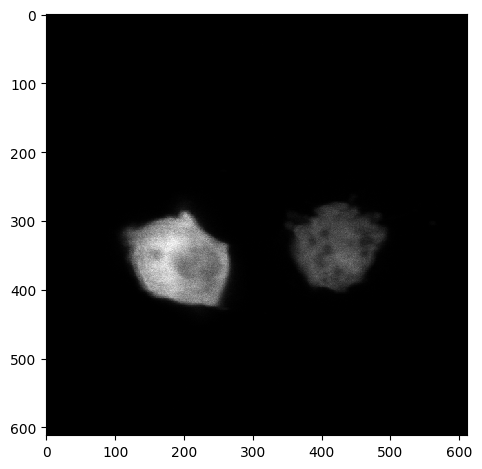

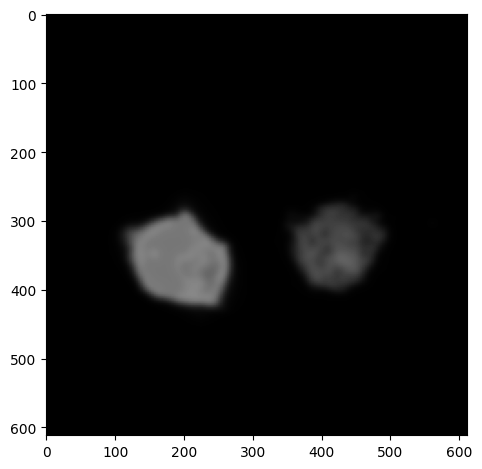

Segmented Cells


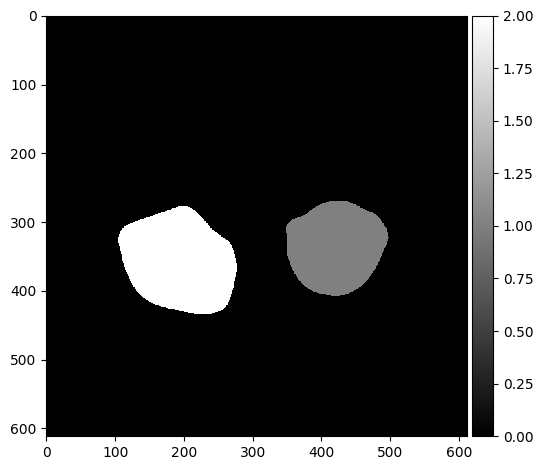

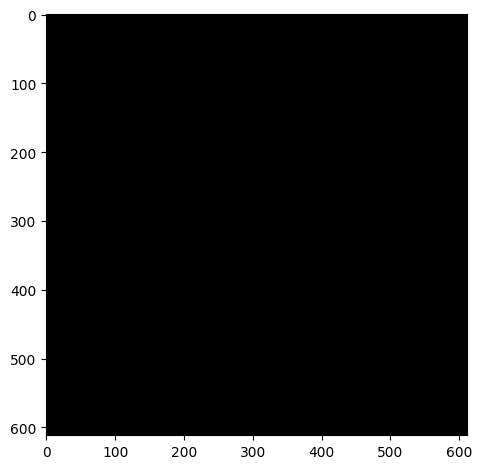

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


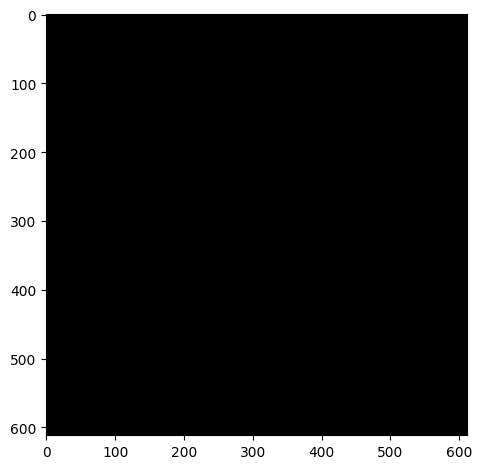

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_TAX1BP1_03.czi
Green Channel


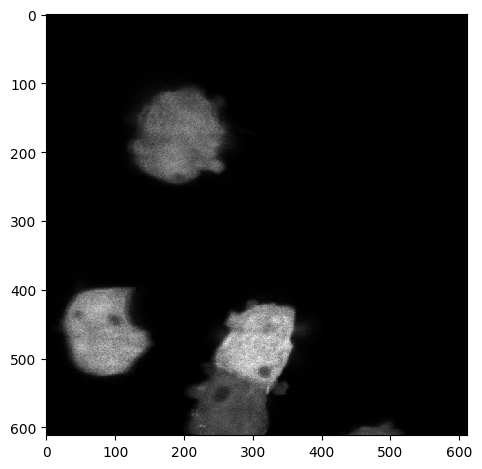

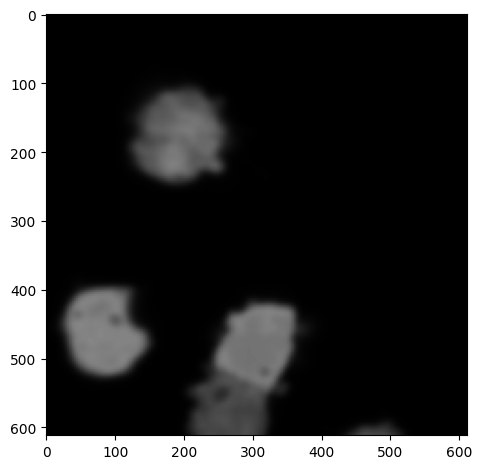

Segmented Cells


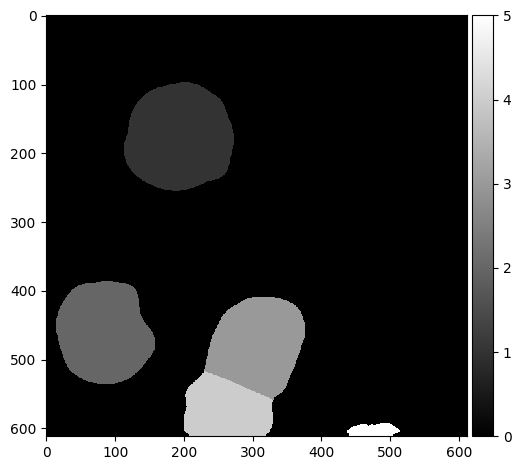

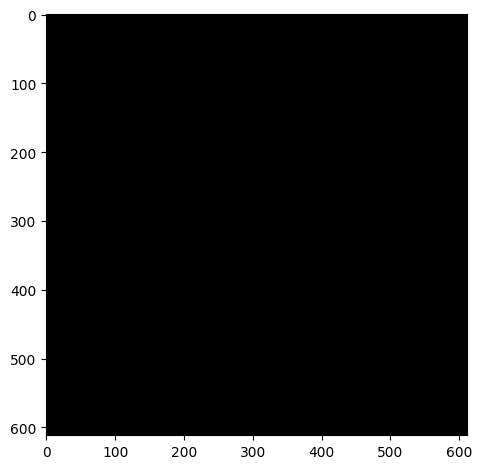

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


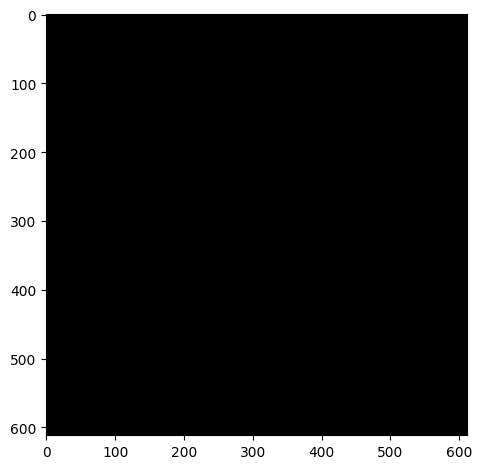

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


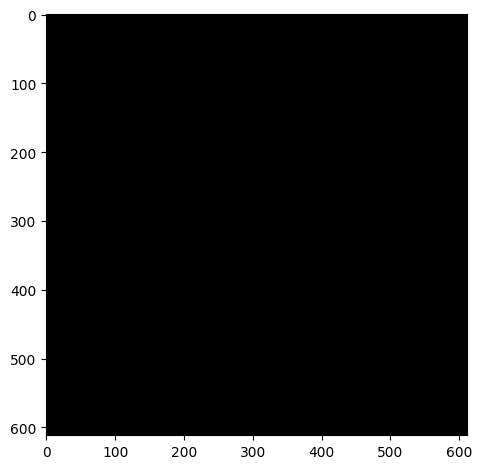

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


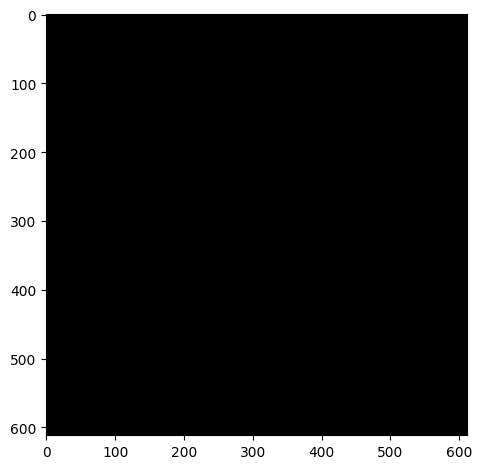

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []


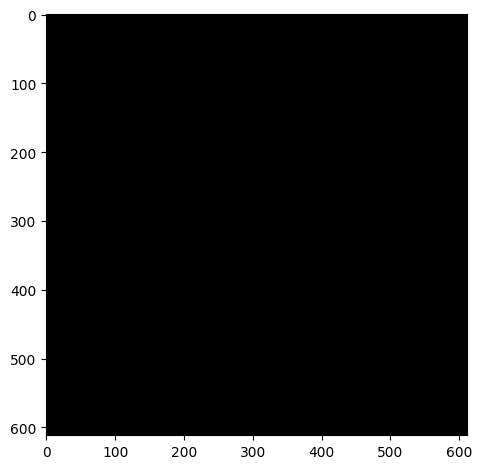

Cell 4: Number of inclusions: 0
Cell 4: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_TAX1BP1_04.czi
Green Channel


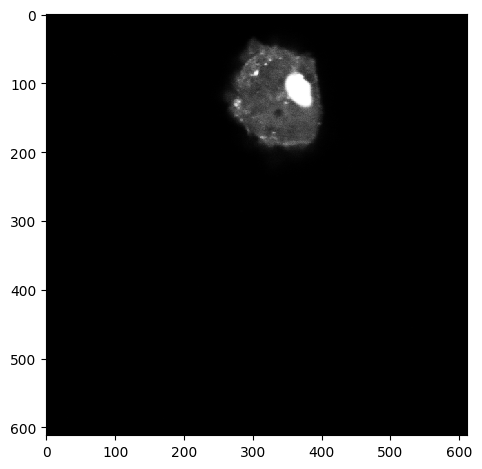

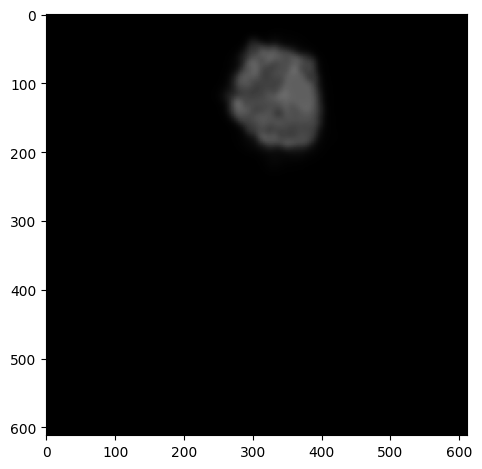

Segmented Cells


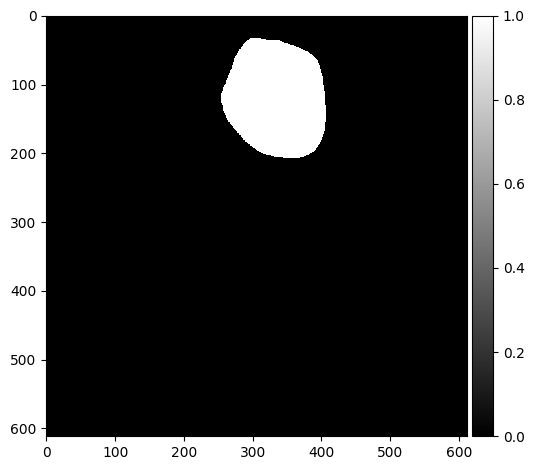

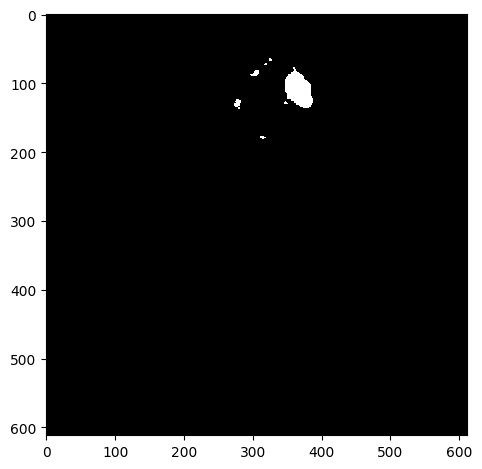

Cell 0: Number of inclusions: 7
Cell 0: Inclusion areas: [np.float64(19.0), np.float64(11.0), np.float64(1598.0), np.float64(74.0), np.float64(96.0), np.float64(19.0), np.float64(22.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_TAX1BP1_05.czi
Green Channel


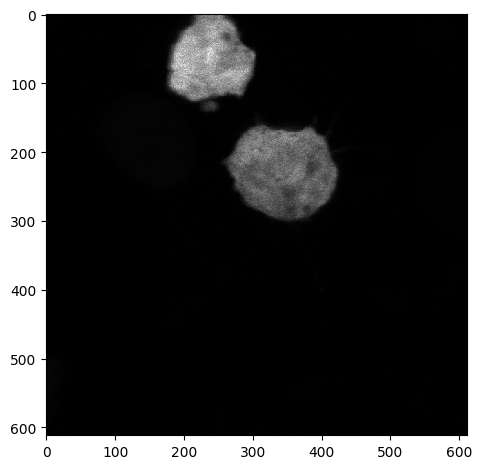

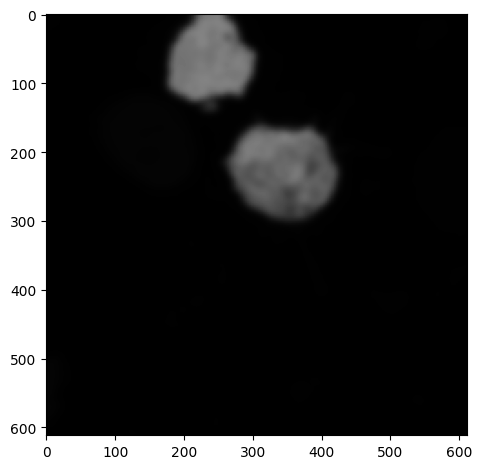

Segmented Cells


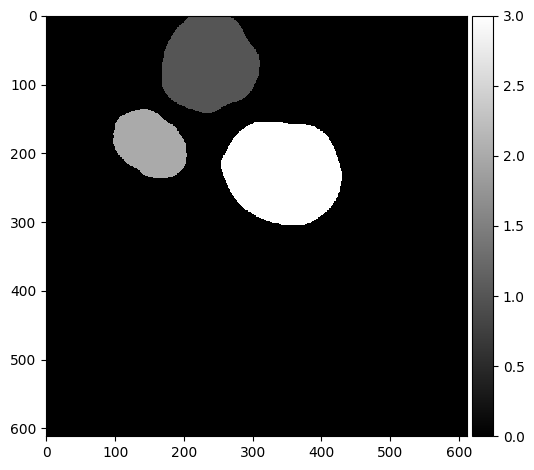

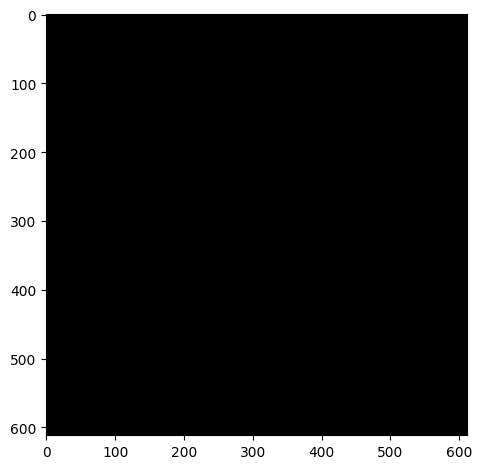

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


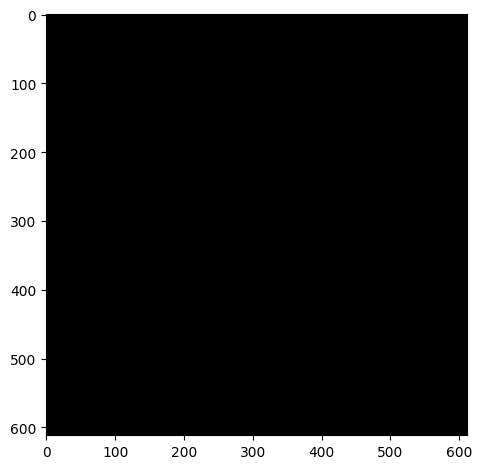

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


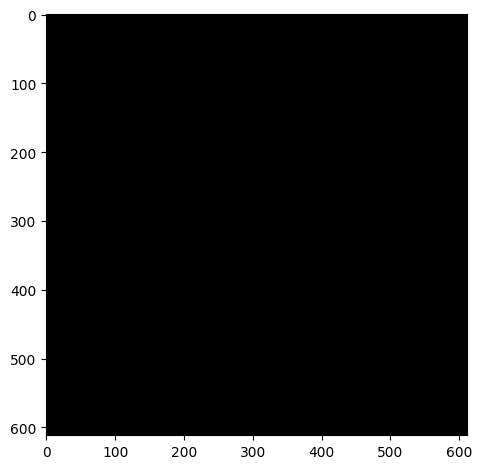

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_TAX1BP1_06.czi
Green Channel


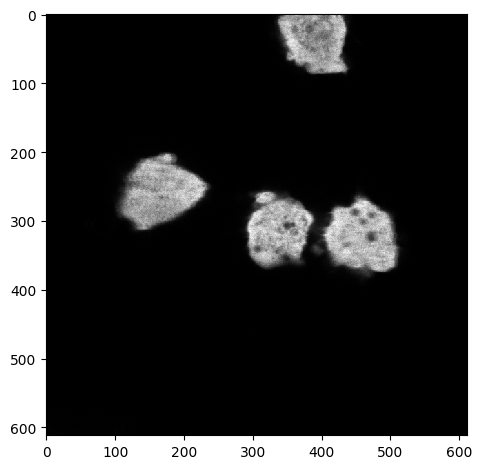

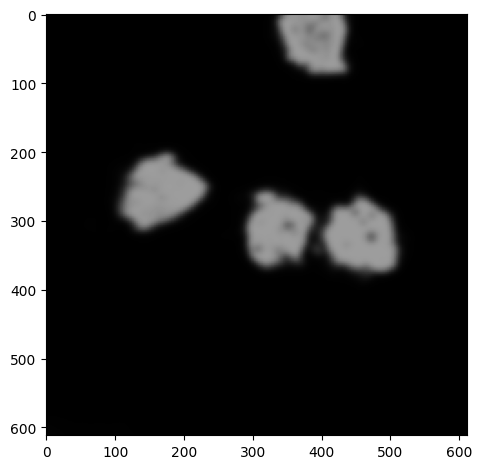

Segmented Cells


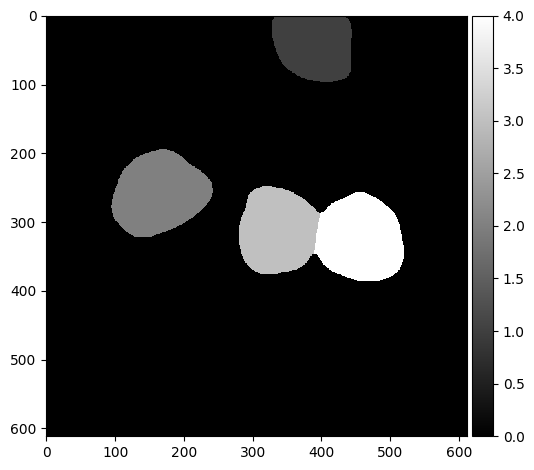

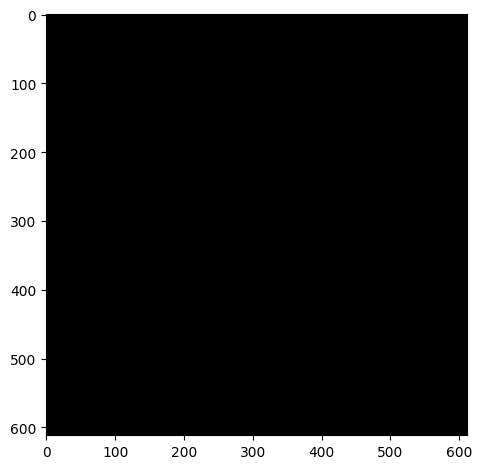

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


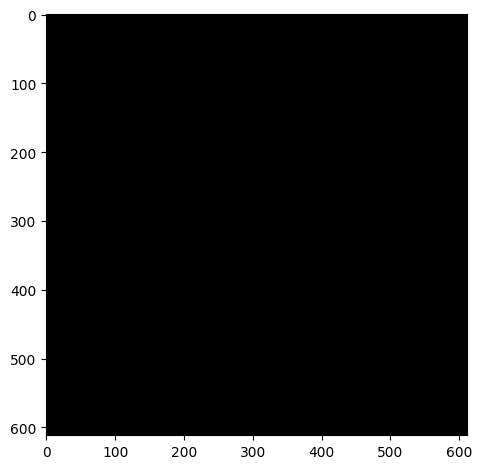

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


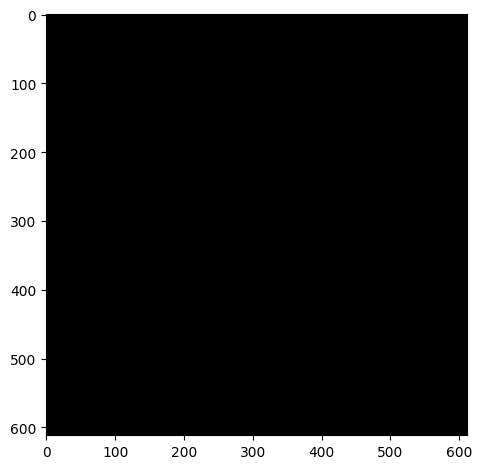

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


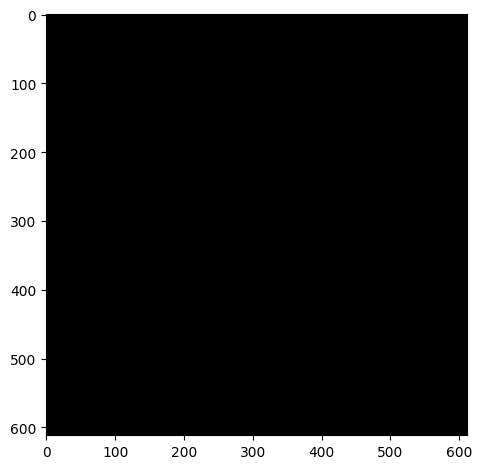

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_TAX1BP1_07.czi
Green Channel


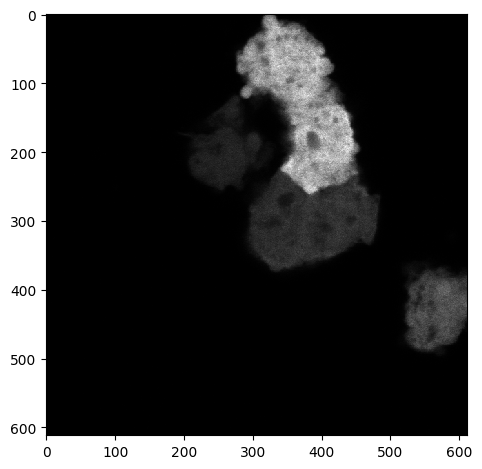

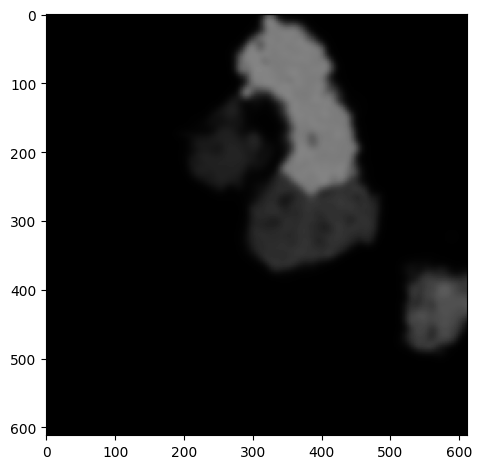

Segmented Cells


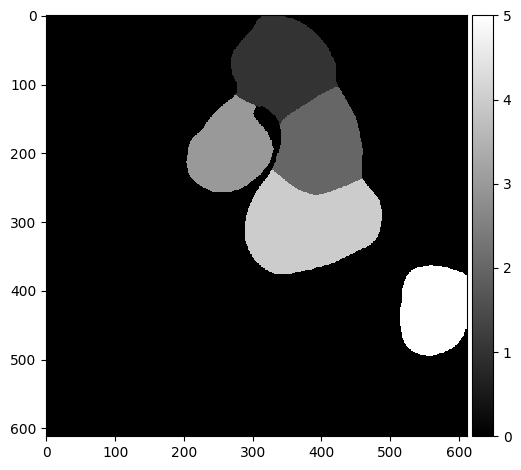

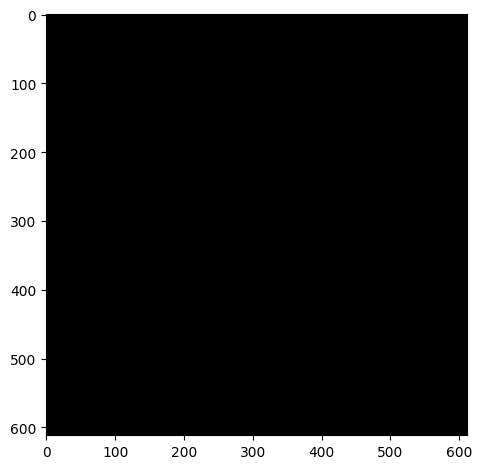

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


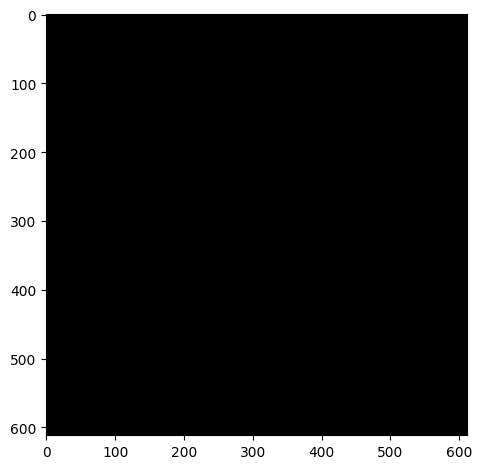

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


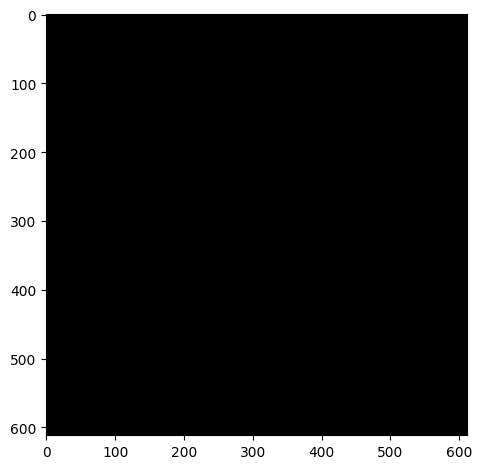

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


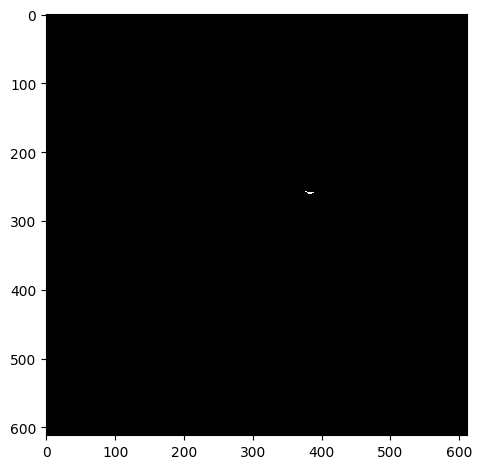

Cell 3: Number of inclusions: 1
Cell 3: Inclusion areas: [np.float64(25.0)]


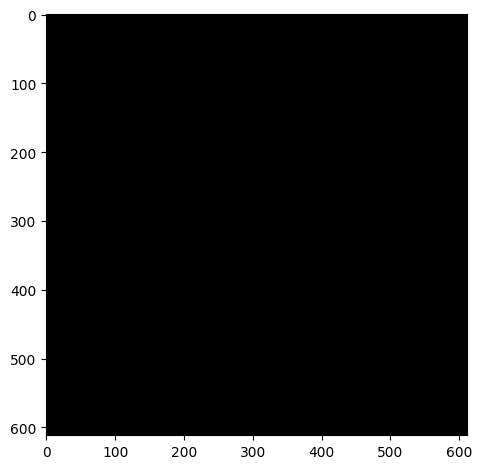

Cell 4: Number of inclusions: 0
Cell 4: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_TAX1BP1_08.czi
Green Channel


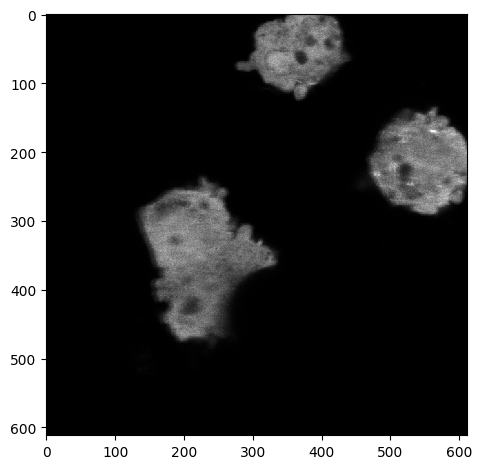

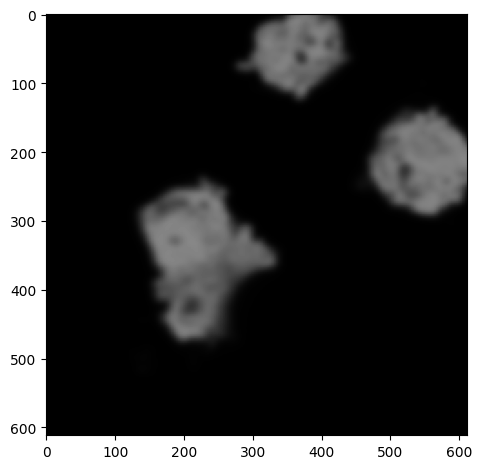

Segmented Cells


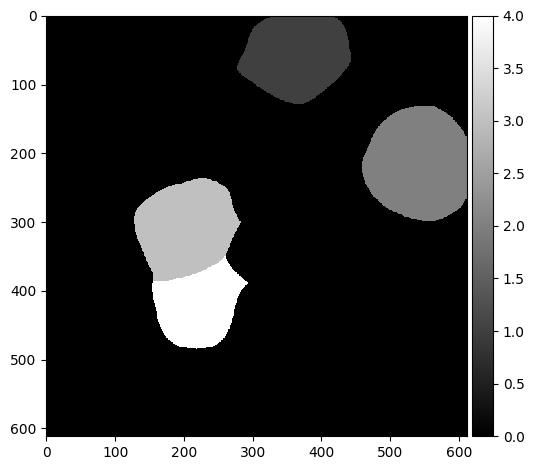

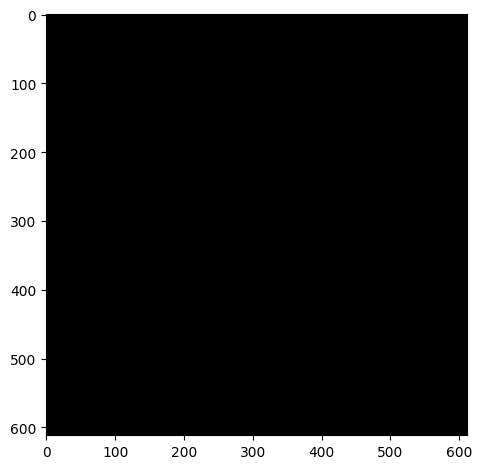

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


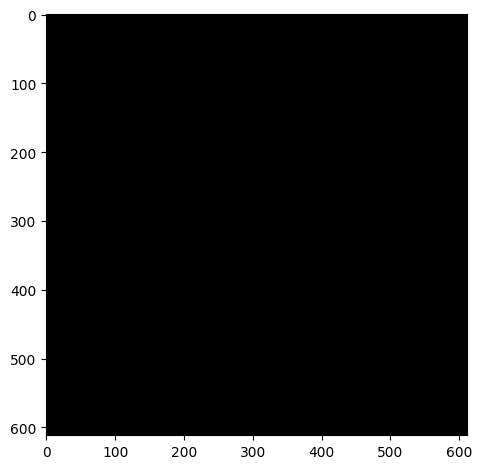

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


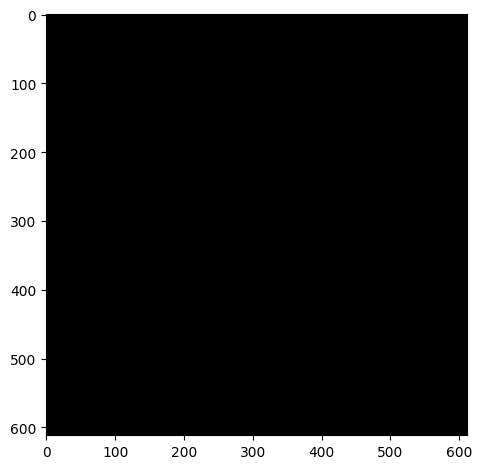

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


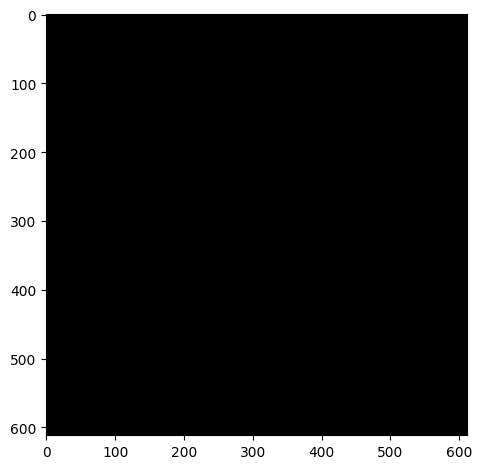

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_TAX1BP1_09.czi
Green Channel


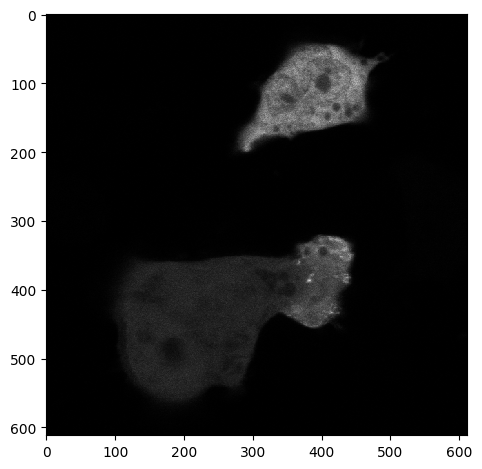

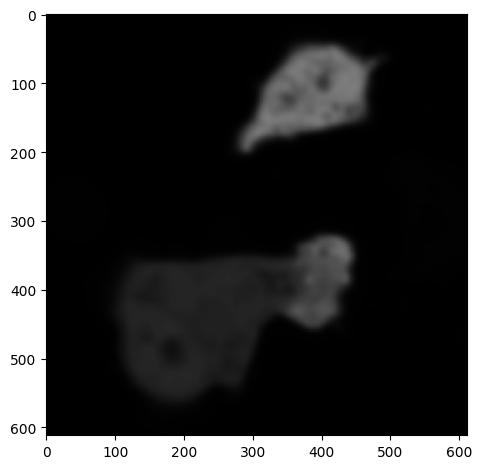

Segmented Cells


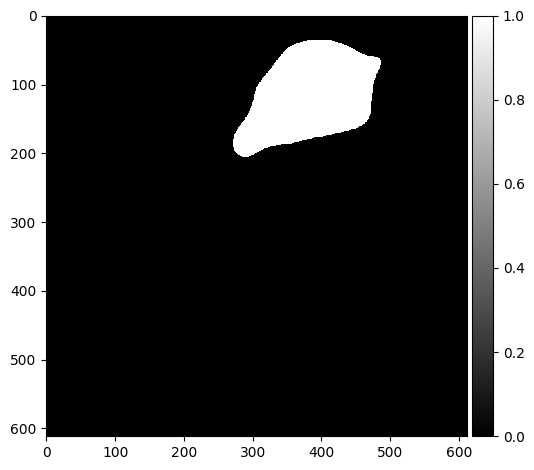

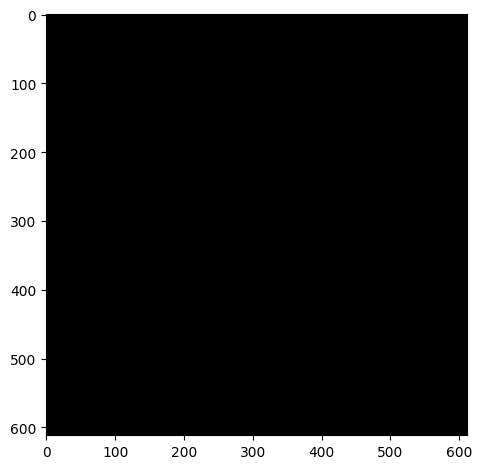

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_TAX1BP1_10.czi
Green Channel


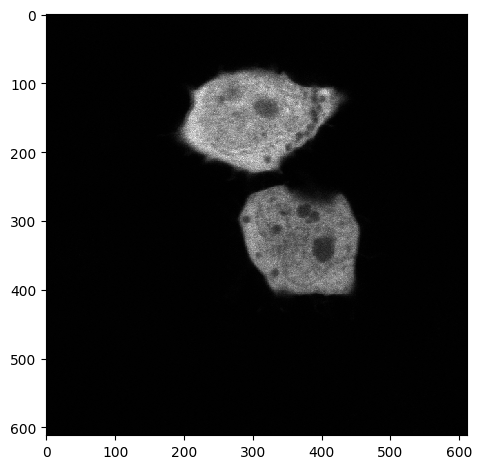

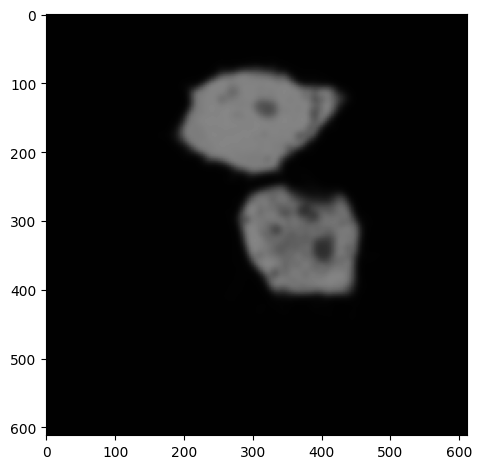

Segmented Cells


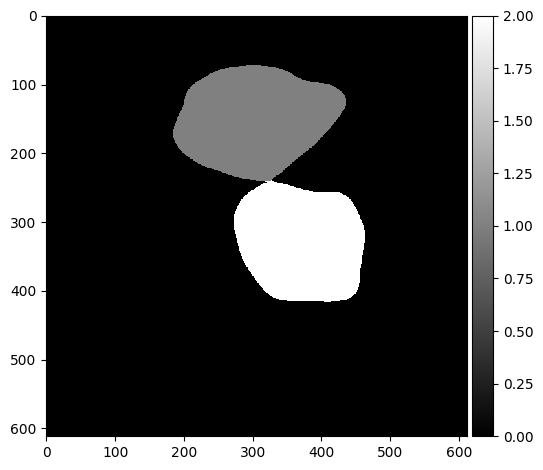

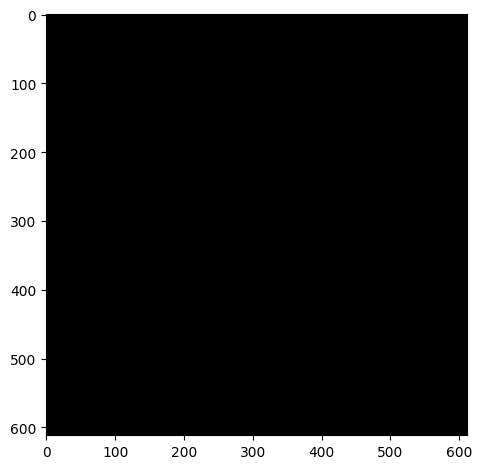

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


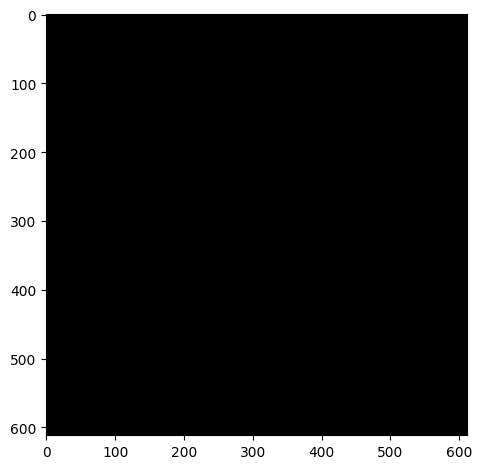

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


In [ ]:
analyze_all_images(folders[1])

1K_PFF_ADAMTS19_01.czi
Green Channel


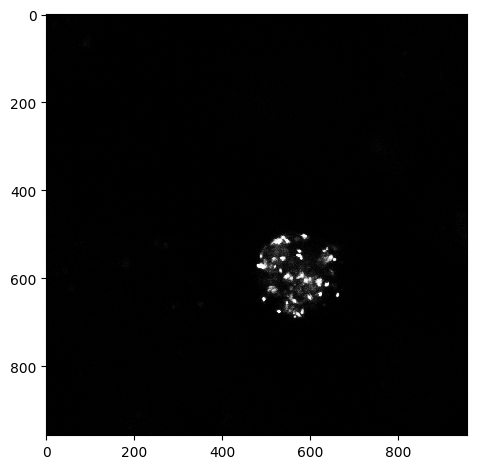

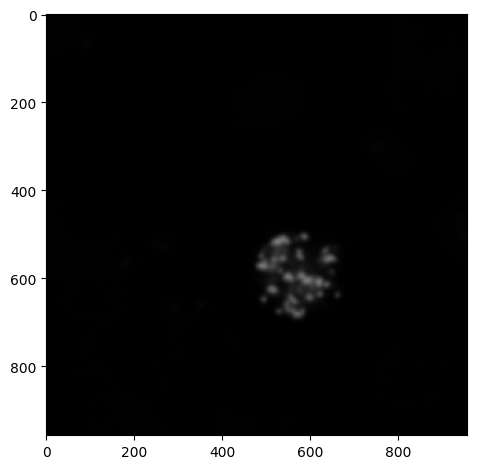

Segmented Cells


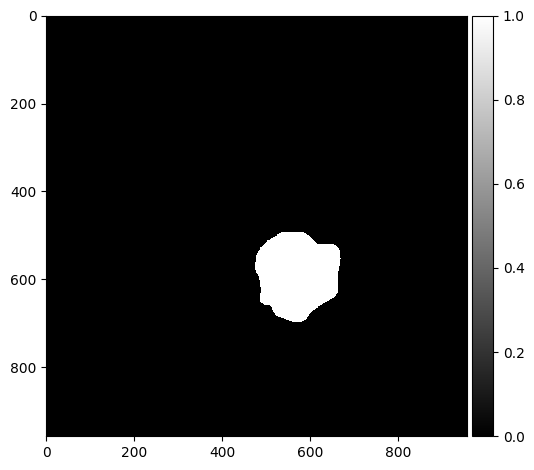

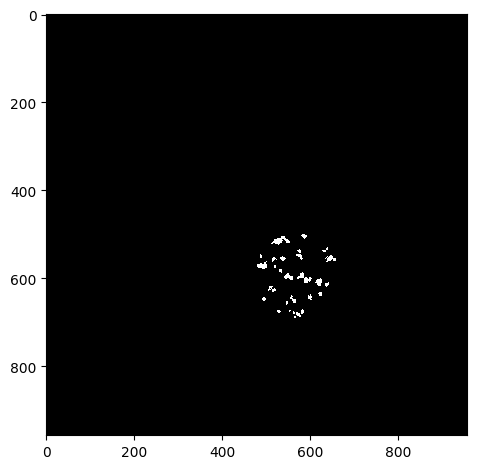

Cell 0: Number of inclusions: 28
Cell 0: Inclusion areas: [np.float64(96.0), np.float64(417.0), np.float64(54.0), np.float64(54.0), np.float64(106.0), np.float64(36.0), np.float64(188.0), np.float64(92.0), np.float64(64.0), np.float64(249.0), np.float64(25.0), np.float64(38.0), np.float64(332.0), np.float64(198.0), np.float64(198.0), np.float64(79.0), np.float64(58.0), np.float64(65.0), np.float64(64.0), np.float64(83.0), np.float64(112.0), np.float64(52.0), np.float64(38.0), np.float64(57.0), np.float64(13.0), np.float64(50.0), np.float64(105.0), np.float64(17.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_02.czi
Green Channel


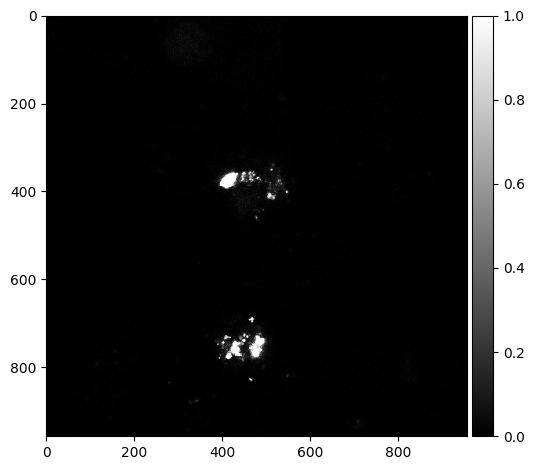

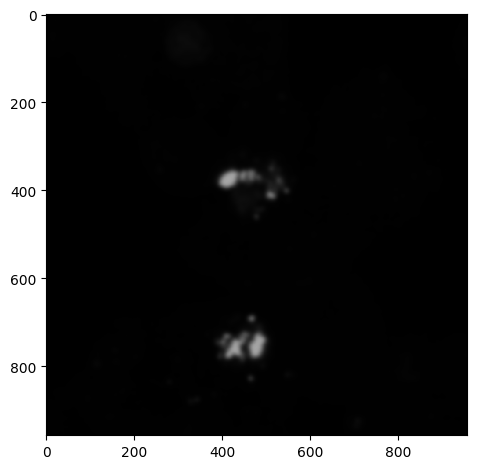

Segmented Cells


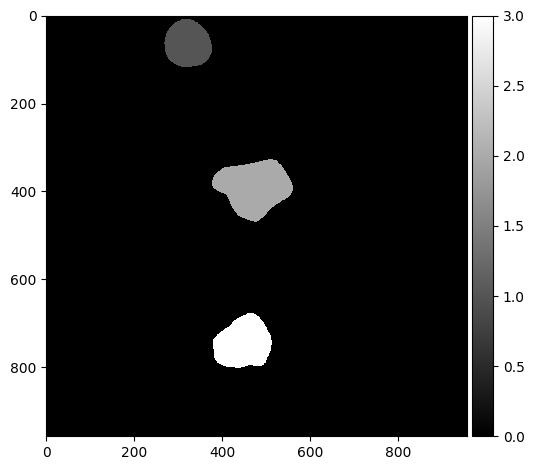

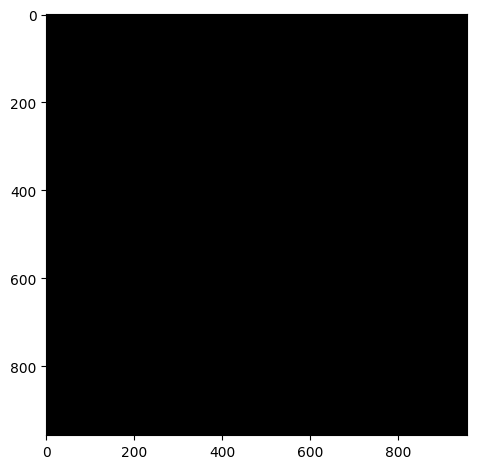

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


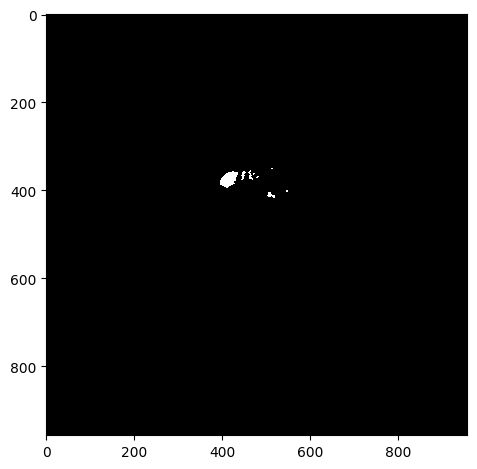

Cell 1: Number of inclusions: 9
Cell 1: Inclusion areas: [np.float64(11.0), np.float64(32.0), np.float64(117.0), np.float64(1005.0), np.float64(18.0), np.float64(58.0), np.float64(25.0), np.float64(21.0), np.float64(121.0)]


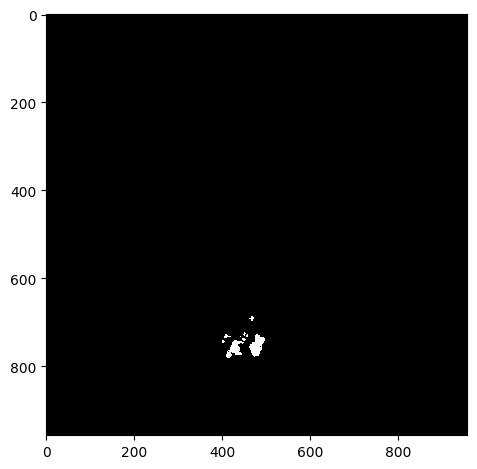

Cell 2: Number of inclusions: 9
Cell 2: Inclusion areas: [np.float64(76.0), np.float64(29.0), np.float64(68.0), np.float64(20.0), np.float64(1061.0), np.float64(11.0), np.float64(38.0), np.float64(824.0), np.float64(37.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_03.czi
Green Channel


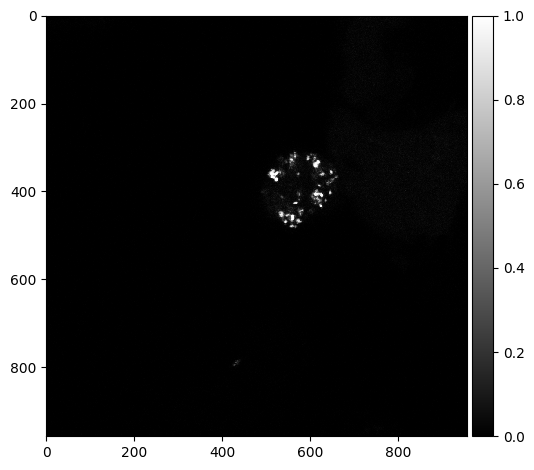

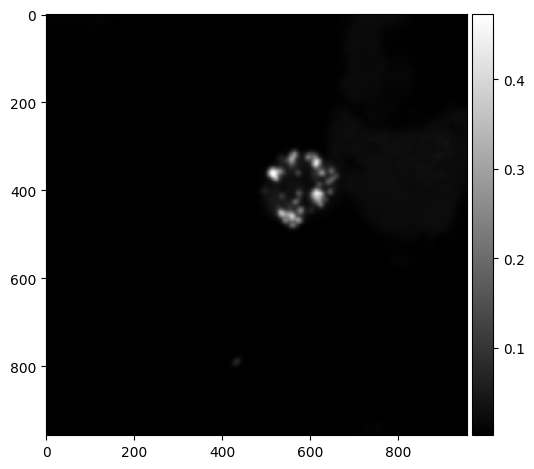

Segmented Cells


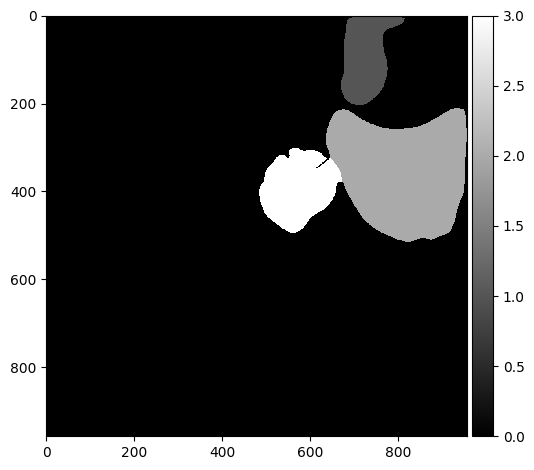

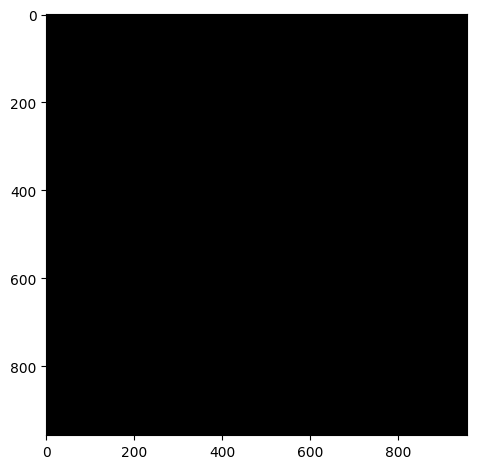

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


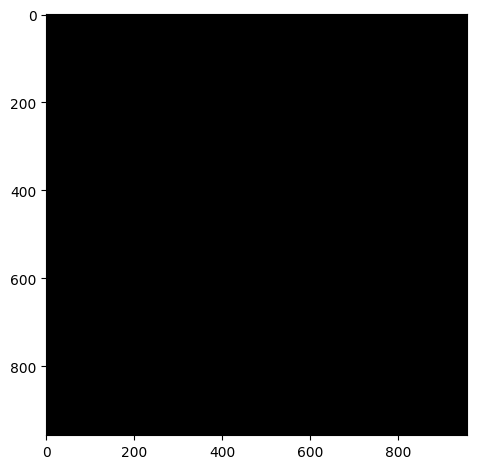

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


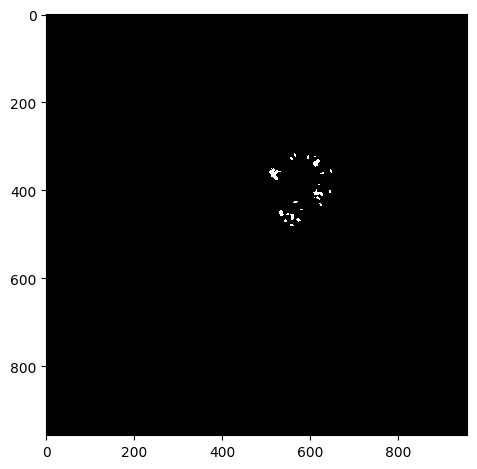

Cell 2: Number of inclusions: 21
Cell 2: Inclusion areas: [np.float64(28.0), np.float64(35.0), np.float64(12.0), np.float64(35.0), np.float64(176.0), np.float64(345.0), np.float64(25.0), np.float64(46.0), np.float64(12.0), np.float64(176.0), np.float64(24.0), np.float64(11.0), np.float64(32.0), np.float64(36.0), np.float64(29.0), np.float64(16.0), np.float64(99.0), np.float64(144.0), np.float64(57.0), np.float64(38.0), np.float64(26.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_04.czi
Green Channel


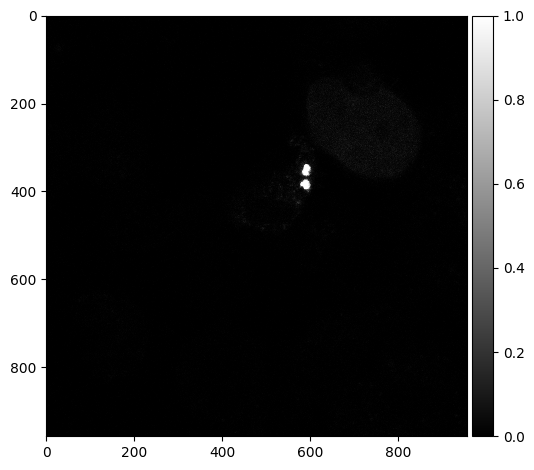

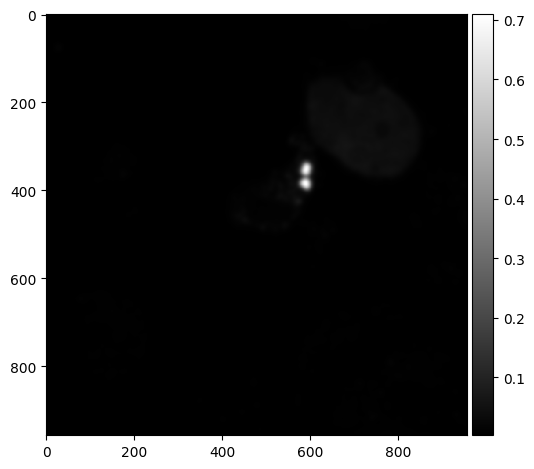

Segmented Cells


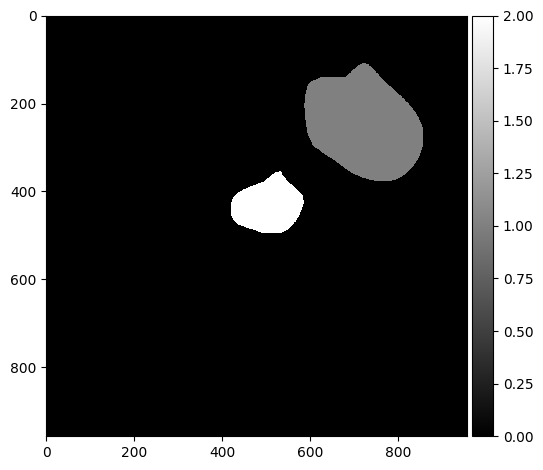

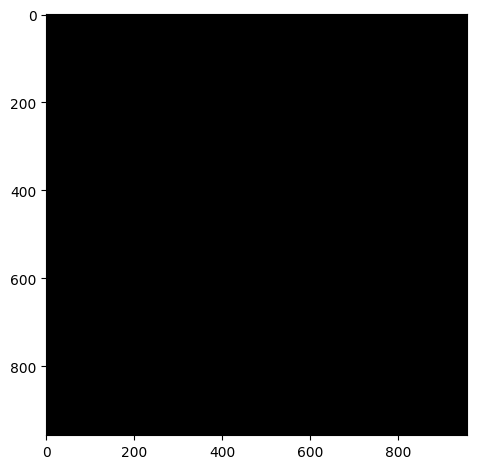

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


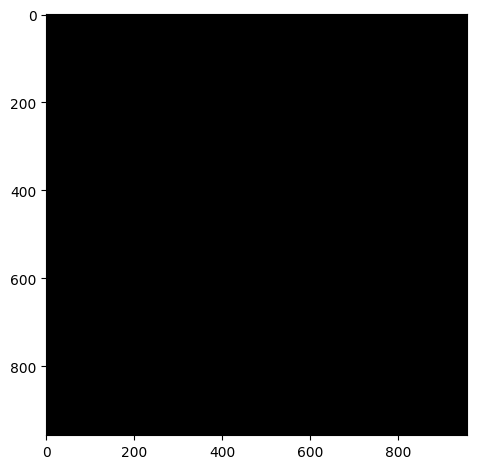

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_05.czi
Green Channel


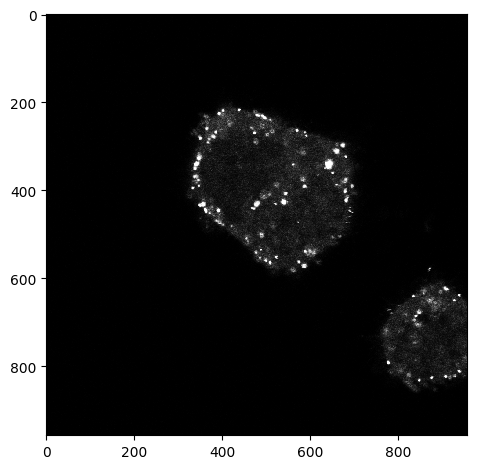

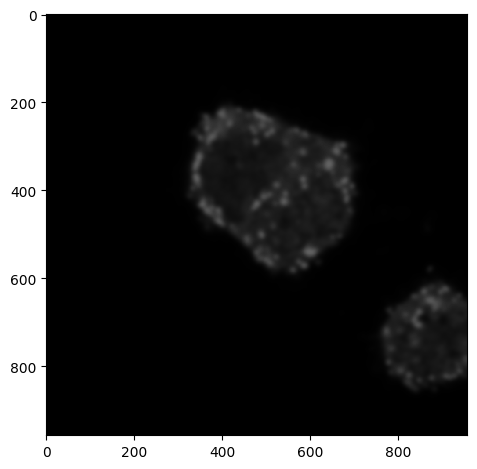

Segmented Cells


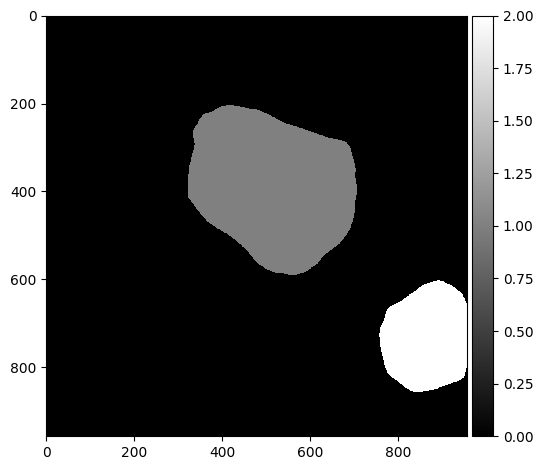

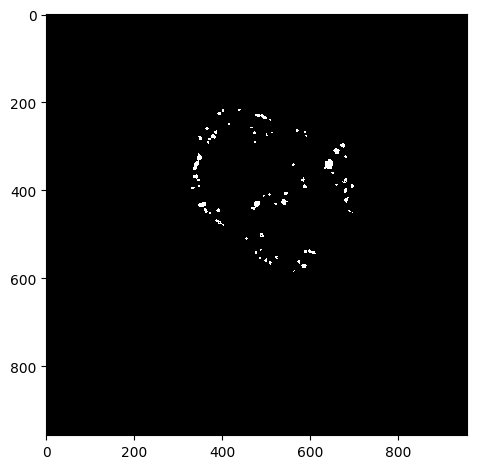

Cell 0: Number of inclusions: 65
Cell 0: Inclusion areas: [np.float64(31.0), np.float64(26.0), np.float64(53.0), np.float64(12.0), np.float64(176.0), np.float64(22.0), np.float64(17.0), np.float64(56.0), np.float64(15.0), np.float64(43.0), np.float64(18.0), np.float64(37.0), np.float64(30.0), np.float64(17.0), np.float64(15.0), np.float64(80.0), np.float64(20.0), np.float64(53.0), np.float64(33.0), np.float64(25.0), np.float64(15.0), np.float64(86.0), np.float64(129.0), np.float64(130.0), np.float64(30.0), np.float64(326.0), np.float64(188.0), np.float64(27.0), np.float64(21.0), np.float64(119.0), np.float64(49.0), np.float64(81.0), np.float64(24.0), np.float64(72.0), np.float64(39.0), np.float64(21.0), np.float64(28.0), np.float64(60.0), np.float64(62.0), np.float64(29.0), np.float64(17.0), np.float64(77.0), np.float64(133.0), np.float64(187.0), np.float64(142.0), np.float64(20.0), np.float64(75.0), np.float64(70.0), np.float64(21.0), np.float64(24.0), np.float64(81.0), np.float64(14.

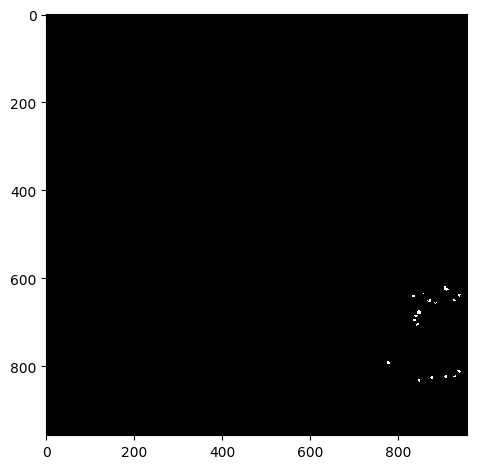

Cell 1: Number of inclusions: 18
Cell 1: Inclusion areas: [np.float64(77.0), np.float64(10.0), np.float64(28.0), np.float64(27.0), np.float64(18.0), np.float64(24.0), np.float64(19.0), np.float64(15.0), np.float64(64.0), np.float64(32.0), np.float64(30.0), np.float64(20.0), np.float64(47.0), np.float64(42.0), np.float64(38.0), np.float64(18.0), np.float64(37.0), np.float64(26.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_06.czi
Green Channel


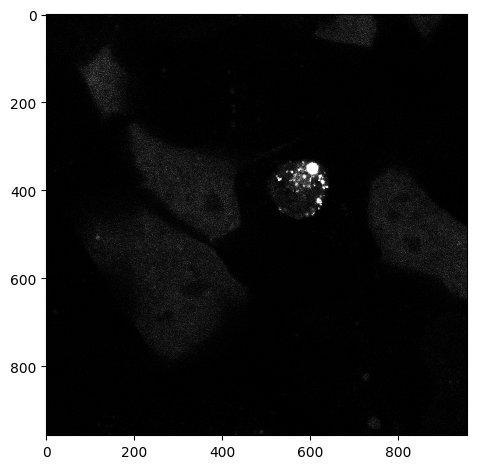

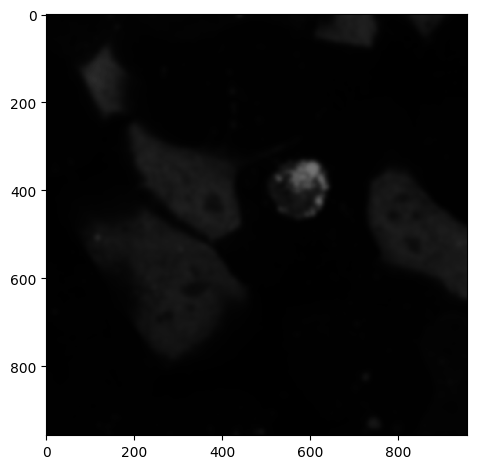

Segmented Cells


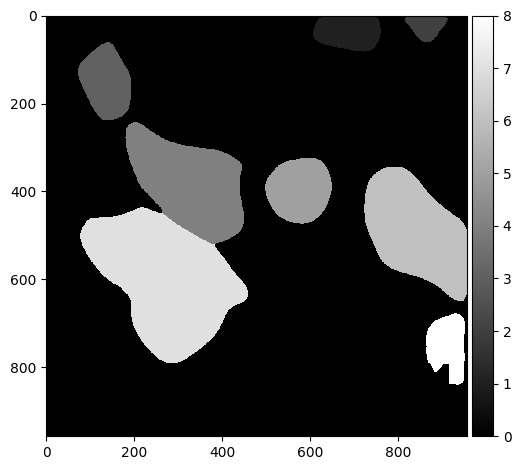

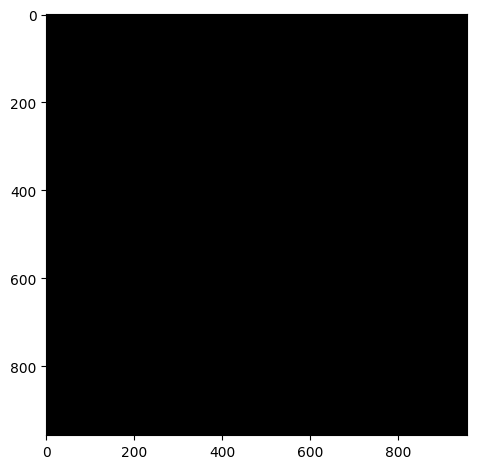

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


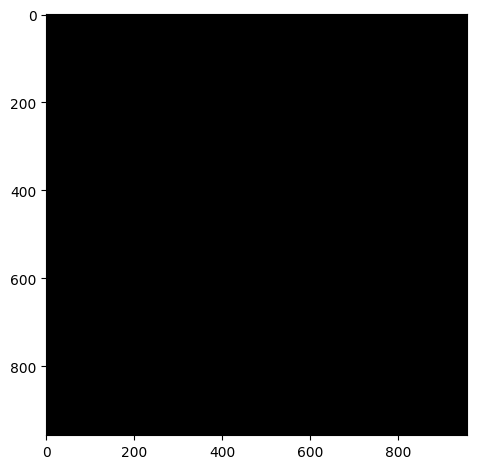

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


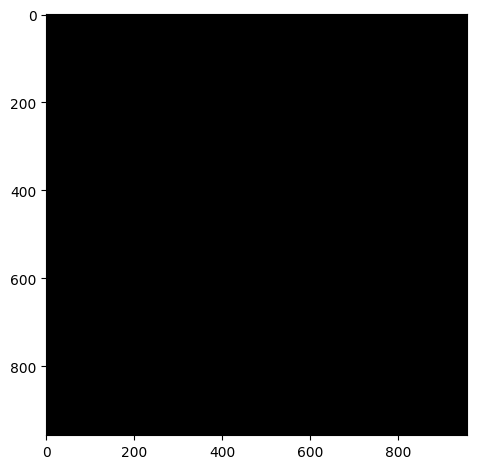

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


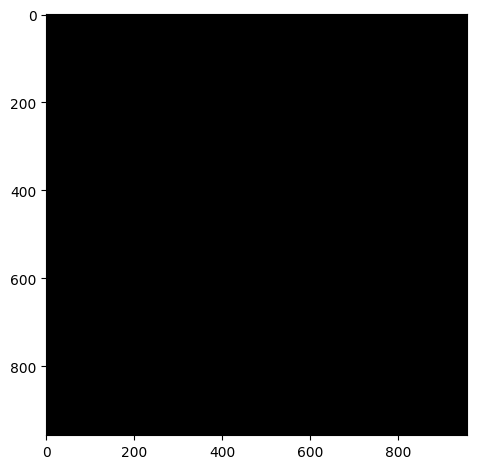

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []


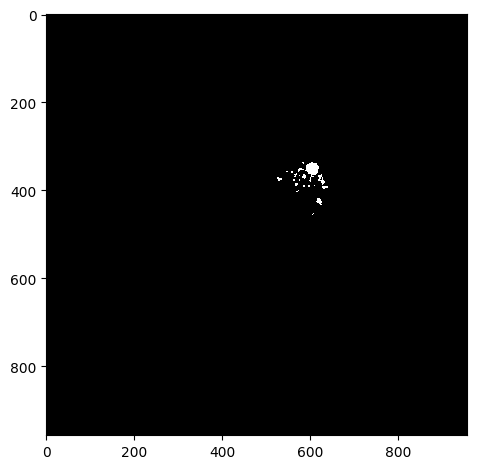

Cell 4: Number of inclusions: 22
Cell 4: Inclusion areas: [np.float64(18.0), np.float64(697.0), np.float64(58.0), np.float64(11.0), np.float64(27.0), np.float64(39.0), np.float64(13.0), np.float64(75.0), np.float64(176.0), np.float64(54.0), np.float64(34.0), np.float64(18.0), np.float64(10.0), np.float64(43.0), np.float64(17.0), np.float64(17.0), np.float64(19.0), np.float64(25.0), np.float64(35.0), np.float64(10.0), np.float64(132.0), np.float64(14.0)]


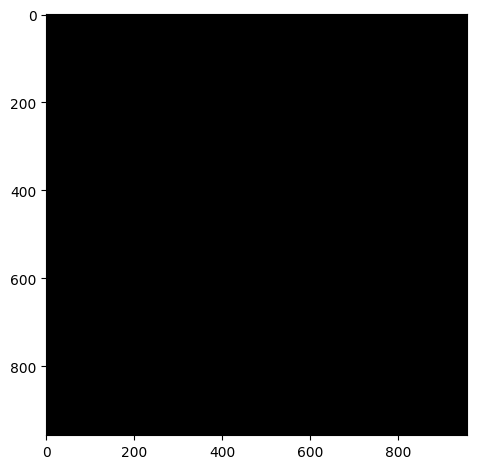

Cell 5: Number of inclusions: 0
Cell 5: Inclusion areas: []


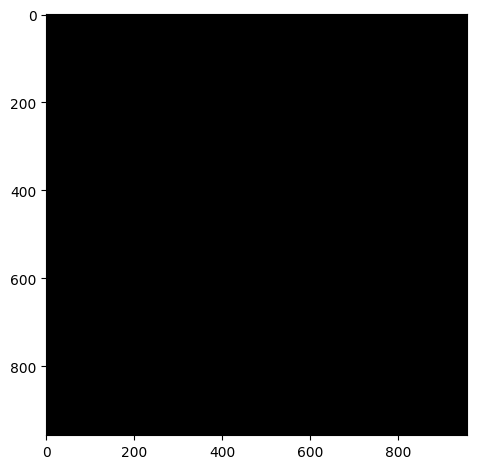

Cell 6: Number of inclusions: 0
Cell 6: Inclusion areas: []


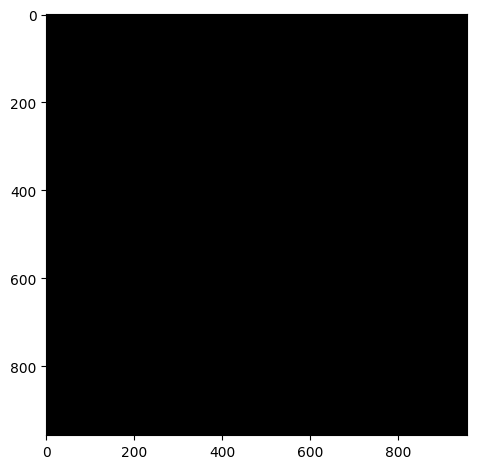

Cell 7: Number of inclusions: 0
Cell 7: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_07.czi
Green Channel


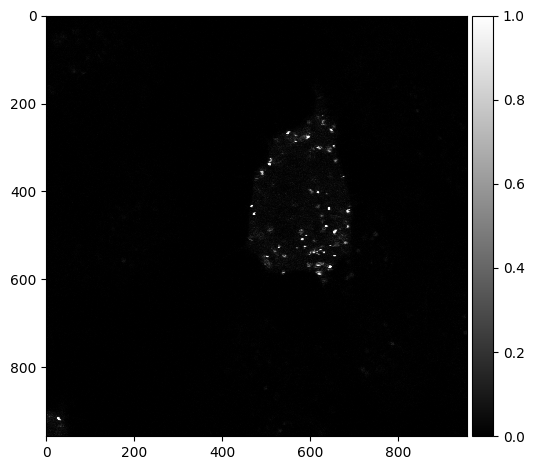

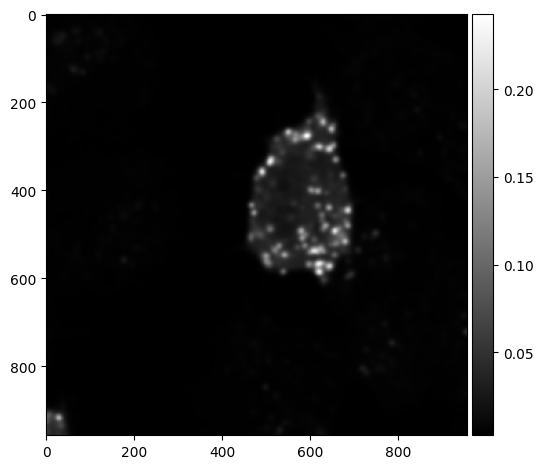

Segmented Cells


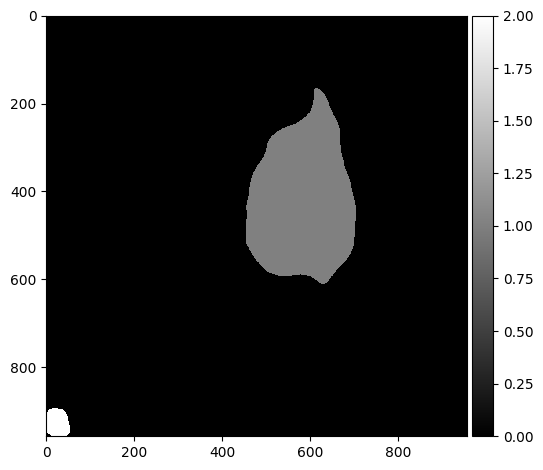

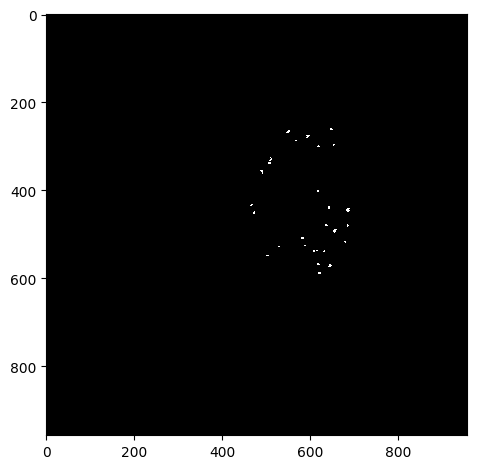

Cell 0: Number of inclusions: 27
Cell 0: Inclusion areas: [np.float64(23.0), np.float64(32.0), np.float64(45.0), np.float64(11.0), np.float64(17.0), np.float64(15.0), np.float64(28.0), np.float64(34.0), np.float64(33.0), np.float64(27.0), np.float64(26.0), np.float64(31.0), np.float64(49.0), np.float64(29.0), np.float64(22.0), np.float64(17.0), np.float64(45.0), np.float64(24.0), np.float64(15.0), np.float64(15.0), np.float64(12.0), np.float64(31.0), np.float64(16.0), np.float64(16.0), np.float64(30.0), np.float64(37.0), np.float64(29.0)]


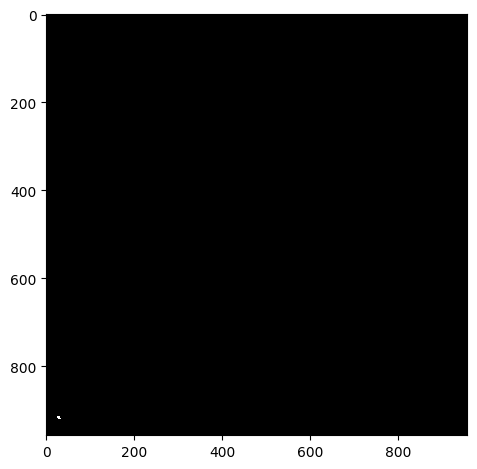

Cell 1: Number of inclusions: 1
Cell 1: Inclusion areas: [np.float64(38.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_08.czi
Green Channel


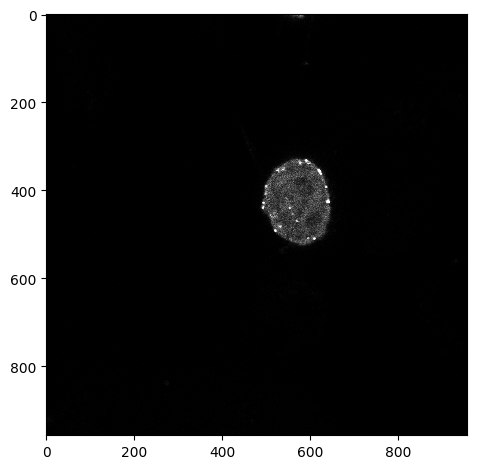

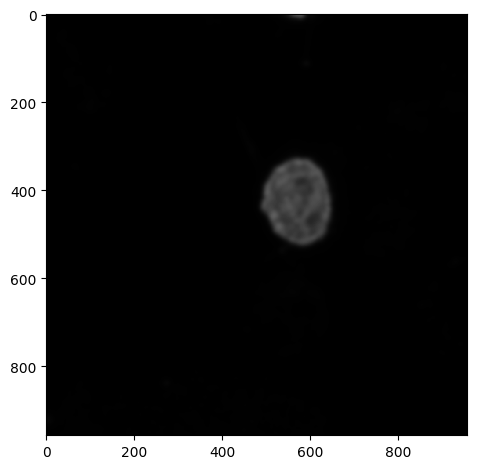

Segmented Cells


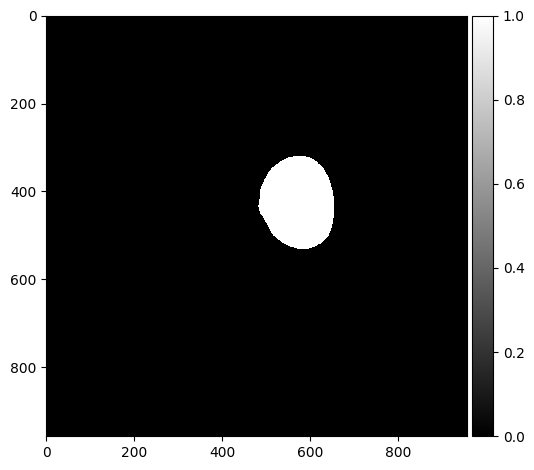

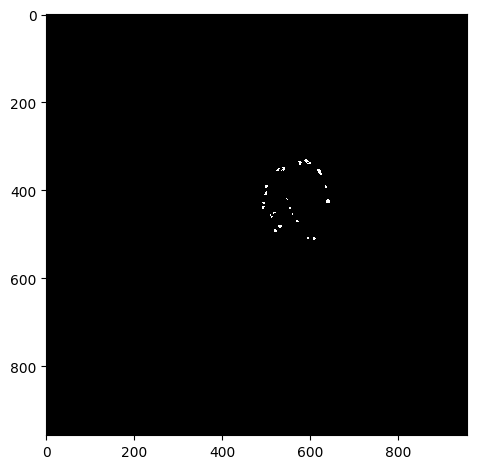

Cell 0: Number of inclusions: 21
Cell 0: Inclusion areas: [np.float64(82.0), np.float64(64.0), np.float64(52.0), np.float64(45.0), np.float64(96.0), np.float64(35.0), np.float64(23.0), np.float64(39.0), np.float64(15.0), np.float64(66.0), np.float64(32.0), np.float64(45.0), np.float64(21.0), np.float64(19.0), np.float64(13.0), np.float64(37.0), np.float64(25.0), np.float64(34.0), np.float64(31.0), np.float64(37.0), np.float64(17.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_09.czi
Green Channel


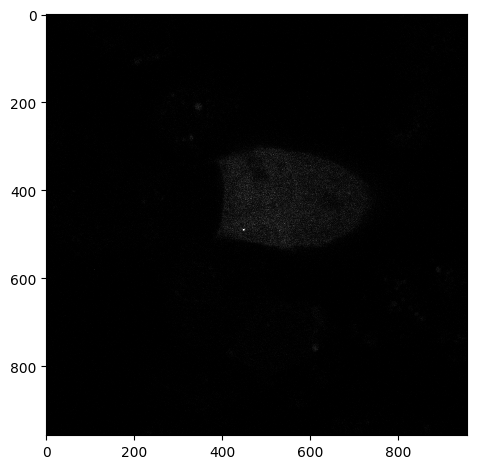

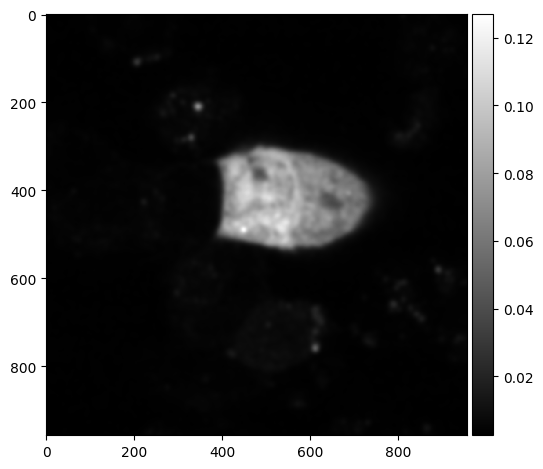

Segmented Cells


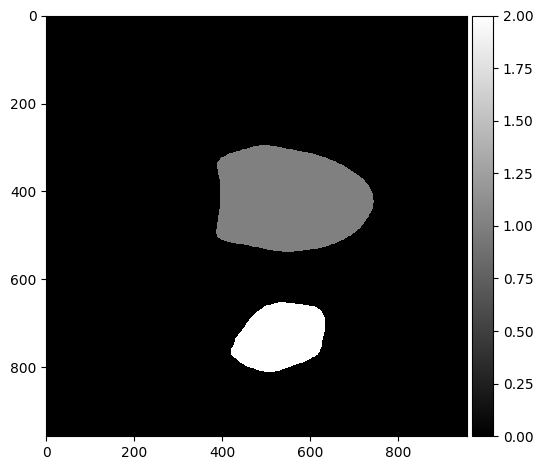

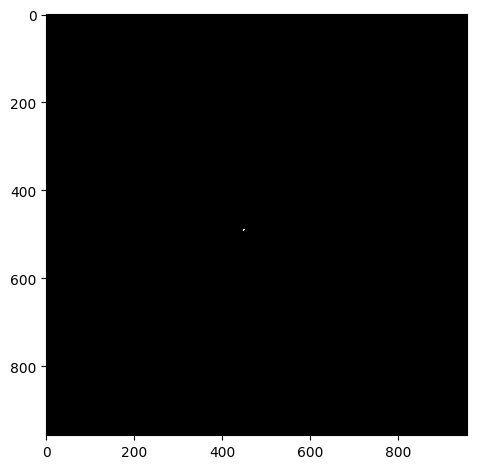

Cell 0: Number of inclusions: 1
Cell 0: Inclusion areas: [np.float64(10.0)]


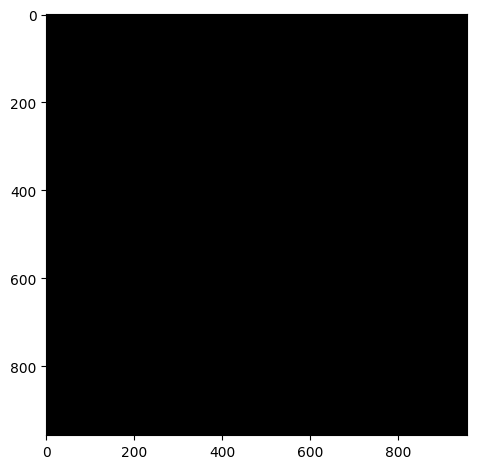

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_10.czi
Green Channel


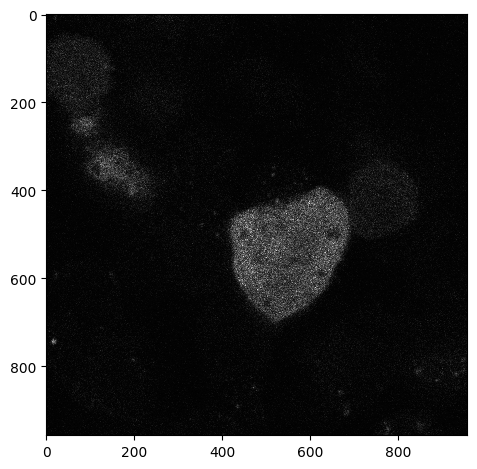

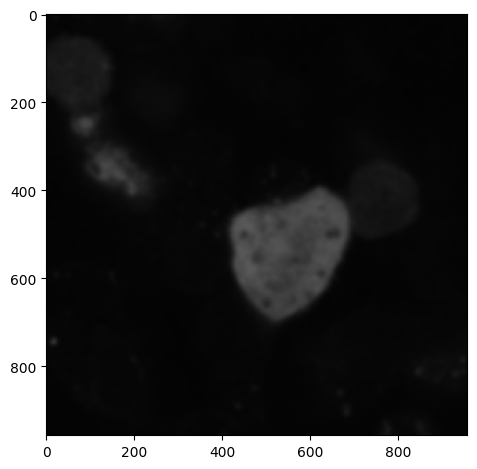

Segmented Cells


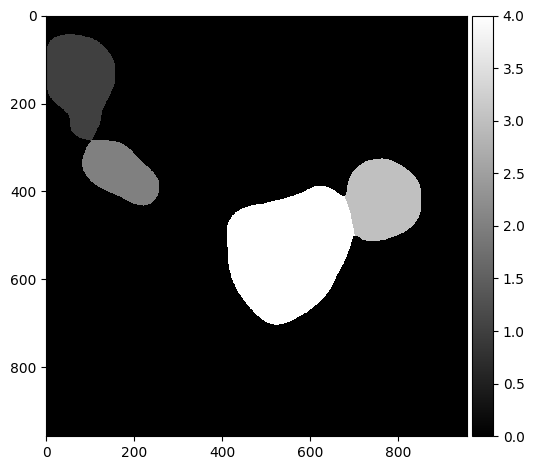

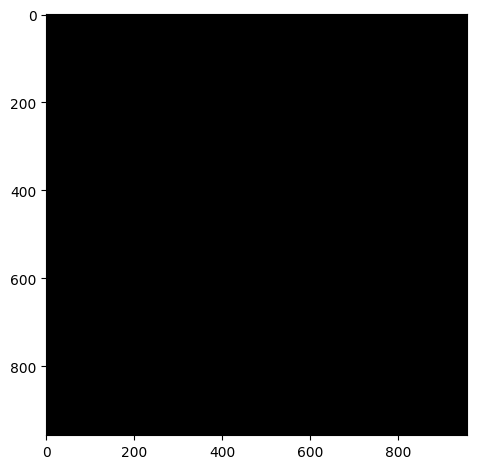

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


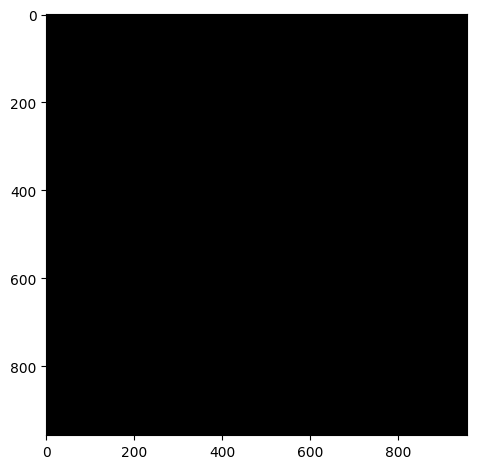

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


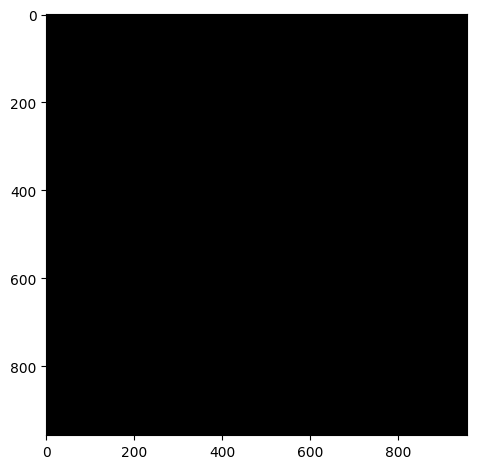

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


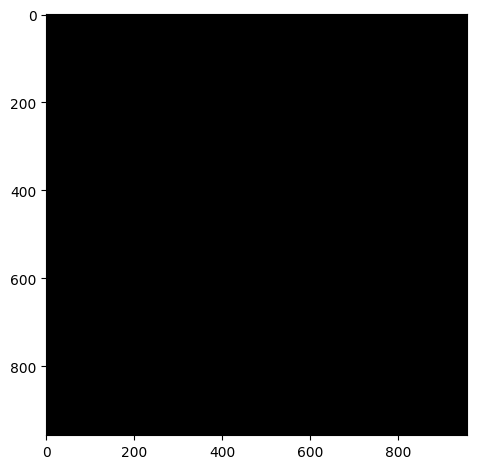

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_SCR_01.czi
Green Channel


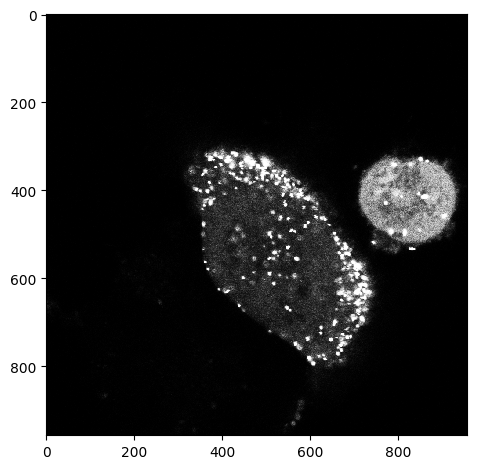

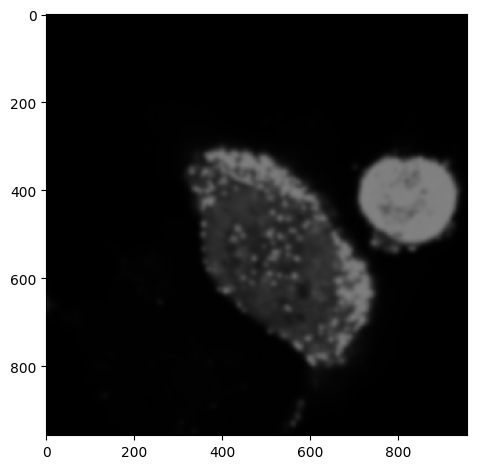

Segmented Cells


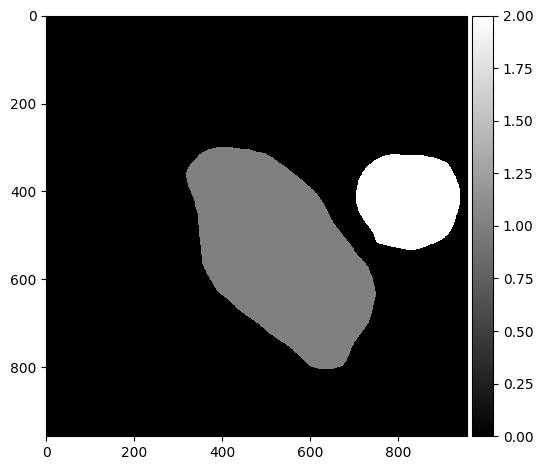

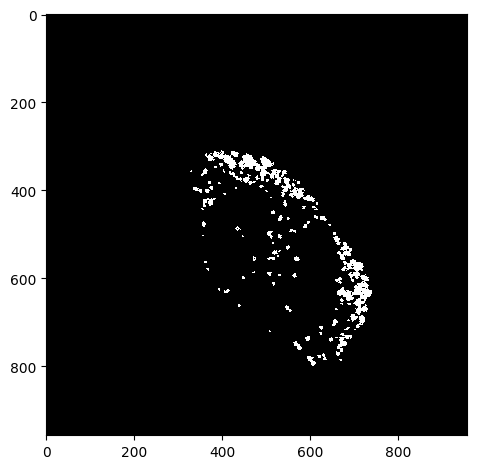

Cell 0: Number of inclusions: 96
Cell 0: Inclusion areas: [np.float64(1152.0), np.float64(184.0), np.float64(2726.0), np.float64(61.0), np.float64(29.0), np.float64(134.0), np.float64(37.0), np.float64(20.0), np.float64(234.0), np.float64(49.0), np.float64(248.0), np.float64(69.0), np.float64(525.0), np.float64(41.0), np.float64(14.0), np.float64(48.0), np.float64(41.0), np.float64(26.0), np.float64(876.0), np.float64(47.0), np.float64(75.0), np.float64(30.0), np.float64(137.0), np.float64(83.0), np.float64(21.0), np.float64(20.0), np.float64(11.0), np.float64(337.0), np.float64(90.0), np.float64(38.0), np.float64(43.0), np.float64(66.0), np.float64(21.0), np.float64(65.0), np.float64(68.0), np.float64(98.0), np.float64(136.0), np.float64(34.0), np.float64(46.0), np.float64(76.0), np.float64(63.0), np.float64(18.0), np.float64(63.0), np.float64(84.0), np.float64(141.0), np.float64(52.0), np.float64(21.0), np.float64(14.0), np.float64(61.0), np.float64(186.0), np.float64(640.0), np.floa

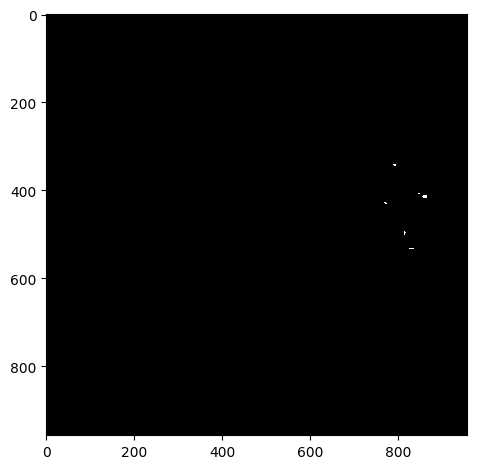

Cell 1: Number of inclusions: 6
Cell 1: Inclusion areas: [np.float64(26.0), np.float64(13.0), np.float64(64.0), np.float64(19.0), np.float64(38.0), np.float64(16.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_SCR_02.czi
Green Channel


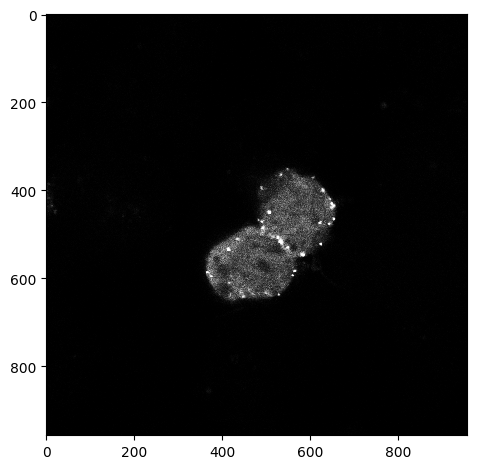

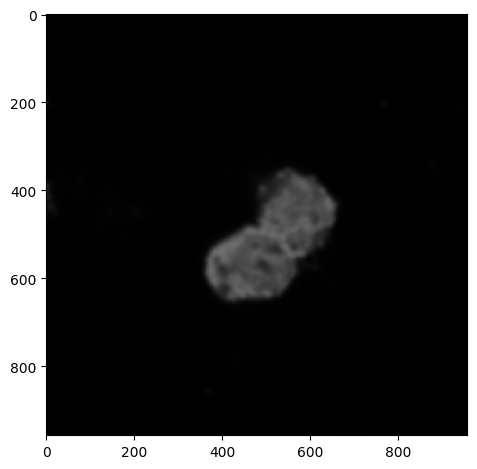

Segmented Cells


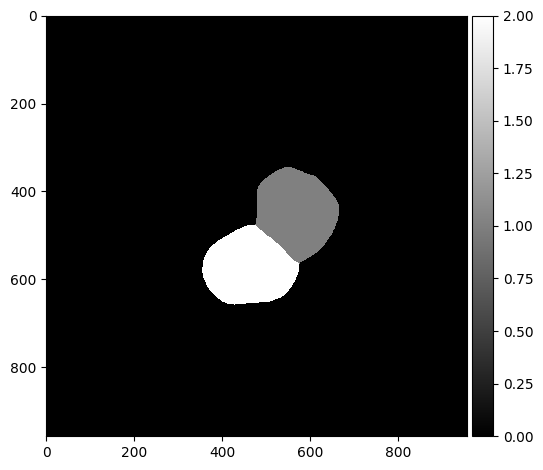

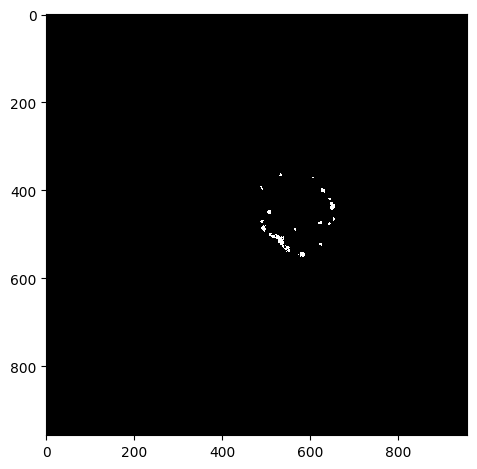

Cell 0: Number of inclusions: 17
Cell 0: Inclusion areas: [np.float64(30.0), np.float64(11.0), np.float64(28.0), np.float64(70.0), np.float64(36.0), np.float64(162.0), np.float64(80.0), np.float64(34.0), np.float64(35.0), np.float64(55.0), np.float64(43.0), np.float64(109.0), np.float64(25.0), np.float64(516.0), np.float64(11.0), np.float64(34.0), np.float64(118.0)]


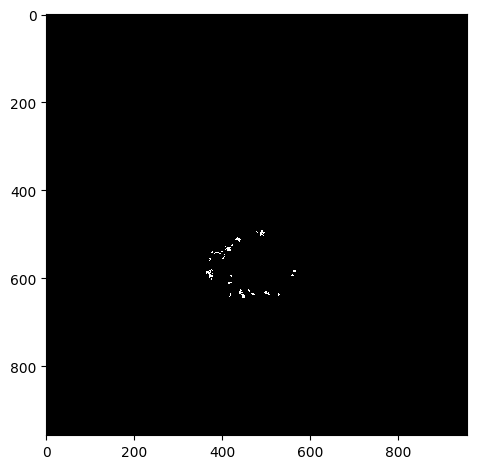

Cell 1: Number of inclusions: 21
Cell 1: Inclusion areas: [np.float64(79.0), np.float64(11.0), np.float64(71.0), np.float64(10.0), np.float64(110.0), np.float64(74.0), np.float64(11.0), np.float64(24.0), np.float64(17.0), np.float64(179.0), np.float64(33.0), np.float64(23.0), np.float64(18.0), np.float64(44.0), np.float64(52.0), np.float64(24.0), np.float64(66.0), np.float64(22.0), np.float64(22.0), np.float64(20.0), np.float64(66.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_SCR_03.czi
Green Channel


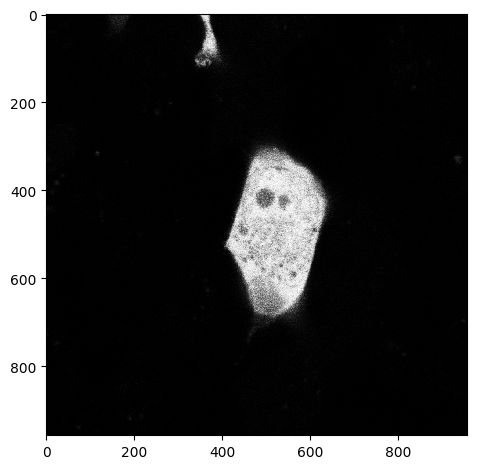

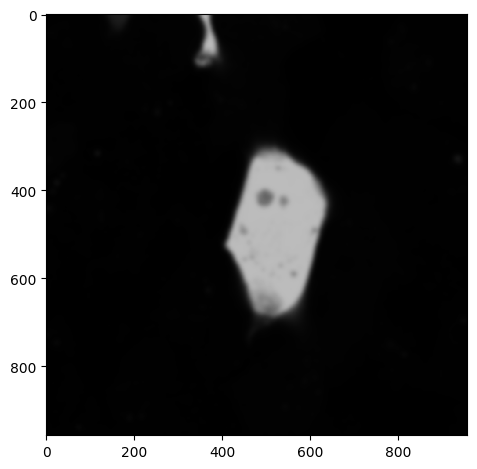

Segmented Cells


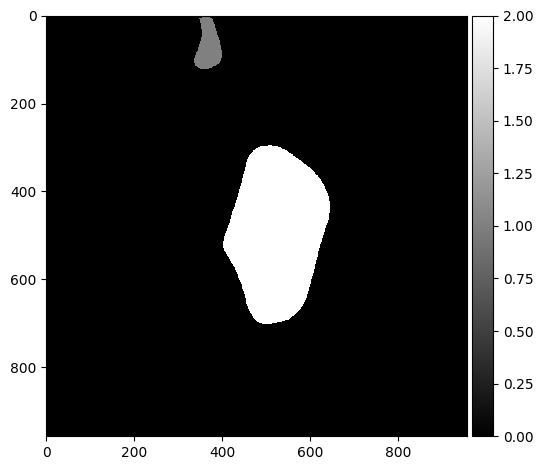

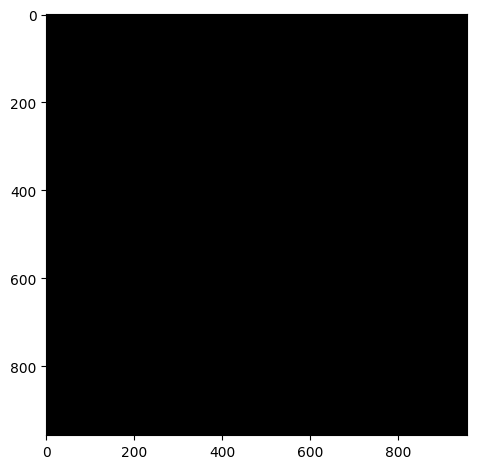

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


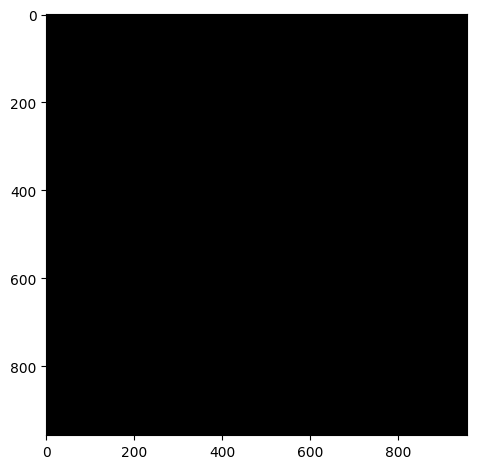

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_SCR_04.czi
Green Channel


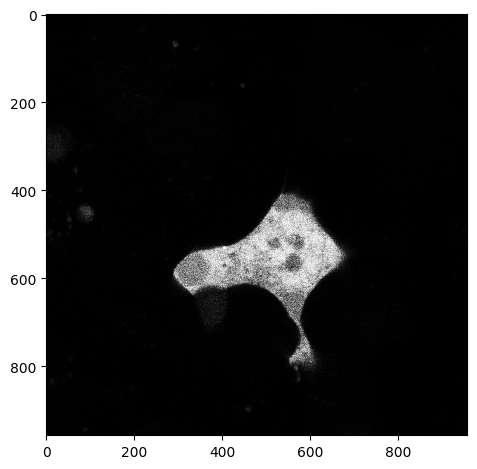

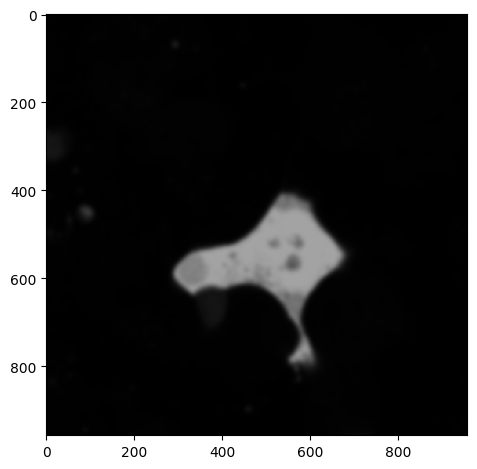

Segmented Cells


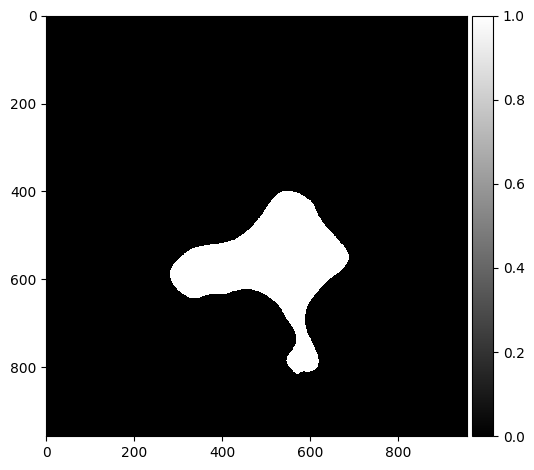

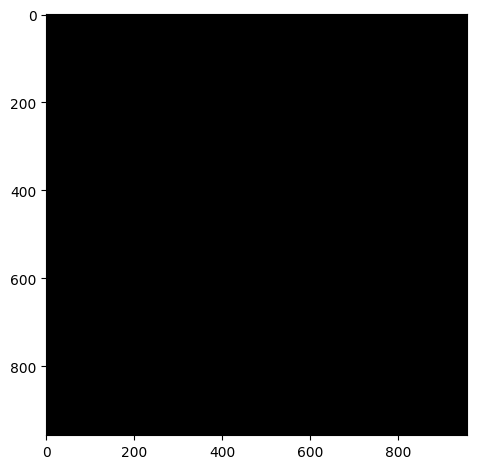

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_SCR_05.czi
Green Channel


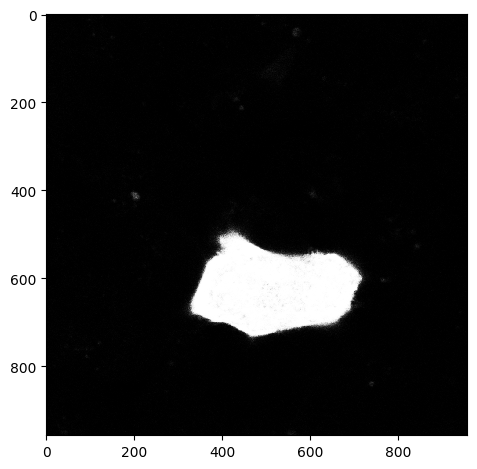

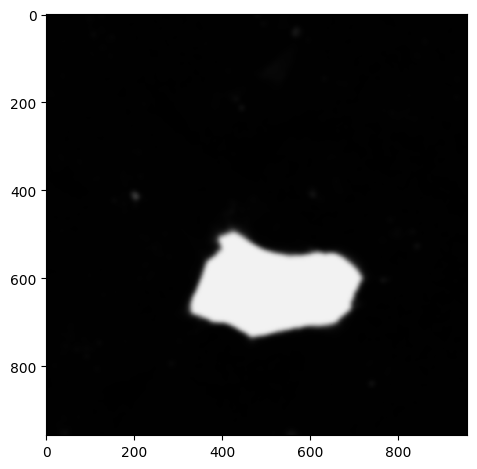

Segmented Cells


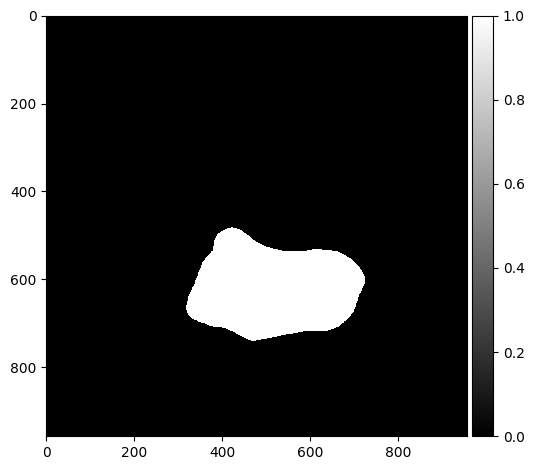

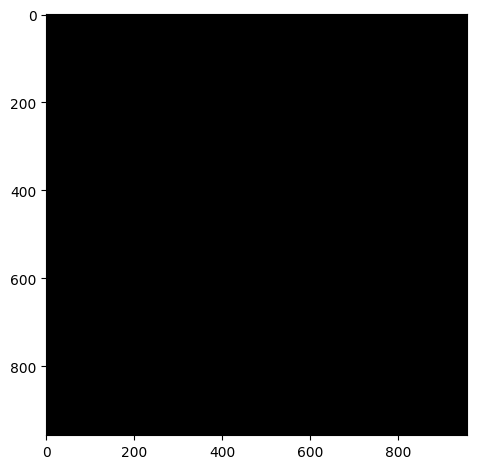

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_SCR_06.czi
Green Channel


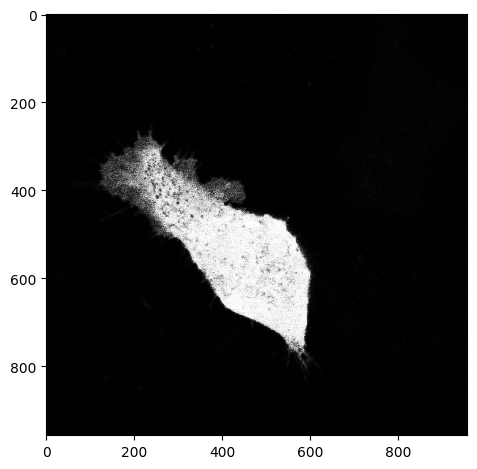

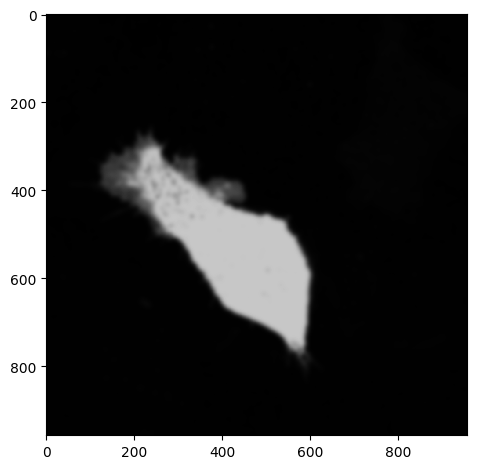

Segmented Cells


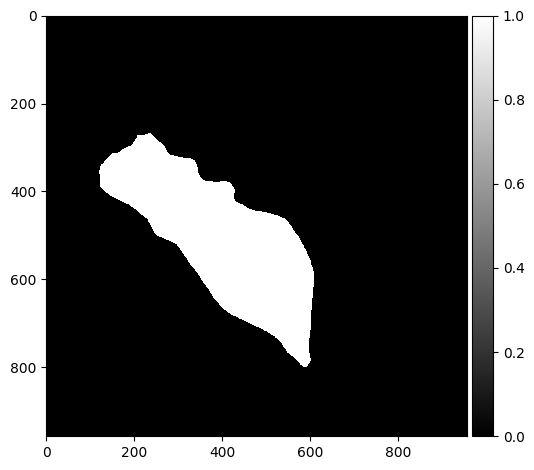

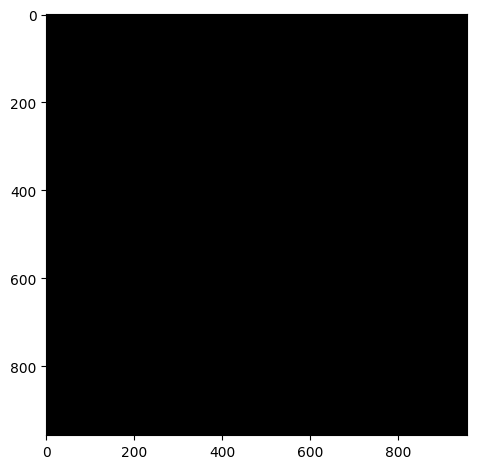

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_SCR_07.czi
Green Channel


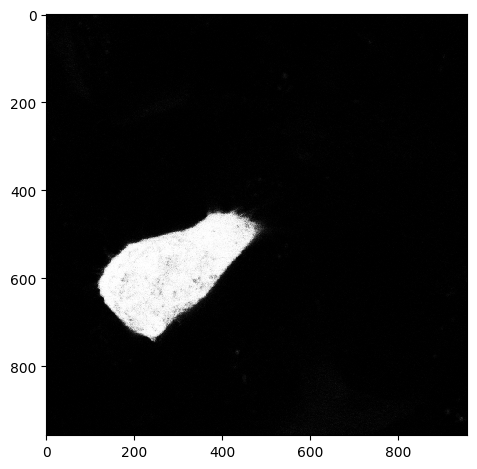

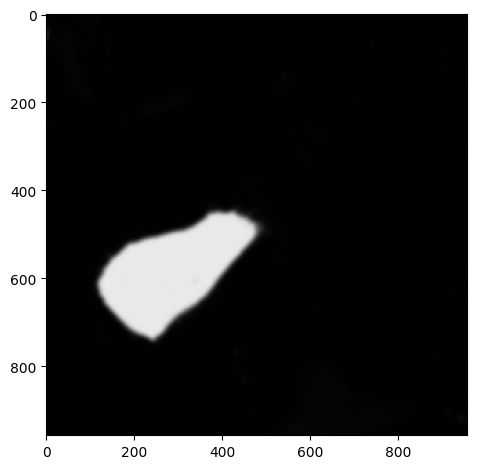

Segmented Cells


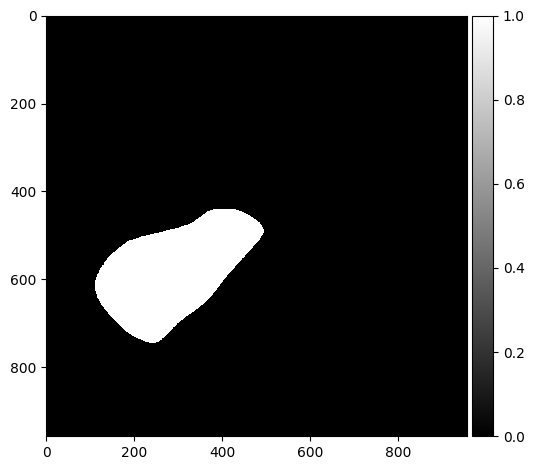

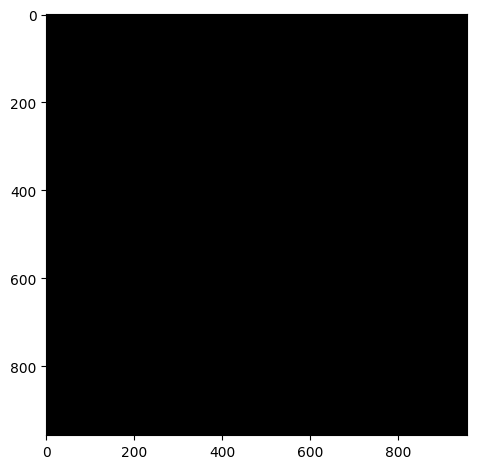

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_SCR_08.czi
Green Channel


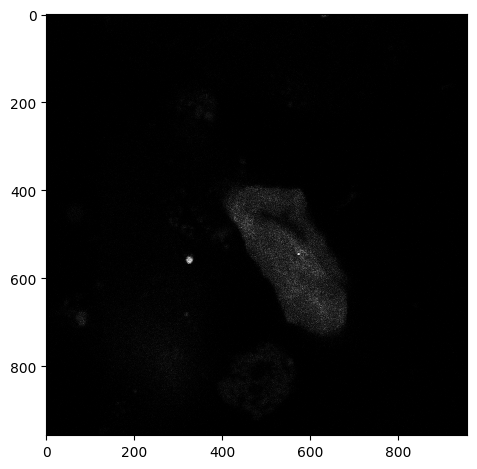

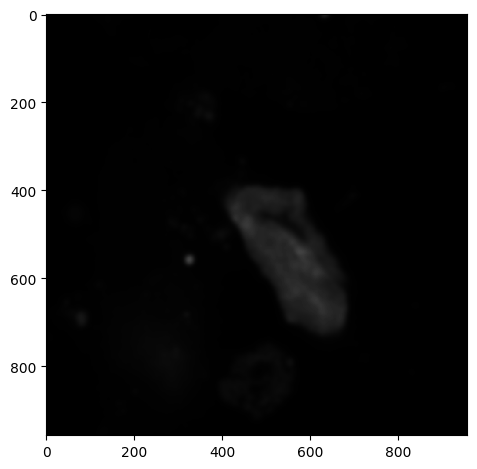

Segmented Cells


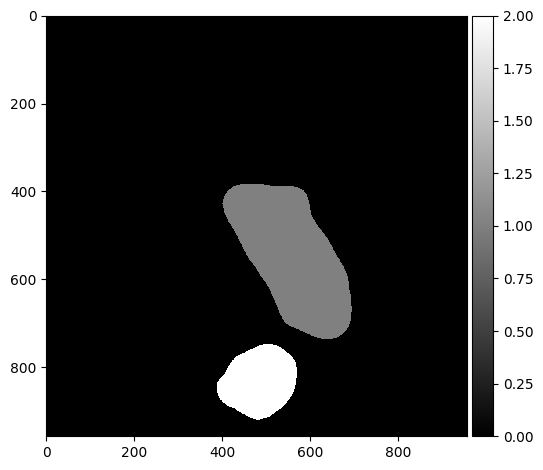

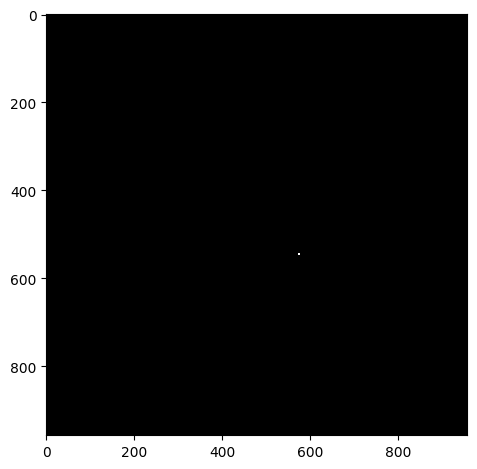

Cell 0: Number of inclusions: 1
Cell 0: Inclusion areas: [np.float64(20.0)]


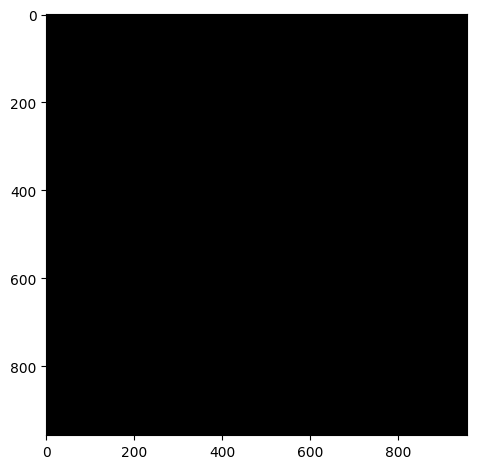

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_SCR_09.czi
Green Channel


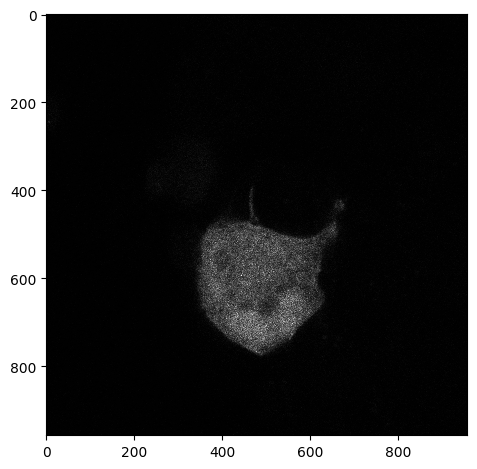

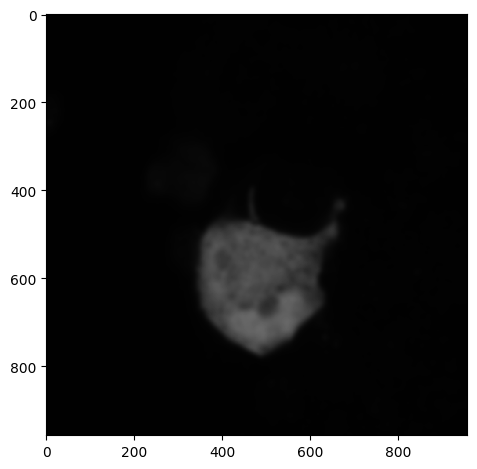

Segmented Cells


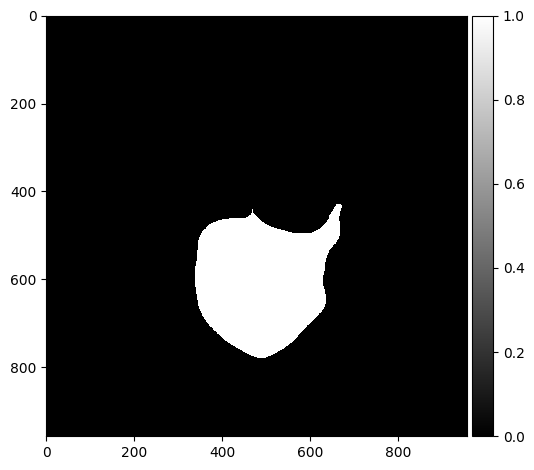

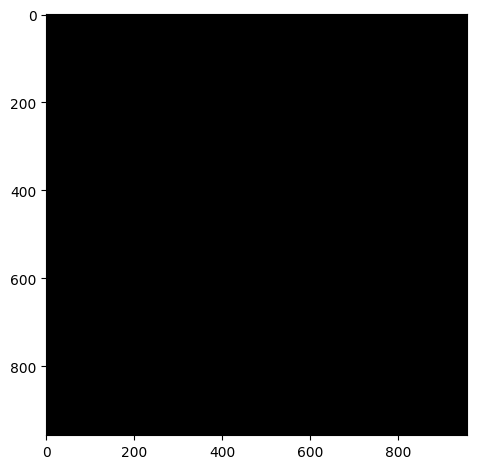

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_SCR_10.czi
Green Channel


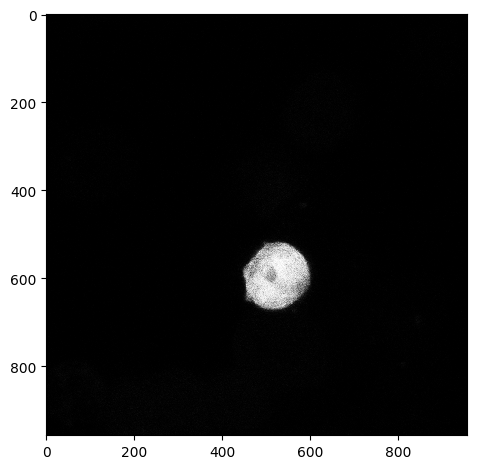

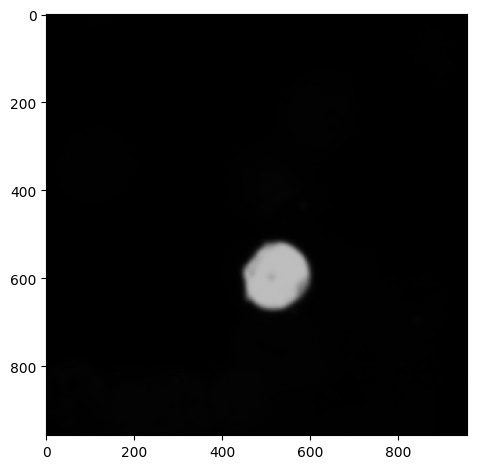

Segmented Cells


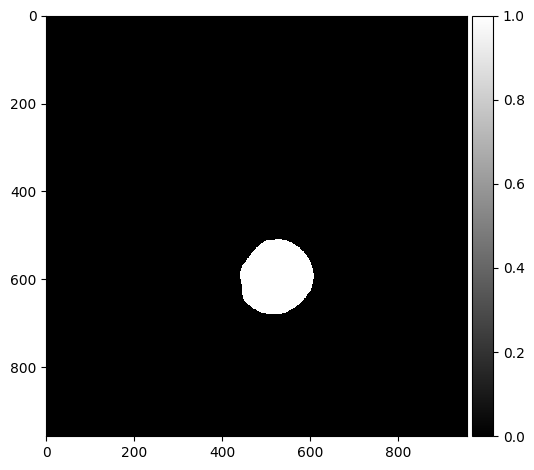

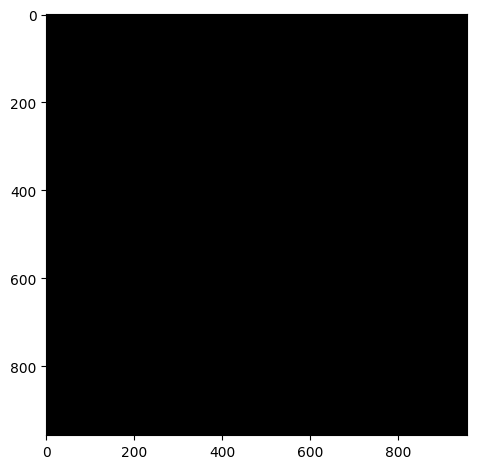

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_01.czi
Green Channel


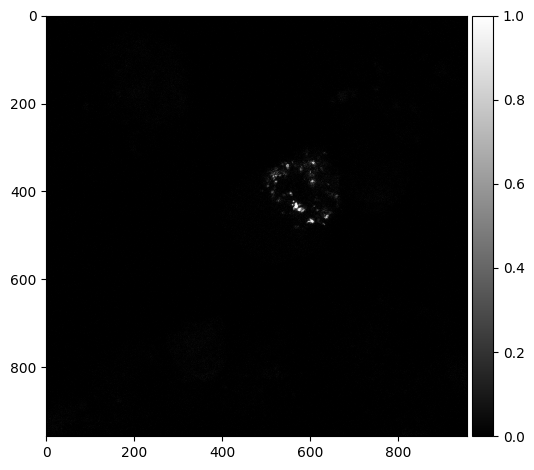

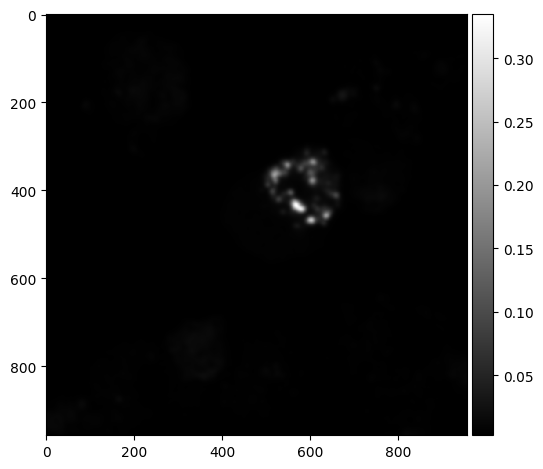

Segmented Cells


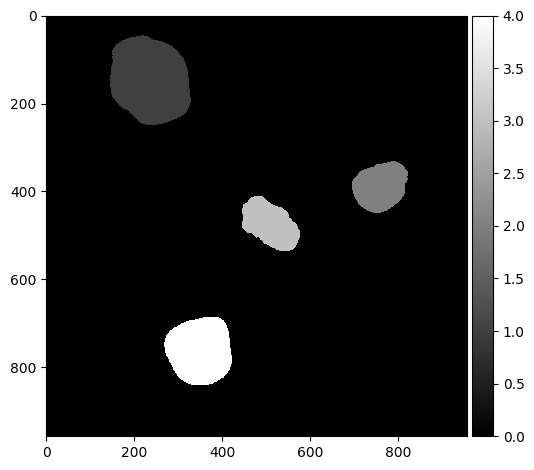

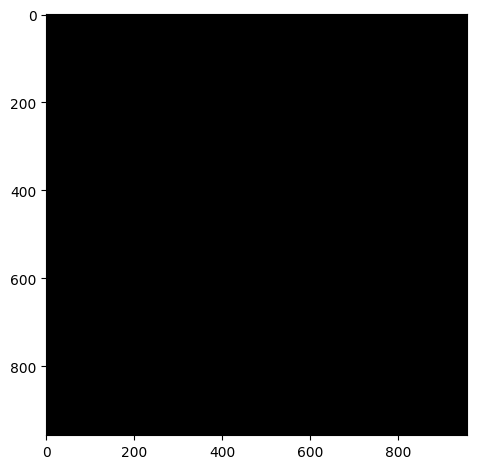

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


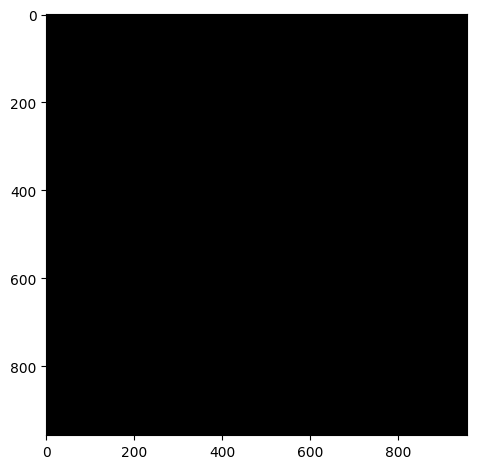

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


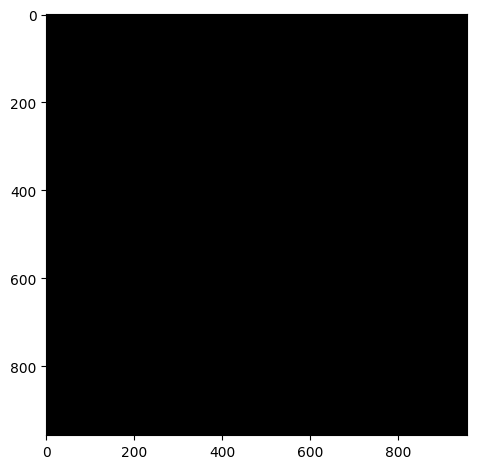

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


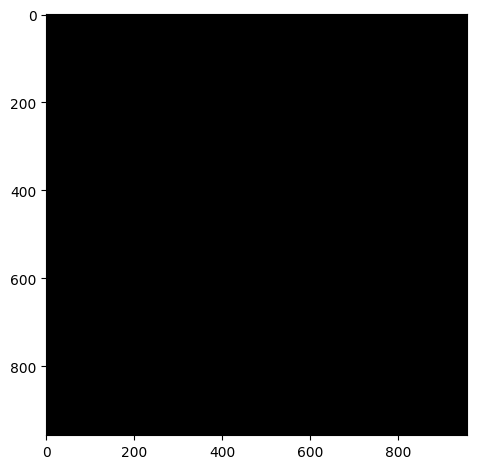

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_02.czi
Green Channel


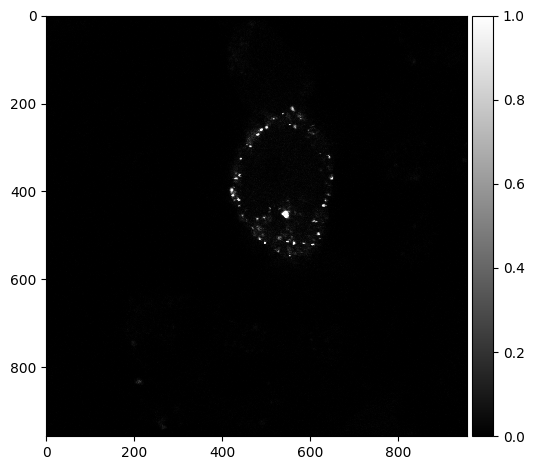

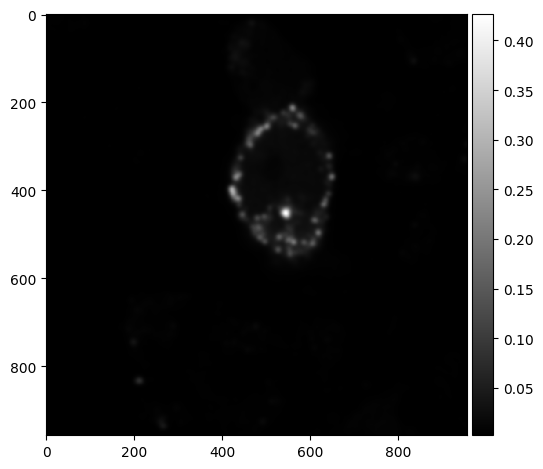

Segmented Cells


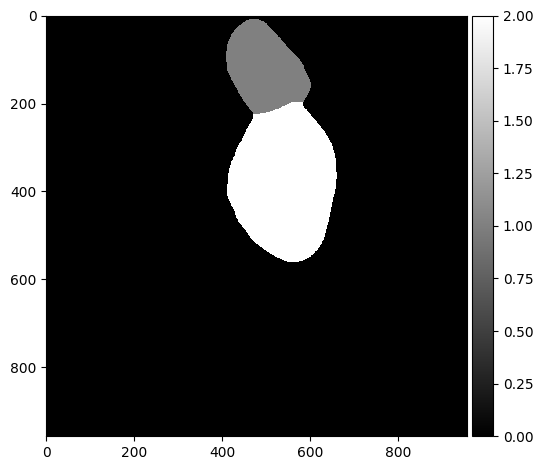

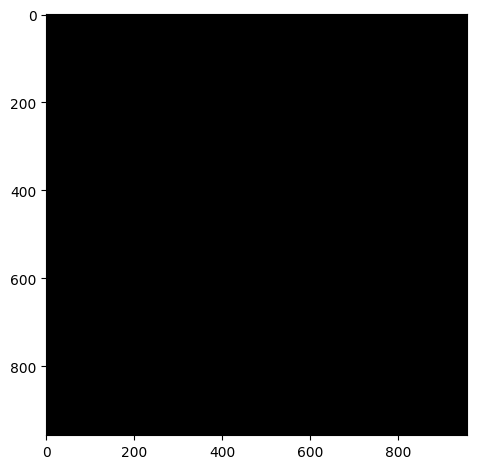

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


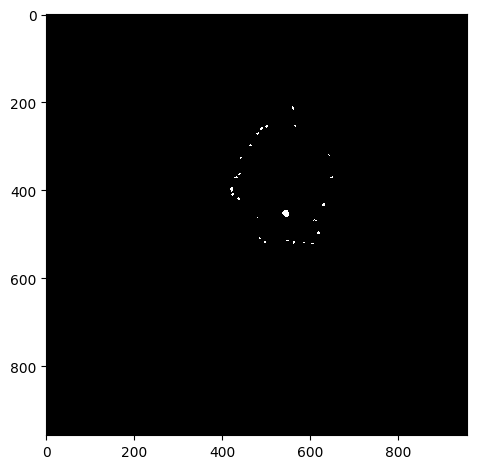

Cell 1: Number of inclusions: 26
Cell 1: Inclusion areas: [np.float64(37.0), np.float64(37.0), np.float64(12.0), np.float64(25.0), np.float64(30.0), np.float64(18.0), np.float64(12.0), np.float64(10.0), np.float64(20.0), np.float64(36.0), np.float64(26.0), np.float64(58.0), np.float64(33.0), np.float64(40.0), np.float64(27.0), np.float64(204.0), np.float64(10.0), np.float64(11.0), np.float64(12.0), np.float64(35.0), np.float64(11.0), np.float64(14.0), np.float64(18.0), np.float64(40.0), np.float64(13.0), np.float64(24.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_03.czi
Green Channel


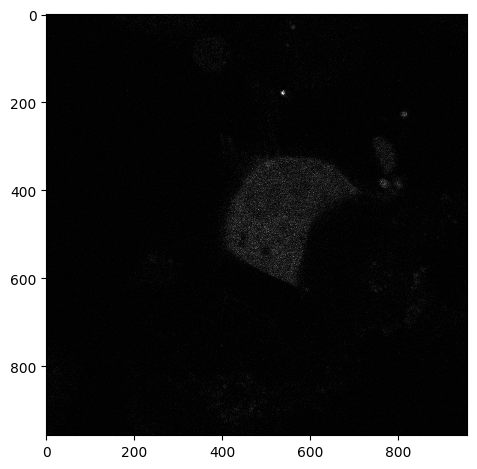

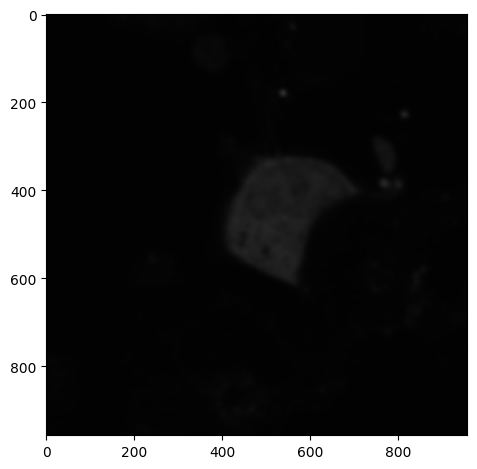

Segmented Cells


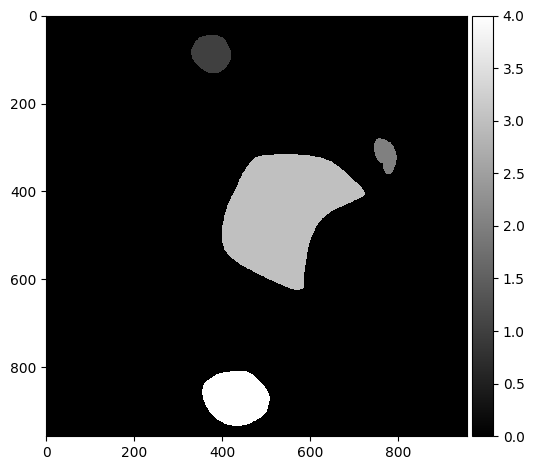

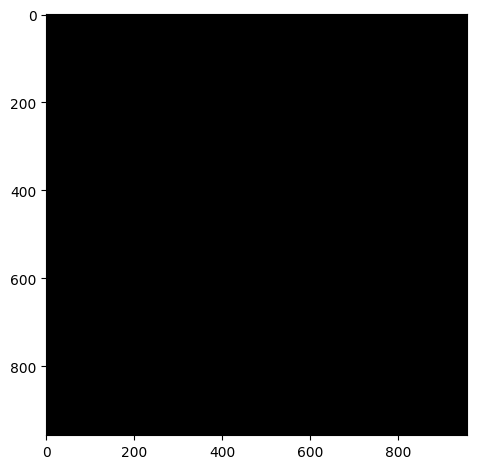

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


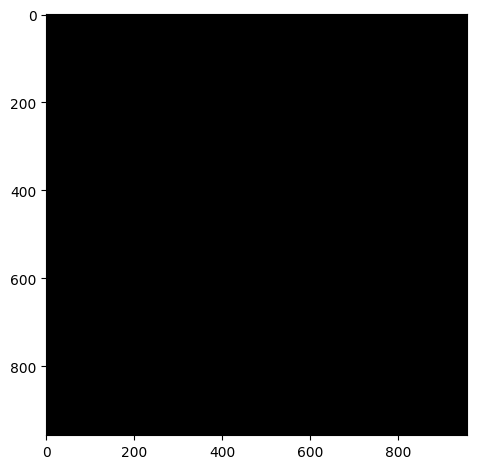

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


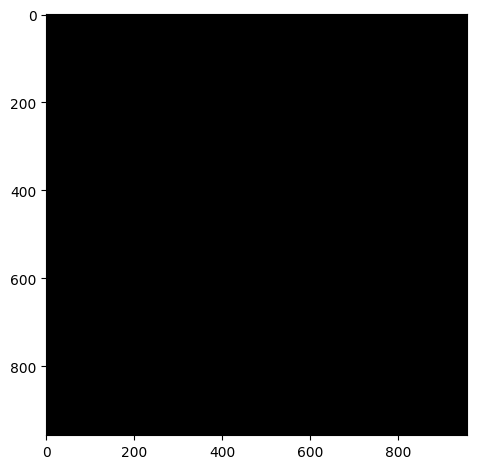

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


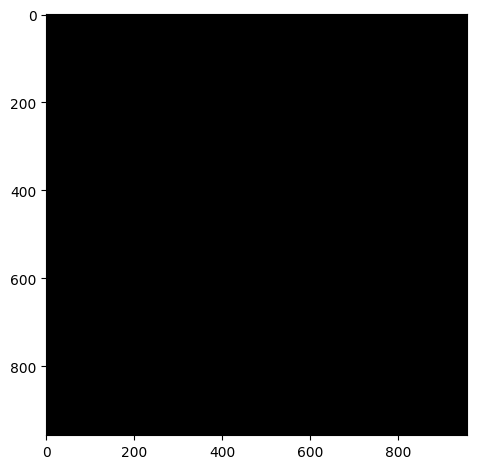

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_04.czi
Green Channel


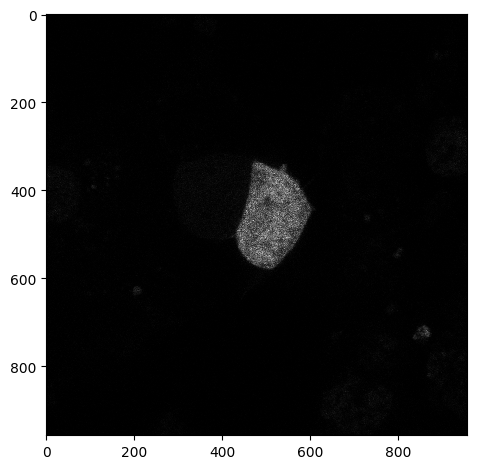

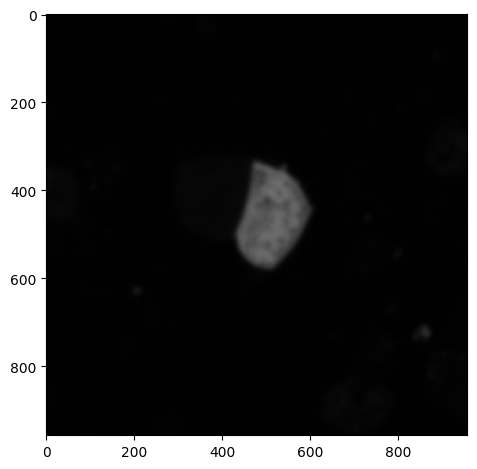

Segmented Cells


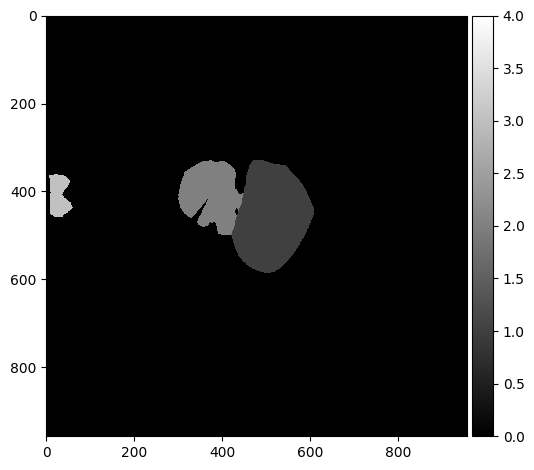

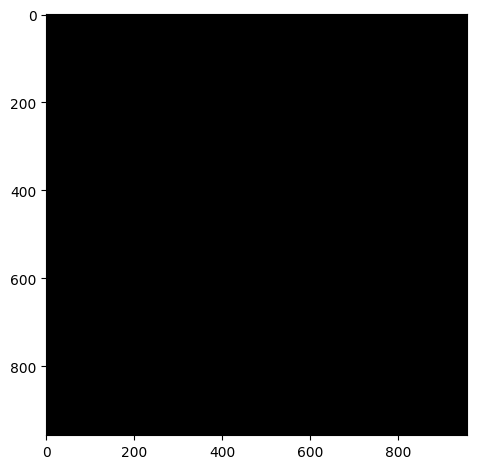

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


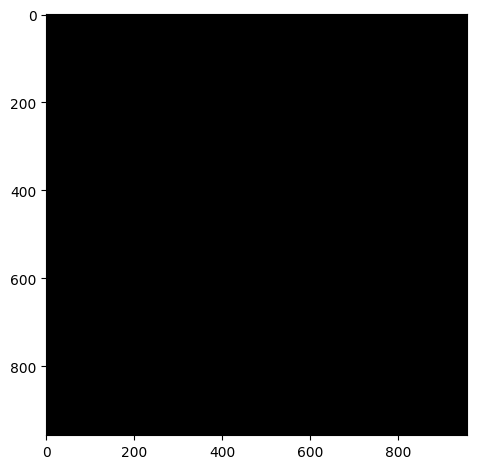

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


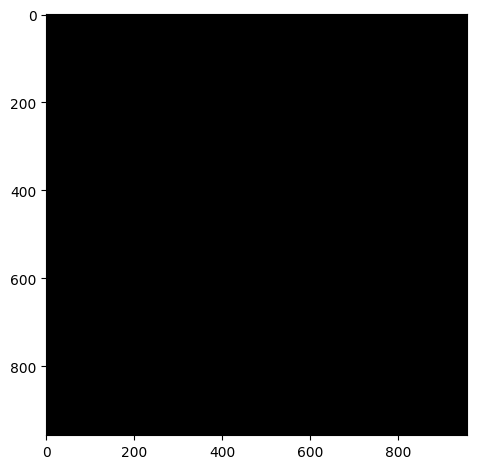

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_05.czi
Green Channel


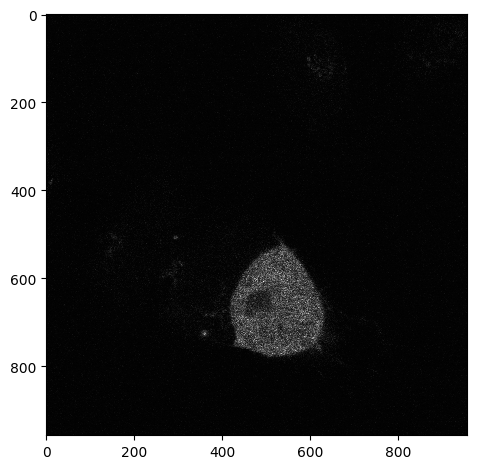

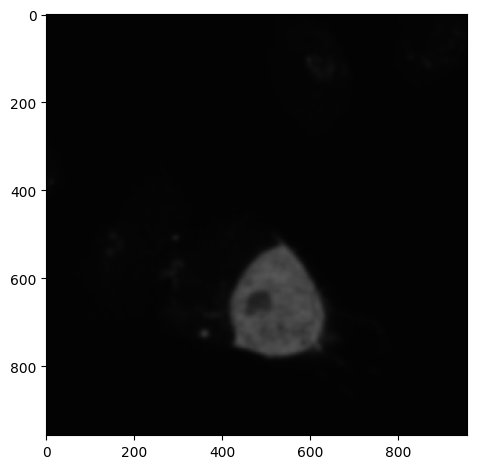

Segmented Cells


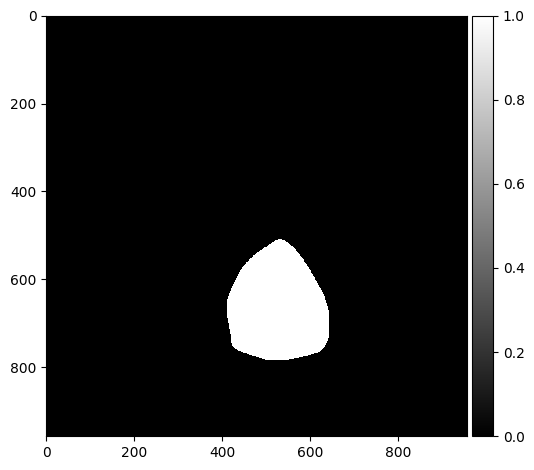

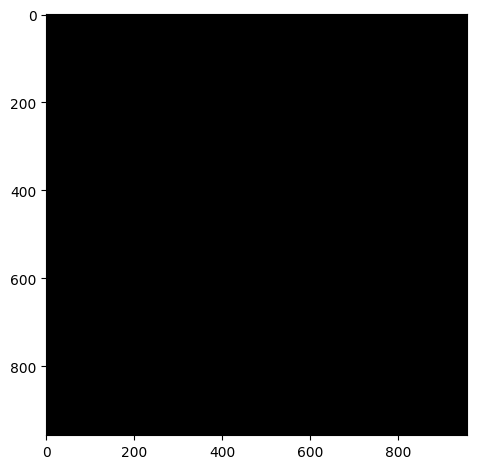

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_06.czi
Green Channel


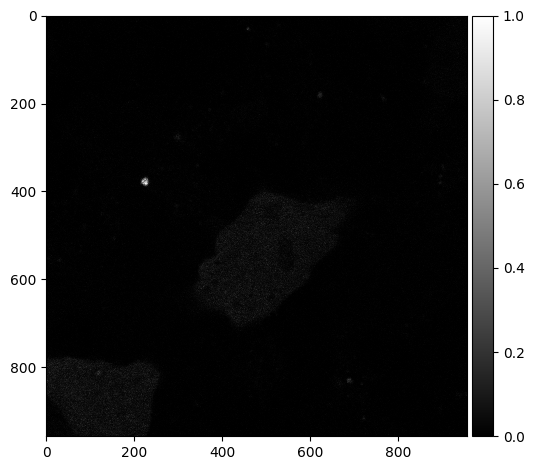

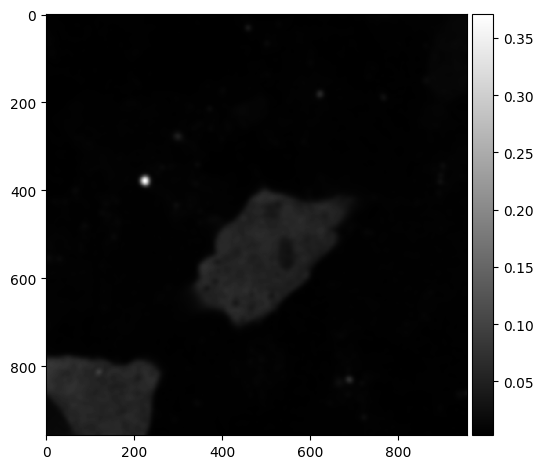

Segmented Cells


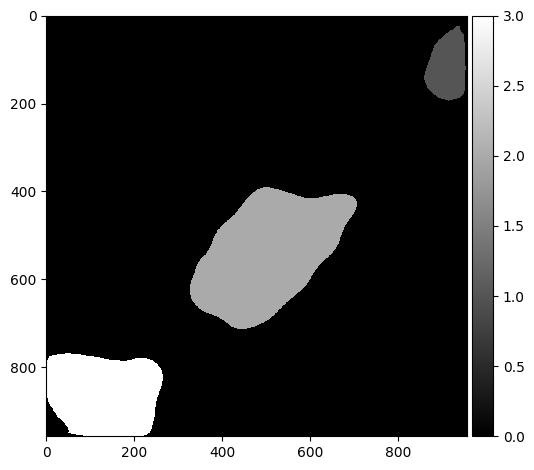

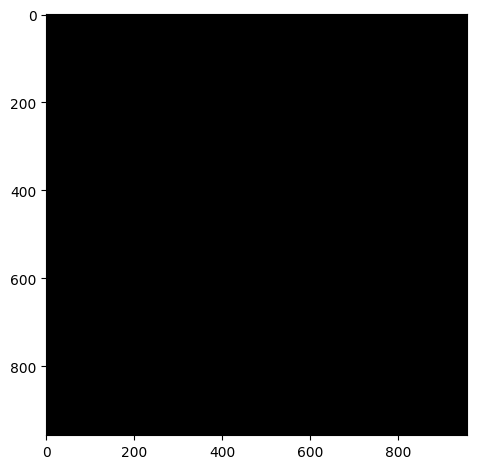

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


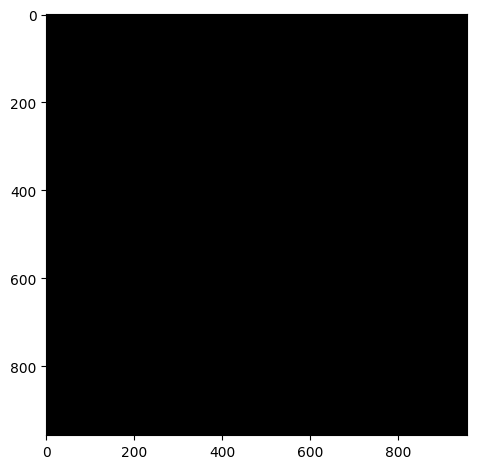

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


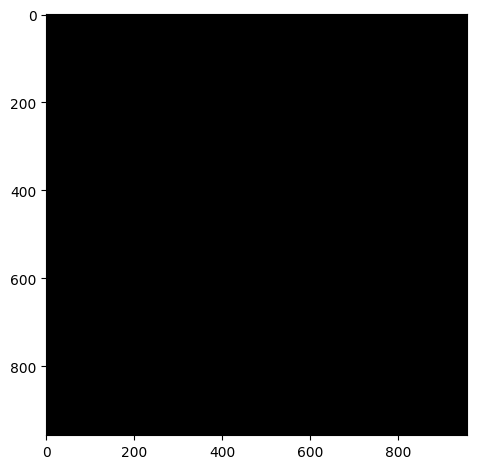

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_07.czi
Green Channel


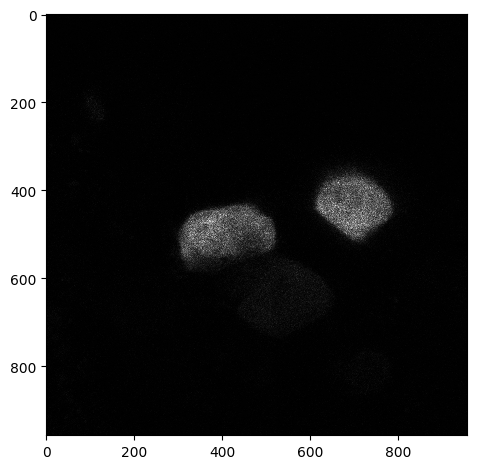

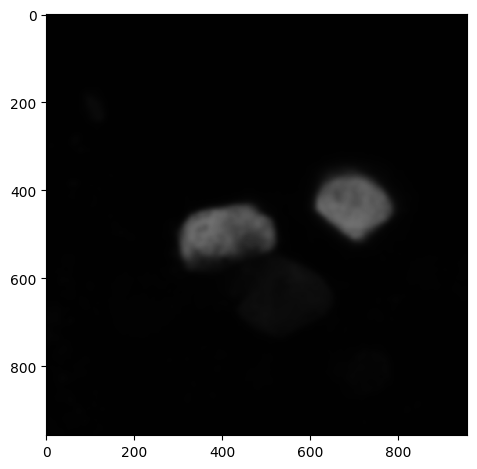

Segmented Cells


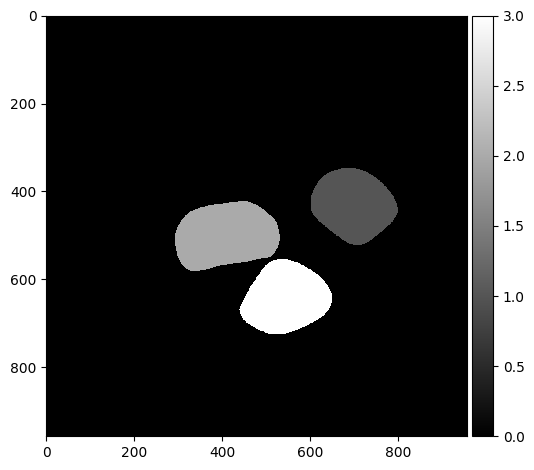

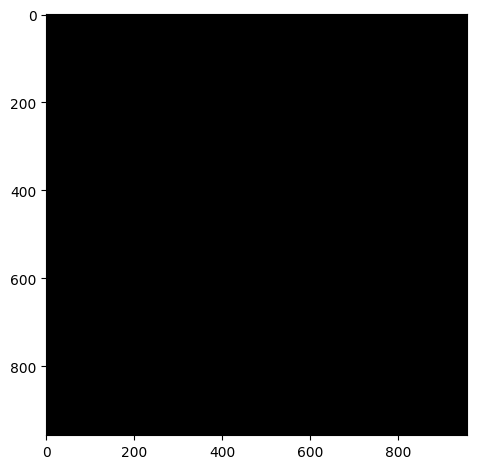

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


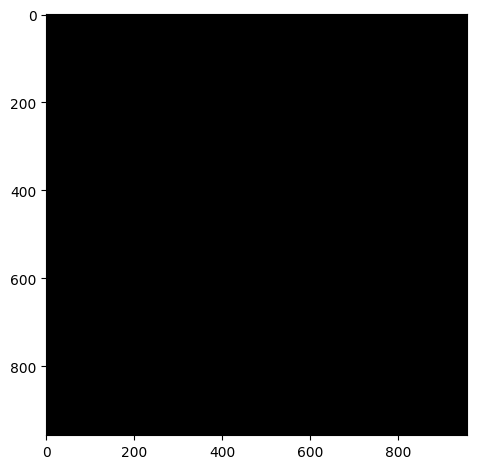

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


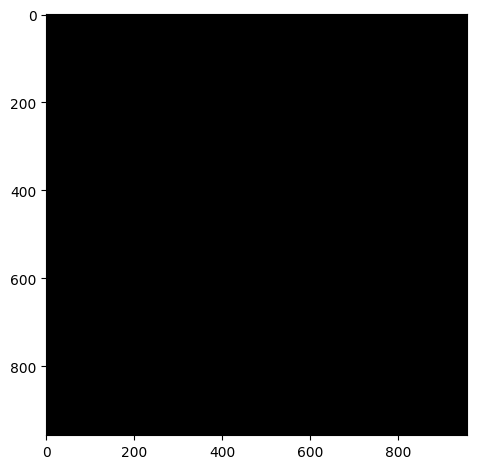

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_08.czi
Green Channel


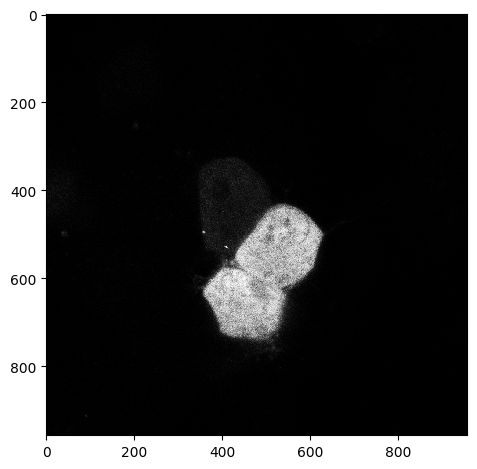

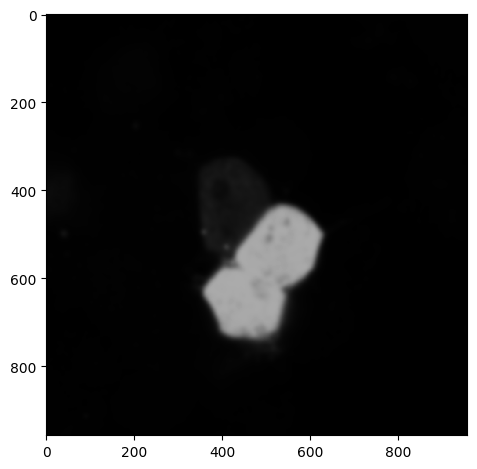

Segmented Cells


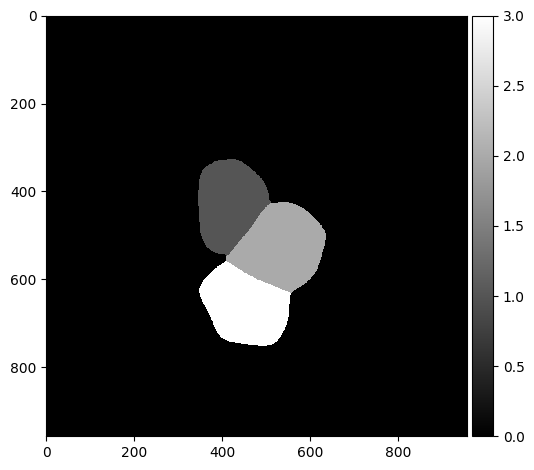

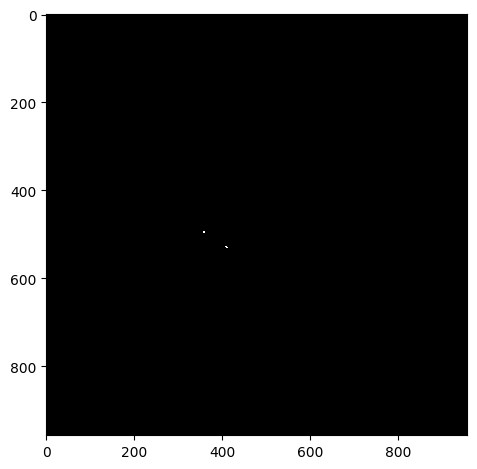

Cell 0: Number of inclusions: 2
Cell 0: Inclusion areas: [np.float64(18.0), np.float64(27.0)]


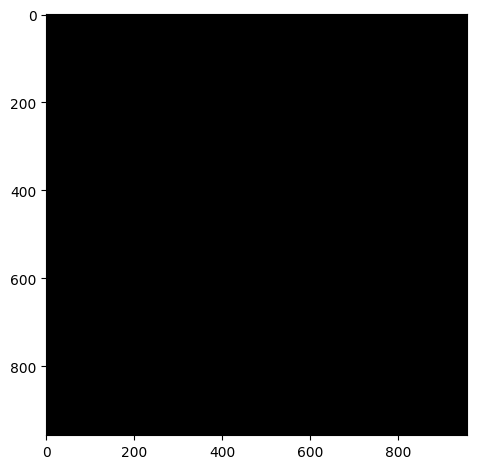

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


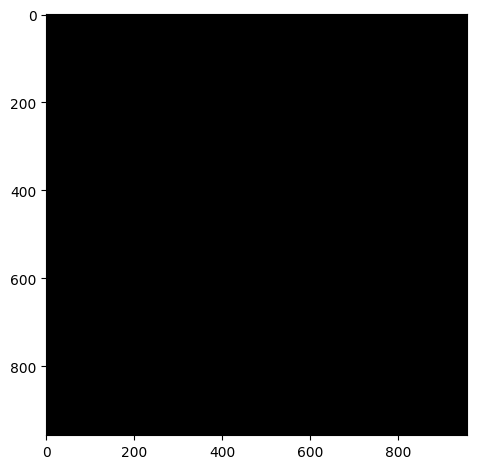

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_09.czi
Green Channel


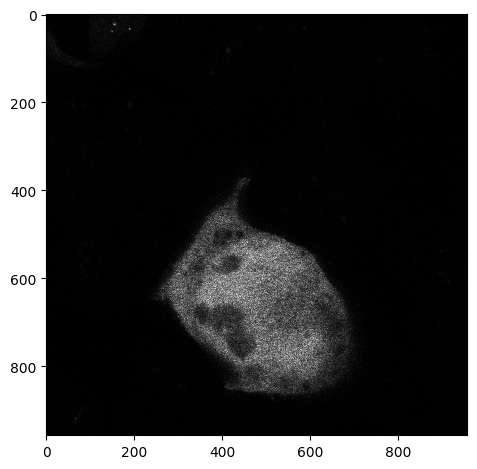

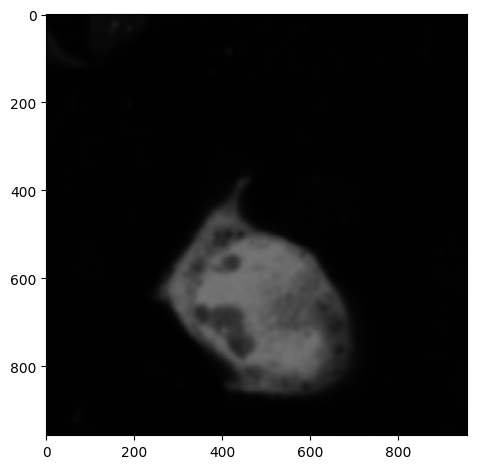

Segmented Cells


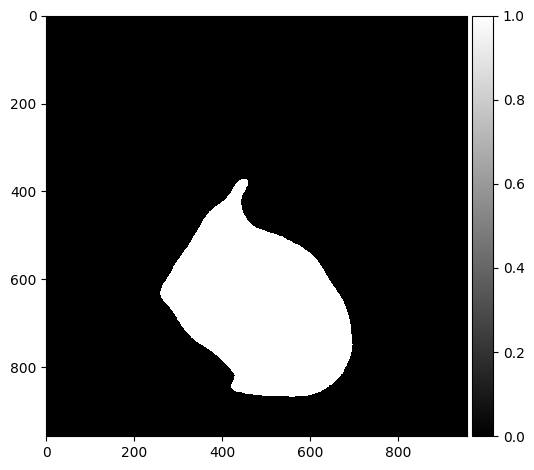

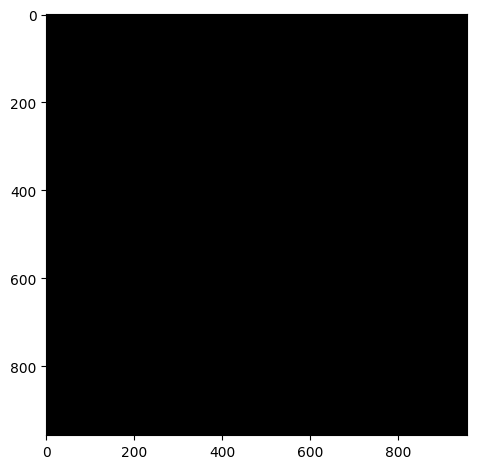

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_10.czi
Green Channel


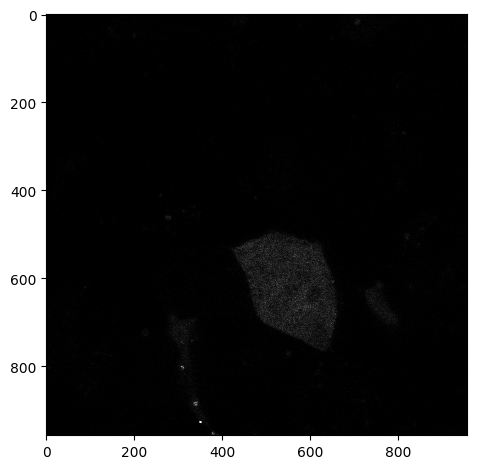

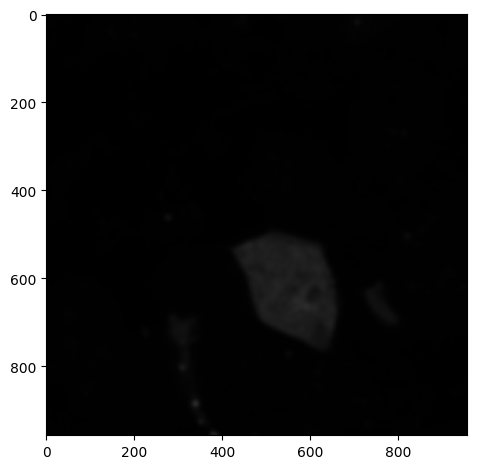

Segmented Cells


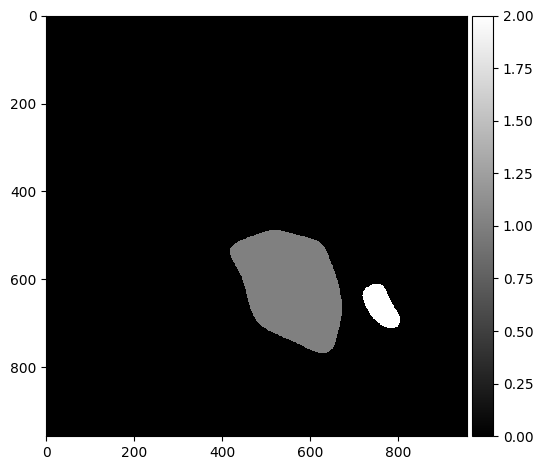

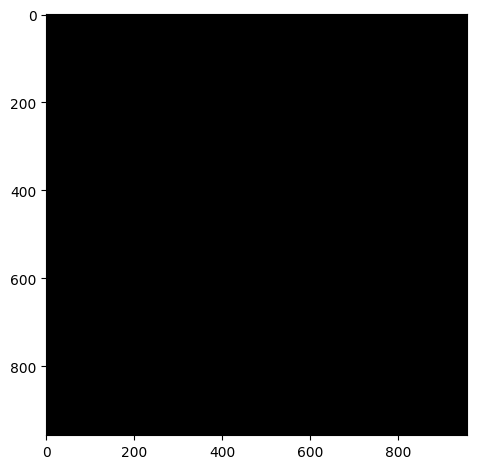

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


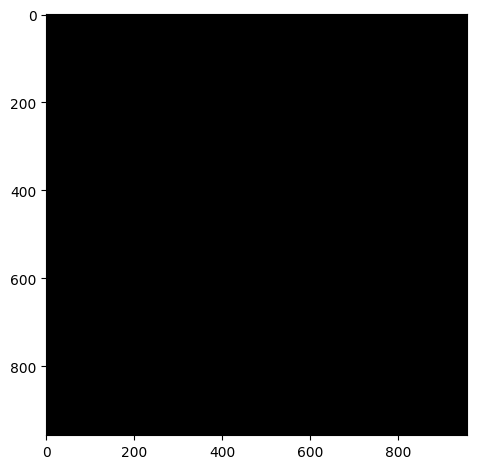

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


In [ ]:
analyze_all_images(folders[2])

1K_ADAMTS19_01.czi
Green Channel


c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:158: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


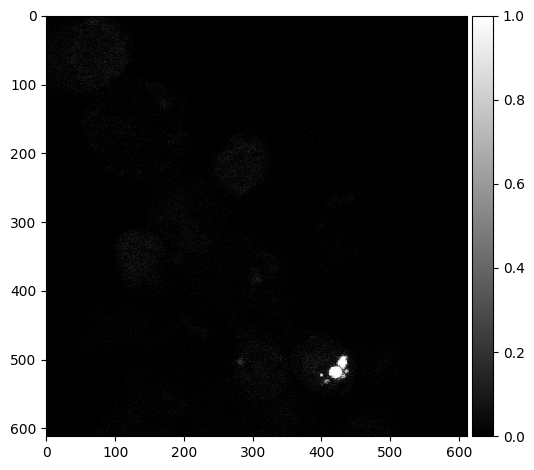

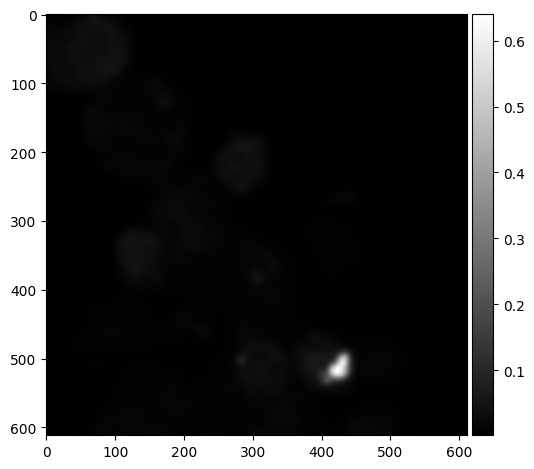

Segmented Cells


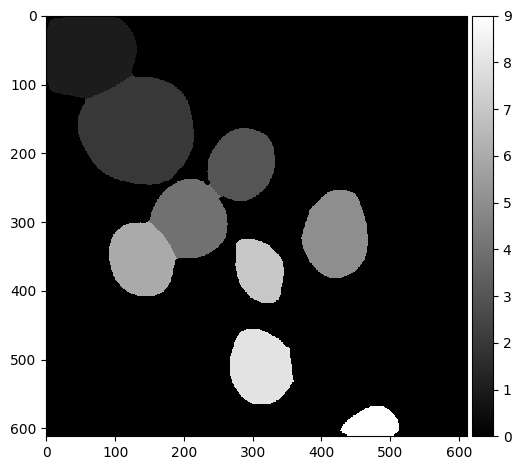

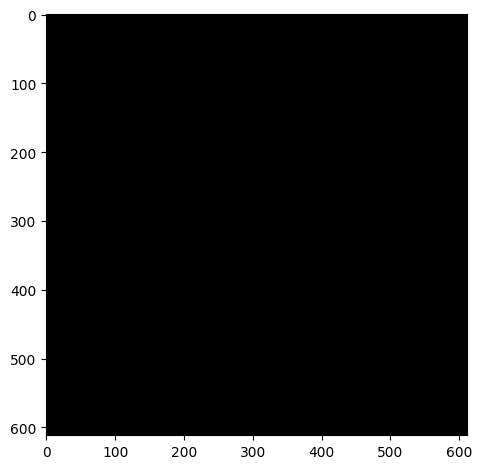

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\numpy\_core\fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\numpy\_core\_methods.py:138: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


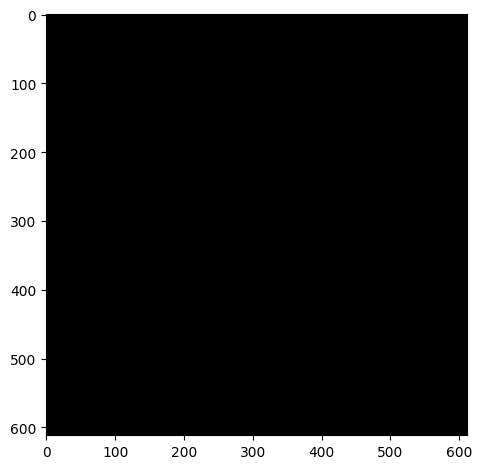

Cell 1: Number of inclusions: 0
Cell 1: Inclusion areas: []


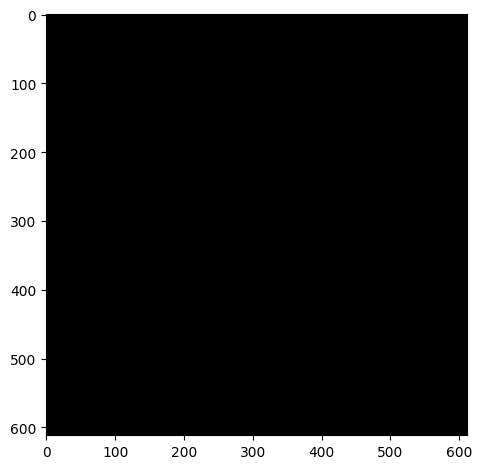

Cell 2: Number of inclusions: 0
Cell 2: Inclusion areas: []


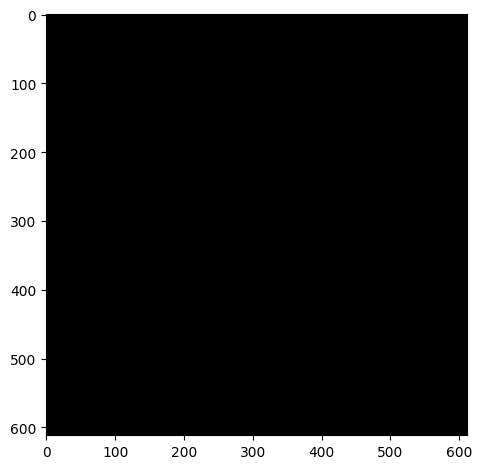

Cell 3: Number of inclusions: 0
Cell 3: Inclusion areas: []


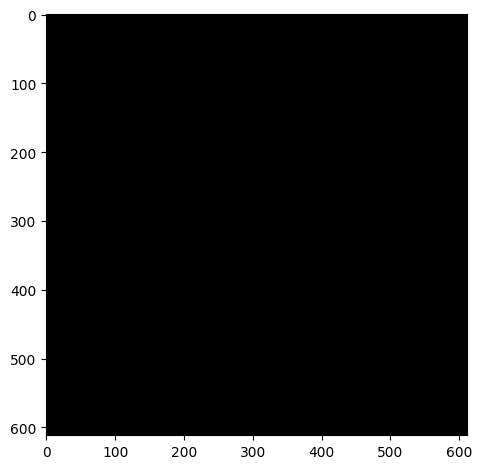

Cell 4: Number of inclusions: 0
Cell 4: Inclusion areas: []


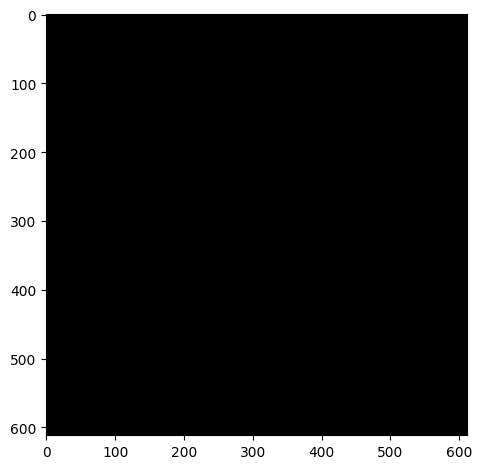

Cell 5: Number of inclusions: 0
Cell 5: Inclusion areas: []


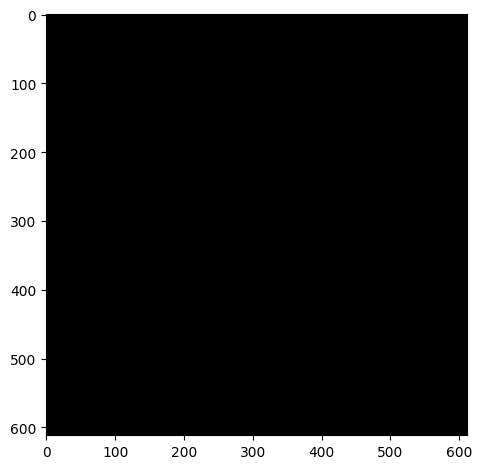

Cell 6: Number of inclusions: 0
Cell 6: Inclusion areas: []


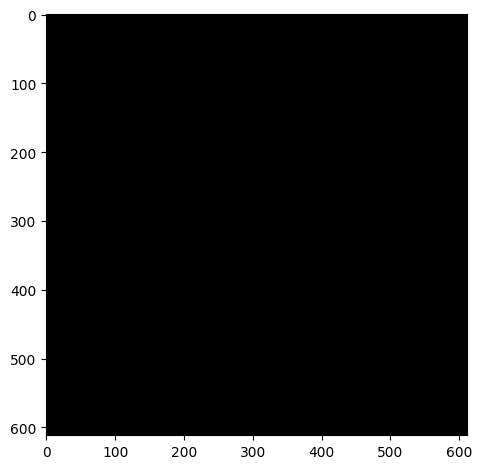

Cell 7: Number of inclusions: 0
Cell 7: Inclusion areas: []


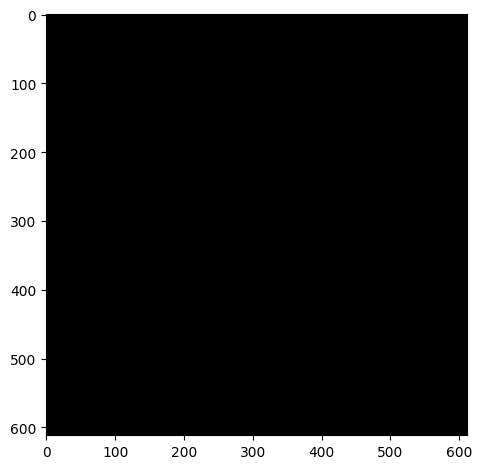

Cell 8: Number of inclusions: 0
Cell 8: Inclusion areas: []
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_02.czi
Green Channel


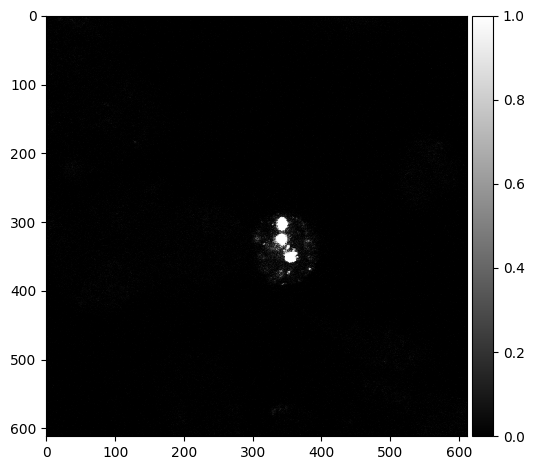

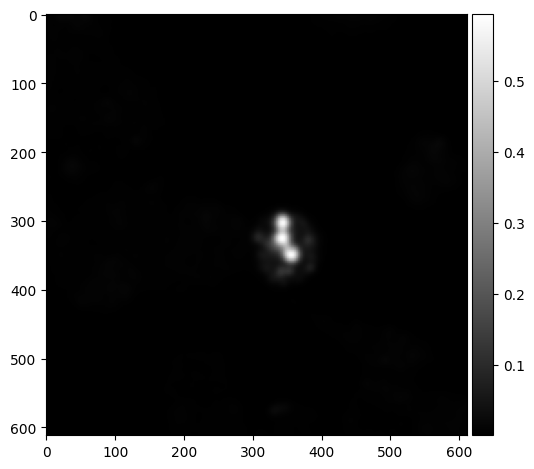

Segmented Cells


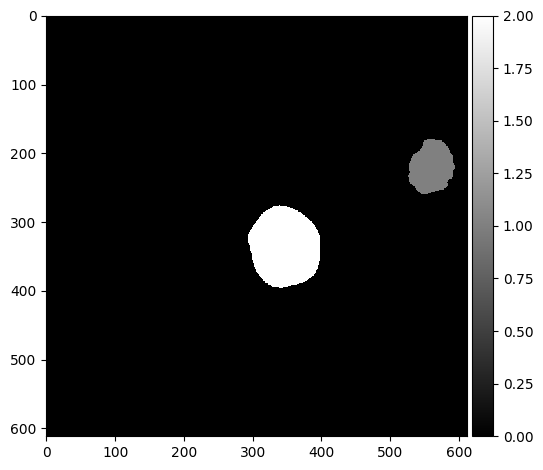

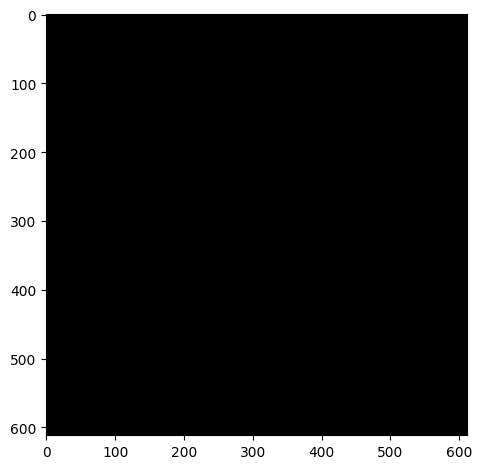

Cell 0: Number of inclusions: 0
Cell 0: Inclusion areas: []


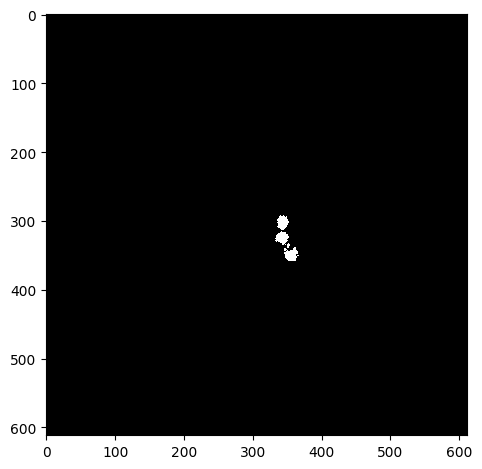

Cell 1: Number of inclusions: 4
Cell 1: Inclusion areas: [np.float64(264.0), np.float64(263.0), np.float64(26.0), np.float64(290.0)]
--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_ADAMTS19_03.czi
Green Channel


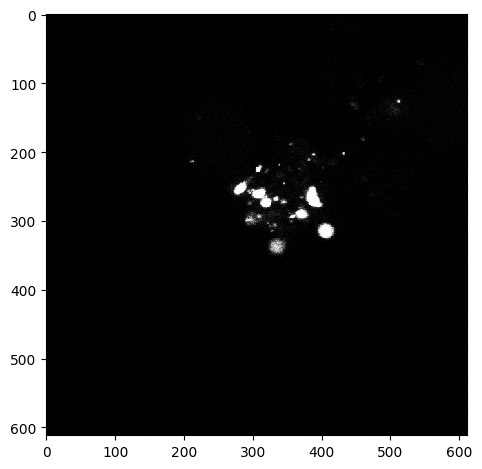

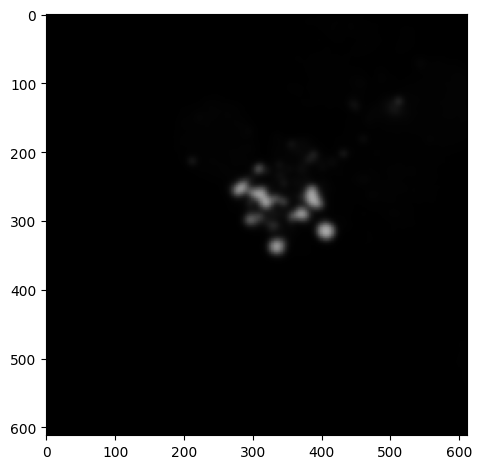

Segmented Cells


AttributeError: 'NoneType' object has no attribute 'dtype'

In [ ]:
analyze_all_images(folders[3])

1K_PFF_ADAMTS19_01.czi
Green Channel


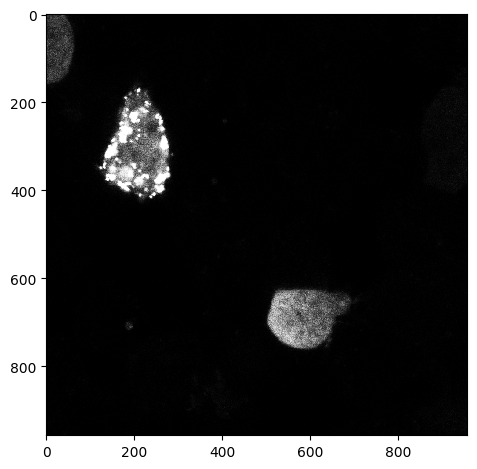

Segmented Cells


c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:158: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


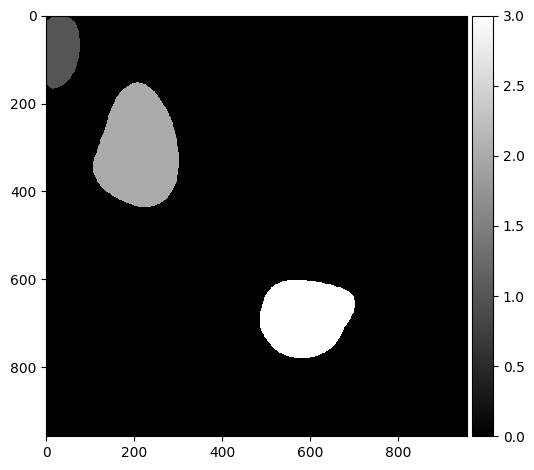

c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\numpy\_core\fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\numpy\_core\_methods.py:138: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Threshold:  0.99
Bin count 37


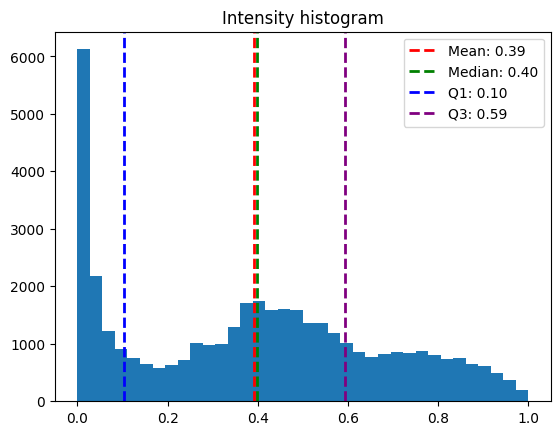

Inclusion Areas:  [ 37.  16. 274.  17.  12.  29.  30. 554.  35.  17. 278.  28. 460.  12.
  20.  43.  12.  35.  28.  13.  88. 357. 173.  94.  60.  24. 250. 131.
  30.  15.]


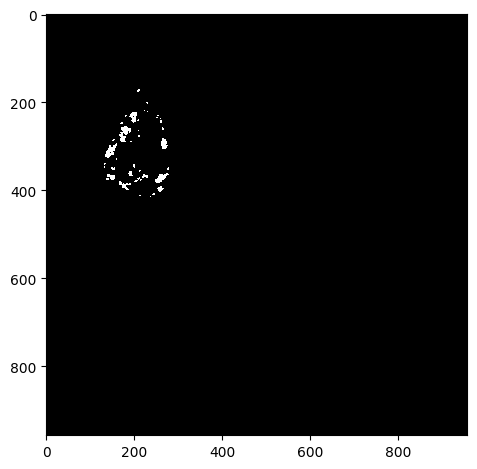

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_02.czi
Green Channel


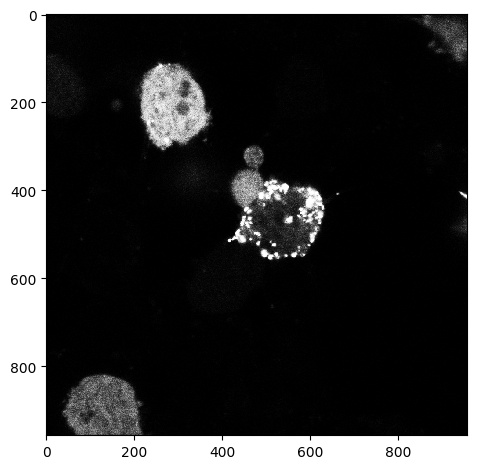

Segmented Cells


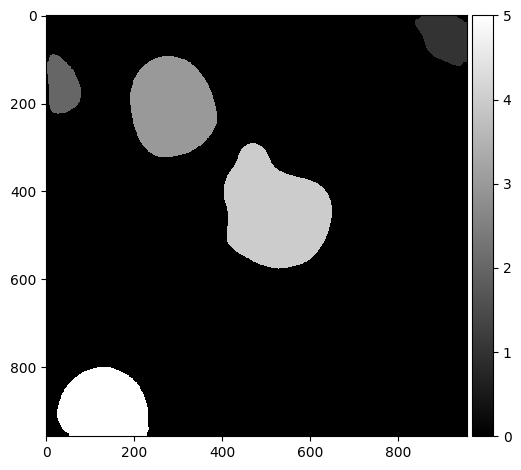

Threshold:  0.99
Bin count 24


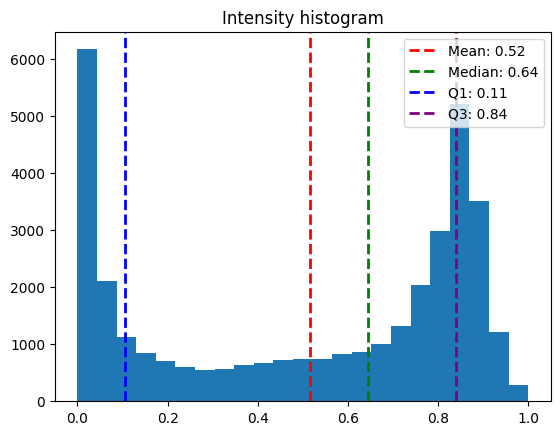

Inclusion Areas:  [21. 20. 57.]


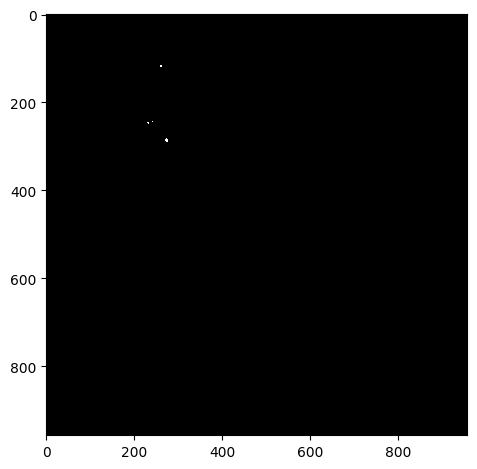

Threshold:  0.99
Bin count 50


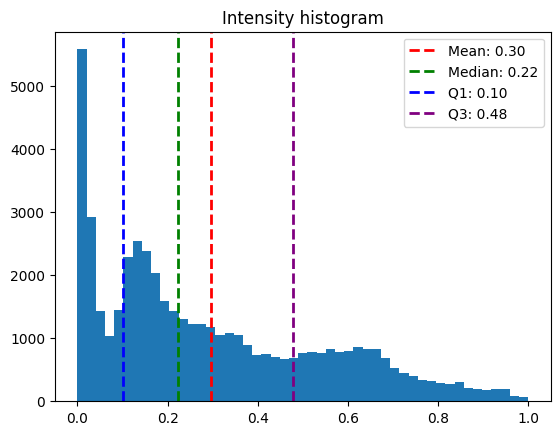

Inclusion Areas:  [ 15. 185. 232.  51.  29.  92.  55. 209.  59.  14.  52.  29.  23.  38.
  68.  32.  14.  15.  17.  22.  13.  16.  33.  11.  18.  42.  37.  82.
  36.  30.  37.  50.  11.  38.  21.  11.  28.  82.  27.  65.  11.  70.]


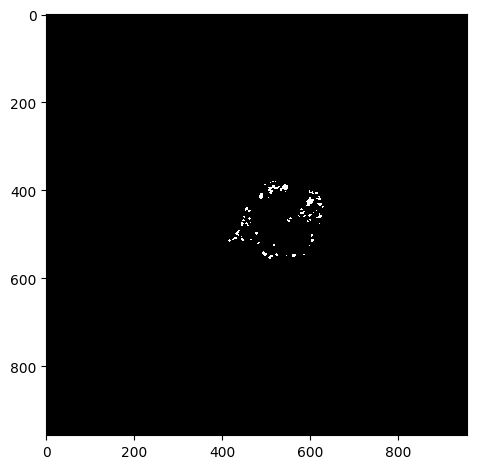

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_03.czi
Green Channel


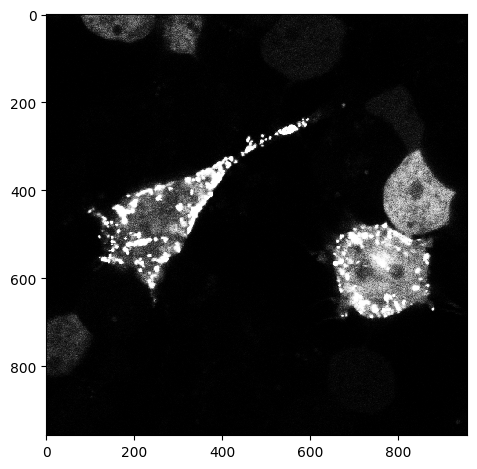

Segmented Cells


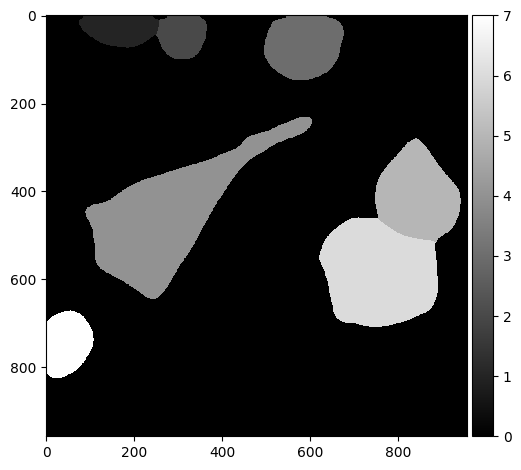

Threshold:  0.99
Bin count 47


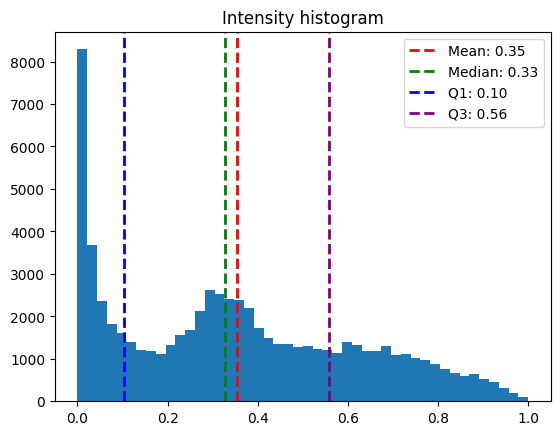

Inclusion Areas:  [ 13.  23.  13.  13. 516.  16.  25.  43.  28. 171.  66.  38. 952.  13.
 113. 135.  51.  21.  80.  72.  26. 101.  25. 132.  43. 954.  33.  23.
  88. 183. 149. 622.  25.  26.  50.  12.  14.  24. 105.  13.  83.  20.
 496.  42.  33.  20.  91.  24. 106.  29. 275.  39.  29. 115.  13.  63.
  96. 103.  25.  15.  17.  31.  34.]


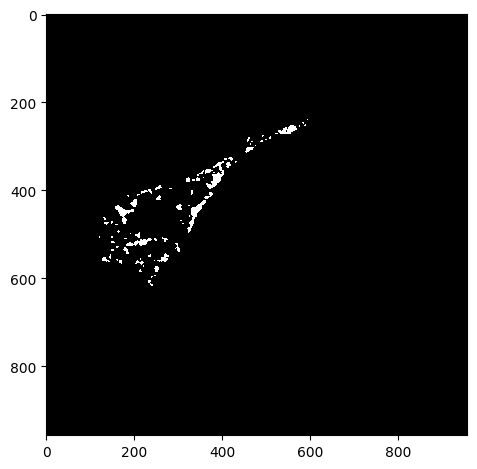

Threshold:  0.99
Bin count 42


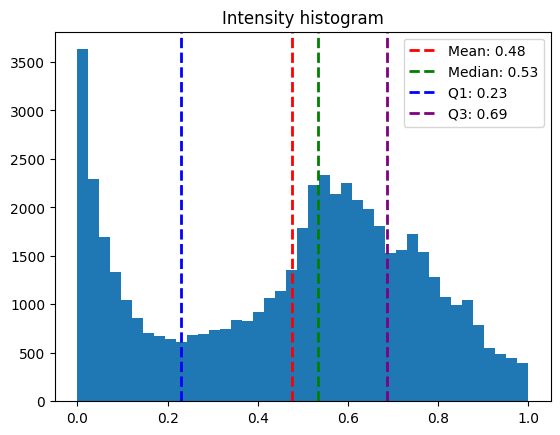

Inclusion Areas:  [ 66.  21.  81.  13.  53. 320. 112.  22.  45.  38. 124.  32.  18.  29.
  17.  35.  62. 185. 164.  21.  55.  32.  85.  24.  14.  15. 104.  15.
  25. 188. 134.  23. 257.  52. 118. 116.  88.  29.  24.  15.]


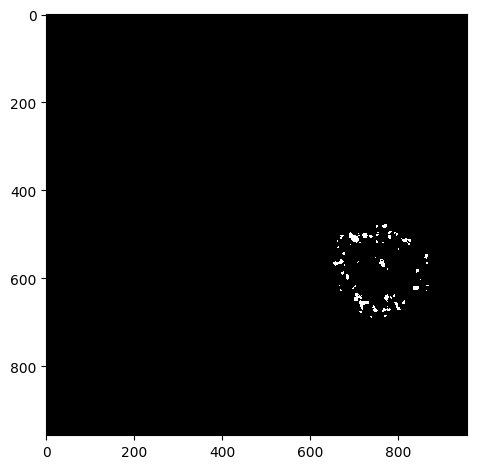

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_04.czi
Green Channel


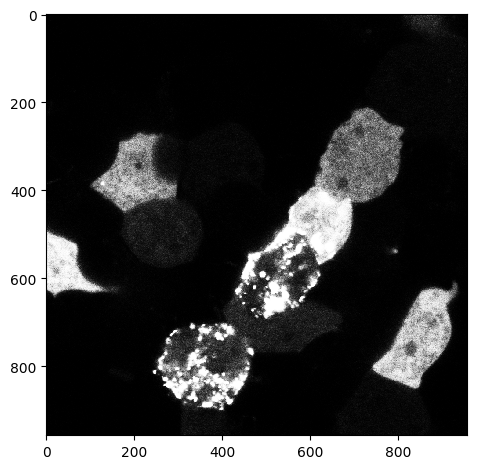

Segmented Cells


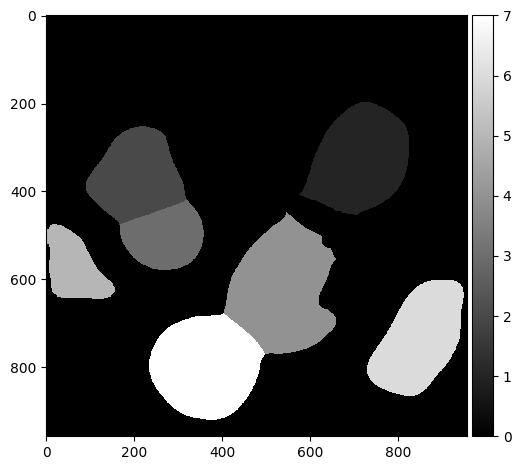

Threshold:  0.99
Bin count 84


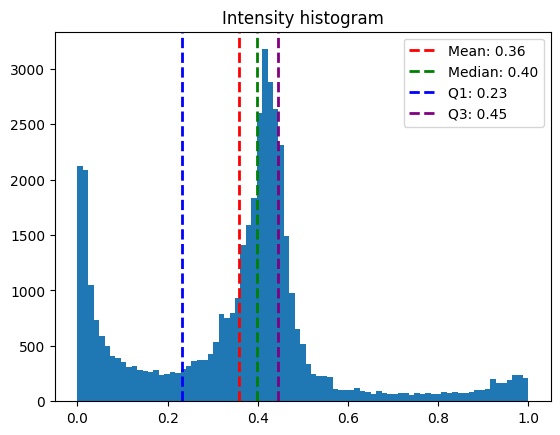

Inclusion Areas:  [330.  15.  15.]


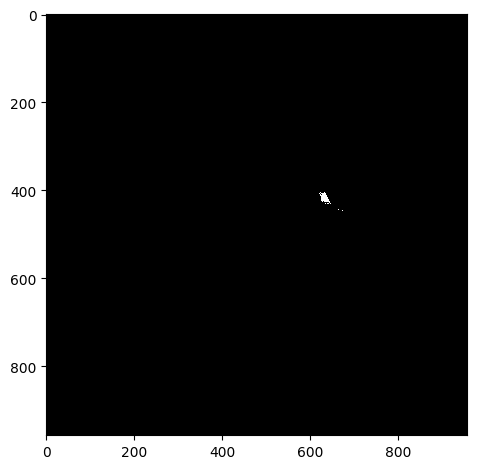

Threshold:  0.99
Bin count 28


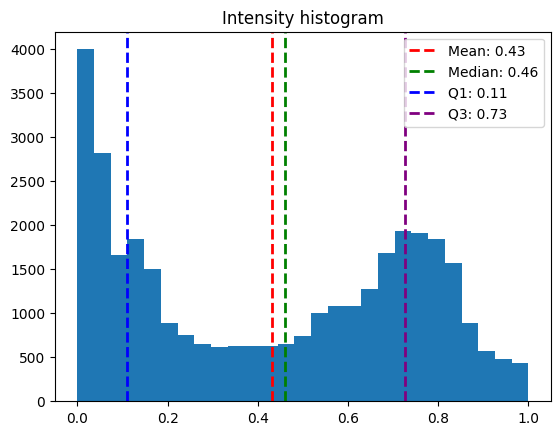

Inclusion Areas:  [19.]


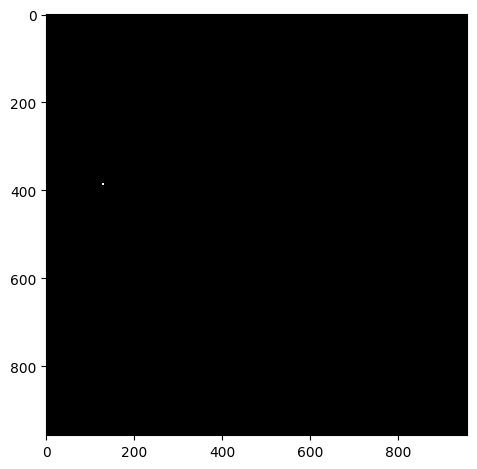

Threshold:  0.99
Bin count 41


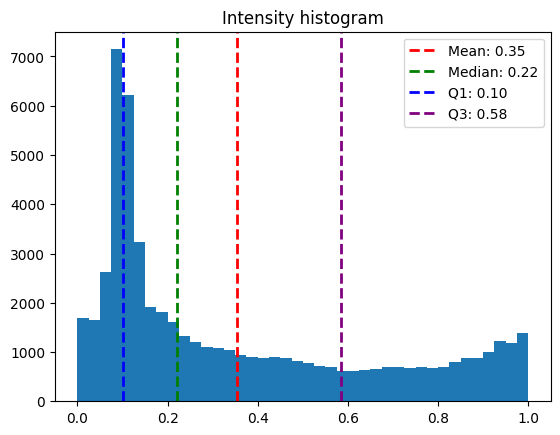

Inclusion Areas:  [  38.   29.  996.  140.  884.   21.   15.  183.   51.   21.  185.   66.
  916.   51.   28.   42.  120.   22.   11.   19.  115.  392.   32. 1485.
   81.   14.   17.   24.   25.   13.]


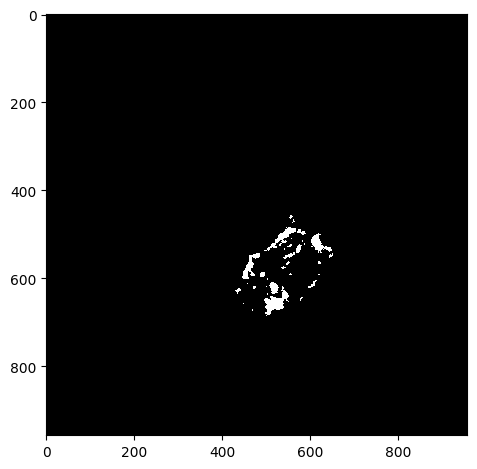

Threshold:  0.99
Bin count 42


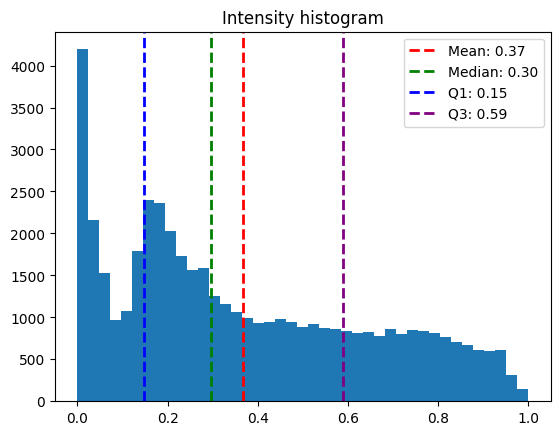

Inclusion Areas:  [ 49.  23. 108.  15.  87.  50. 164.  15.  42.  81.  27.  19. 291.  42.
  25.  18.  20.  45.  30.  30.  27. 180.  28.  45.  26. 234. 109. 109.
  68.  37.  25.  42.  50.  37. 196. 302.  52. 431.  51.  33.  17.  18.
  15. 172.  20. 218. 148. 204.]


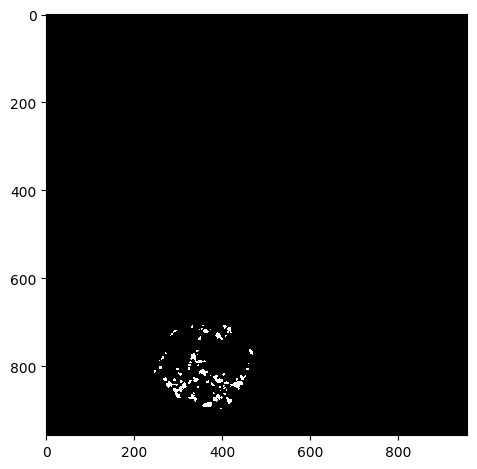

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_05.czi
Green Channel


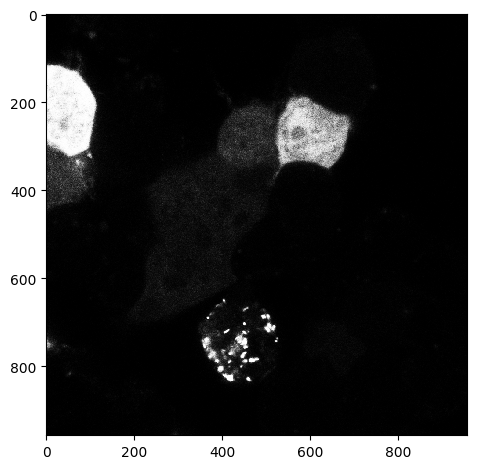

Segmented Cells


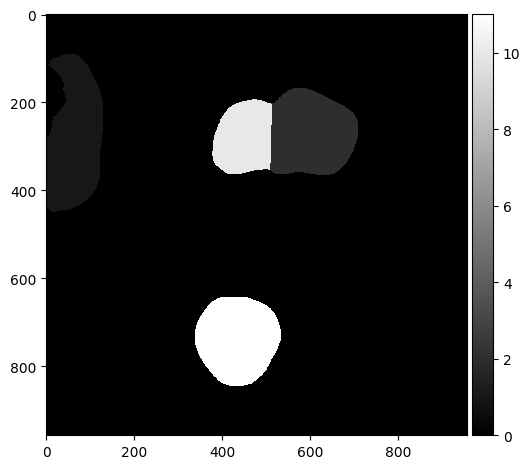

Threshold:  0.5
Bin count 73


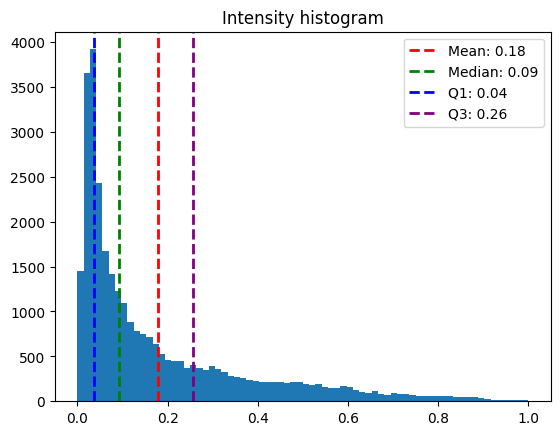

Inclusion Areas:  [ 28.  34. 152.  25.  31. 339.  70.  64. 526. 760.  23.  27. 129.  42.
 124. 194.  68.  45. 159.  24. 276.  63.]


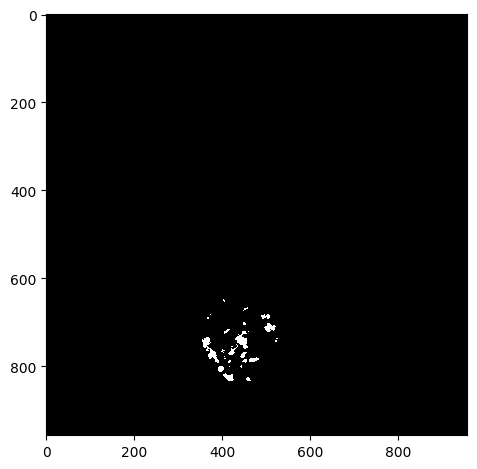

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_06.czi
Green Channel


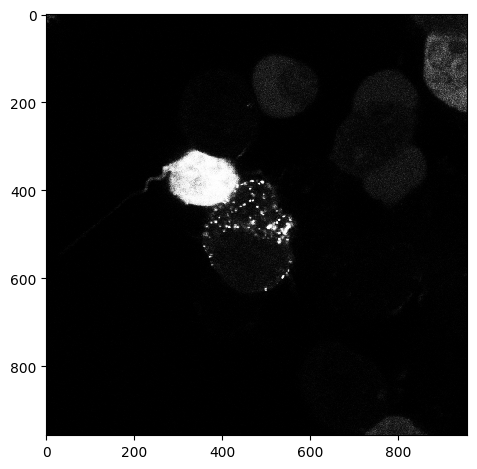

Segmented Cells


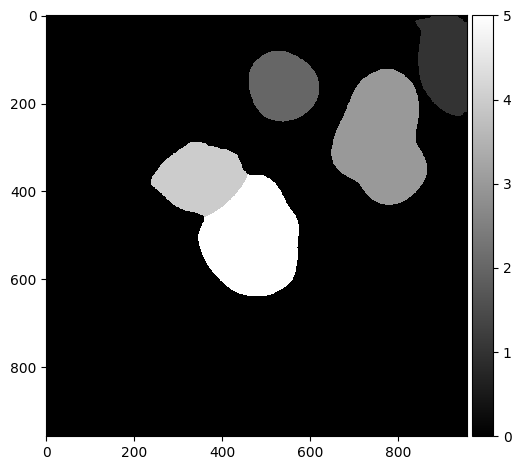

Threshold:  0.5
Bin count 145


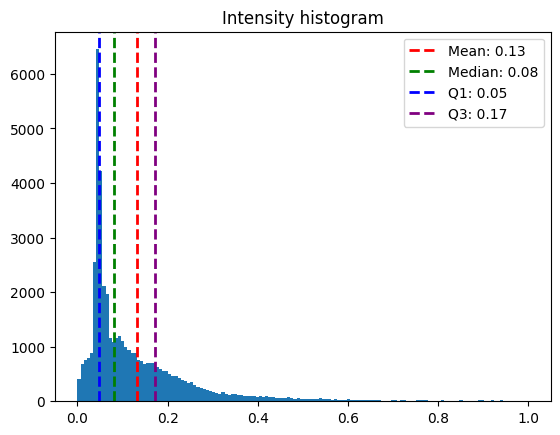

Inclusion Areas:  [ 41.  47.  38.  16.  20.  11.  27.  37.  14.  22.  16.  21.  46.  22.
  11.  25.  23.  90.  33. 275.  13. 347.  78.  54.  18.  21.  12.  29.
  17.  25.  87.  26.  16.  19.  12.  38.  26.]


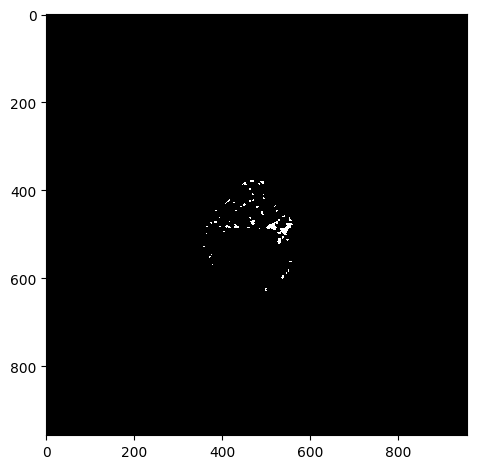

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_07.czi
Green Channel


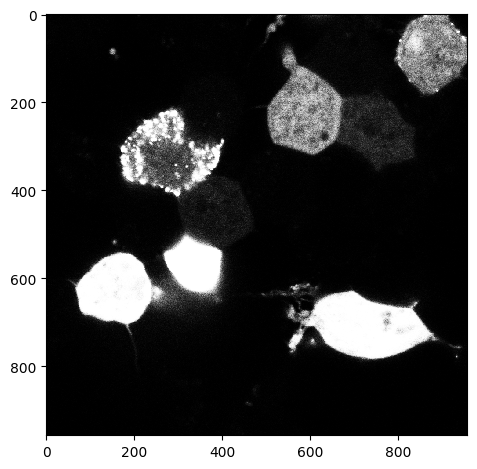

Segmented Cells


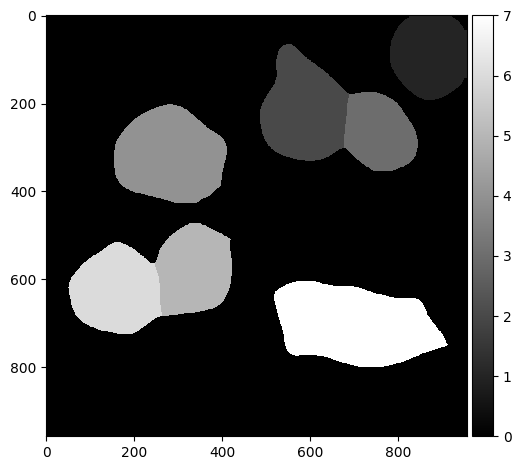

Threshold:  0.99
Bin count 57


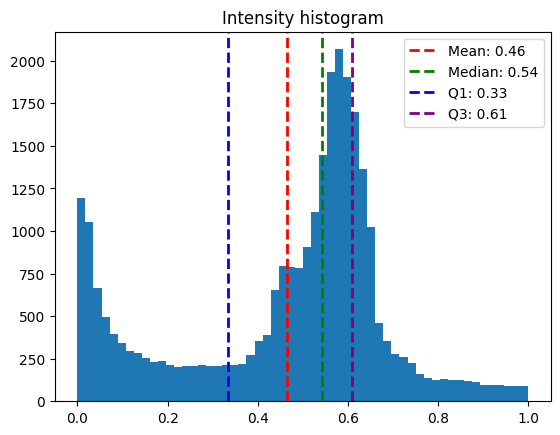

Inclusion Areas:  [23. 23.]


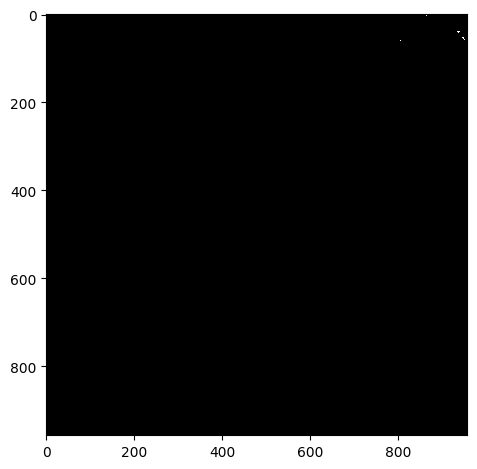

Threshold:  0.99
Bin count 35


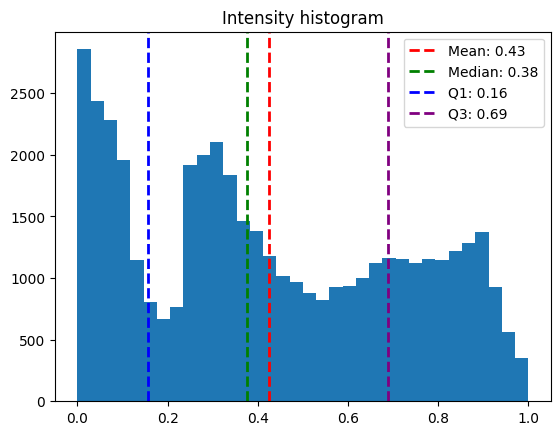

Inclusion Areas:  [140.  52. 111.  15.  62.  38.  26. 391. 116.  18.  57.  15.  15.  32.
  20.  84.  28.  20.  12.  21.  64.  17.  38.  55. 102.  28. 481.  25.
  16.  20.  88. 210.  32.  23. 154.  53.  11.  15. 132. 150. 177.  90.
  21.  99.  13.  78.  16.  47.  15.  83.]


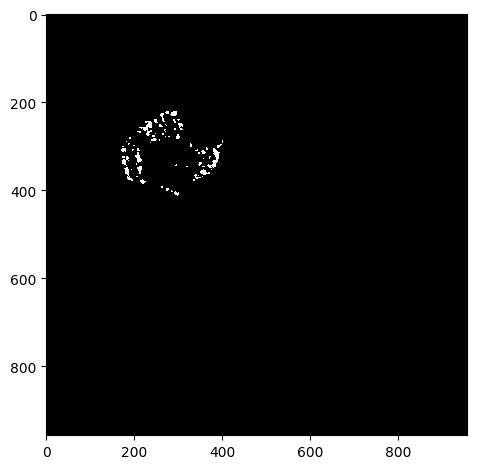

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_08.czi
Green Channel


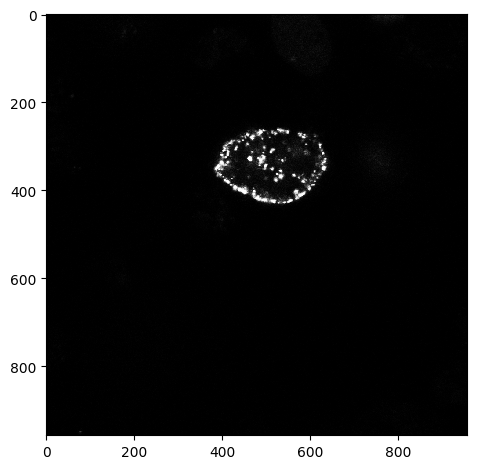

Segmented Cells


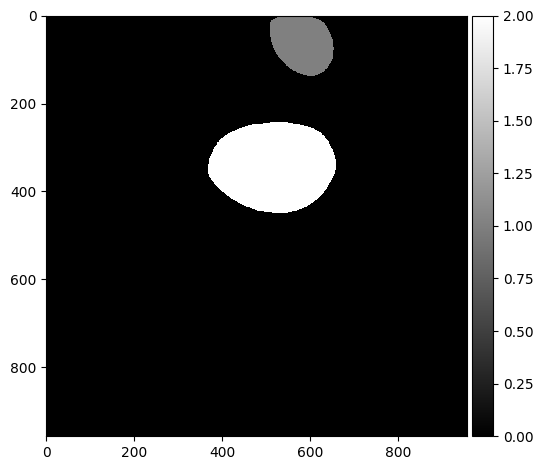

Threshold:  0.5
Bin count 75


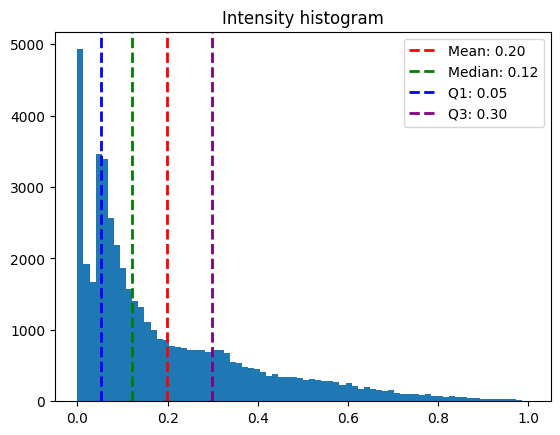

Inclusion Areas:  [146. 154.  23.  40.  46. 124.  97.  12.  15. 366.  16.  25.  26.  51.
  33.  15.  71.  17.  28. 262. 105. 207.  26. 390.  77.  36.  36.  21.
  61. 136.  14.  42.  12.  12.  17.  11.  66.  11.  22. 107.  41.  15.
 407.  29.  56. 316. 381.  70. 105.  21.  29.]


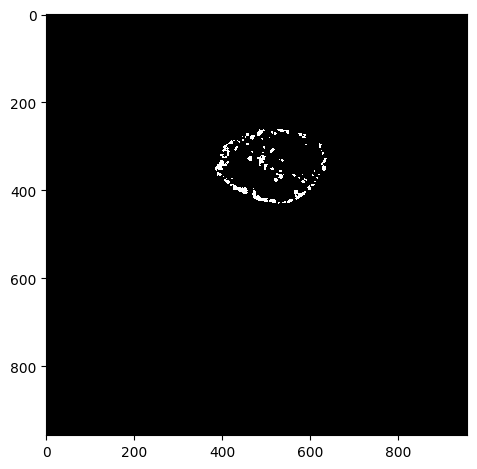

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_09.czi
Green Channel


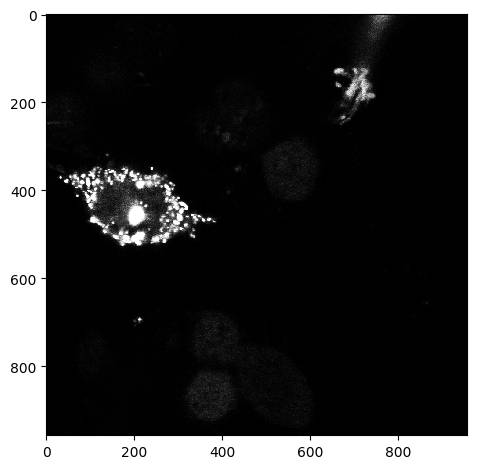

Segmented Cells


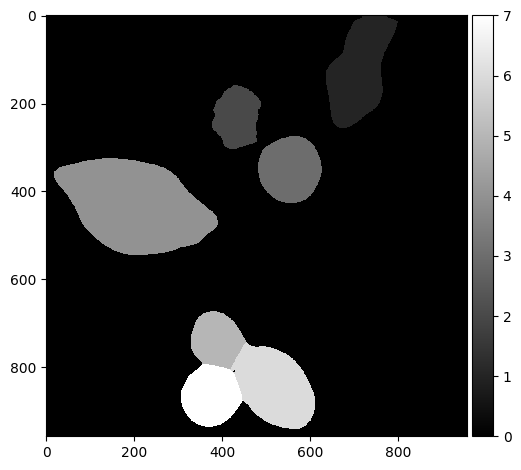

Threshold:  0.5
Bin count 79


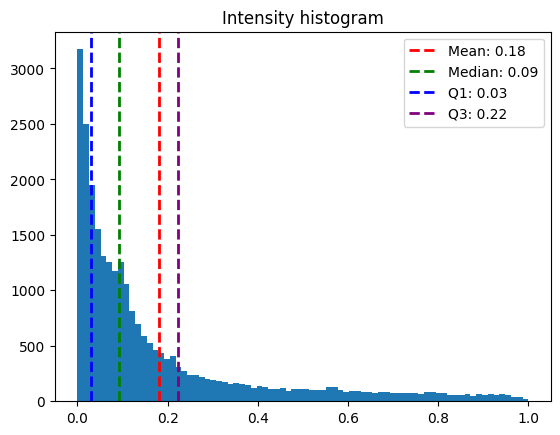

Inclusion Areas:  [  46.  188.   75. 1570.   53.   31.]


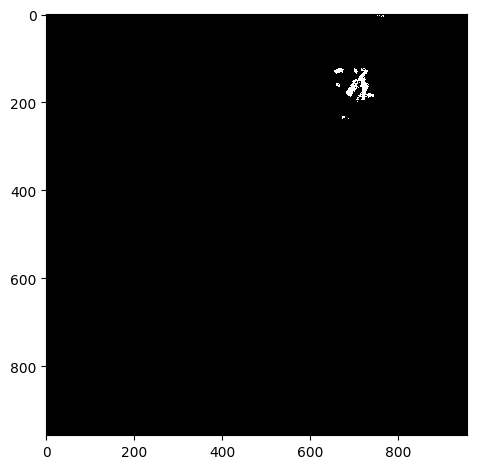

Threshold:  0.99
Bin count 51


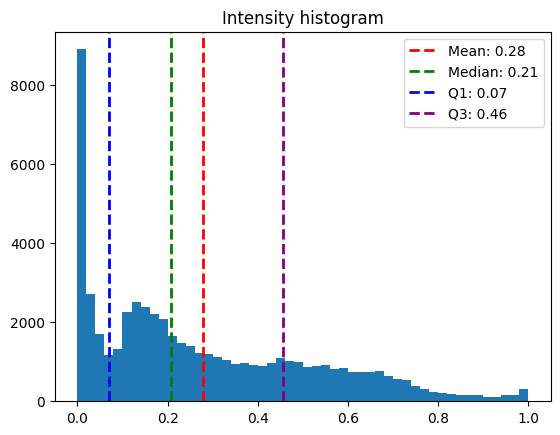

Inclusion Areas:  [ 15.  26.  33.  21.  41.  13.  32.  11.  59.  12.  22.  12.  13. 116.
  25.  33.  52.  23.  34. 173.  11.  13.  73.  13.  16.  50. 132.  39.
  21.  14. 138.  36.  44. 916.  14.  56. 124.  14.  22.  86.  24.  17.
  18.  60.  24.  17.  20.  26.  12.  33. 442.  42.  27. 153.  46.  29.]


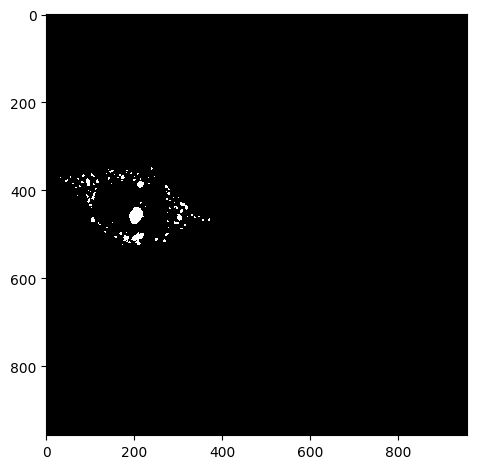

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_10.czi
Green Channel


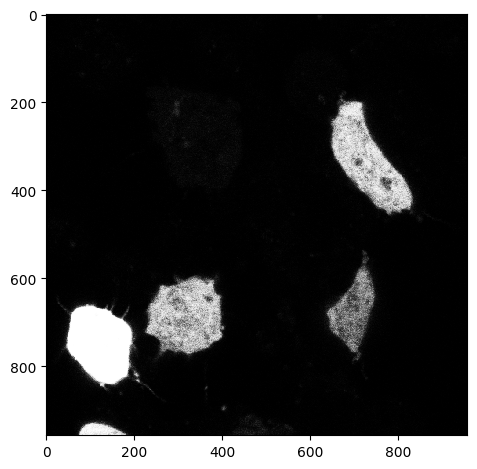

Segmented Cells


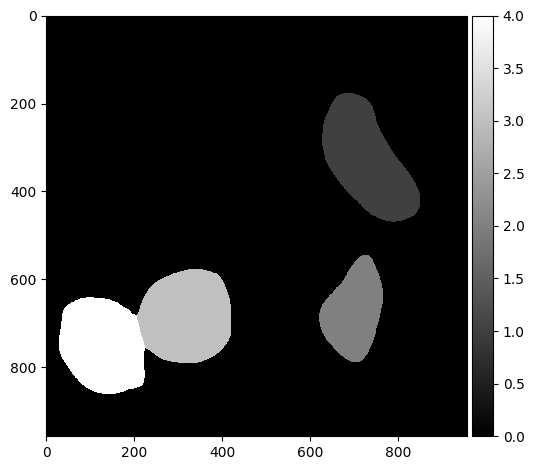

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_ADAMTS19_11.czi
Green Channel


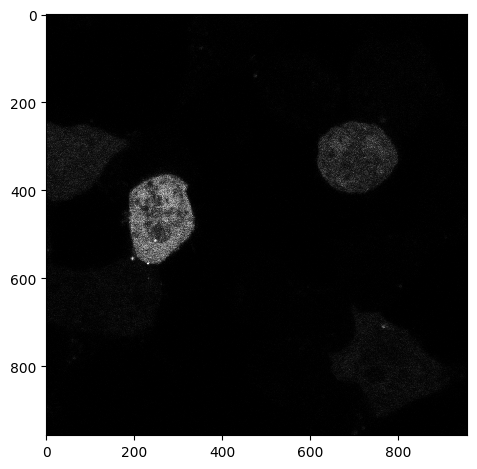

Segmented Cells


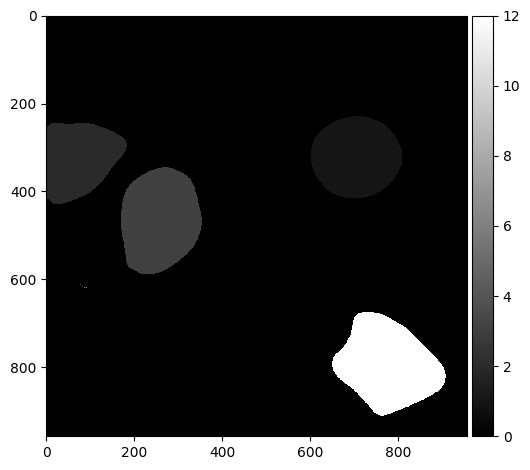

Threshold:  0.99
Bin count 32


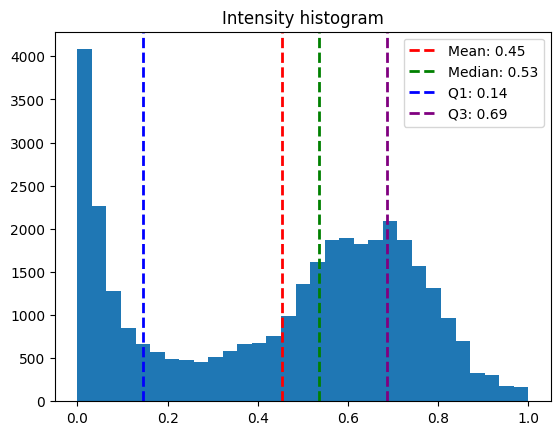

Inclusion Areas:  [11.]


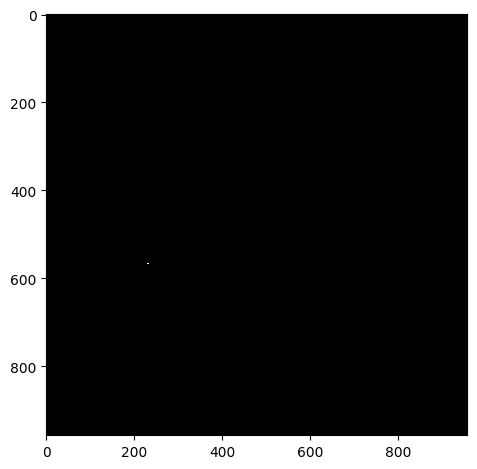

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_01.czi
Green Channel


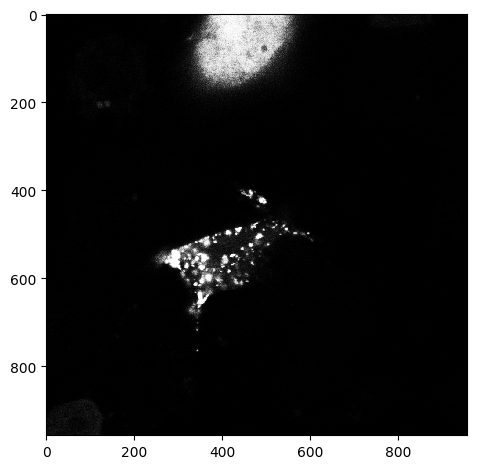

Segmented Cells


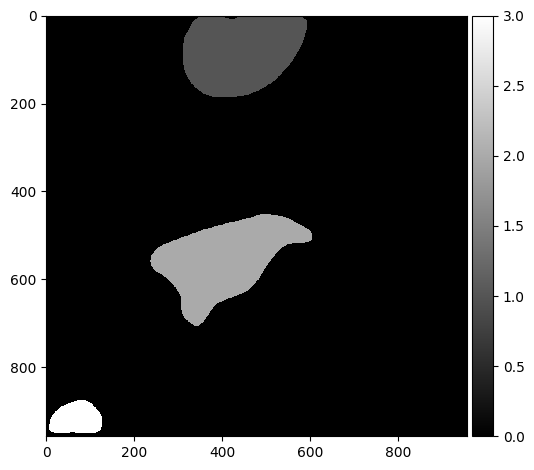

Threshold:  0.5
Bin count 71


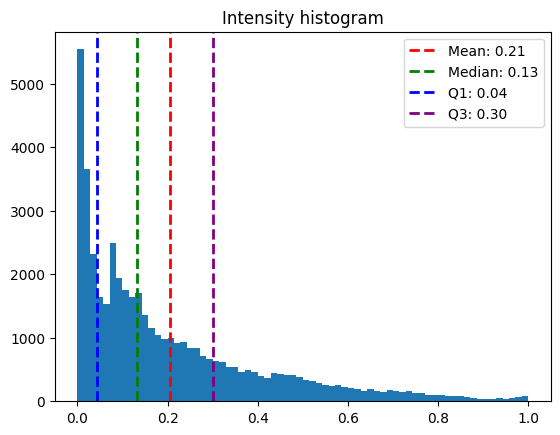

Inclusion Areas:  [  98.   16.   22.  159.   40.   15.  129.   38.   14.   17.  153.   19.
  357.   24.   37.   27.   81. 1480.   14.   36.  976.  155.   19.  107.
  285.   18.   34.  108.   16.   29.   38.   37.   45.   74.   48.   12.
  534.  119.   90.   24.   36.  107.   18.  573.   13.   33.]


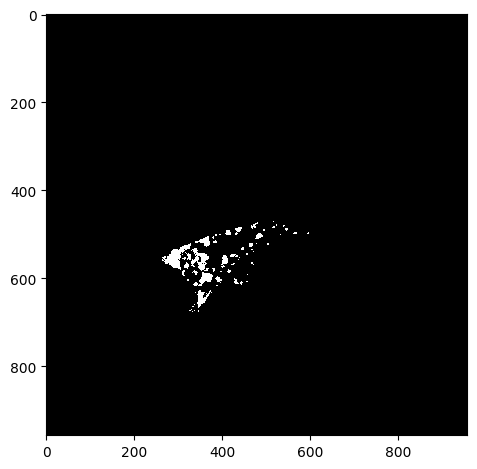

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_02.czi
Green Channel


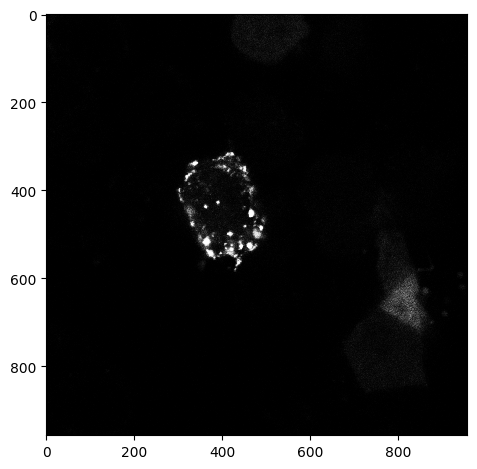

Segmented Cells


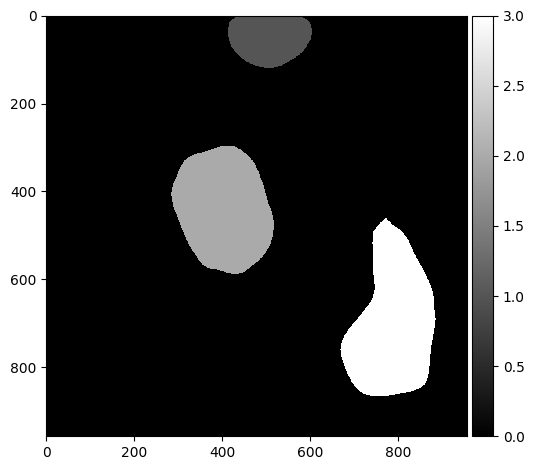

Threshold:  0.5
Bin count 128


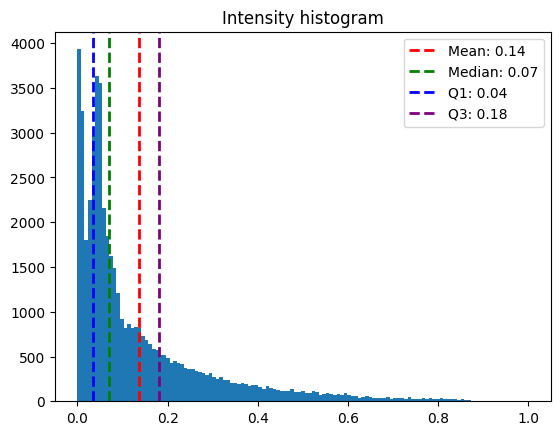

Inclusion Areas:  [113.  20.  15. 121.  42.  17. 124.  33.  27. 129.  18.  56.  28.  28.
  48.  53. 199.  34.  67.  22.  86. 255. 111.  15.  36. 286. 134. 266.
  23. 364. 248.  22. 123.]


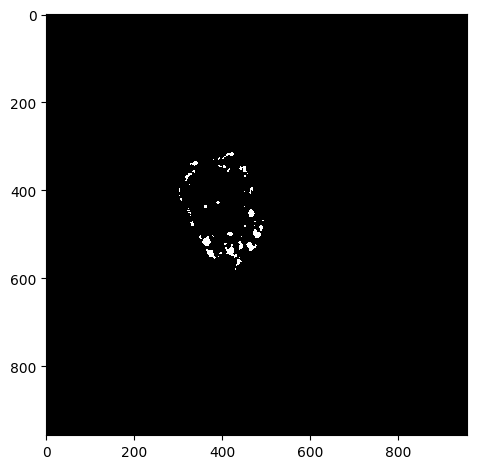

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_03.czi
Green Channel


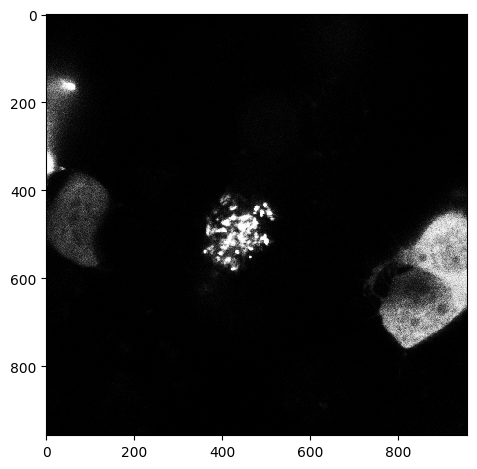

Segmented Cells


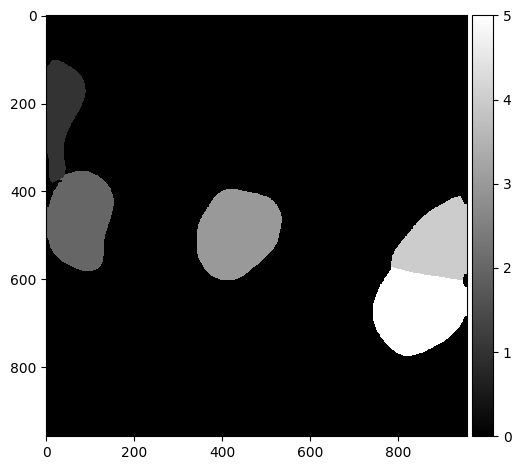

Threshold:  0.5
Bin count 45


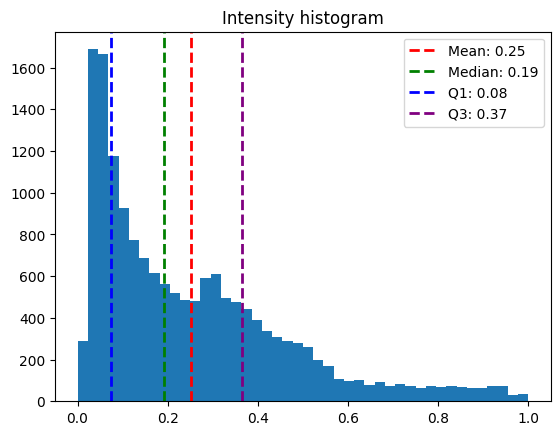

Inclusion Areas:  [1097.   13.  143.   28.   39.  667.   24.]


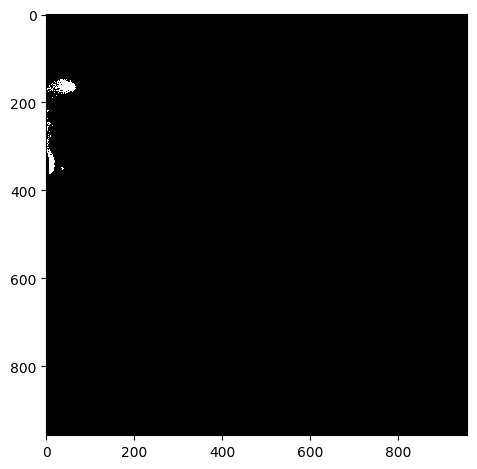

Threshold:  0.99
Bin count 37


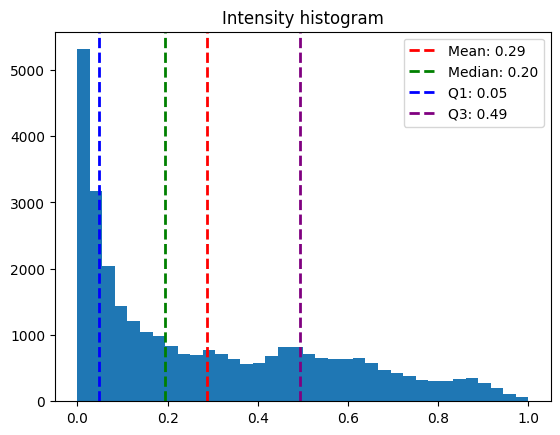

Inclusion Areas:  [ 30.  66.  31.  38.  41.  55. 108. 119. 105. 166.  42.  47.  34.  64.
 164.  12.  35.  37.  17.  37.  17.  36.  37.  18.  28.]


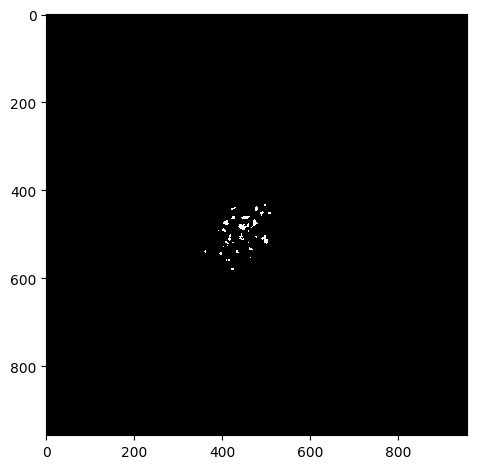

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_04.czi
Green Channel


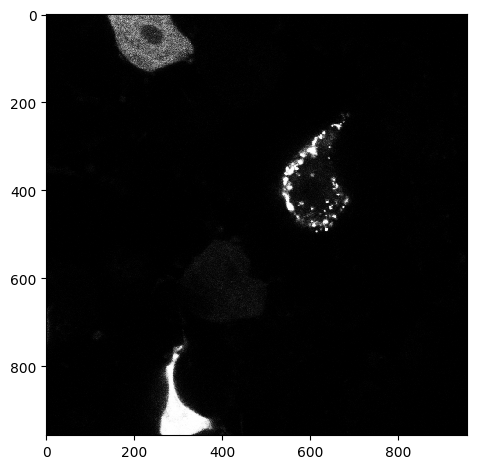

Segmented Cells


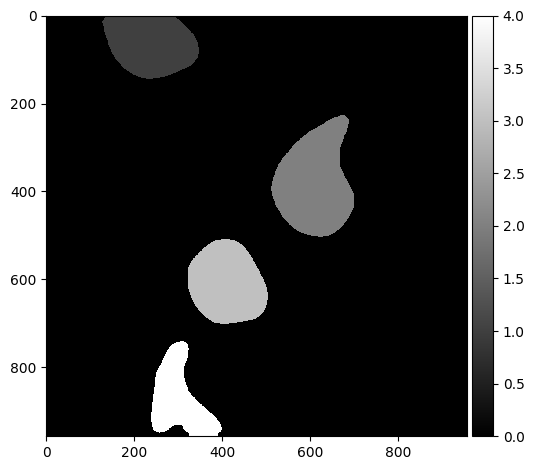

Threshold:  0.5
Bin count 89


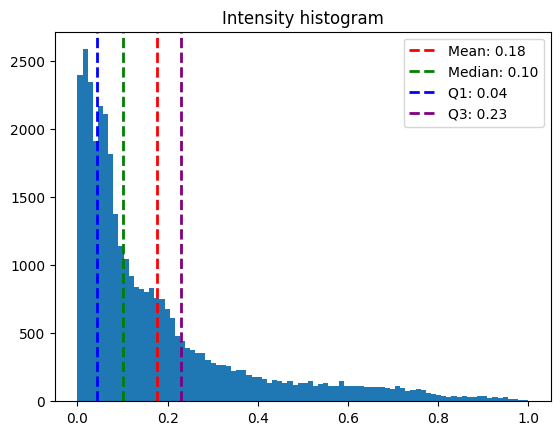

Inclusion Areas:  [132.  52. 829.  15.  11. 713.  13. 398.  32.  11.  90. 500.  25.  54.
  26.  48.  49.  23.  16.  19.  43.  53. 127.  25.  86.  11.  16.  47.
  12.]


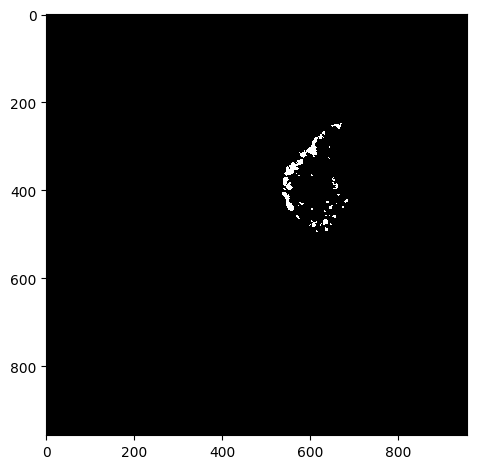

Threshold:  0.99
Bin count 19


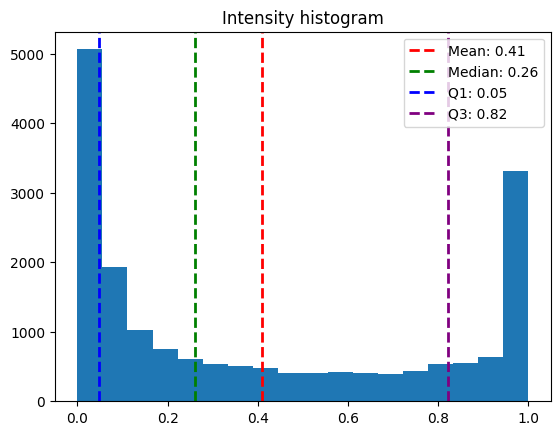

Inclusion Areas:  [ 424.  597. 1285.  260.]


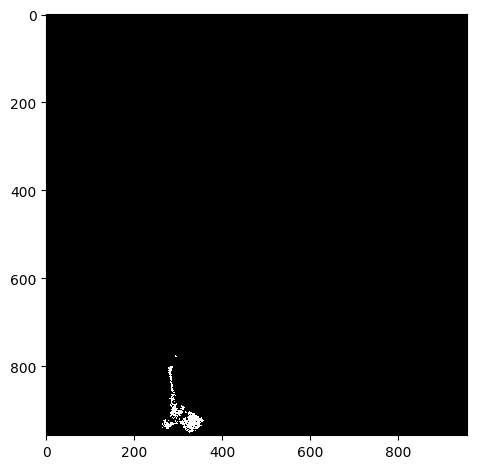

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_05.czi
Green Channel


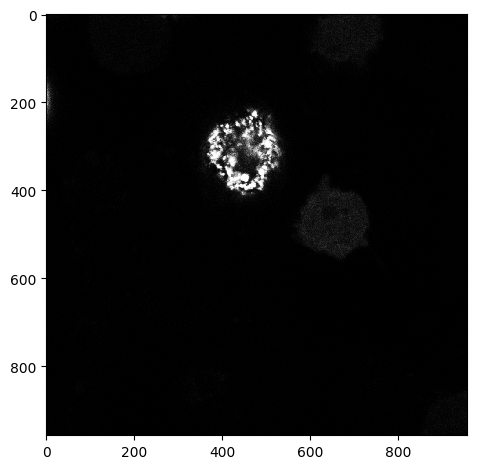

Segmented Cells


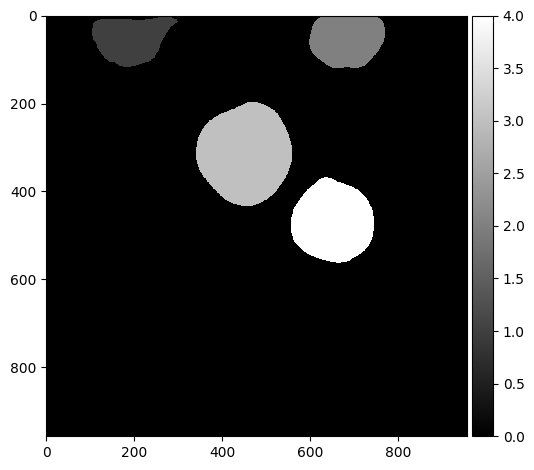

Threshold:  0.99
Bin count 39


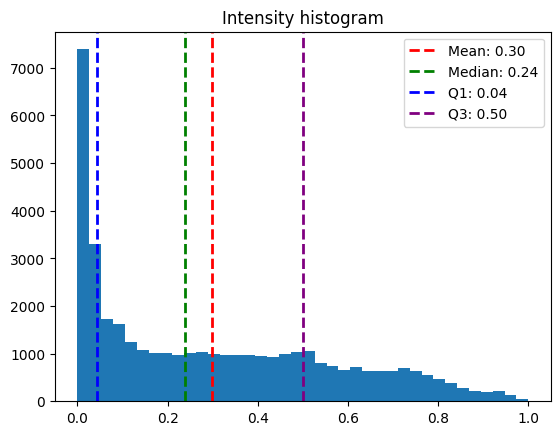

Inclusion Areas:  [ 49.  11.  15.  13.  22.  29.  26.  18.  15. 116.  11.  39.  15.  16.
  28.  51. 126.  78. 188.  61.  40.  12.  25.  16. 181.  27.]


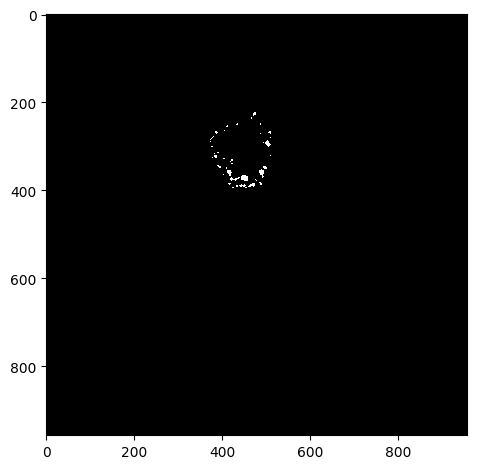

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_06.czi
Green Channel


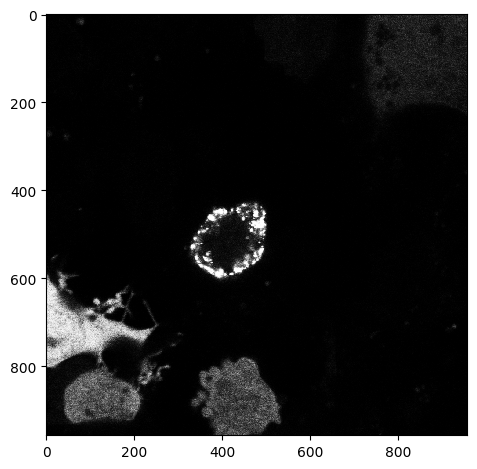

Segmented Cells


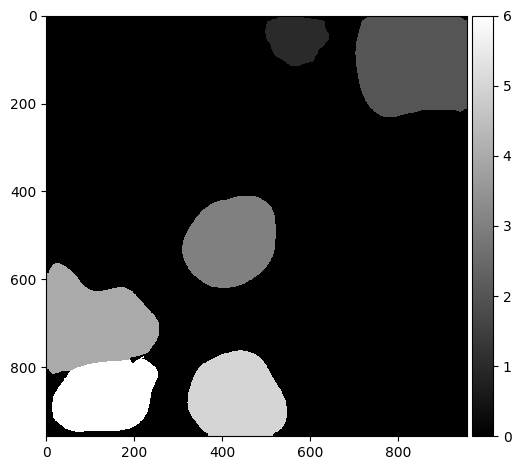

Threshold:  0.5
Bin count 54


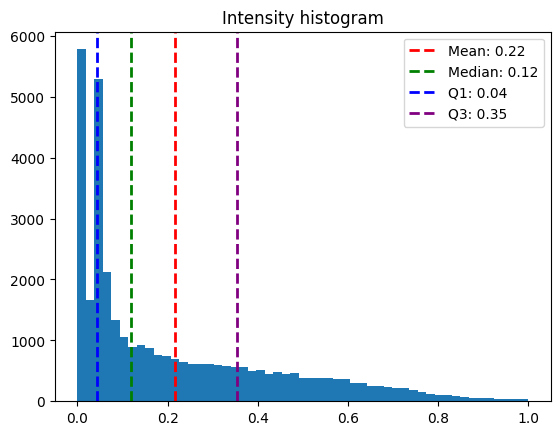

Inclusion Areas:  [  70.   56.   11.   97.  720.   43.  209. 1063.   22.   21.   62.  135.
   69.   11.   16.  196.   13.  482.   64.  960.  686.  147.   11.   52.]


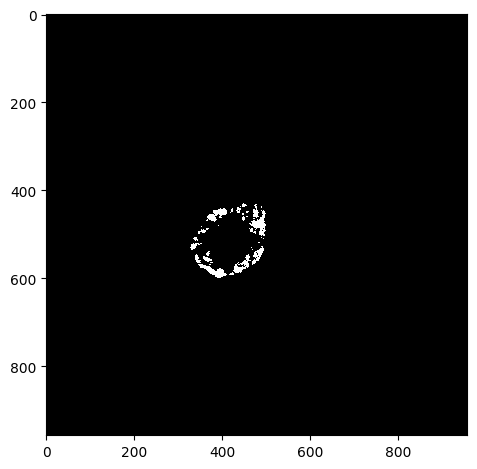

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_07.czi
Green Channel


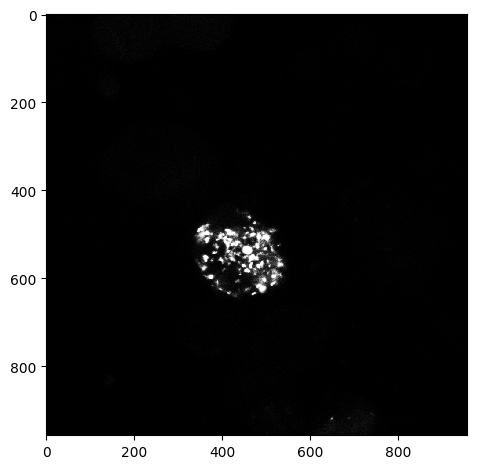

Segmented Cells


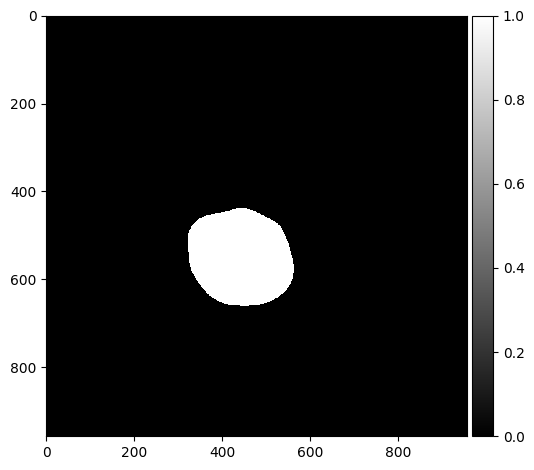

Threshold:  0.5
Bin count 54


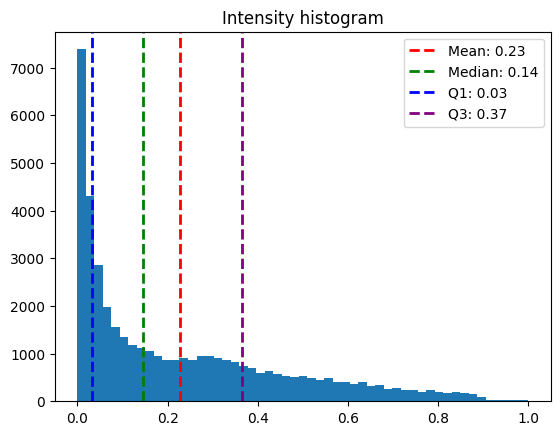

Inclusion Areas:  [  33.   35.  739.   52.   14. 1526.   45.  864.   40.   45.   47.   60.
   11. 1071.   65.   60.   47.  142.   79.   18.  183.   13.   37.  195.
   15.   69.   19.   94.   40.   17.  389.   17.   31.   11.  114.  501.
   29.   17.   23.   30.   47.]


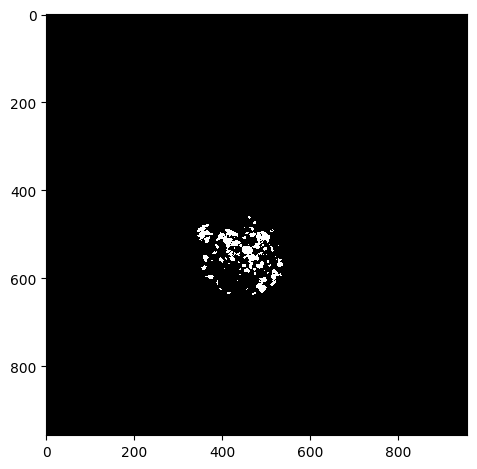

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_08.czi
Green Channel


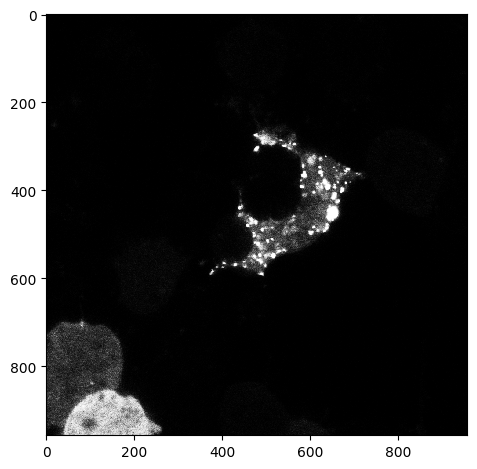

Segmented Cells


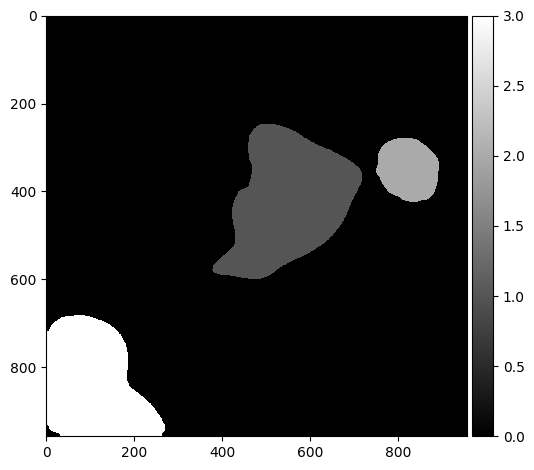

Threshold:  0.5
Bin count 68


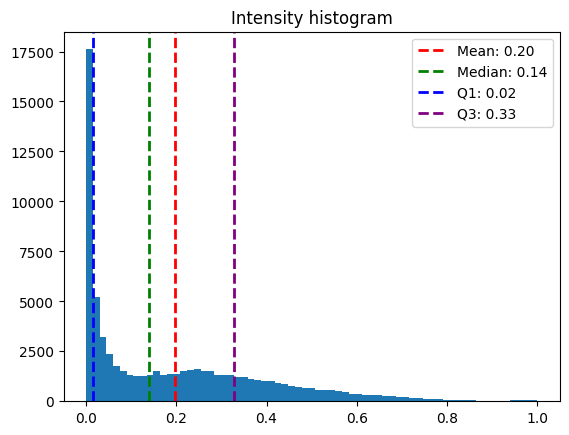

Inclusion Areas:  [ 695.   26.  218.   41.  109.  332.   16.   70.   61.  184.   15.  132.
  170.   15.   51.   13.   39.  718.   20.   24.   27.   83.   82.  111.
   54.  335.   70.   60.   11.   11.  954.   86.   71.   11.   99.  399.
   24.  398.  111.   76.  129.   36.  108. 1688.   48.   66.   49.   22.
   24.   28.   59.   49.   14.   12.   74.]


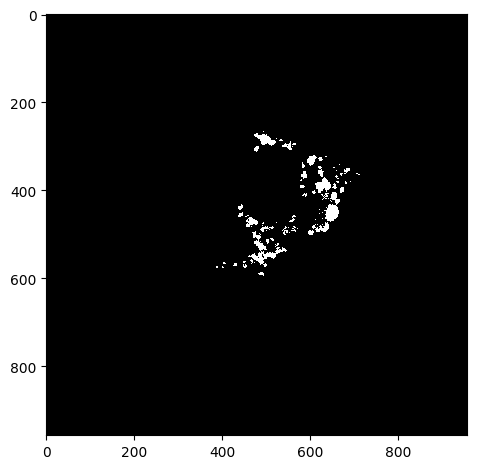

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_09.czi
Green Channel


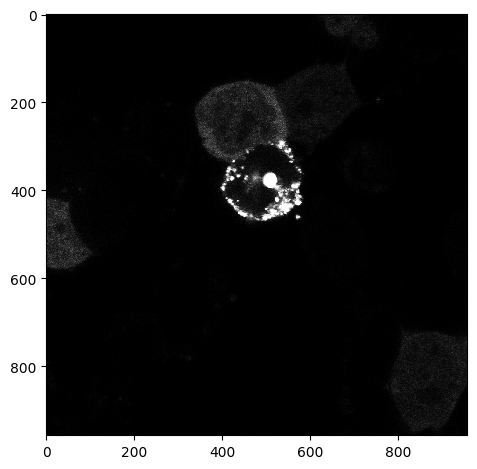

Segmented Cells


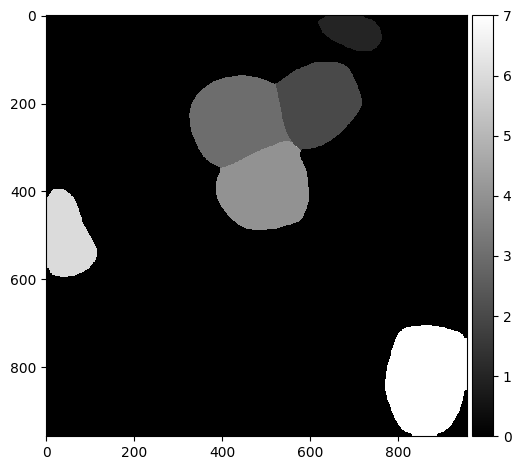

Threshold:  0.5
Bin count 163


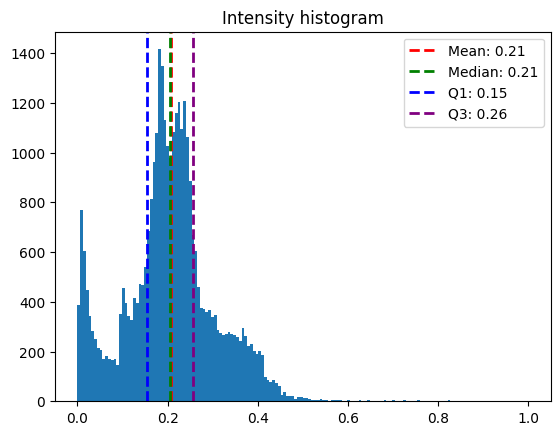

Inclusion Areas:  [15. 26. 21.]


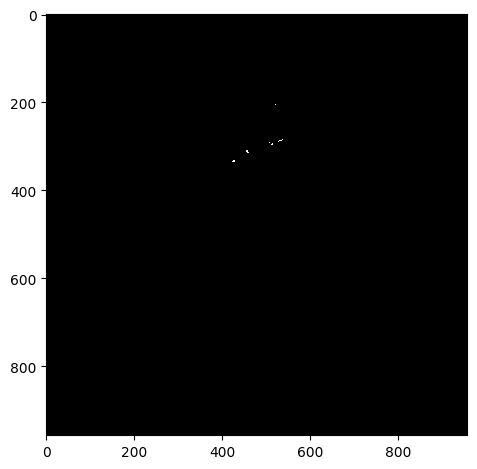

Threshold:  0.5
Bin count 56


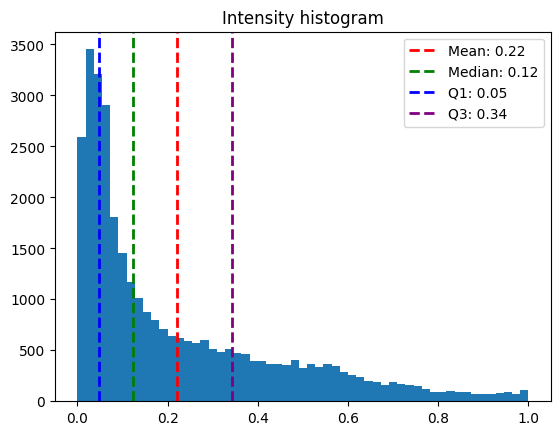

Inclusion Areas:  [ 246.  141.   59.   26.   29.  370.   44. 2902.   58.   67.   36.  278.
  125.  397.   25.  100.   14.  240.   11.   31.  262.   58.   29.]


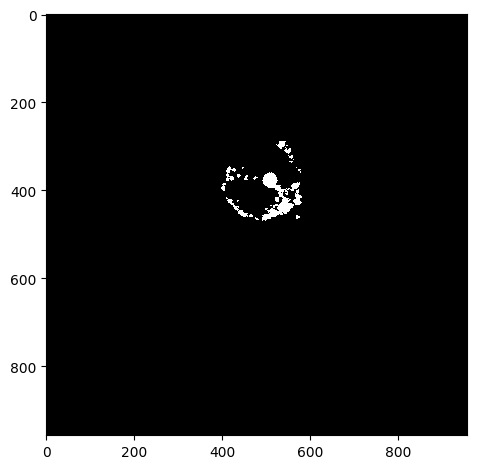

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_10.czi
Green Channel


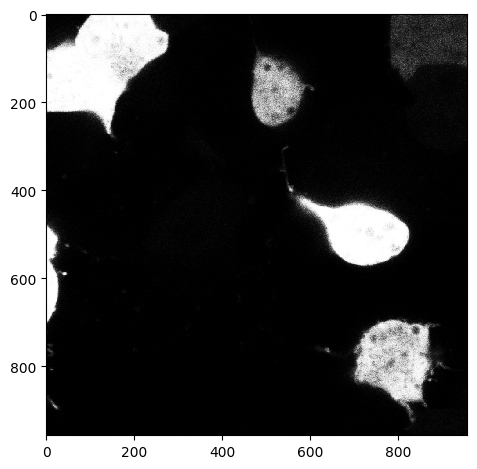

Segmented Cells


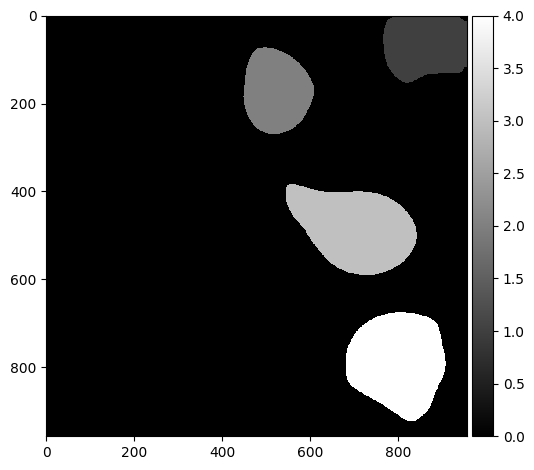

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_PFF_TAX1BP1_11.czi
Green Channel


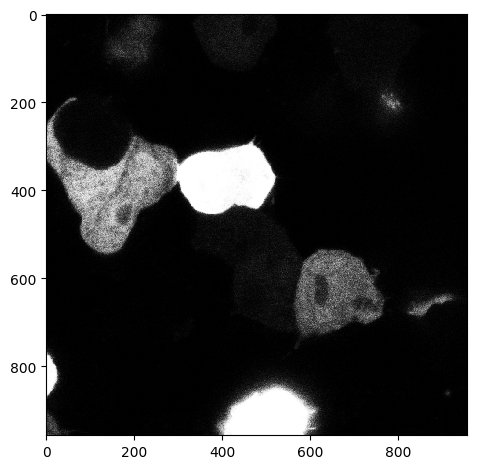

Segmented Cells


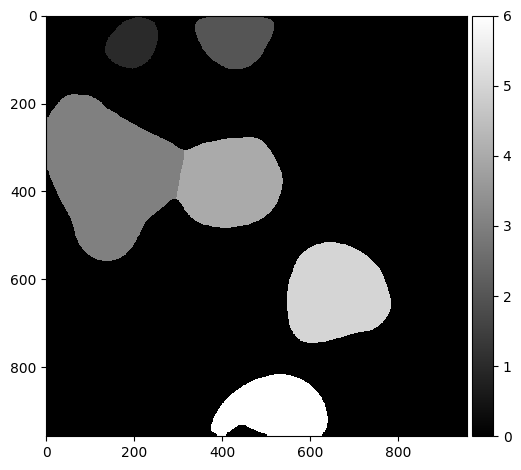

Threshold:  0.99
Bin count 40


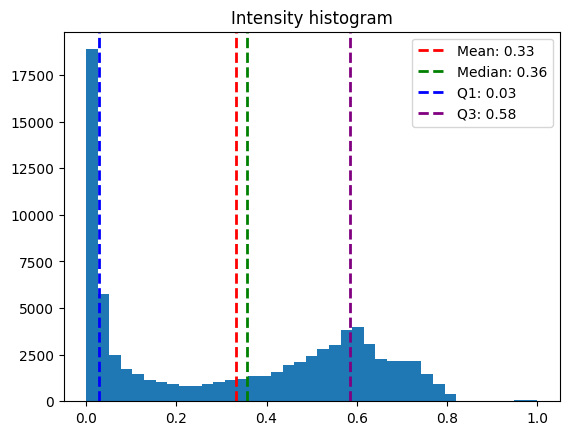

Inclusion Areas:  [189.]


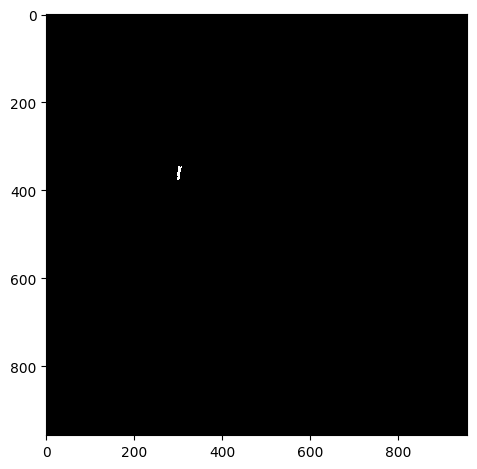

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_01.czi
Green Channel


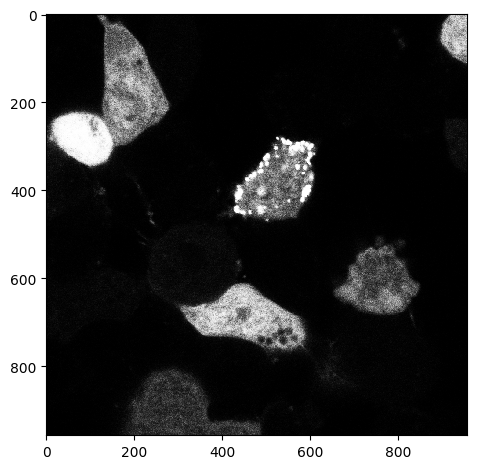

Segmented Cells


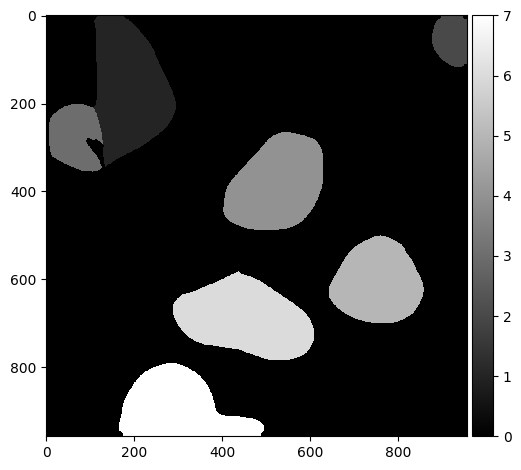

Threshold:  0.99
Bin count 38


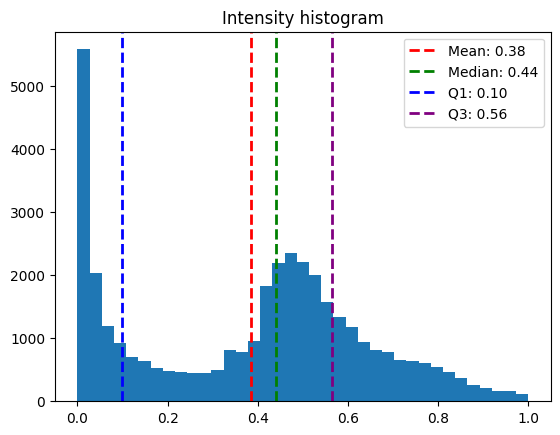

Inclusion Areas:  [ 14.  54.  86.  38. 238.  45.  86.  28.  13. 148.  97.  18.  37.  51.
  62.  67.  19.  92.  17.  31. 331. 215.  45. 126.  20.  15.]


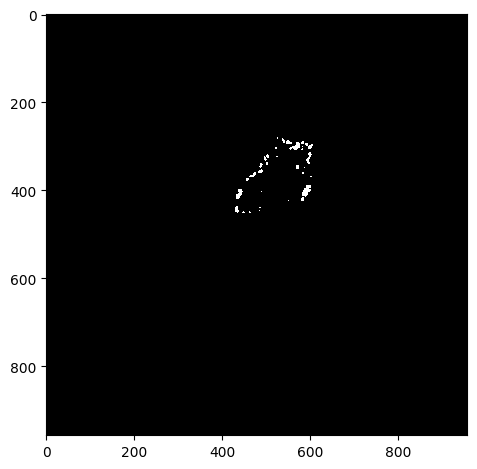

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_02.czi
Green Channel


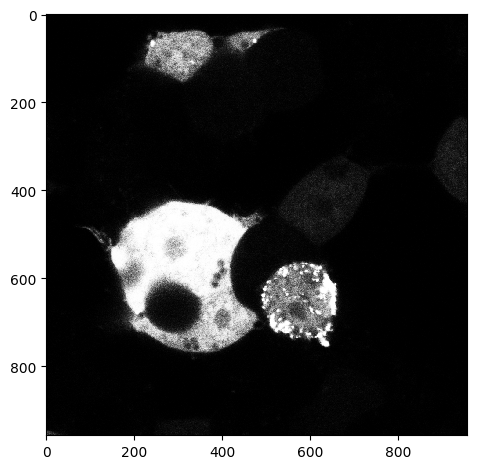

Segmented Cells


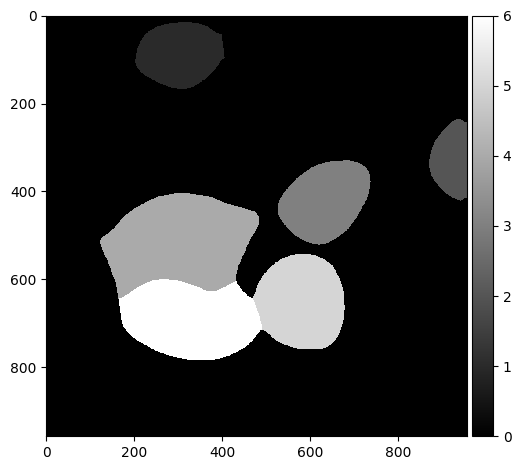

Threshold:  0.99
Bin count 24


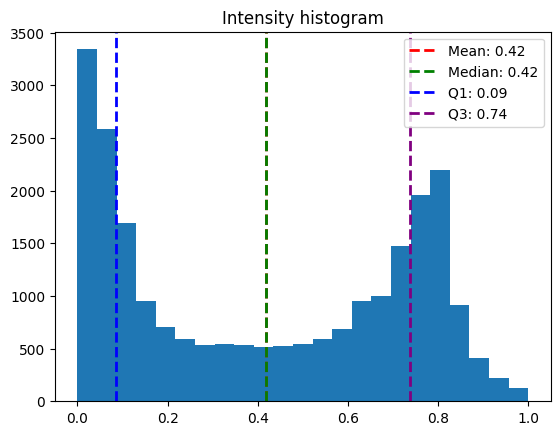

Inclusion Areas:  [43. 12.]


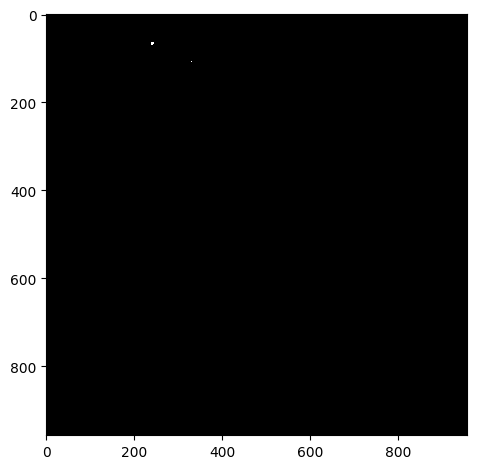

Threshold:  0.99
Bin count 45


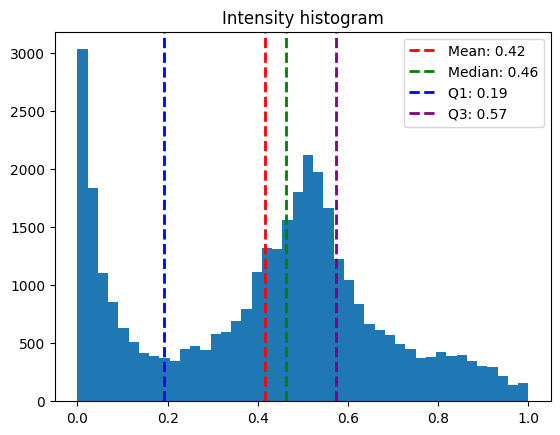

Inclusion Areas:  [  19.   30.   13.   78.   12.   12.   12.   19. 1056.   24.   34.   40.
   19.   17.   13.   11.   12.   23.  203.  165.   70.   52.   38.   20.
   27.   31.   20.   74.  110.]


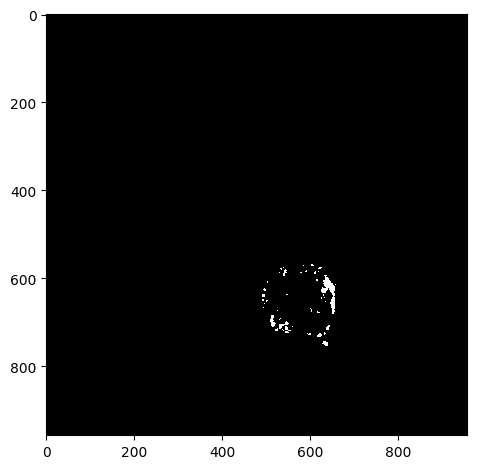

Threshold:  0.99
Bin count 29


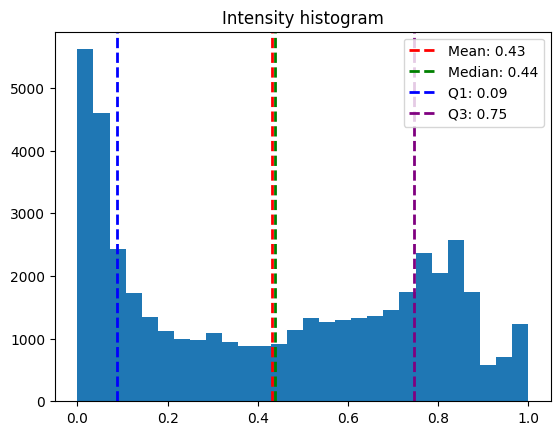

Inclusion Areas:  [218.  22.  48.]


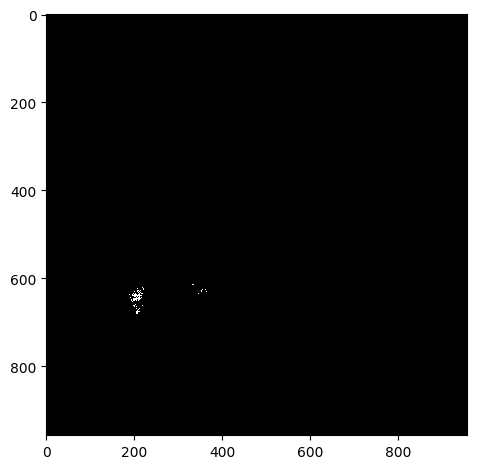

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_03.czi
Green Channel


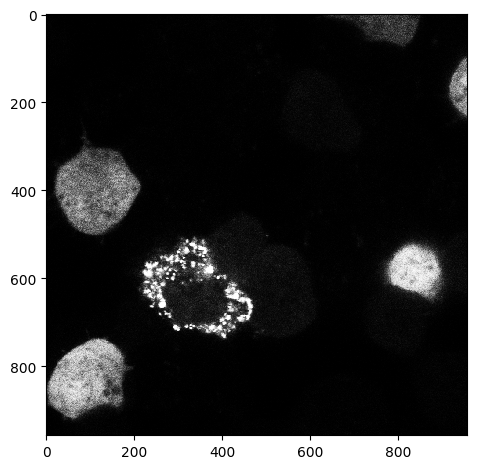

Segmented Cells


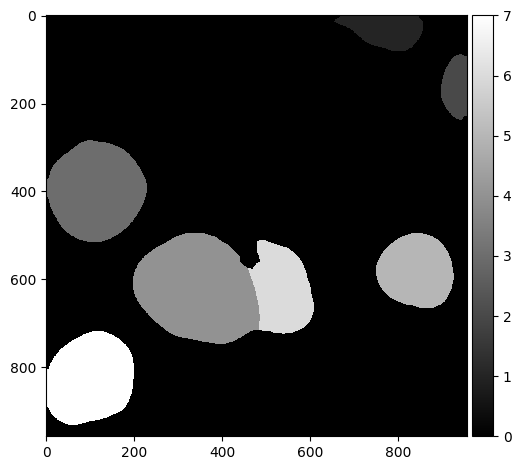

Threshold:  0.99
Bin count 55


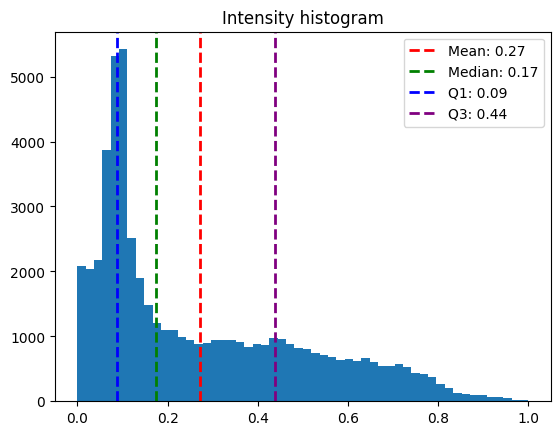

Inclusion Areas:  [ 61. 103.  17.  40.  17.  13.  19.  14.  12.  44.  63. 178.  17.  20.
  30.  61.  21.  17.  14.  21.  17.  27.  15. 140.  28.  50.  24.  13.
 125. 126.  18.  44.  36.  33.  21.  33.  47.  16.  40.  19.]


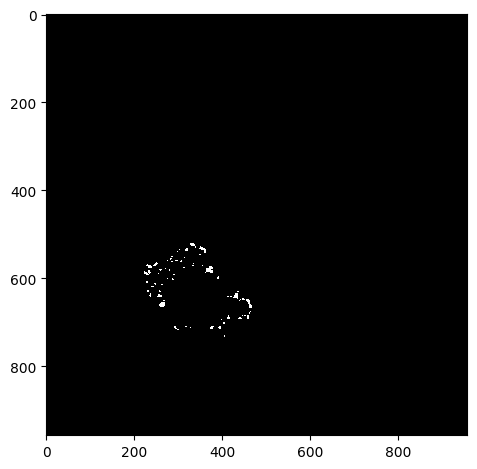

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_04.czi
Green Channel


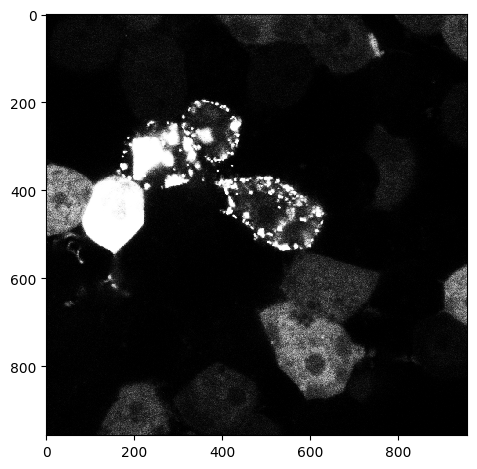

Segmented Cells


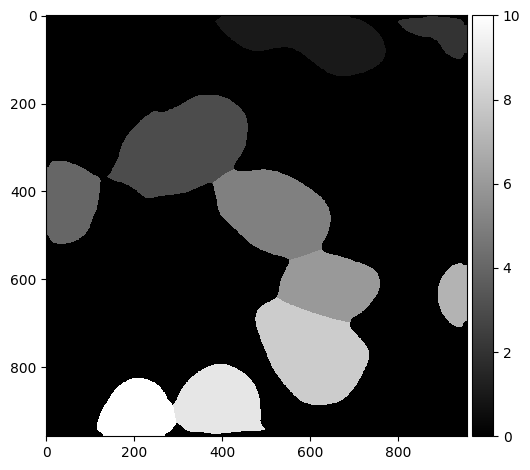

Threshold:  0.5
Bin count 218


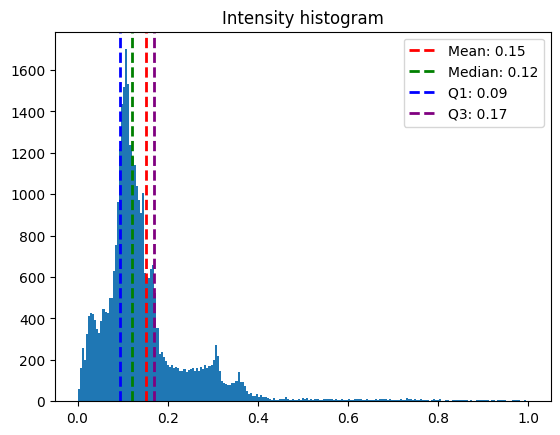

Inclusion Areas:  [431.]


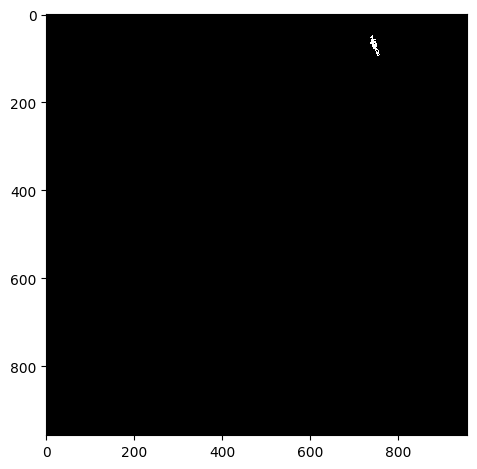

Threshold:  0.99
Bin count 38


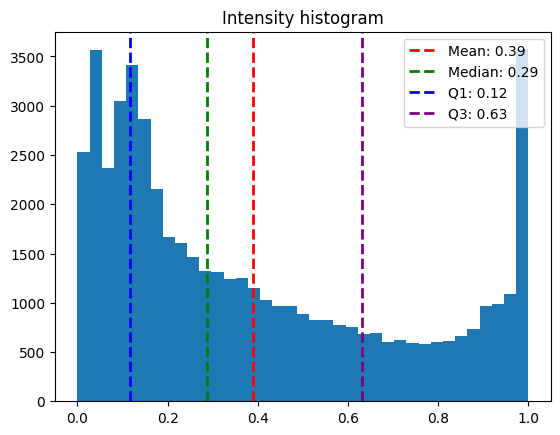

Inclusion Areas:  [  15.   12.   19.   25.  286.   19.   18.  522.  170.   35.   23.   15.
 4870.  654.   41.   40.   27.   11.   31.   20.   12.   15.   17.   14.
   17.   12.   25.  121.   49.   56.   20.  663.   55.   80.   29.   16.]


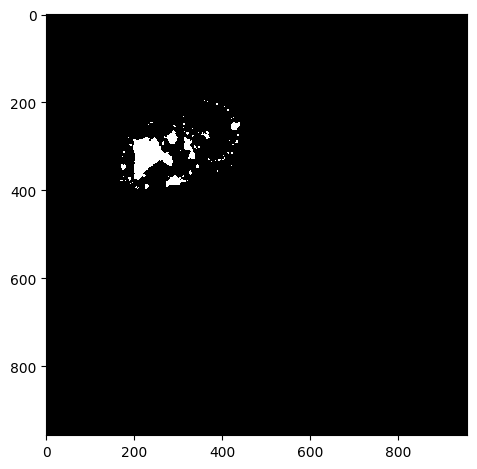

Threshold:  0.99
Bin count 64


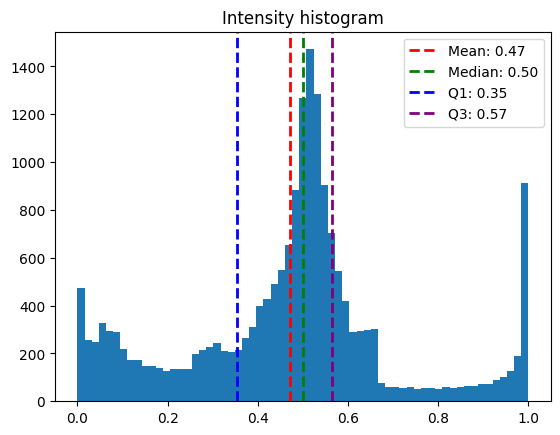

Inclusion Areas:  [1628.]


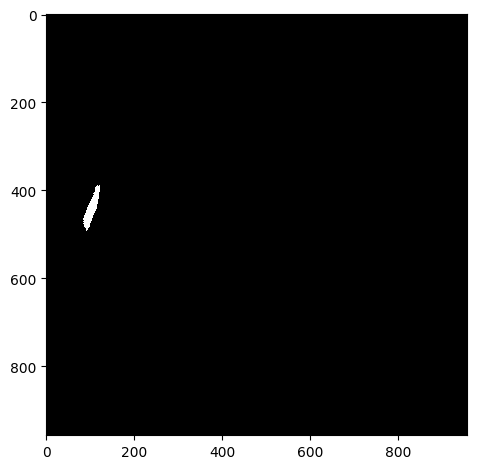

Threshold:  0.99
Bin count 53


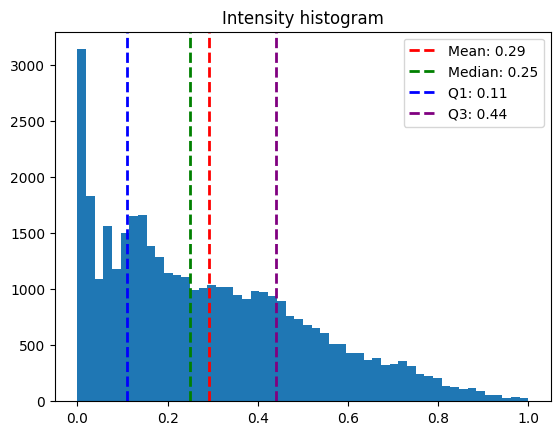

Inclusion Areas:  [ 23.  62.  13.  39.  36.  57. 214.  93. 140.  22.  19.  41.  34.  22.
  13. 109.  11. 106. 111.  62.  19.  48.  23.  48. 164.  19.  25.  17.
  30.  13. 180.  44.]


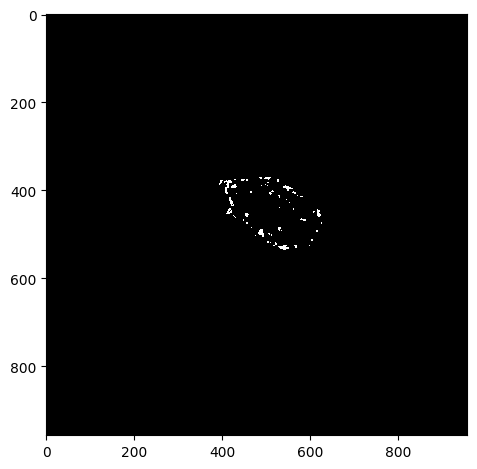

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_05.czi
Green Channel


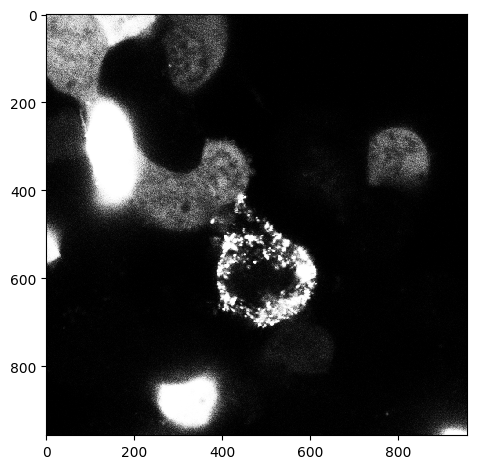

Segmented Cells


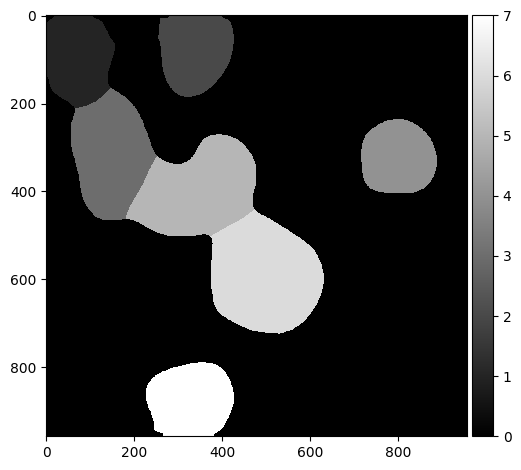

Threshold:  0.99
Bin count 77


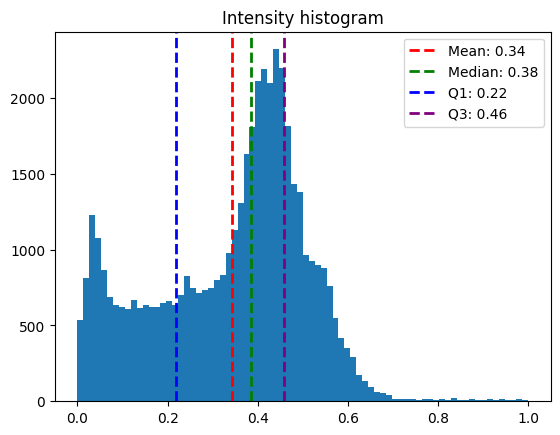

Inclusion Areas:  [16. 31.]


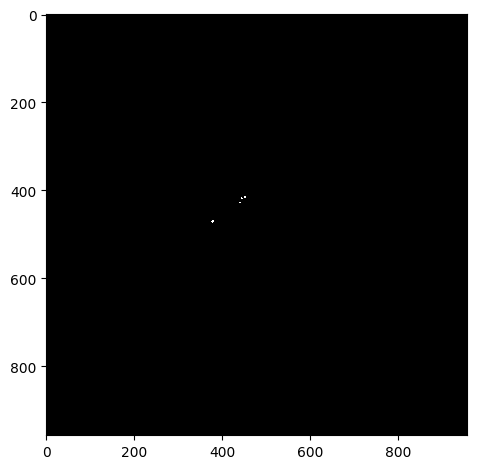

Threshold:  0.99
Bin count 41


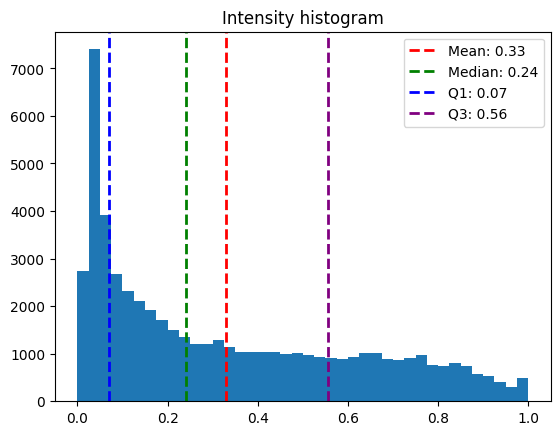

Inclusion Areas:  [  47.   37.  435.   77.  171.   48.   23.   41.  120.   15.   72.   41.
  236.   13.   30.   18.   55.   36.   34.   30.   26.   16.   24.   47.
 1033.   94.   27.   50.   19.   14.   13.  114.  152.  338.   83.   27.
   27.   12.   18.   17.   19.   15.   25.   18.   21.   12.   57.   23.]


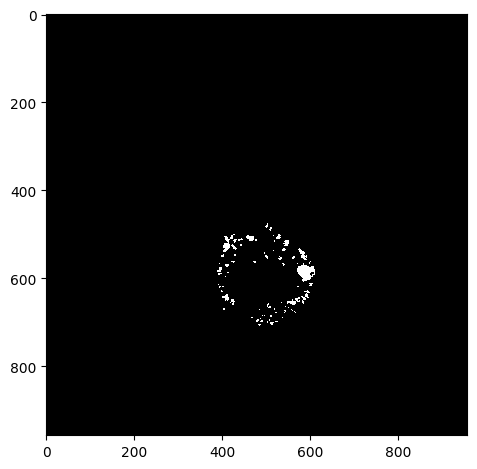

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_06.czi
Green Channel


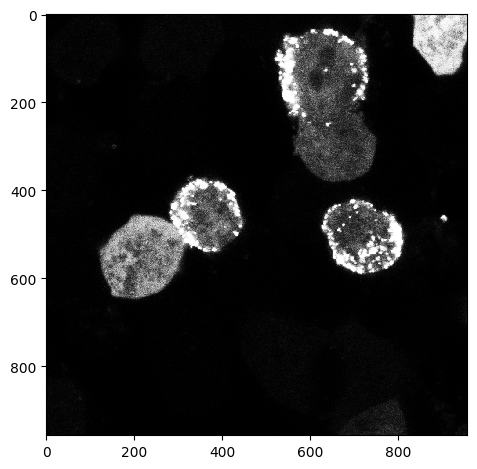

Segmented Cells


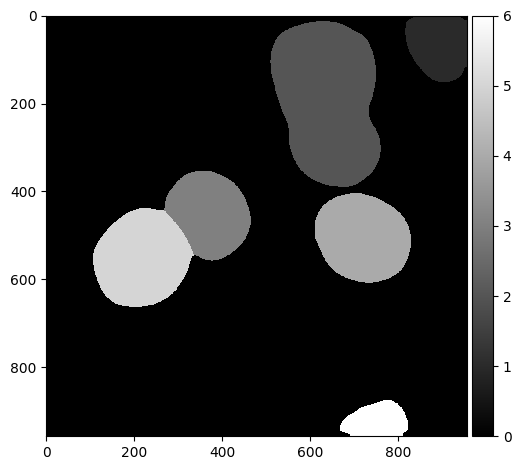

Threshold:  0.5
Bin count 128


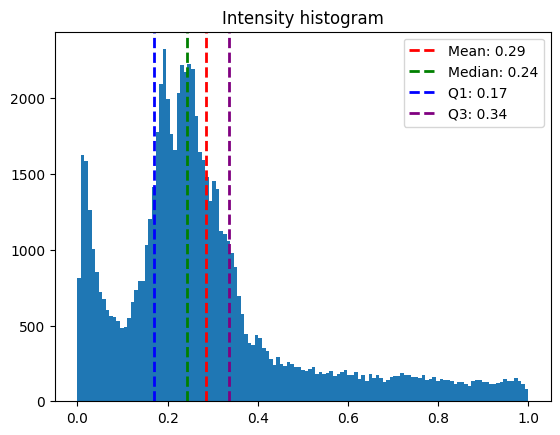

Inclusion Areas:  [ 492.  123. 6178.  537.   26.   54. 1108.   60.  140.   55.   62.  560.
   34.   86.]


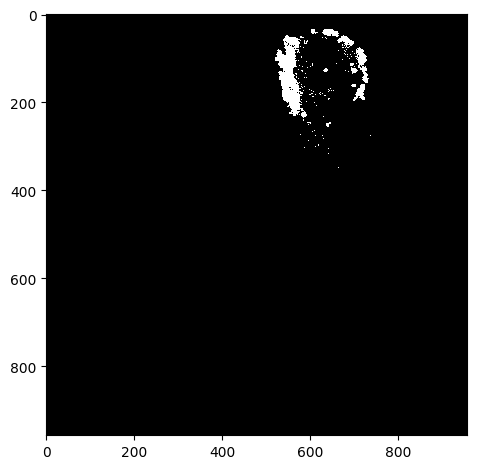

Threshold:  0.99
Bin count 43


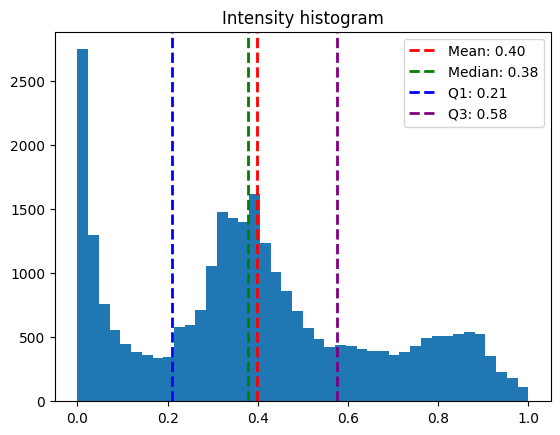

Inclusion Areas:  [270. 181. 209. 159.  27.  90.  28. 140.  18.  16.  23.  80.  15. 171.
 144.  12. 335.  11.  46.  24.  17.  38.]


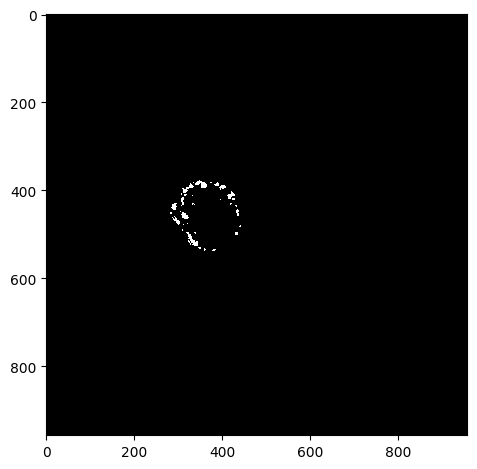

Threshold:  0.99
Bin count 44


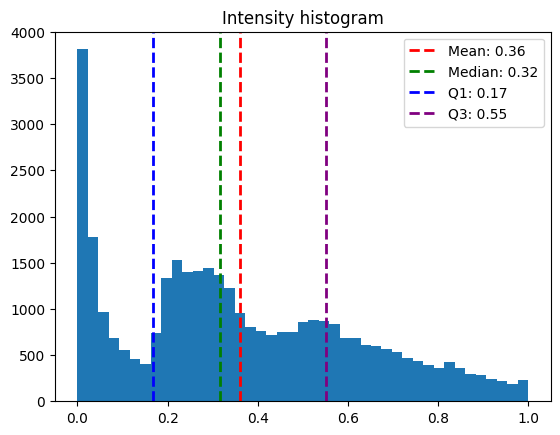

Inclusion Areas:  [  53.   46.   16.   21.   17.   30.   11.   27.   30. 1079.   33.   18.
   30.   30.   46.   21.   14.   11.  179.  165.   14.   40.   18.   20.
   83.   29.  173.   18.   48.  202.   31.   34.   17.   73.]


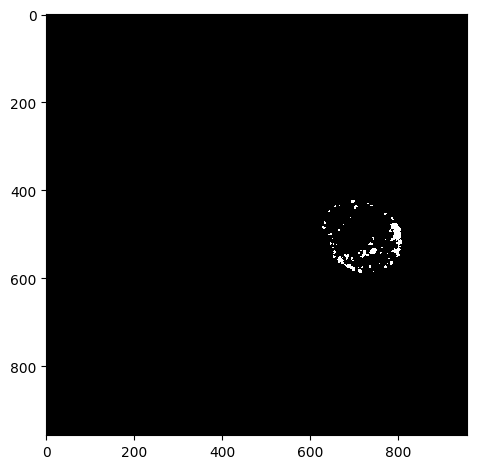

Threshold:  0.99
Bin count 52


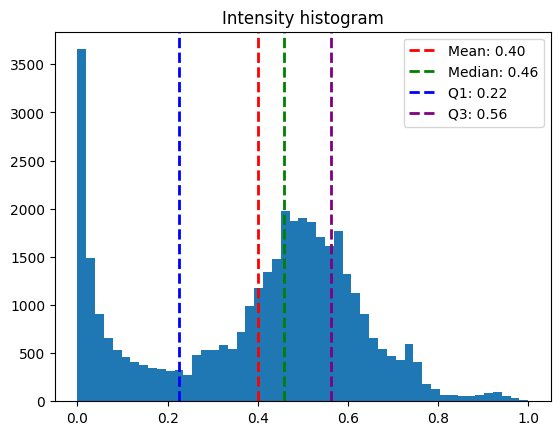

Inclusion Areas:  [14. 61. 41. 12. 75.]


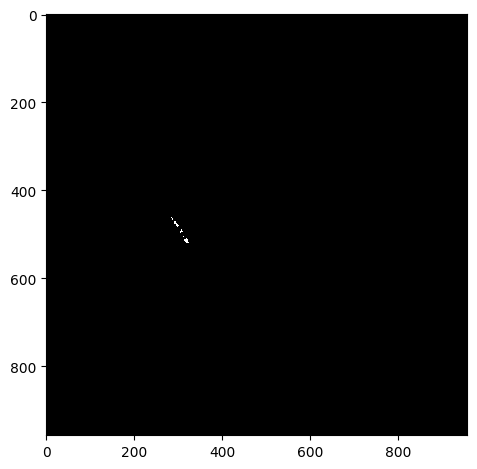

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_07.czi
Green Channel


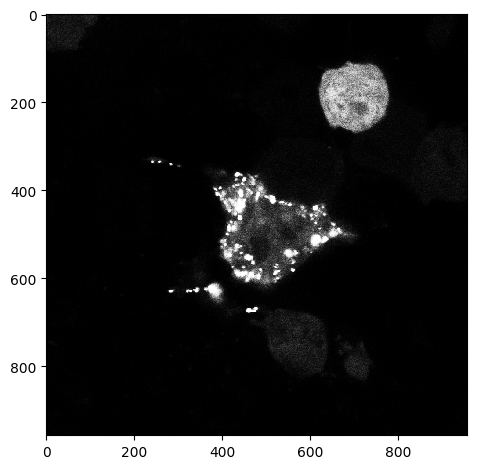

Segmented Cells


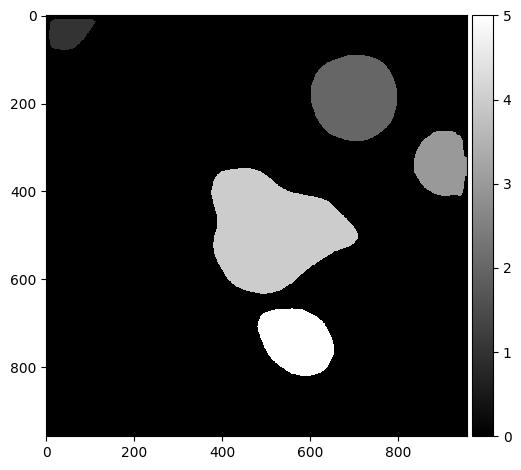

Threshold:  0.99
Bin count 67


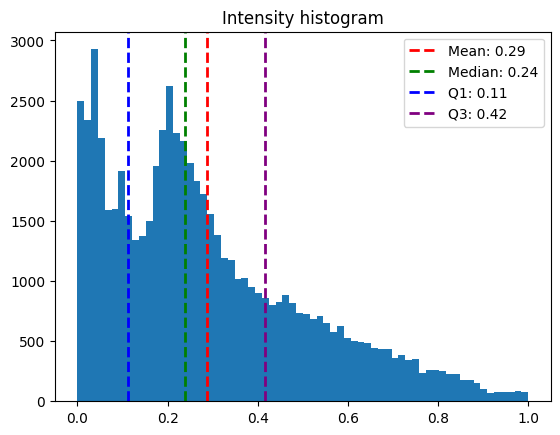

Inclusion Areas:  [ 59.  35.  21. 111.  30.  71.  21.  27.  58. 230.  31.  21.  17.  22.
  77.  19.  16.  11.  16.  39.  11.  12.  12.  62.  37.  20.  13. 260.
  84.  12.  38.  76.  11.  44. 121.  17.  13.  25.  53. 194.  82.  39.
  26.  16.]


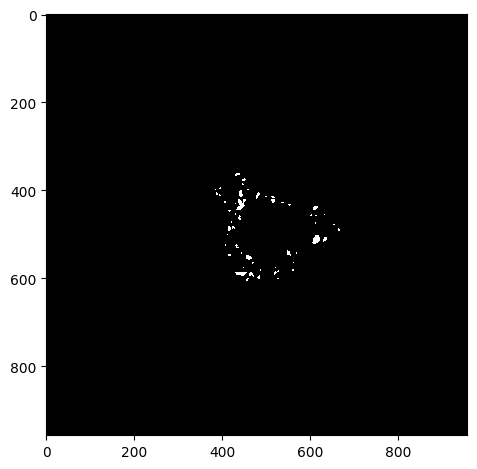

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_08.czi
Green Channel


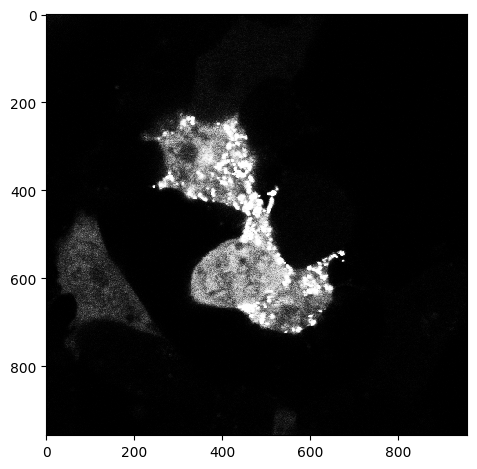

Segmented Cells


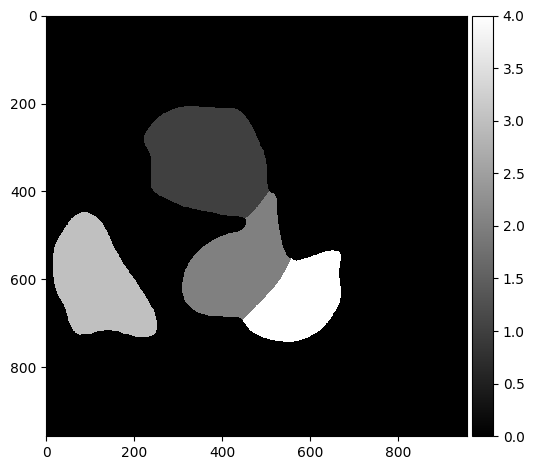

Threshold:  0.99
Bin count 37


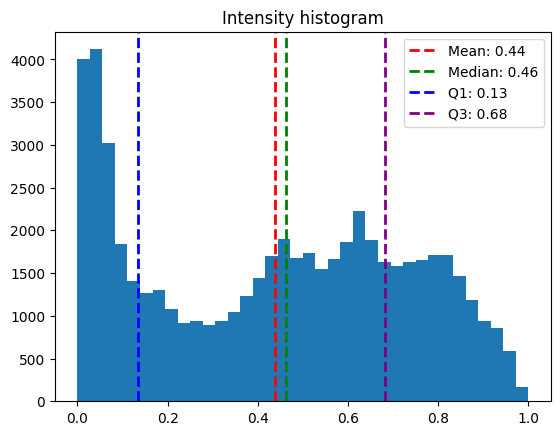

Inclusion Areas:  [125.  17. 208.  25. 101.  46.  37.  43. 100.  71.  20.  20.  17. 231.
 355.  22. 317.  67.  42.  23.  19.  25. 108.  95.  28.  48. 106. 168.
  34.  14.  84.  19.  31. 475.  14.  89.  24.  56.  48.  27. 100.  69.]


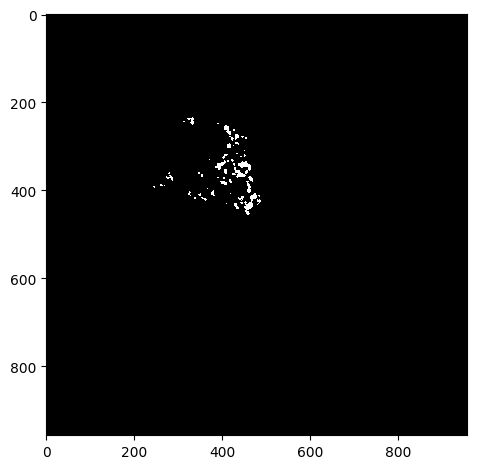

Threshold:  0.99
Bin count 60


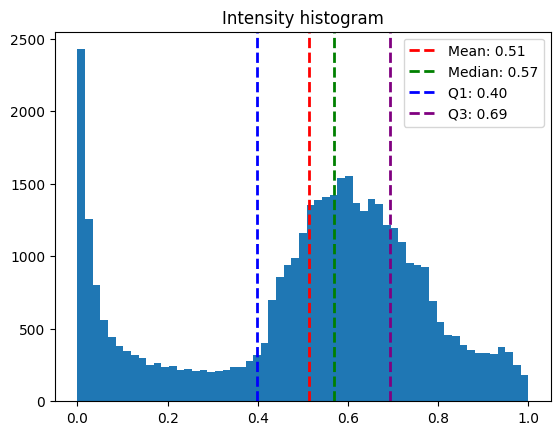

Inclusion Areas:  [107. 177.  55. 264.  19.  49.  11. 447.  24.  23. 101.  61.  38.  23.
  24. 106.  13.  48.  23. 127. 354.]


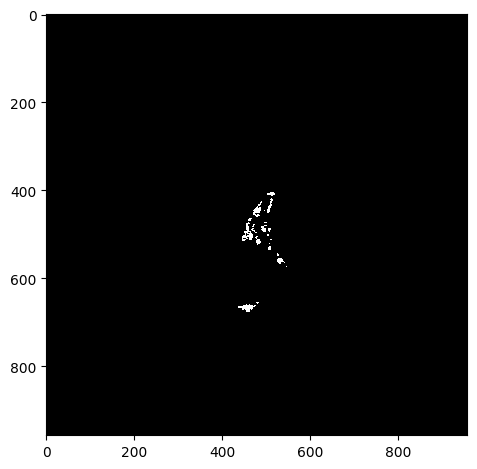

Threshold:  0.99
Bin count 33


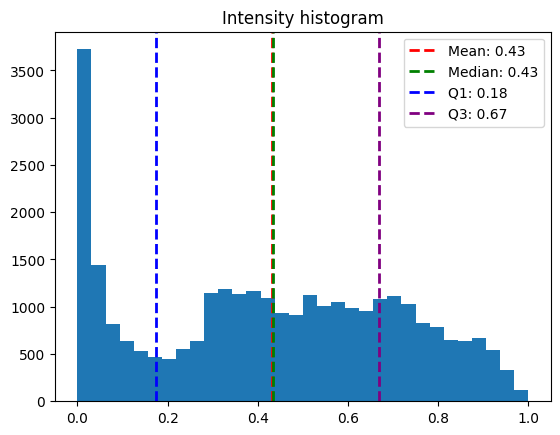

Inclusion Areas:  [ 54.  17.  32.  41.  52. 129.  19.  21.  17.  41.  77. 159.  90.  13.
  41.  47.  88. 188.  21.  18.  31.  16.  14.  20.  50.  11.  52.  32.
 142.  29.  57.  19.  50.  18.]


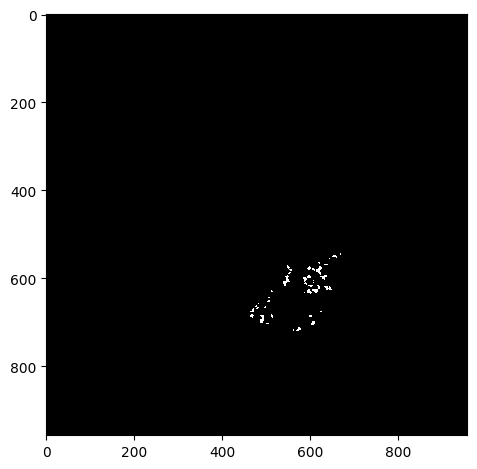

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_09.czi
Green Channel


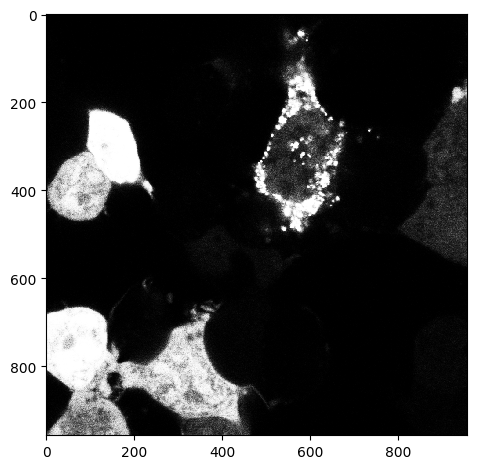

Segmented Cells


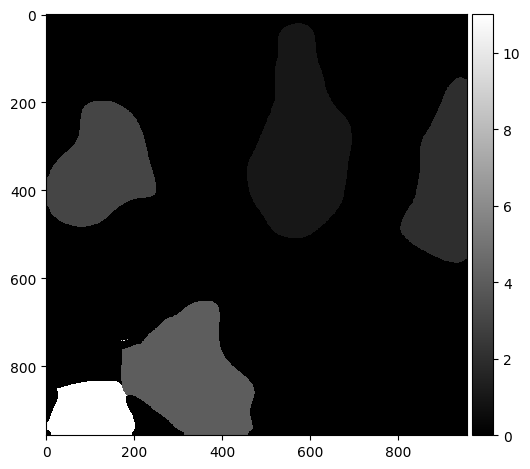

Threshold:  0.99
Bin count 60


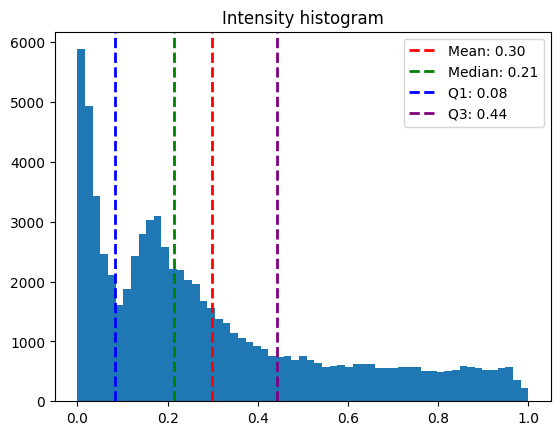

Inclusion Areas:  [ 80. 164. 365.  32. 173. 124. 220.  15.  25.  46.  19.  33.  24.  16.
 174.  61. 120.  37.  16.  41.  28.  32.  60.  55.  19.  51. 316.  18.
  17.  48.  24. 160.  15.  14.  50.  16.  94. 882.  56.  22.  41. 181.
  37.  85.  81. 243.  36.]


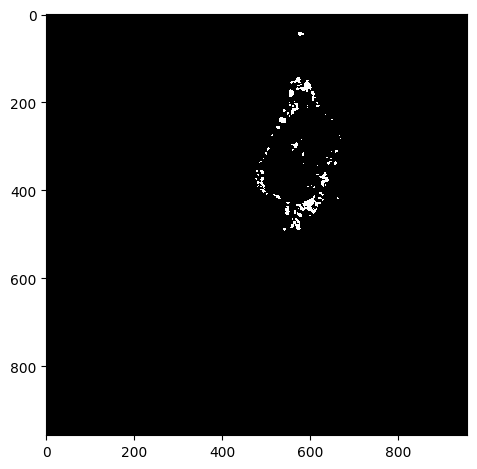

Threshold:  0.5
Bin count 276


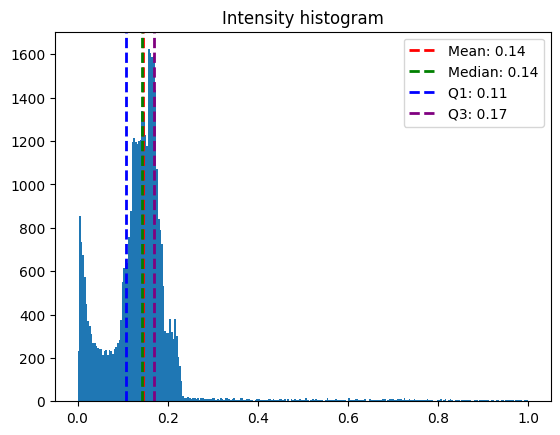

Inclusion Areas:  [765.]


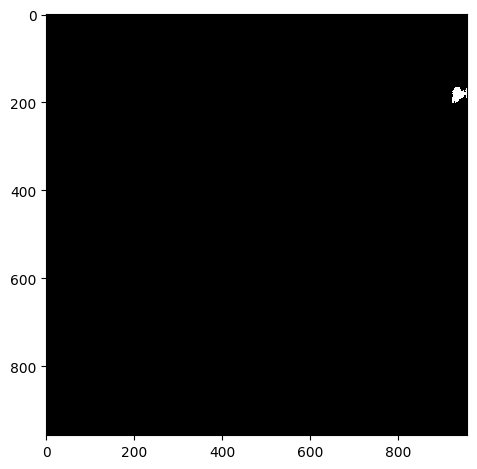

Threshold:  0.99
Bin count 41


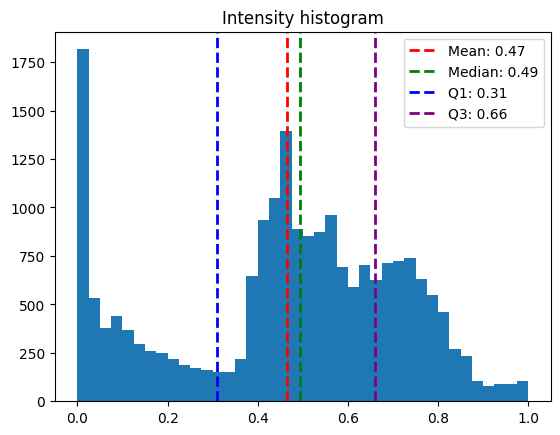

Inclusion Areas:  [82.]


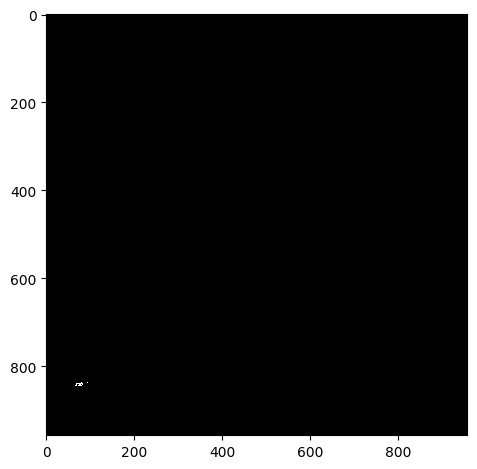

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_10.czi
Green Channel


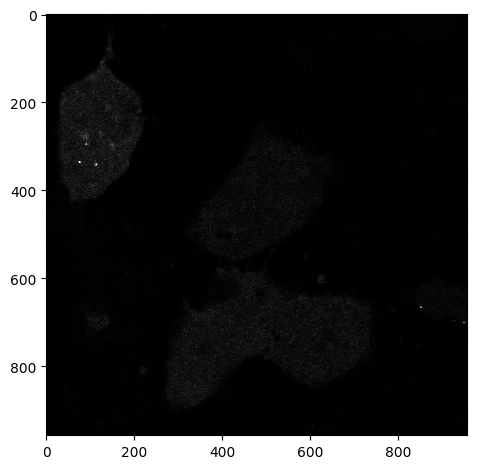

Segmented Cells


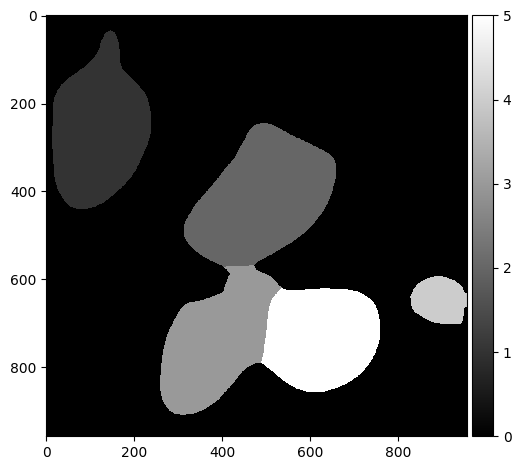

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
1K_SCR_11.czi
Green Channel


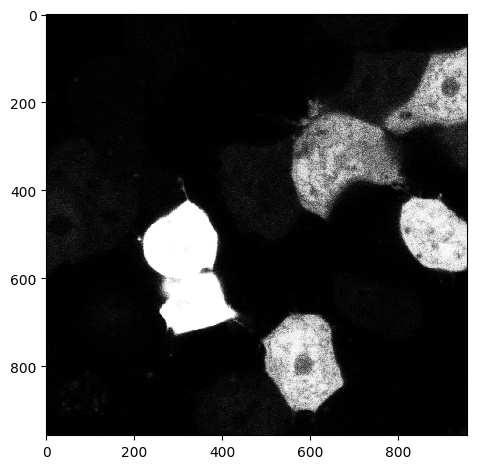

Segmented Cells


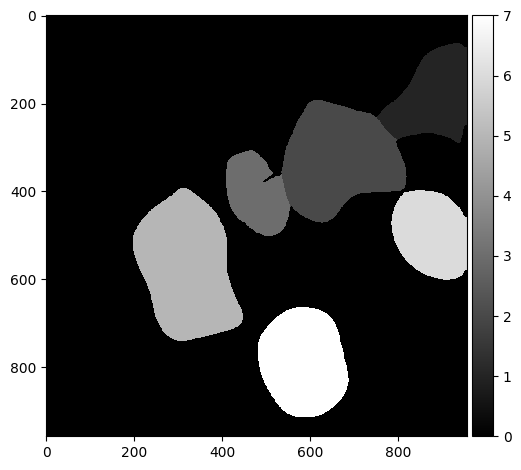

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_ADAMTS19_01.czi
Green Channel


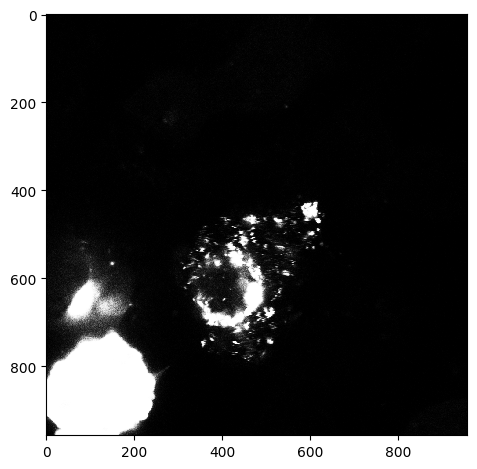

Segmented Cells


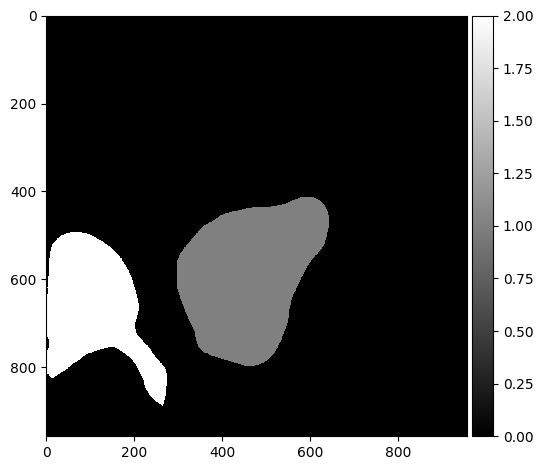

Threshold:  0.5
Bin count 99


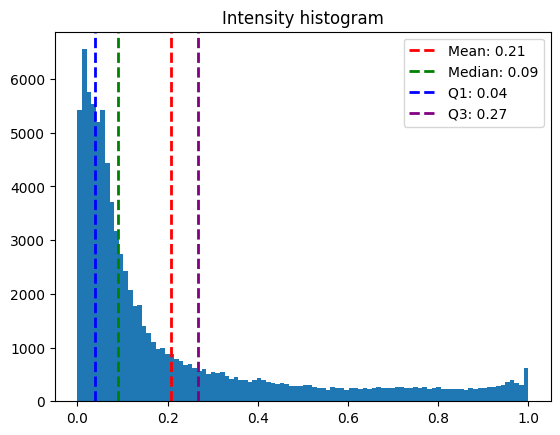

Inclusion Areas:  [1144.  406.   29.  176.  108.   24.   11.   17.   29.   32.   71.  108.
   50.   22.  323.   31.   32.   12.   29.   15.   22.  220.   39.   74.
   16.   17. 9523.   77.  112.   11.   20.  235.   53.   11.   36.   23.
   28.  147.   14.   68.   17.   36.   27.   22.  389.   57.   41.   18.
   39.  114.   89.   66.]


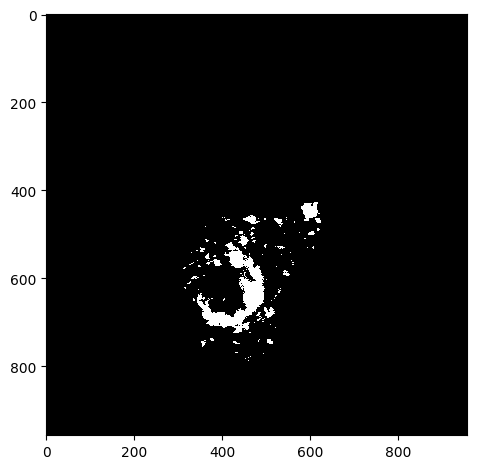

Threshold:  0.99
Bin count 42


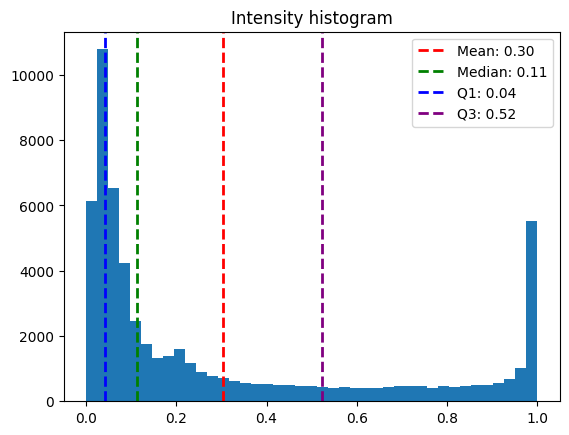

Inclusion Areas:  [2345. 6113.]


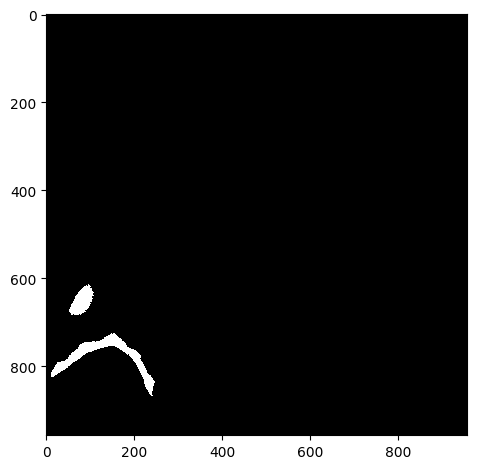

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_ADAMTS19_02.czi
Green Channel


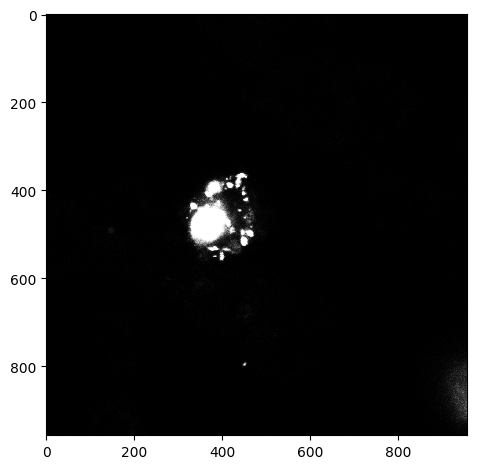

Segmented Cells


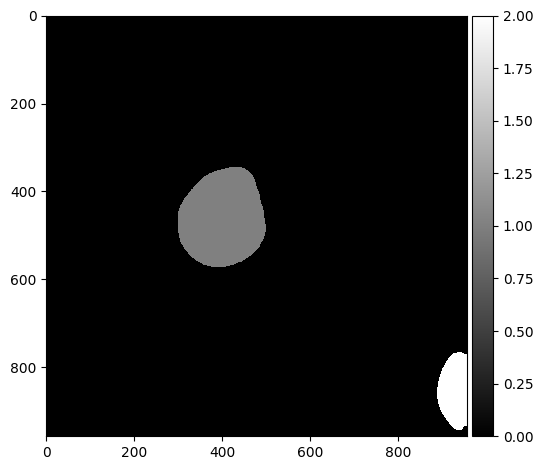

Threshold:  0.99
Bin count 33


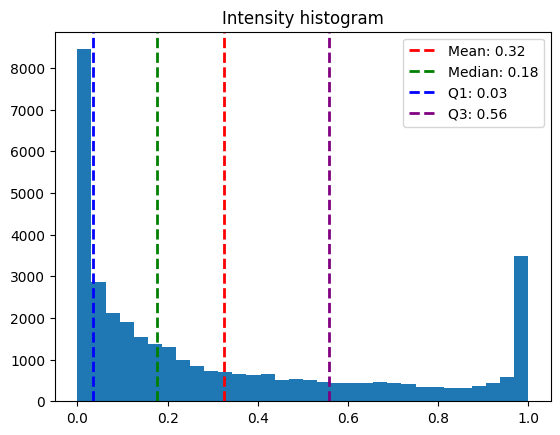

Inclusion Areas:  [ 131.   31.  494.   82.   30.   19.   37.   17.  141. 4503.   36.  140.
  191.   77.   28.]


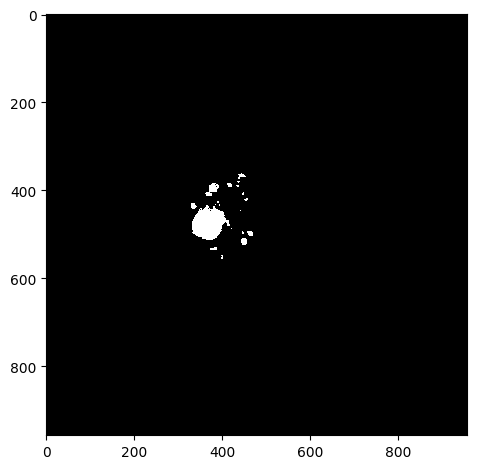

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_ADAMTS19_03.czi
Green Channel


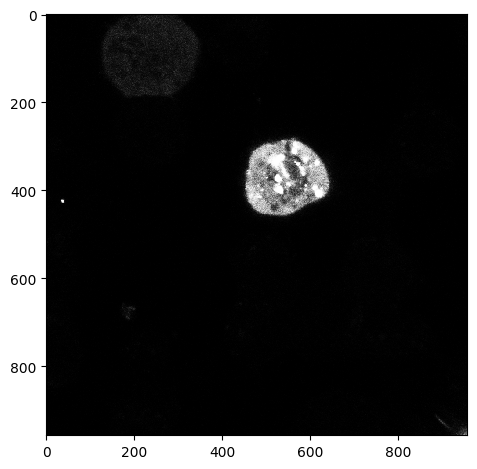

Segmented Cells


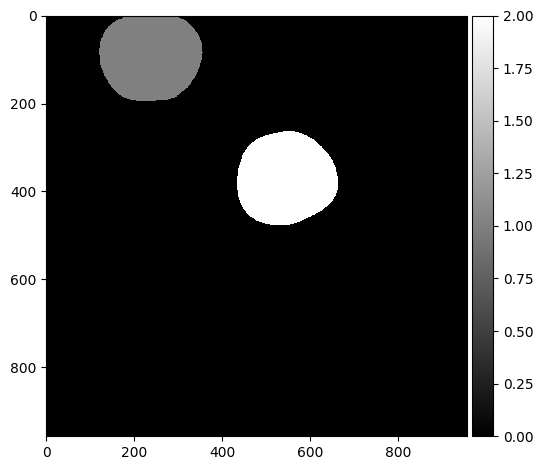

Threshold:  0.99
Bin count 32


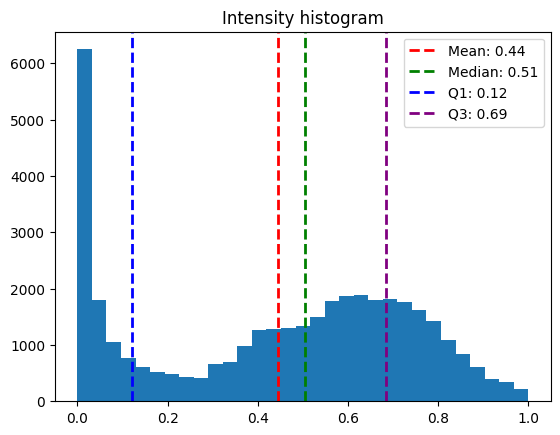

Inclusion Areas:  [173. 389.  35.  79.  26.  32.  11. 165.  31.  14.  66. 200.  14. 202.
  13.]


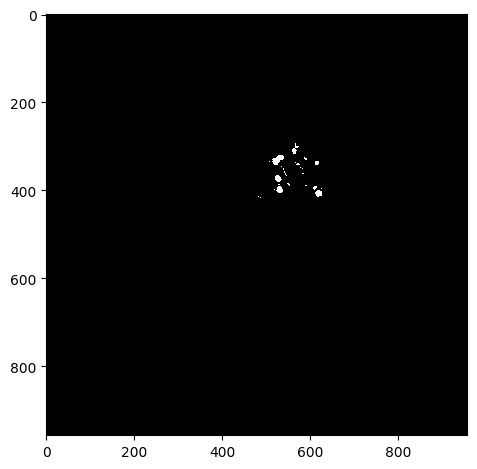

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_ADAMTS19_04.czi
Green Channel


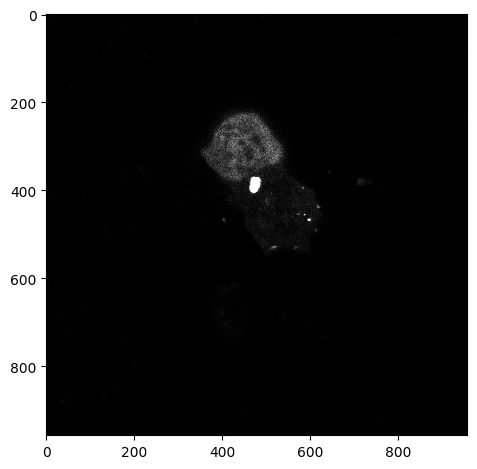

Segmented Cells


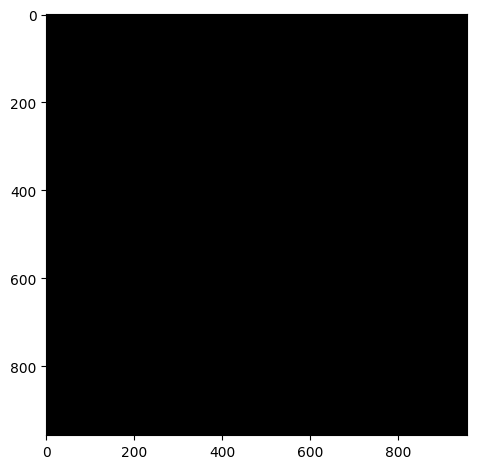

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_ADAMTS19_05.czi
Green Channel


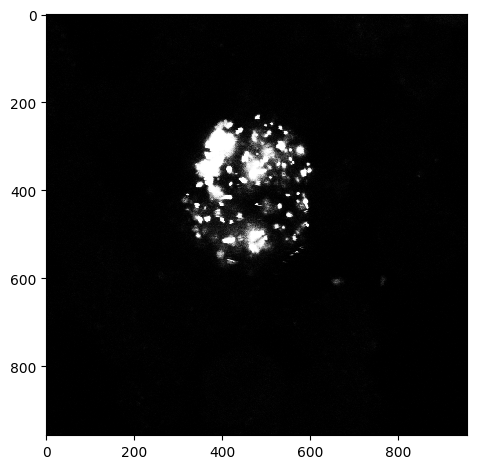

Segmented Cells


c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:158: UserWarning: Low image data range; displaying image with stretched contrast.
  lo, hi, cmap = _get_display_range(image)


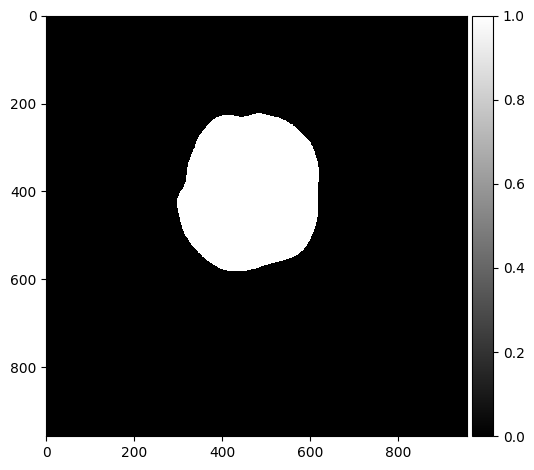

Threshold:  0.5
Bin count 66


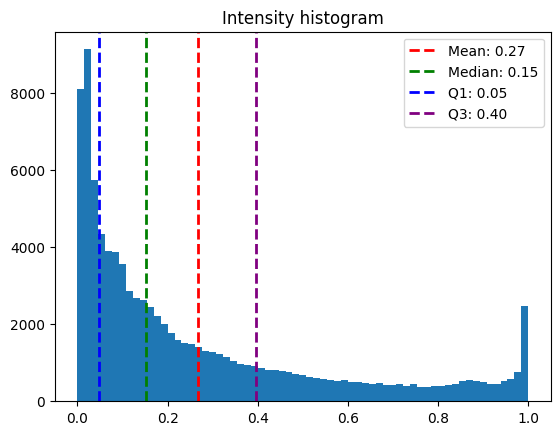

Inclusion Areas:  [  94. 8194.   33.   22.   68.  180.  312.  155.   66.  456. 3789.  298.
   49.   19.   64.  135.   44.  119.   39.   88.  192.  298.   46.   15.
   39.   40.  152.   58.   11.   28.  262.   22.   52.   29.   12.  122.
   40.   93.   35.   17.   17.   13.  300.   19.  117.  141.  221.  172.
   66.  101.   91.   20. 2106.   35.   22.   28.   88.   16.  453.  105.
   78.   22.  145.   19.   11.   59.]


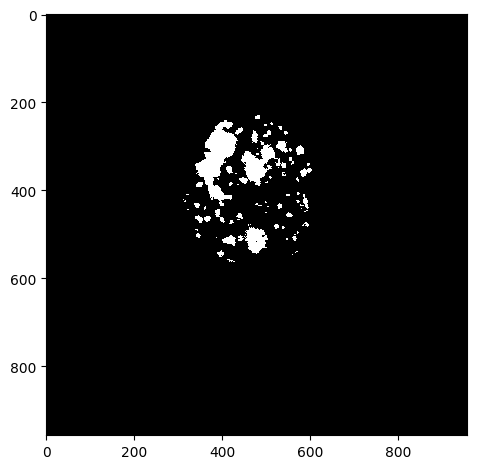

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_ADAMTS19_06.czi
Green Channel


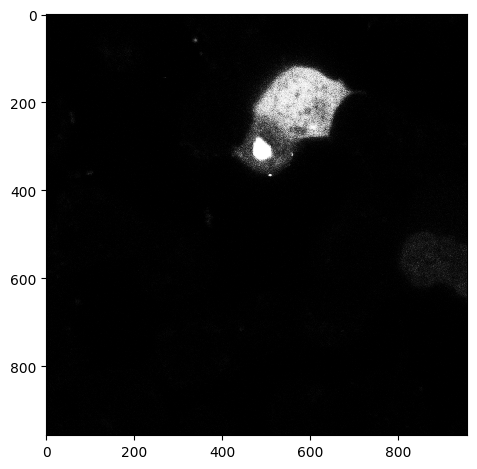

Segmented Cells


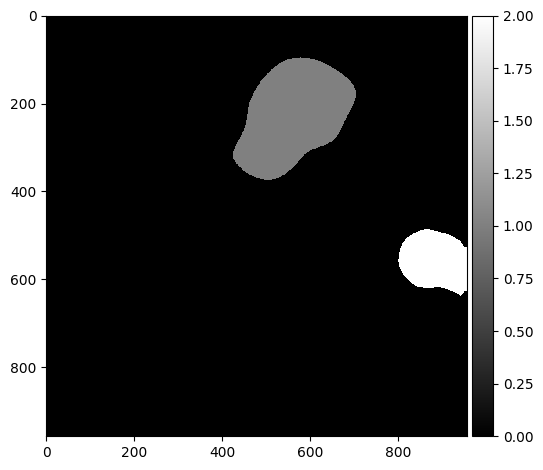

Threshold:  0.99
Bin count 32


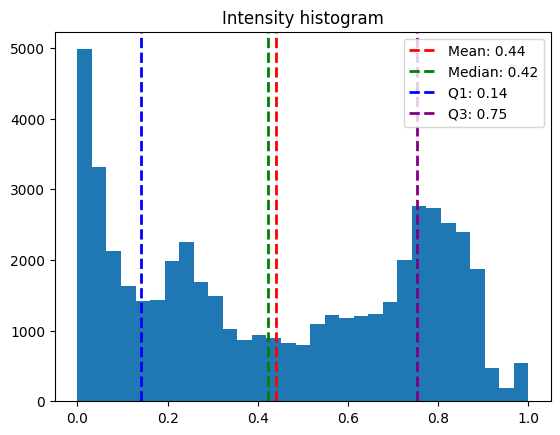

Inclusion Areas:  [1228.]


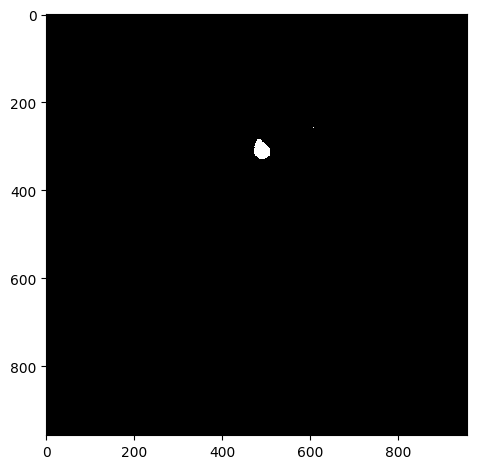

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_ADAMTS19_07.czi
Green Channel


c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\numpy\_core\fromnumeric.py:3596: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
c:\Users\yh1024\Documents\Yiming Huang\.venv\Lib\site-packages\numpy\_core\_methods.py:138: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


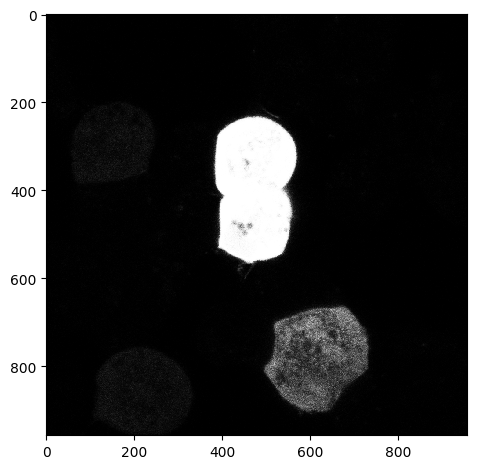

Segmented Cells


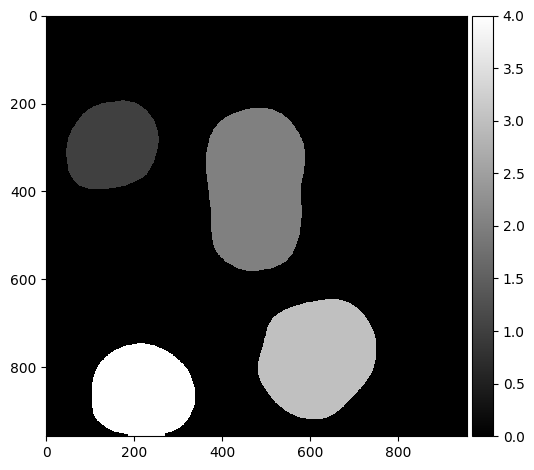

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_ADAMTS19_08.czi
Green Channel


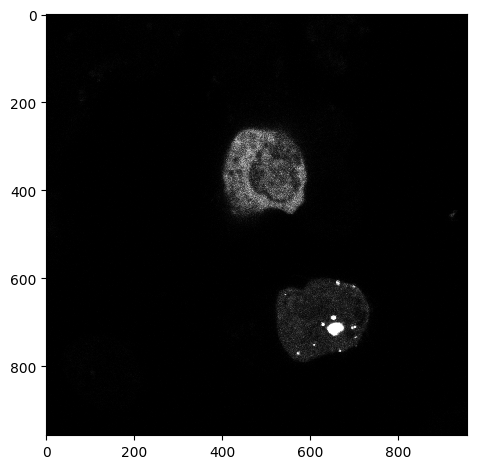

Segmented Cells


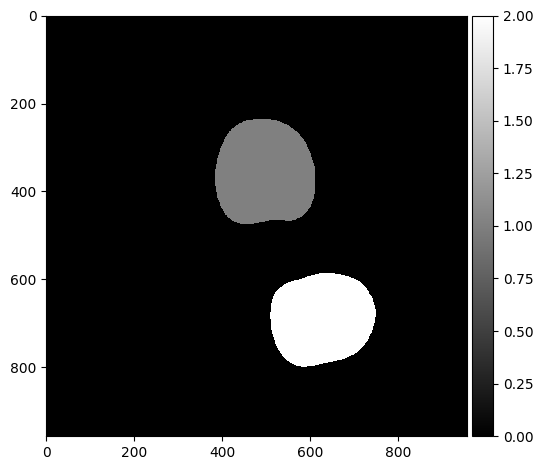

Threshold:  0.5
Bin count 301


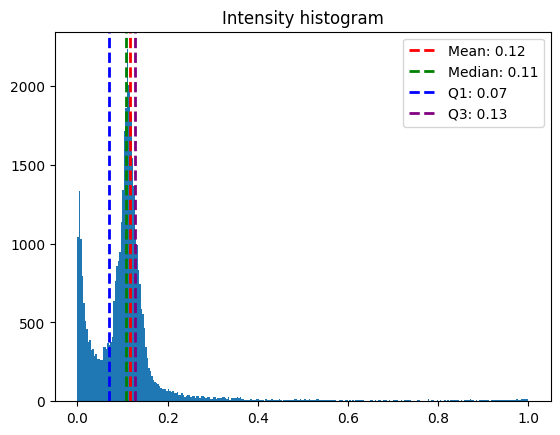

Inclusion Areas:  [ 57.  21. 108.  51. 847.  60.  12.  19.  19.  28.]


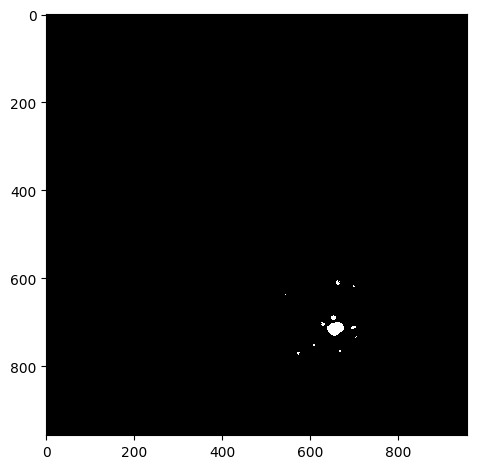

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_ADAMTS19_09.czi
Green Channel


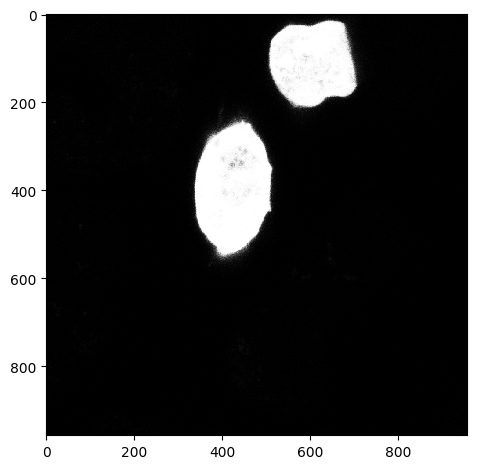

Segmented Cells


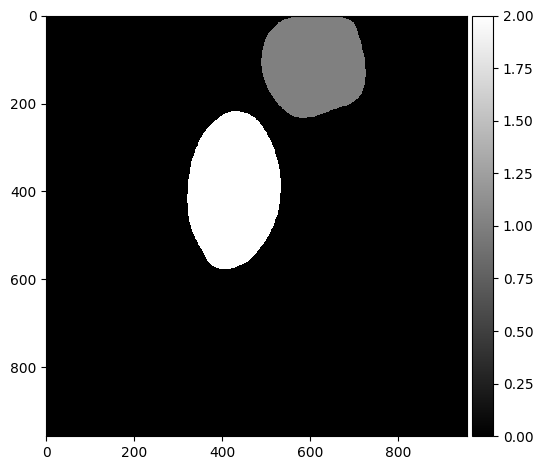

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_ADAMTS19_10.czi
Green Channel


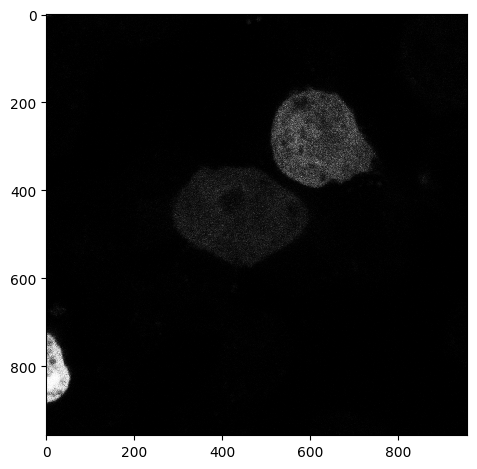

Segmented Cells


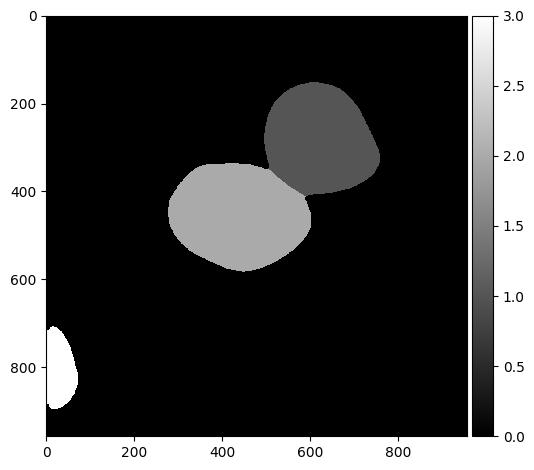

Threshold:  0.99
Bin count 17


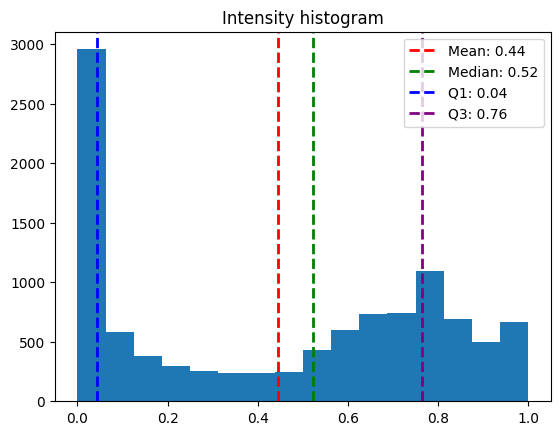

Inclusion Areas:  [12.]


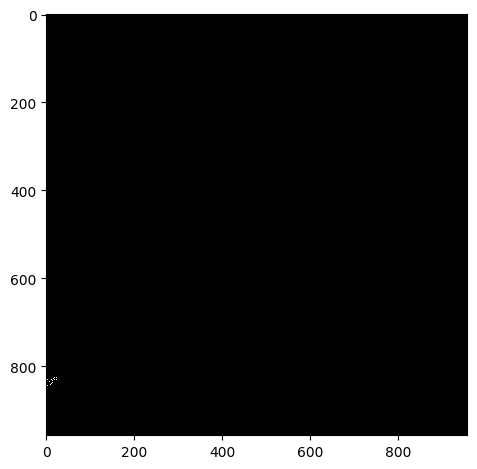

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_SCR_01.czi
Green Channel


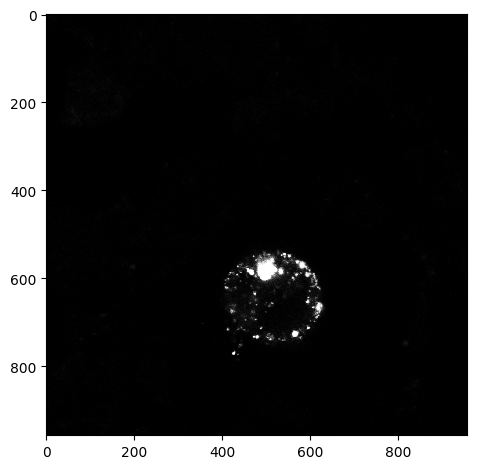

Segmented Cells


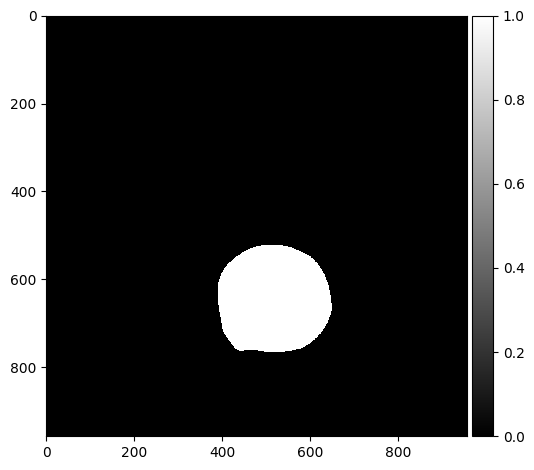

Threshold:  0.5
Bin count 181


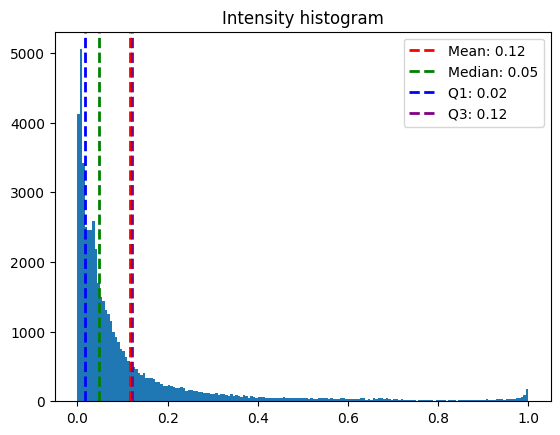

Inclusion Areas:  [  71.   11.   42.   25.   12. 1985.   16.  300.   13.  198.  105.   50.
   39.   14.   25.   21.   17.   23.   14.   29.   12.   46.   11.  266.
   21.   35.   37.   12.   35.   13.   18.  167.   75.   19.]


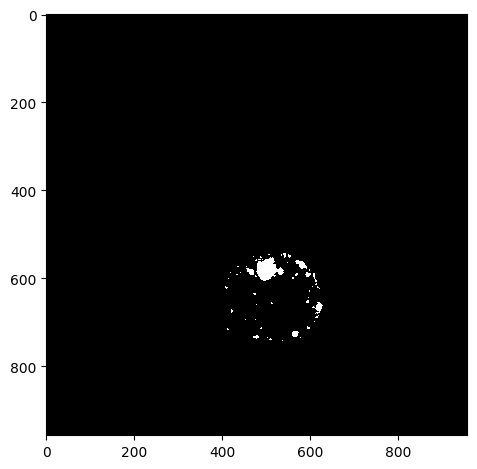

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_SCR_02.czi
Green Channel


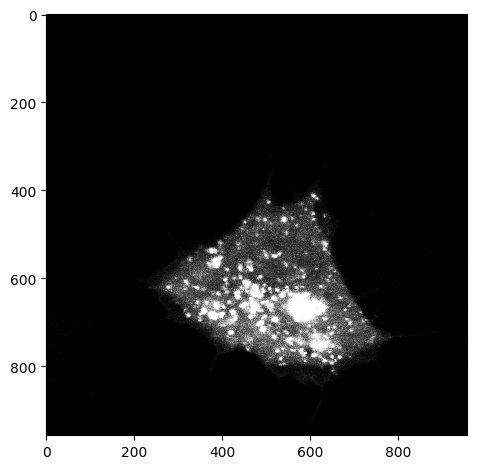

Segmented Cells


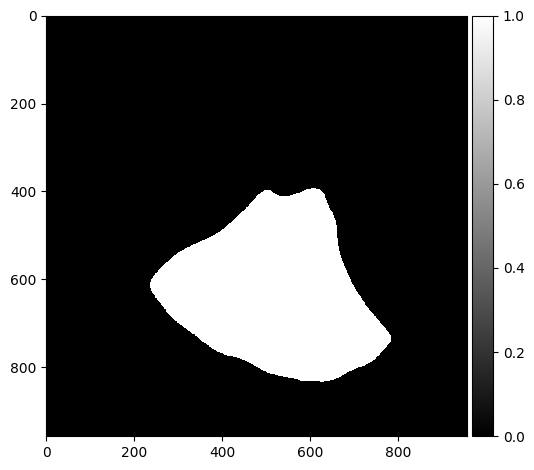

Threshold:  0.99
Bin count 91


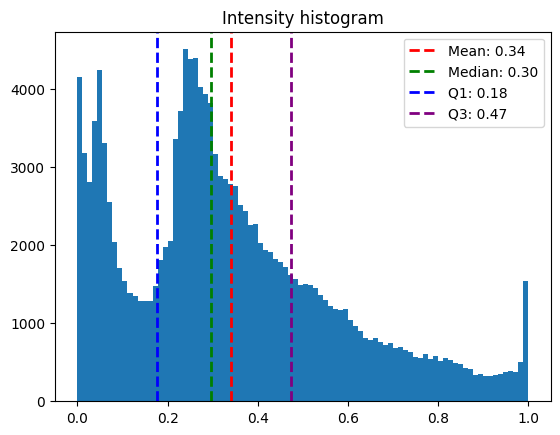

Inclusion Areas:  [  35.   32.   33.   25.  186.   28.   20.   47.  146.   11.   24.   16.
  123.  149.   17.   24. 2901.   28.   50.   91.  273.   27.   33.   12.
   99.   49.  256.   48.   14.   24.   19.   93.   23.   82.   64.   43.
   12.   13.   11.   19.   24.   14.   19.  194.   24.   15.   26.   23.
   13.   41.   15.   11.   14.]


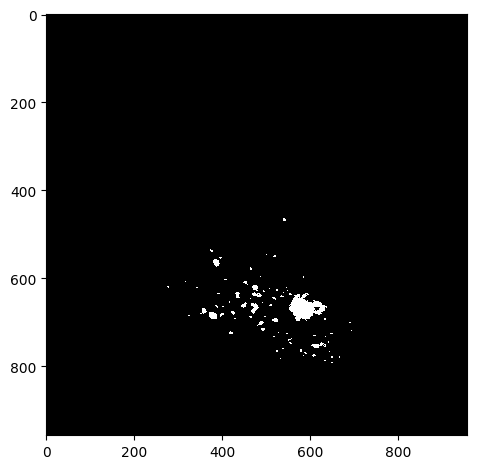

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_SCR_03.czi
Green Channel


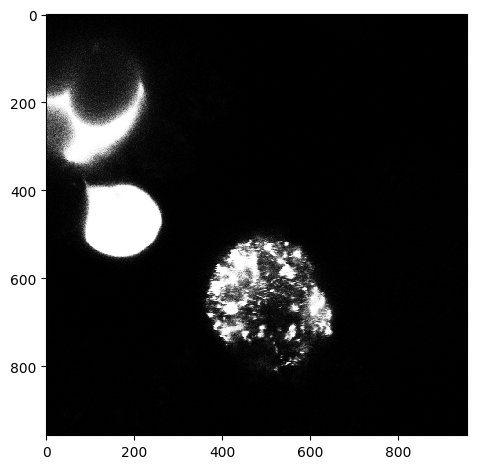

Segmented Cells


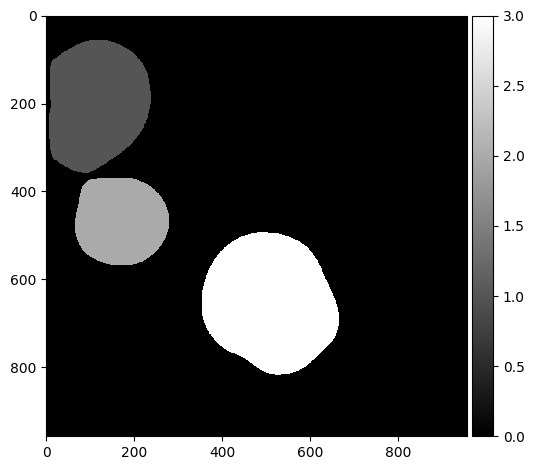

Threshold:  0.99
Bin count 31


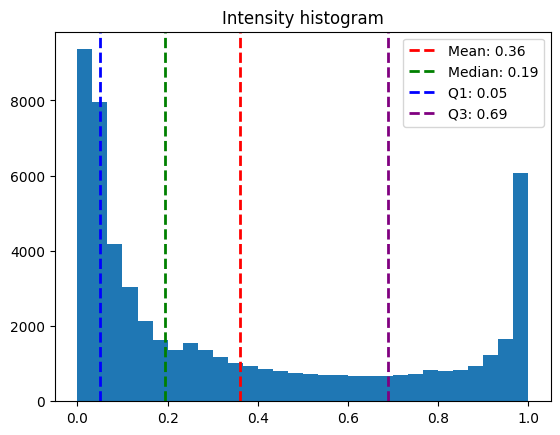

Inclusion Areas:  [ 455. 6188.]


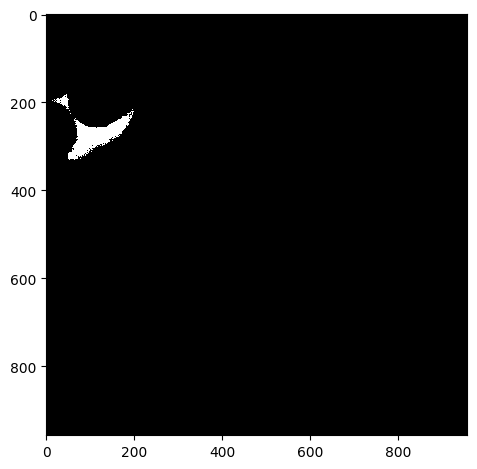

Threshold:  0.99
Bin count 47


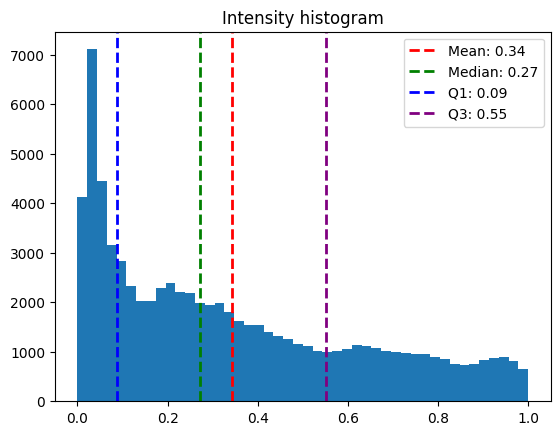

Inclusion Areas:  [ 181.   24.   28. 1252.   12.  137.   36.   14.   14.   37.   33.   12.
  345.  338.   12.  869.   20.   40.   11.   11.   14.   26.   23.   24.
  106.   69.   11.  512.   31.  155.   43.   17.   23.  104.   74.   83.
   22.   79.  113.   11.   61.   39.   16.]


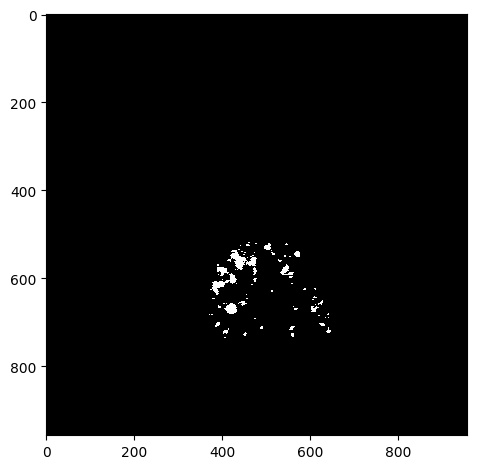

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_SCR_04.czi
Green Channel


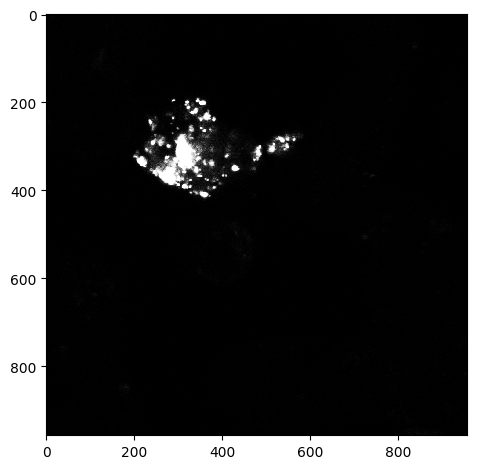

Segmented Cells


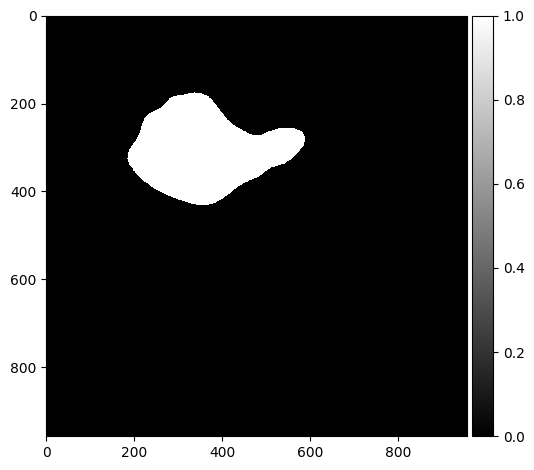

Threshold:  0.5
Bin count 71


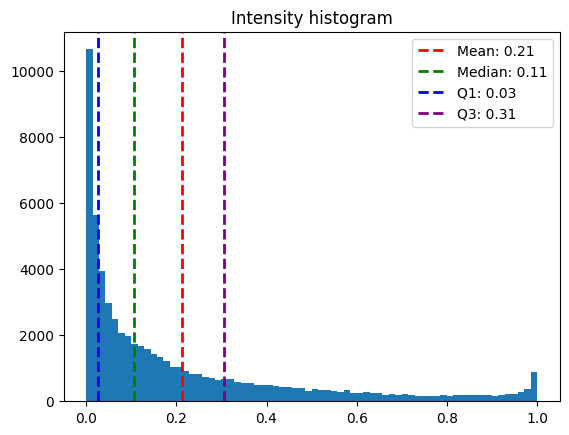

Inclusion Areas:  [ 207.   30.   77.   68.  176.  338.   63.   20.  110.  119.   31.   49.
   17. 5942.   11.   51.  262.  302.   33.  241.  131.   66.   37.  360.
   39.   29.   52.  460.   77.  138.  198.   58.   21.   11.   33.   25.
  197.   38.   37.  217.   23.]


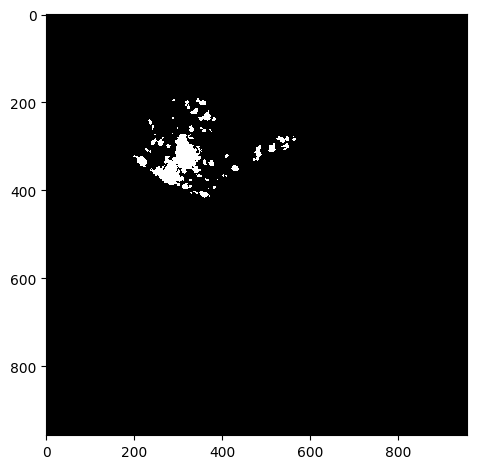

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_SCR_05.czi
Green Channel


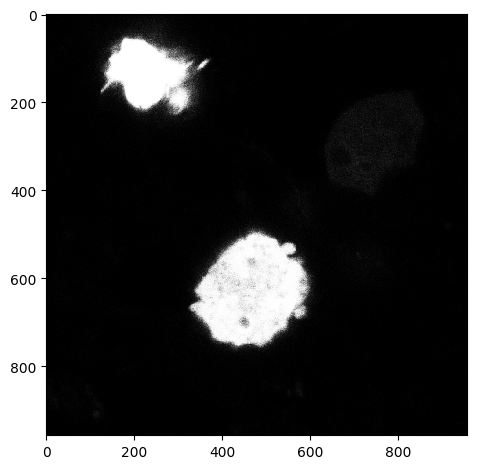

Segmented Cells


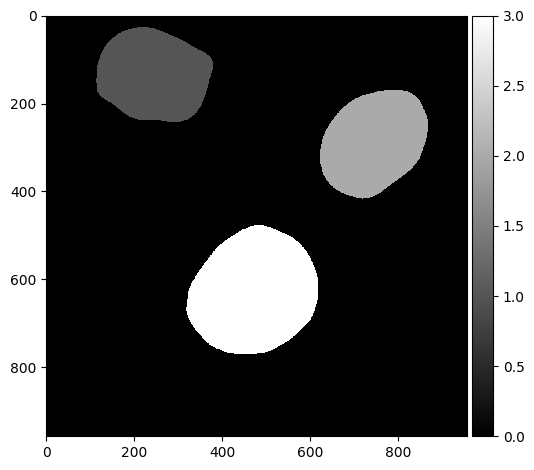

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_SCR_06.czi
Green Channel


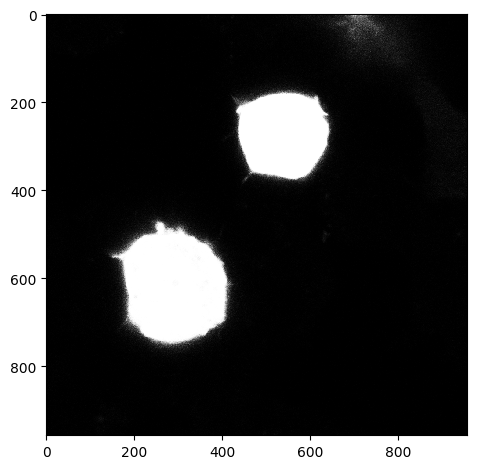

Segmented Cells


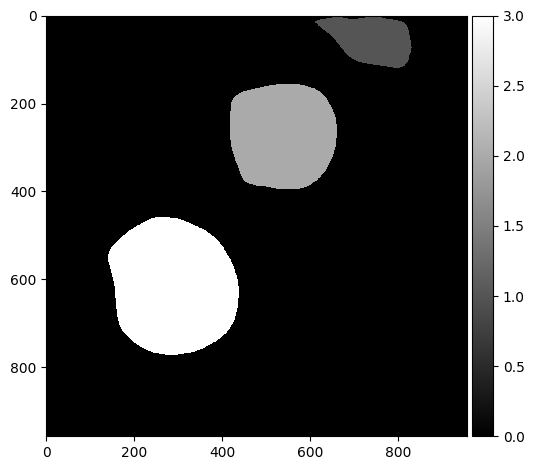

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_SCR_07.czi
Green Channel


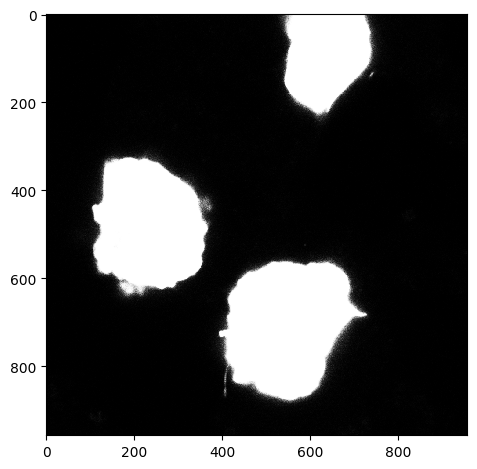

Segmented Cells


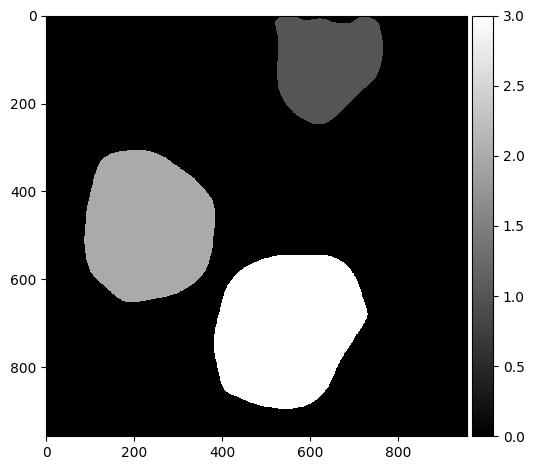

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_SCR_08.czi
Green Channel


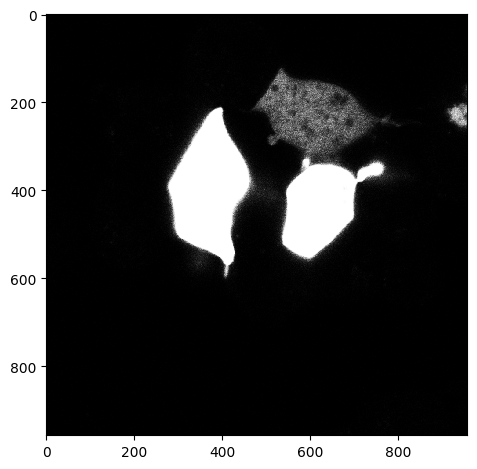

Segmented Cells


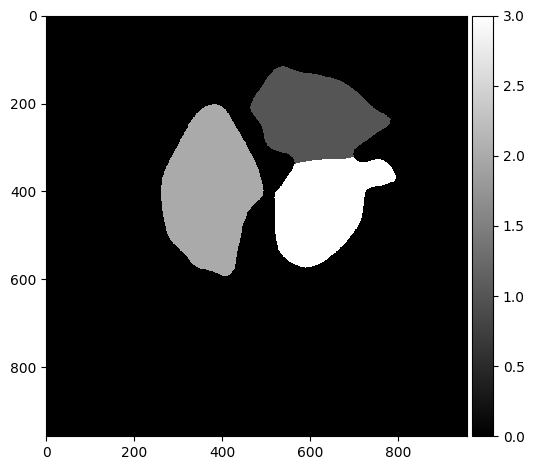

Threshold:  0.99
Bin count 60


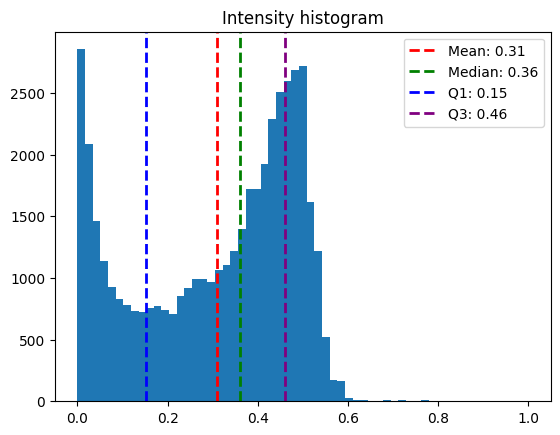

Inclusion Areas:  [23.]


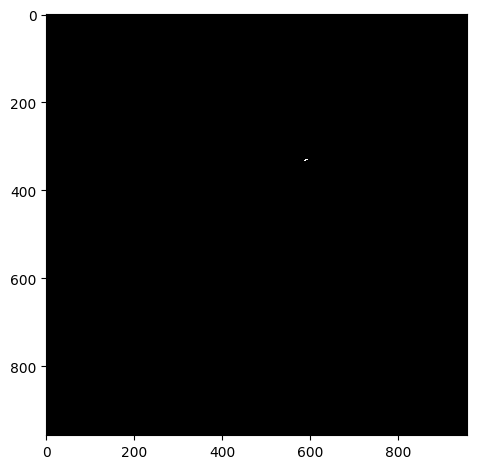

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_SCR_09.czi
Green Channel


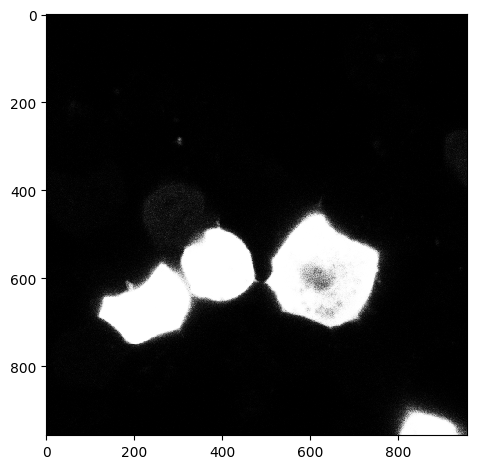

Segmented Cells


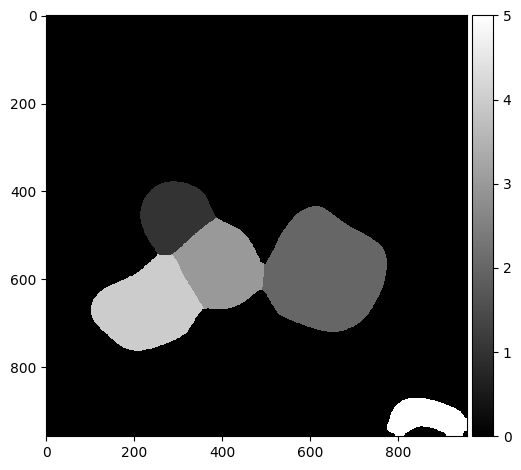

Threshold:  0.99
Bin count 15


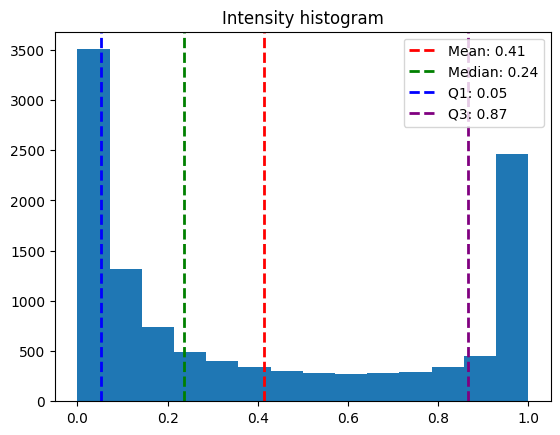

Inclusion Areas:  [2564.]


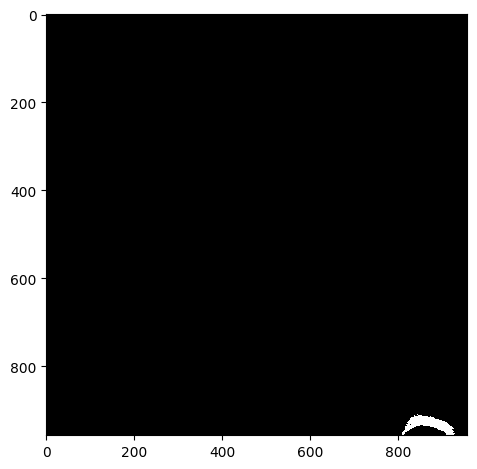

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_SCR_10.czi
Green Channel


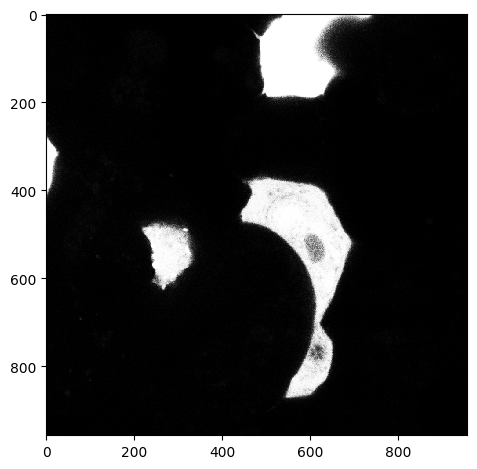

Segmented Cells


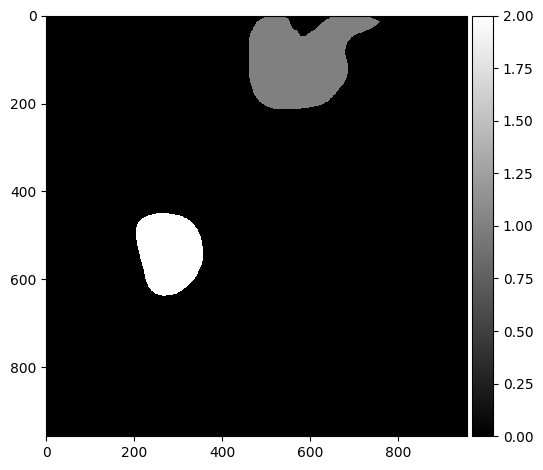

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_TAX1BP1_01.czi
Green Channel


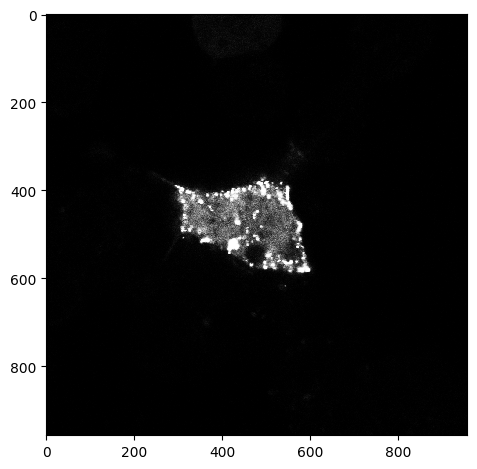

Segmented Cells


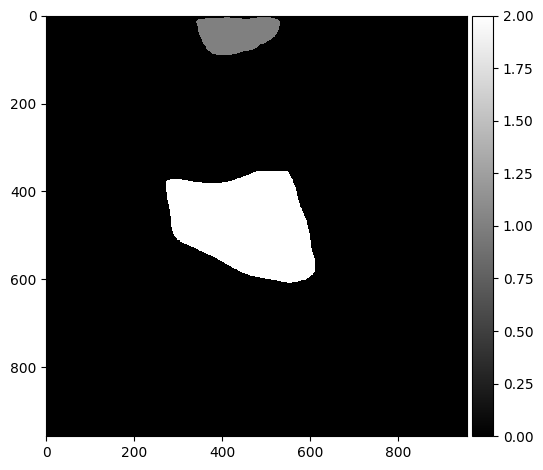

Threshold:  0.99
Bin count 58


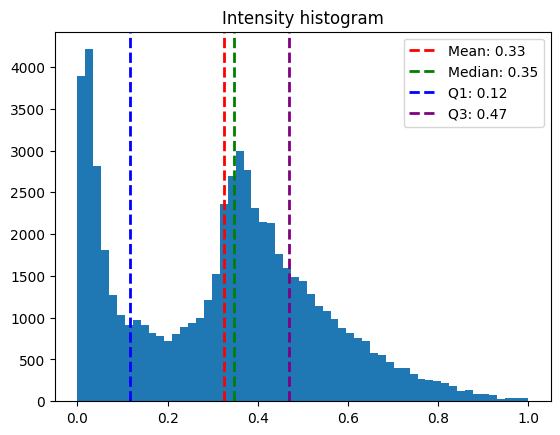

Inclusion Areas:  [ 28.  69.  46.  13.  14. 159.  45.  14.  12.  71.  37.  29.  53.  15.
  21.  11.  26.  41.  18.  14.  19.  17.  20.  27.  58.  33.  35.  35.
  12.  15.  17.  16.  16.  16.  62. 101.  12.  17.  22.  25. 101. 410.
  21.  14.  16.  18.  14.  93.  19.  20.  19.  43.  64.  80.]


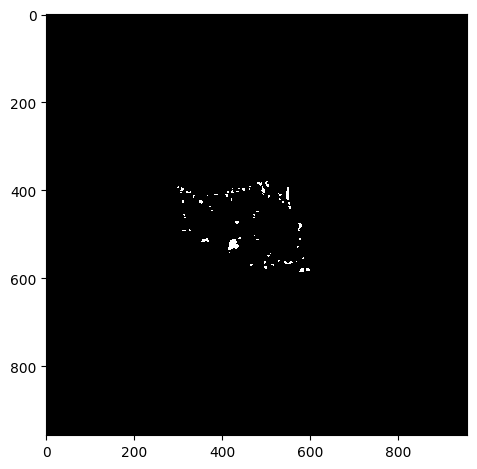

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_TAX1BP1_02.czi
Green Channel


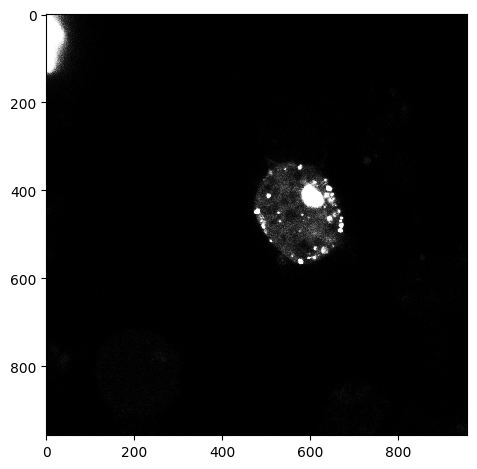

Segmented Cells


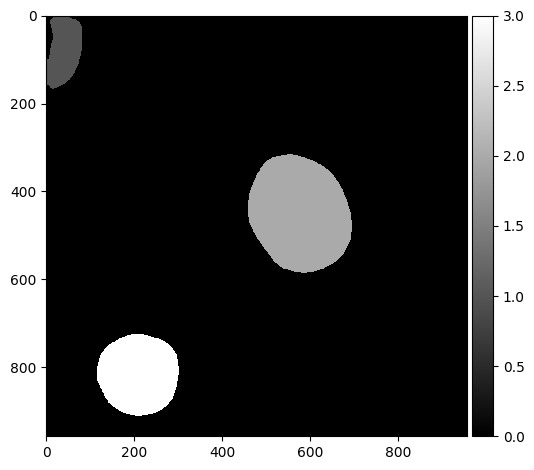

Threshold:  0.99
Bin count 17


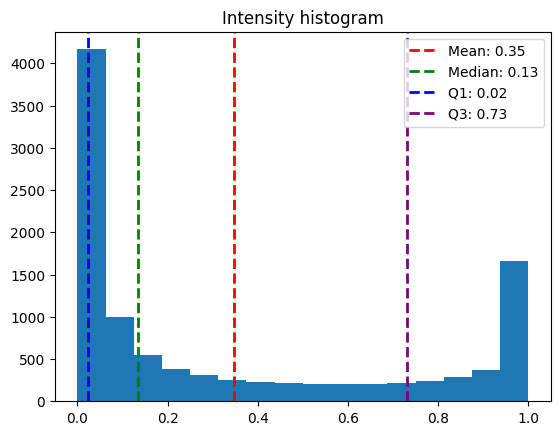

Inclusion Areas:  [1765.]


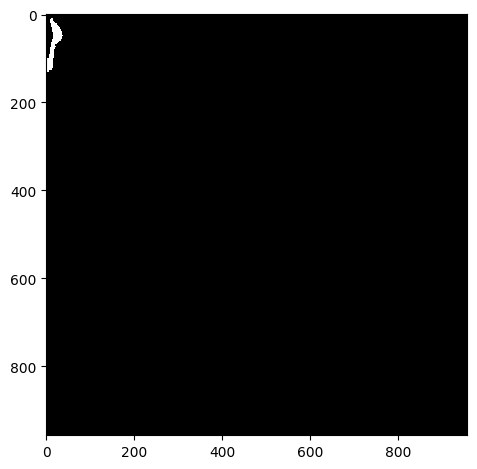

Threshold:  0.5
Bin count 113


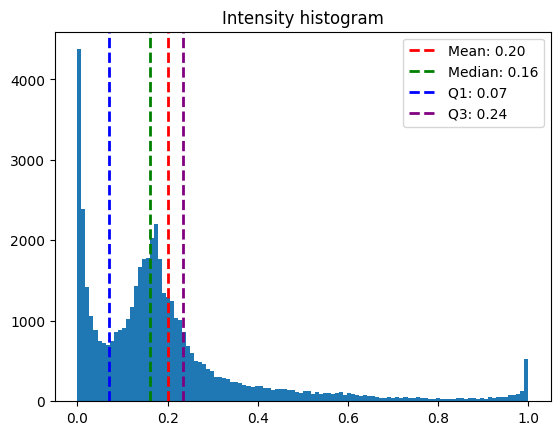

Inclusion Areas:  [  87.   21.   37.   44. 2770.   21.  148.   93.   18.   23.   21.  162.
   55.   28.   73.   19.  318.  161.  297.   11.   27.   11.   13.   16.
   30.   15.   61.  184.   29.  114.  130.]


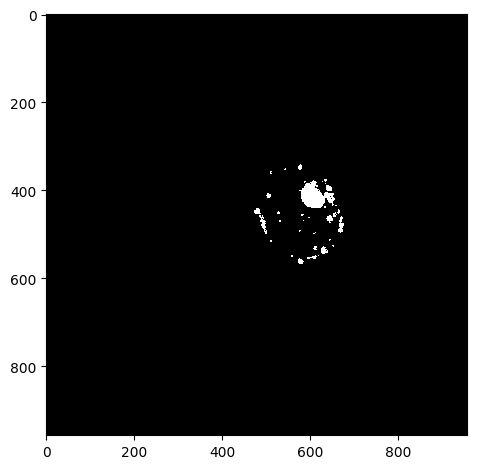

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_TAX1BP1_03.czi
Green Channel


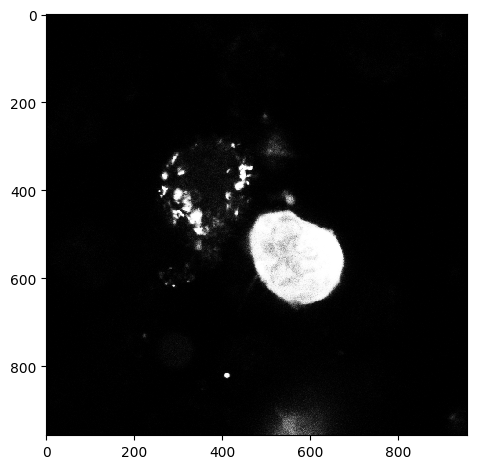

Segmented Cells


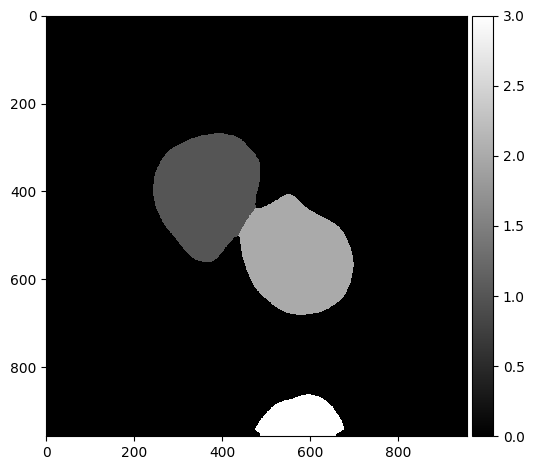

Threshold:  0.5
Bin count 154


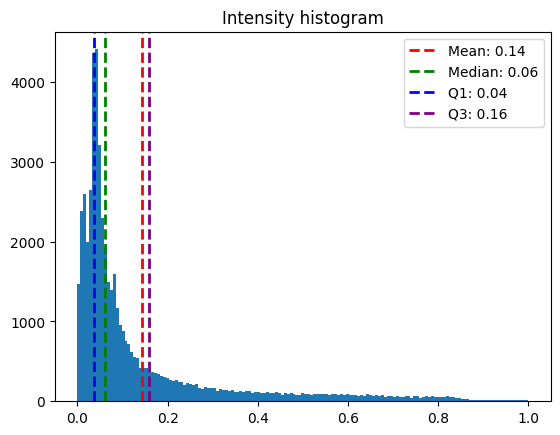

Inclusion Areas:  [  53.  123.  979.  154.   32.  164.   46.  156. 2409.   14.  140.   21.
   40.  327.   74.   37.   42.   49.]


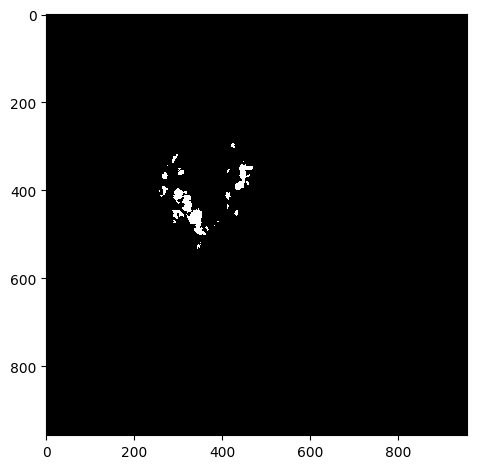

Threshold:  0.5
Bin count 45


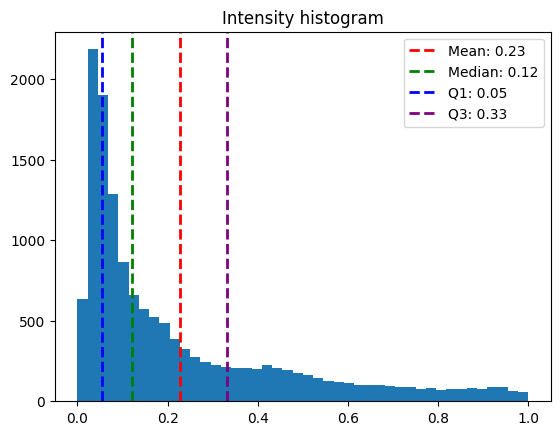

Inclusion Areas:  [121.]


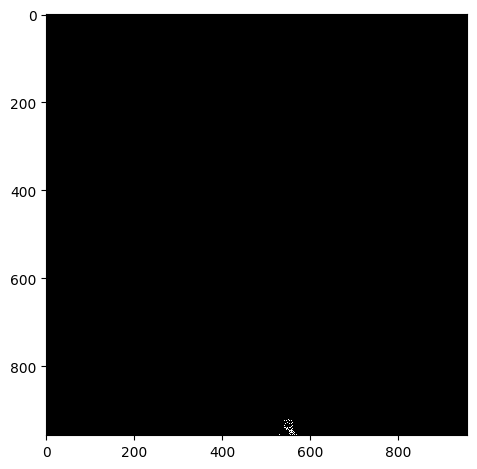

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_TAX1BP1_04.czi
Green Channel


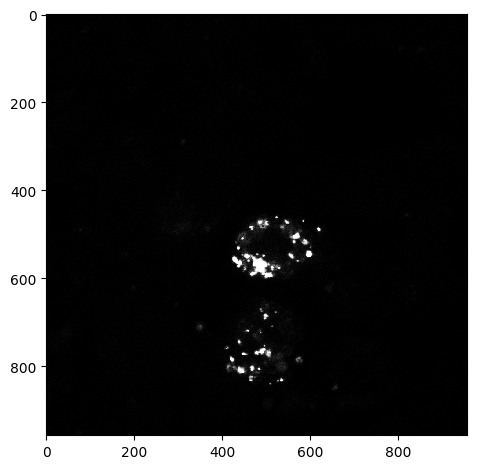

Segmented Cells


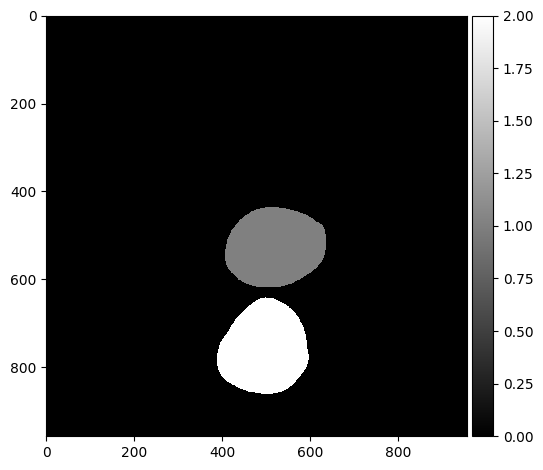

Threshold:  0.5
Bin count 111


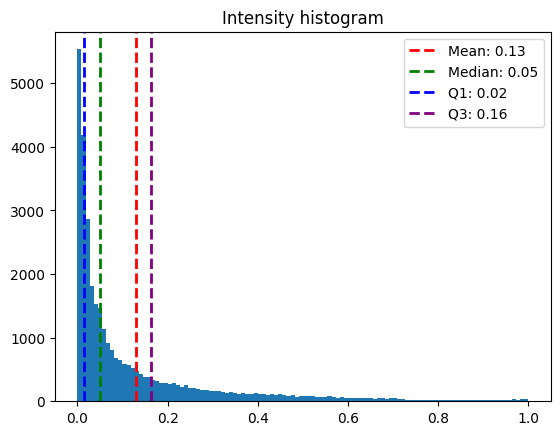

Inclusion Areas:  [  23.  106.   58.   15.   94.   18.   21.   53.   48.  184.   30.  106.
   39.   40.  174. 1415.   17.  100.   23.  288.   32.   15.   41.   63.
   20.]


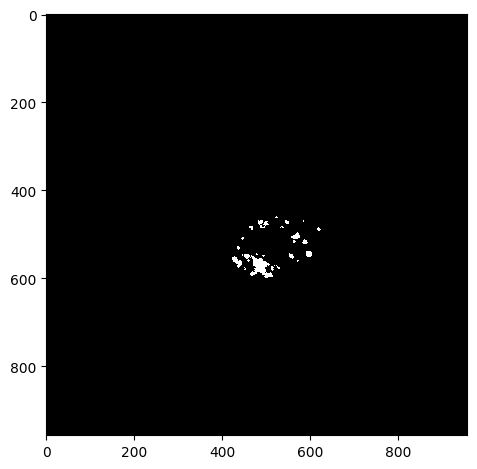

Threshold:  0.5
Bin count 209


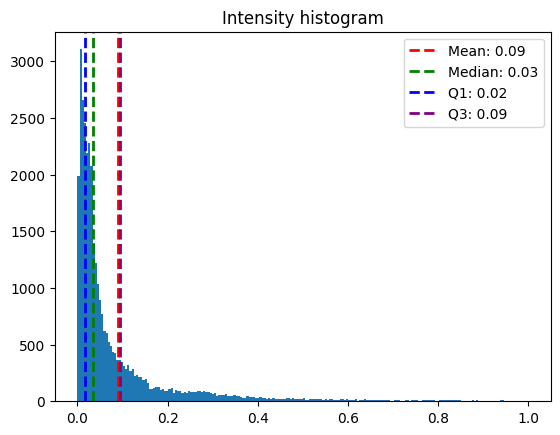

Inclusion Areas:  [ 90.  25.  40.  18. 221. 131.  48.  79.  83. 184.  24.  67.  38.  11.]


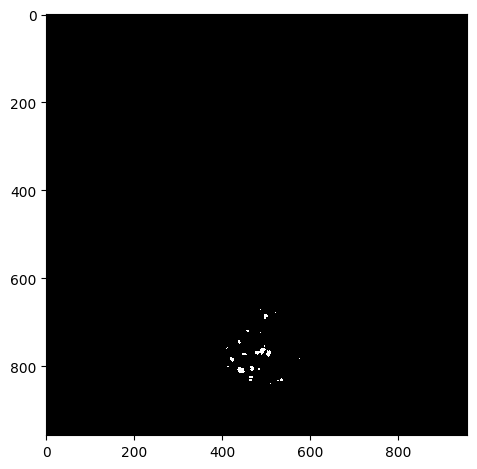

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_TAX1BP1_05.czi
Green Channel


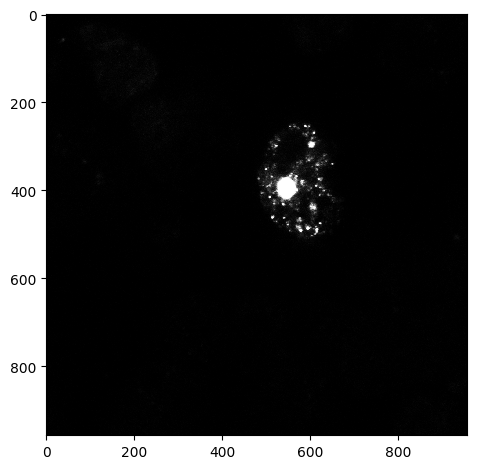

Segmented Cells


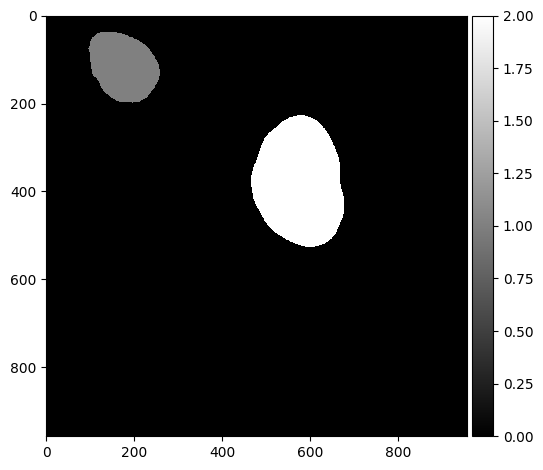

Threshold:  0.5
Bin count 155


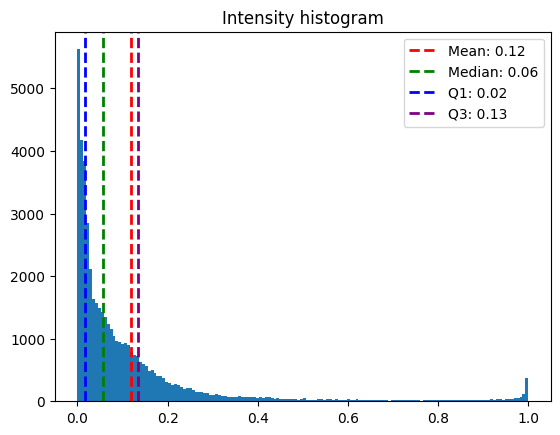

Inclusion Areas:  [  22.   24.  180.   31.   15.   12.   24.   20. 2186.   22.   31.   79.
   42.   21.   13.   12.   11.   22.   13.   30.  149.   36.   14.   62.
   20.   13.  118.   73.   77.]


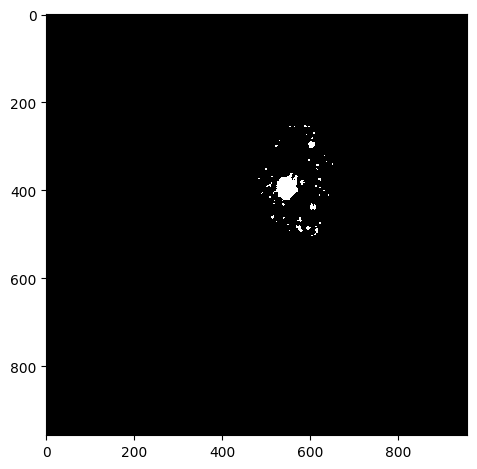

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_TAX1BP1_06.czi
Green Channel


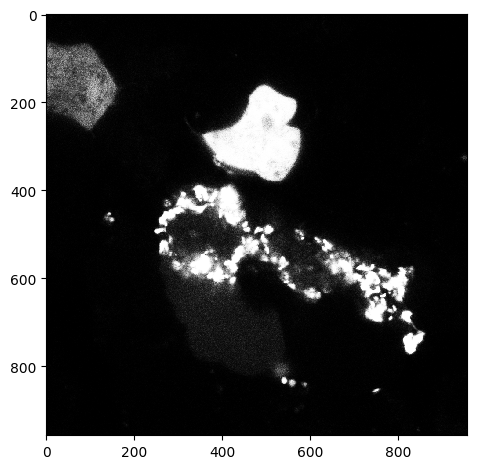

Segmented Cells


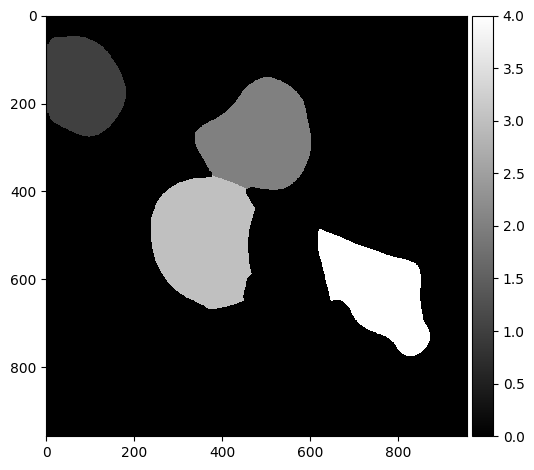

Threshold:  0.99
Bin count 37


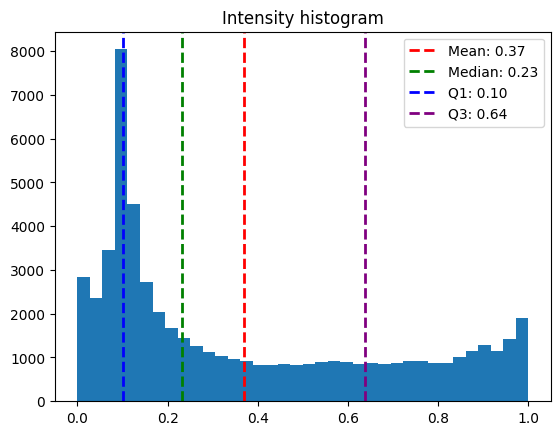

Inclusion Areas:  [ 559. 1254.   13.   50.  159.  358.   23.   31.  174.  764.   27.   66.
   55.  455.   55.   38.  107.  216.   14.  869. 1095.   17.  615.   77.]


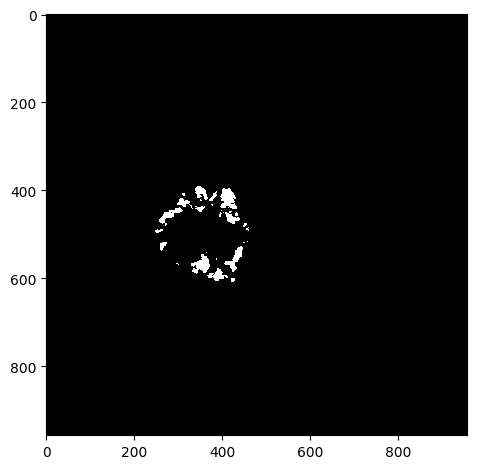

Threshold:  0.99
Bin count 30


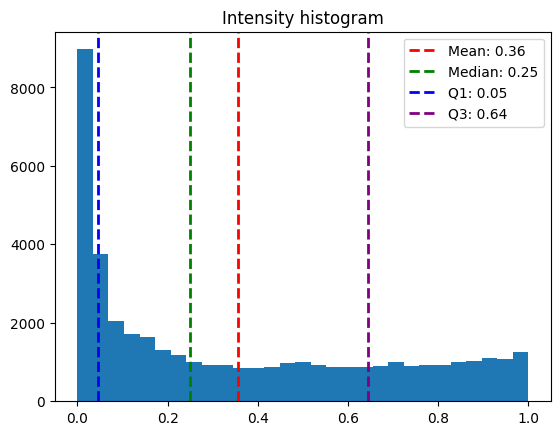

Inclusion Areas:  [ 188.   36.  451.   54.   42.  185. 1203.  135. 1299.   15.   46.   26.
   85.  834.   31.  338.   24. 1115.]


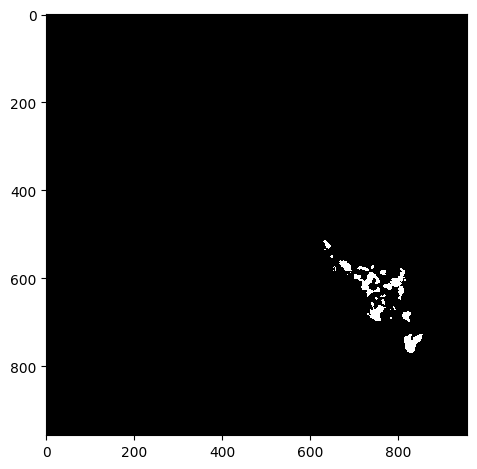

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_TAX1BP1_07.czi
Green Channel


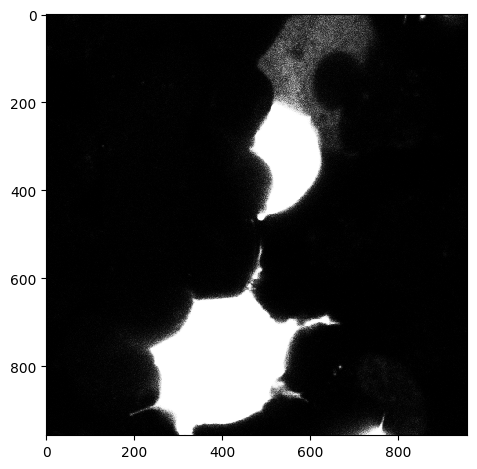

Segmented Cells


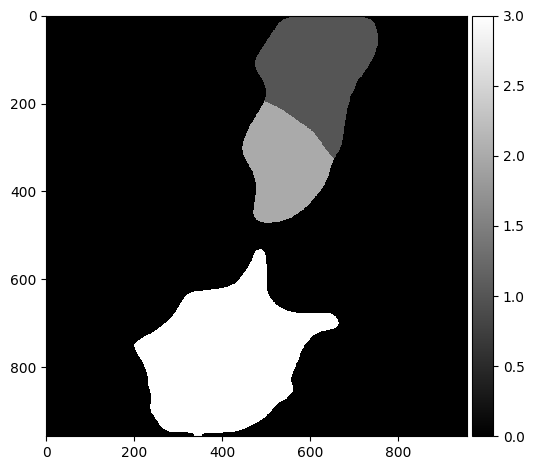

Threshold:  0.5
Bin count 88


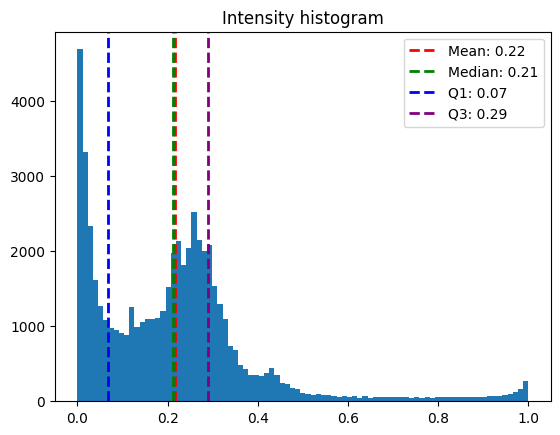

Inclusion Areas:  [  23.   33.   21.   20.   39.   18.   87. 3219.   19.   12.]


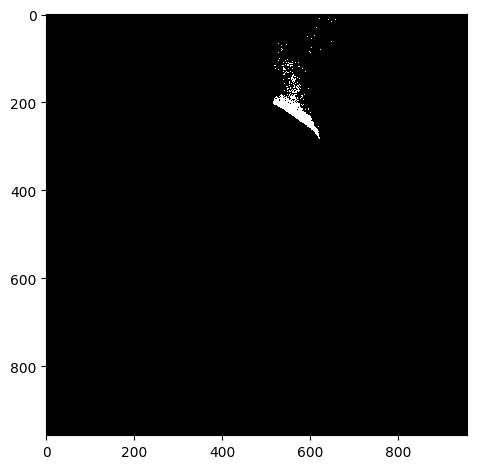

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_TAX1BP1_08.czi
Green Channel


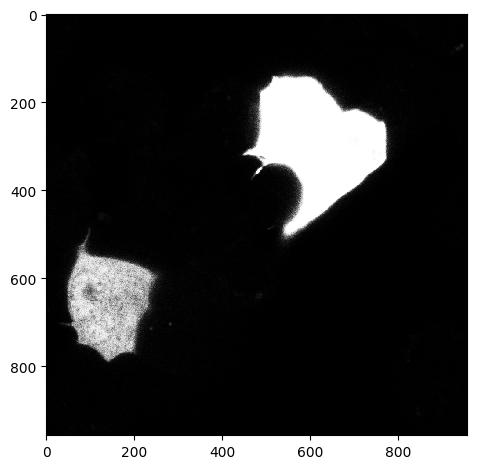

Segmented Cells


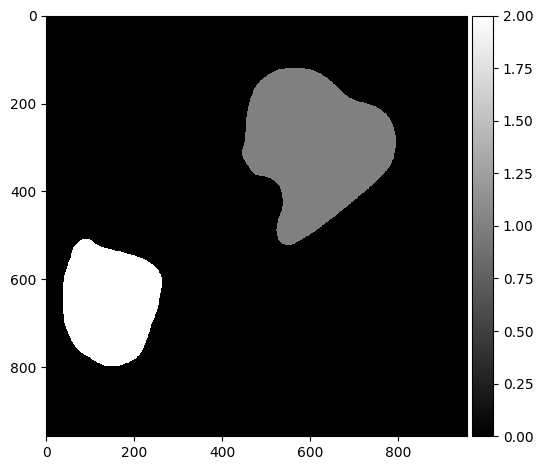

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_TAX1BP1_09.czi
Green Channel


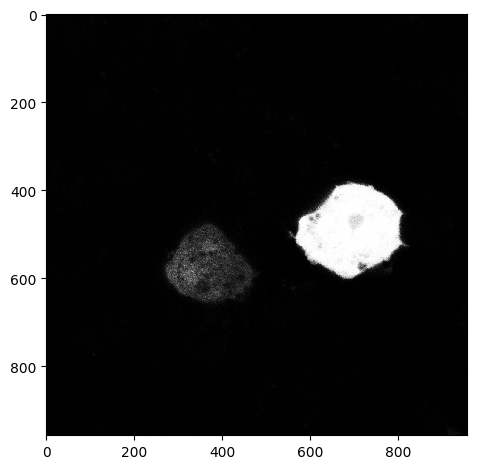

Segmented Cells


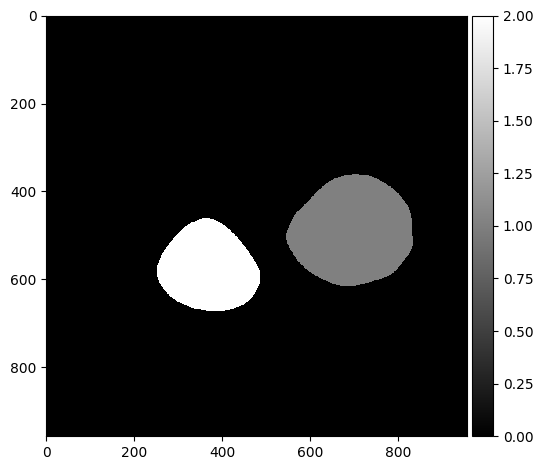

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
WT_PFF_TAX1BP1_10.czi
Green Channel


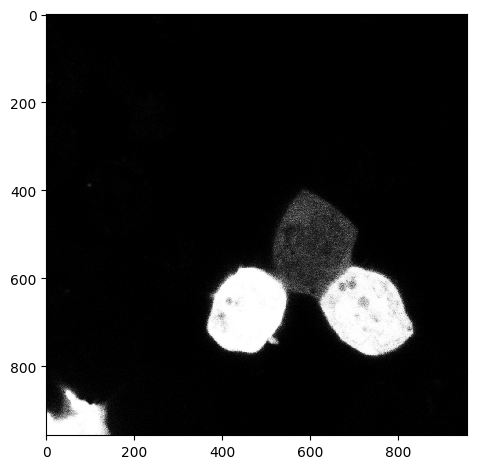

Segmented Cells


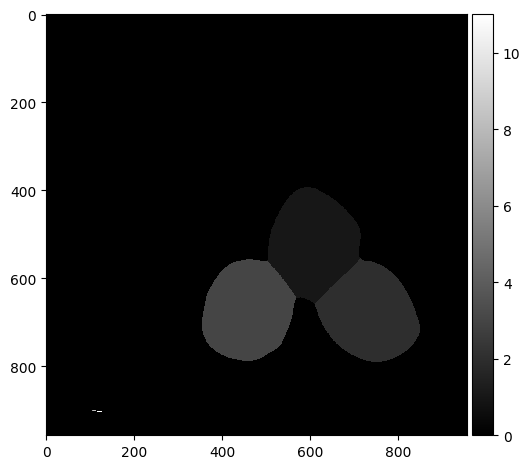

Threshold:  0.5
Bin count 265


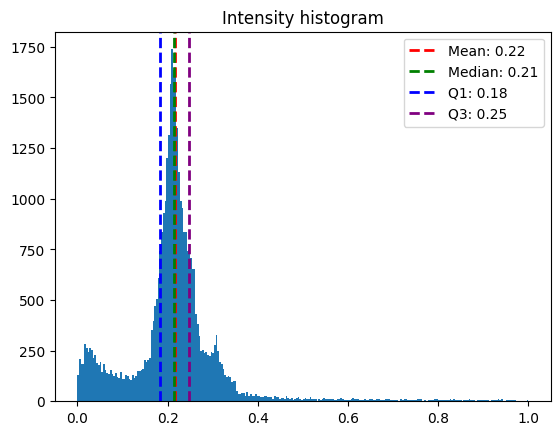

Inclusion Areas:  [543.]


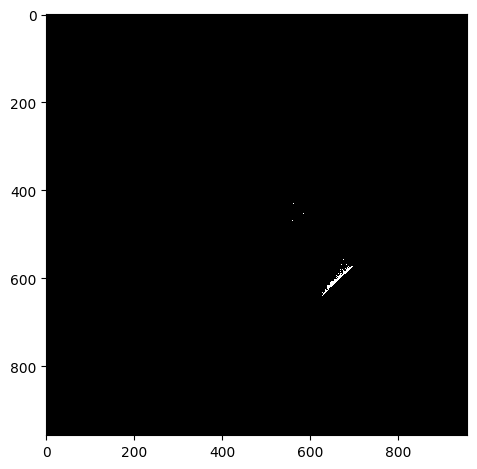

--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


In [ ]:
analyze_all_images(folders[4])